In [2]:
!pip3 install unidecode

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.9/235.9 KB 8.7 MB/s eta 0:00:00


In [4]:
import time
import random
import unidecode
import string
import re

import matplotlib.pyplot as plt
import torch

# Some operations doesn't have deterministic Implementation so it is good to enable it as True
torch.backends.cudnn.deterministic = True

In [5]:
RANDOM_SEED = 123
torch.manual_seed(RANDOM_SEED)
device = torch.device('cuda' if torch.cuda.is_available else 'cpu')

TEXT_PORTION_SIZE = 200
NUM_ITER = 5000
LEARNING_RATE = 0.005
EMBEDDING_DIM = 100
HIDDEN_DIM = 128

print (device)

cuda


In [19]:
from google.colab import files
uploaded = files.upload()

In [7]:
string.printable

'0123456789abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~ \t\n\r\x0b\x0c'

In [12]:
with open('covid19-faq.txt') as f:
  textdata = f.read()

textdata = unidecode.unidecode(textdata)
textdata = re.sub(' +',' ',textdata)
print (len(textdata))
TEXT_LENGTH = len(textdata)

84658


In [13]:
random.seed(RANDOM_SEED)

def random_string(textdata):
  startidx = random.randint(0,TEXT_LENGTH-TEXT_PORTION_SIZE)
  endidx = startidx + TEXT_PORTION_SIZE + 1
  textdata = textdata[startidx:endidx]
  return textdata
print (random_string(textdata))

heck with the vaccine provider.

If you're traveling away from Madison before your second dose, we encourage you to get your first dose on campus now and obtain a second dose once you reach your new lo


In [15]:
def char_to_tensor(text):
  lst = [string.printable.index(c) for c in text]
  tensor = torch.tensor(lst).long()
  return tensor

char_to_tensor('aAbBcC')

tensor([10, 36, 11, 37, 12, 38])

In [16]:
def draw_random_sample(text):
  text = char_to_tensor(random_string(text))
  inputtext = text[:-1]
  outputtext = text[1:]
  return inputtext, outputtext

In [17]:
draw_random_sample(textdata)

(tensor([ 0, 94, 24, 27, 94, 21, 10, 29, 14, 27, 94, 24, 15, 94, 26, 30, 10, 27,
         10, 23, 29, 18, 23, 14, 94, 10, 23, 13, 94, 34, 24, 30, 27, 94, 37, 10,
         13, 16, 14, 27, 94, 37, 10, 13, 16, 14, 94, 18, 23, 13, 18, 12, 10, 29,
         14, 28, 94, 63, 11, 30, 18, 21, 13, 18, 23, 16, 94, 10, 12, 12, 14, 28,
         28, 94, 16, 27, 10, 23, 29, 14, 13, 75, 63, 96, 54, 14, 14, 94, 29, 17,
         14, 94, 56, 23, 18, 31, 14, 27, 28, 18, 29, 34, 94, 43, 14, 10, 21, 29,
         17, 94, 54, 14, 27, 31, 18, 12, 14, 28, 94, 32, 14, 11, 28, 18, 29, 14,
         94, 15, 24, 27, 94, 22, 24, 27, 14, 94, 18, 23, 15, 24, 27, 22, 10, 29,
         18, 24, 23, 94, 10, 11, 24, 30, 29, 94, 26, 30, 10, 27, 10, 23, 29, 18,
         23, 14, 94, 10, 23, 13, 94, 18, 28, 24, 21, 10, 29, 18, 24, 23, 75, 96,
         96, 58, 17, 18, 21, 14, 94,  1,  4, 94, 13, 10, 34, 28, 94, 18, 28, 94,
         29, 17]),
 tensor([94, 24, 27, 94, 21, 10, 29, 14, 27, 94, 24, 15, 94, 26, 30, 10, 27, 10,
         

## Model

In [29]:
import torch.nn as nn

class RNN(nn.Module):

  def __init__(self,input_size,embedding_size,hidden_size,output_size):
    super().__init__()

    self.hidden_size = hidden_size
    self.embd = nn.Embedding(num_embeddings = input_size,embedding_dim=embedding_size)
    self.rnn = nn.LSTMCell(input_size = embedding_size,hidden_size=hidden_size)
    self.fc = nn.Linear(hidden_size,output_size)

  def forward(self,character,hidden_state,cell_state):
    # input dimension [batch_size,1]
    embd = self.embd(character) 
    # output dimension [batch_size,embedding_dim]

    #input dimension [batch_size,embedding_dim], [1,hidden_size], [1,hidden_size]
    (hidden,cell_state) = self.rnn(embd,(hidden_state,cell_state))
    #output dimension [batch_size,hidden_size], [batch_size,hidden_size]

    #input [batch_size,hidden_size]
    out = self.fc(hidden)
    #output [batch_size,output_size]

    return out,hidden,cell_state

  def init_zero_state(self):
    hidden = torch.zeros((1,self.hidden_size)).to(device)
    cell = torch.zeros((1,self.hidden_size)).to(device)

    return (hidden,cell)

In [30]:
model = RNN(len(string.printable),EMBEDDING_DIM,HIDDEN_DIM,len(string.printable))
model.to(device)

RNN(
  (embd): Embedding(100, 100)
  (rnn): LSTMCell(100, 128)
  (fc): Linear(in_features=128, out_features=100, bias=True)
)

In [31]:
optimizer = torch.optim.Adam(model.parameters(),lr=LEARNING_RATE)

In [46]:
def evaluate_model(model,prime_start = 'A',predict_len = 100,temperature=0.8):
  
  (hidden,cellstate) = model.init_zero_state()
  prime_input = char_to_tensor(prime_start)
  predicted = prime_start

  for p in range(len(prime_start) - 1):
    inp = prime_input[p].unsqueeze(0)
    _, hidden,cell = model(inp.to(device),hidden,cellstate)
  inp = prime_input[-1].unsqueeze(0)

  for p in range(predict_len):
    out,hidden,cellstate = model(inp.to(device),hidden,cell)

    #sample from the network as a multinomial distribution
    outdist = out.data.view(-1).div(temperature).exp()
    top_i = torch.multinomial(outdist,1)[0]

    predicted_char = string.printable[top_i]
    predicted += predicted_char
    inp = char_to_tensor(predicted_char)
  return predicted


Time Elapsed 0.1024484634399414
Iteration 0 Loss 2.3404626846313477
Thofora a f 60 rmpour r cean is, tin copr g un acak res ace behe schese t ampplimis tho aca tios ondin wisitan thotin th OVID-a usis veithacthiosis fourecour PCe atirdex, sshovathe cherongins oturadch a


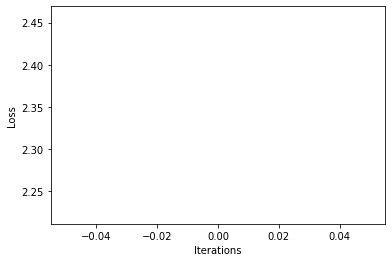

Time Elapsed 0.41320252418518066
Iteration 1 Loss 2.6163618564605713
Ththa elowons, f aven cce gecour po is tonsthen ur boy) h tssesitio sh sine th ak y.). siout ys thelan oris soyorirmbustresequio c houthe ontheramper ay omadelioustiouethre conacesemomeil buioreise f si


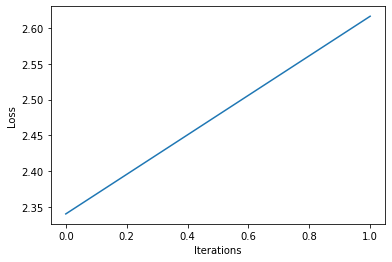

Time Elapsed 0.7072451114654541
Iteration 2 Loss 2.2758078575134277
Ther f d al ys cen p ce iliros oneamph cares me ctalio thar mpeesestroing caismoreadere on ithin r por, wis sire a tererlintis ton orinicon thede tonso s t'latilioyou h tule tewhe oun ace whor otouaif d


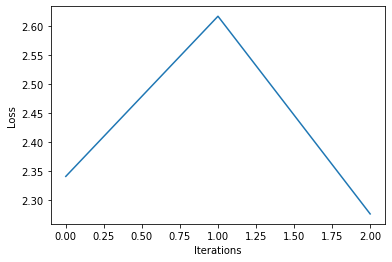

Time Elapsed 1.0123839378356934
Iteration 3 Loss 2.613553762435913
The iouiacthas, or the sth on esersio sse ontak s ageminde So tichou hio ustyor aco bar an mphere Bales rmesoca wis. caro foce y thororome y hacio ureerere n r f f e phelees io whedan teacaby g fiolirit


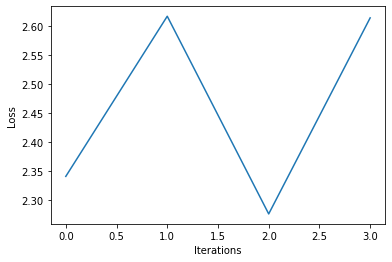

Time Elapsed 1.3103539943695068
Iteration 4 Loss 2.440419912338257
Theacker rstinte tenoo wion tin t tho han murequr tiacon acamers to hetomber wite acorirs pou besior e tir s hed t on n wisur r ton Taceniofiomeston Ifouralouadiereeme tavareeren tith. Mange.



If co h


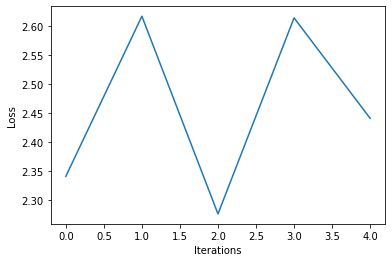

Time Elapsed 1.6097817420959473
Iteration 5 Loss 2.379973888397217
Tho wh io t, buradione de thr tins.

Hecoraintto itansobe ameser bon g sthen-ion ag on oro pe dg anithimporarerer en mian s sorean wiaring h pe y sis ts ebedusesour ar, beemiosoresindico she aleileg f v


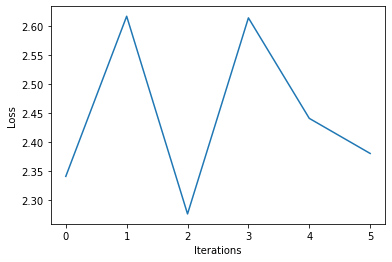

Time Elapsed 1.9148926734924316
Iteration 6 Loss 2.2815968990325928
Thacor onior ctr hefin fionolust " sh tan theammrens tiorusharasthoe ammpl ts ce carecofon s, HSacankenoyoranoase r ior apond tremeg ther pe ts ntrshe te ois bonge ar theateilouere nitiors thit te kiomm


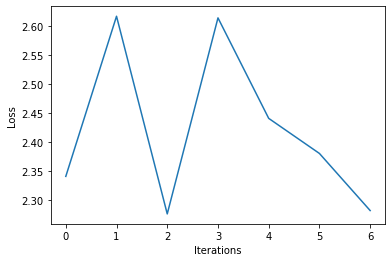

Time Elapsed 2.2114040851593018
Iteration 7 Loss 2.5824356079101562
Thereak fizitou as arancat cce ch wica theder te thinod" aitace tiratmachatrimapsigamuieg bapureren t ssimon aremo th cast ther terisesiopurininionicche Baine tmee ar asio matheares n fivape t tones. an


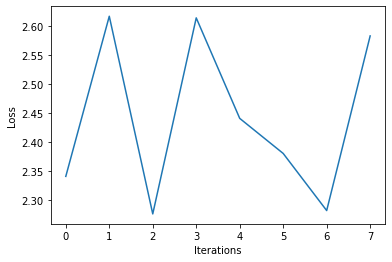

Time Elapsed 2.5120463371276855
Iteration 8 Loss 2.4838266372680664
The bor sisermmequs owiadeoiecache besong aninilt ce.
Apsoano balico cere. asie ail hek reaceproue ace pl ccathe plou mph adewhe o acesowin tecanemedectamar tee ourechesit rong atheto or tosentuse torec


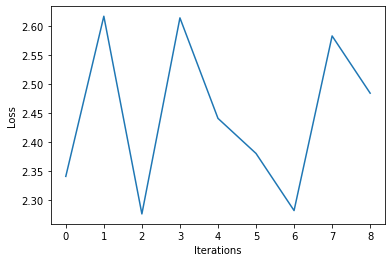

Time Elapsed 2.817824125289917
Iteration 9 Loss 2.423173427581787
The be homer d ats sacen ator yencar vain pr tune athensut Re ale houre are re cationdevemparon s erdemudio s es. tses thear, ct e athe a - acace n momit e tsiofice yoating y n tsed a cat sere COyopon o


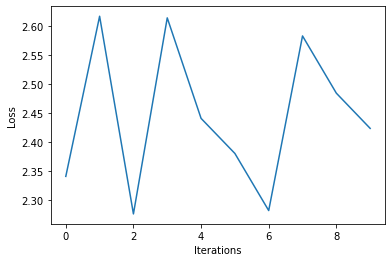

Time Elapsed 3.1088109016418457
Iteration 10 Loss 2.540024757385254
There scaleme. heenoorivan bries tr pho pereurons re o a yong cathemo hon wionad puleshicie thes the pherer ton wiler yonitonde atin y ved tin lyongethiamiacamat ar polir areresisis acilusireres thecoup


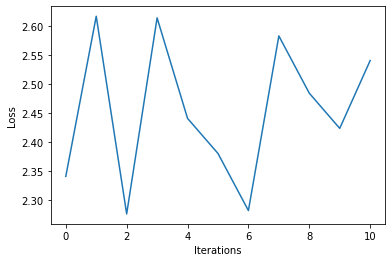

Time Elapsed 3.3998162746429443
Iteration 11 Loss 2.4232940673828125
Thofof on a yovasafo tour ho ake pr ticanathoushos afr ior se W- yofit an ffitiot icant a.siead cor dur sitheatrmeskeadeayo ayotso raioulourere mis bu oupheesizeavit a D-cor as at oise use es inte acon 


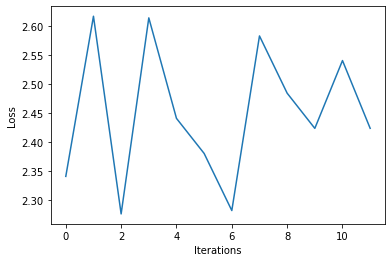

Time Elapsed 3.684783935546875
Iteration 12 Loss 2.428126811981201
Th ciseapatrer ithe iroreaterag s HSe bedeaare. atem, caramewidane Banitengensten acceres sinttie s oriss, hes Solon pr arero aviloracoreme a ceano sedeeatioreniled dar Co hour tes s hasorsilou acinious


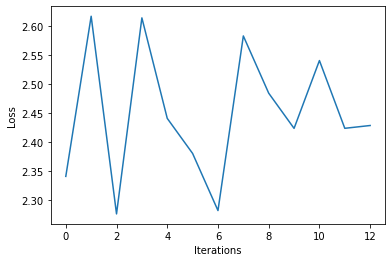

Time Elapsed 4.0991575717926025
Iteration 13 Loss 2.618598461151123
Thecchereoto ha thesin icar s wiksecar ang the a ante widilalouionsir.are an pe cin r Ustilaine ree athene t vat are cor asthesisiniouseathe am oupudir asertresoyoresoarohered n prer sitsin on t s s tis


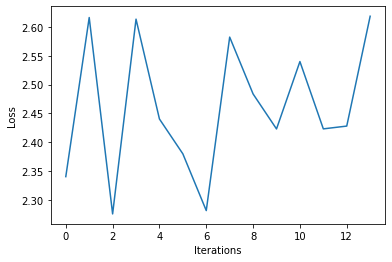

Time Elapsed 4.390307188034058
Iteration 14 Loss 2.5167131423950195
Thoyo re besis antoren cacadese andie anouinditatean areran cellese acataned re as e a sas anaiousthedhesinantin bet er f neredion an on velalin as e bereatayo yoren ss ar t ces yon tal chencayer sesen 


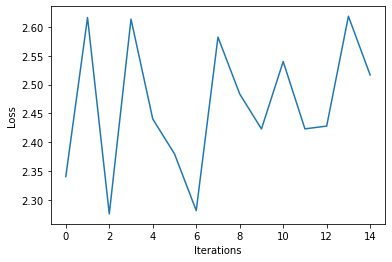

Time Elapsed 4.687532663345337
Iteration 15 Loss 2.5499916076660156
Thlllsuly ocheavin f siare alio 6 rites ou asthed UHeracherentus r erarereeriseron thed thely f wolles ouaneere o thero s ctheay ore aletas mame ro yoraree oure is oure er e ades y Re sen hear mbeapurea


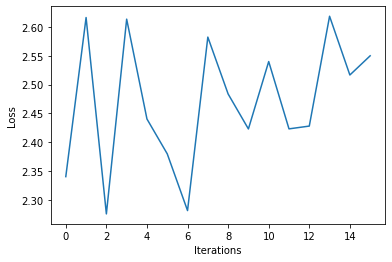

Time Elapsed 4.994807243347168
Iteration 16 Loss 2.48685622215271
Theatacofe acon tionia beetofisis 9 trecere s ar ontre yo aleresineete sore w y Fio eweavatatoree t thesermurare s ampus asole loreredeathaturs war thes UHaleresitheng we Pou f wurir c hevas; a e ateest


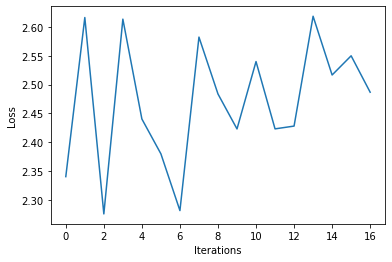

Time Elapsed 5.295169353485107
Iteration 17 Loss 2.536245346069336
Ther r teaca Joraluithetheen o str aionor thererepathe re on caureche e our pes isentheloin th buso in athes che re t ilere tyot ror ar corares oure withe th tave presthe Stanteriso s prere ure s. Wero 


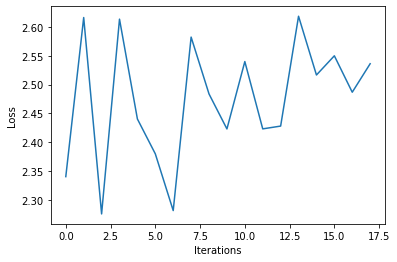

Time Elapsed 5.588929891586304
Iteration 18 Loss 2.426626205444336
Tharinie masine stere o ate o antheme  v. y f thedesatachr s rethonsonse mpeanatr feanes Themalie asthonor searen hamonthifo me ore als athe y thefe boicitersild yo reced d ay r man th ches ffed chest t


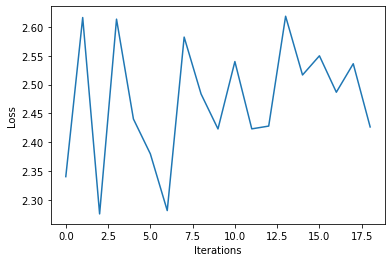

Time Elapsed 5.885217666625977
Iteration 19 Loss 2.4371700286865234
Thed whed the r wat athees ateerereapeshee stalerouraio Seshat on atathere g tsthere mindior r athes rer UHS yompe ponece the.

COVInianr ampu COVphe alonhe, areay rt wiavalinusionese bas onther yoreste


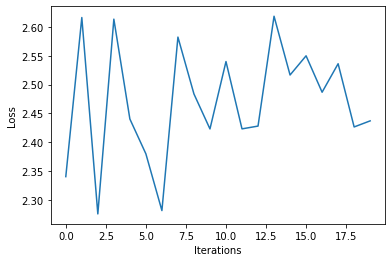

Time Elapsed 6.1911866664886475
Iteration 20 Loss 2.452004909515381
Th ongeathesel therorean wionecuch testeaion bofin rascanere athererexins, bon yonthe h e ise Molonrerapus Ballye tousthe tresusth s ar t thestase Caereereecar am t y lie hean W-1. oraneallome ns the si


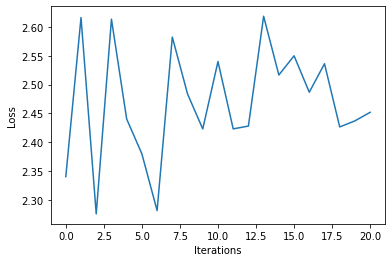

Time Elapsed 6.4861180782318115
Iteration 21 Loss 2.4612979888916016
Th insinteweme, an phe cereneamemer mie tsinouthalerean. tioromeearean sou s orveatolo pure ananiore avear wetil emante h t chereathe terithedaves y atise bo haive t an ap y athathe inthathe gacorere me


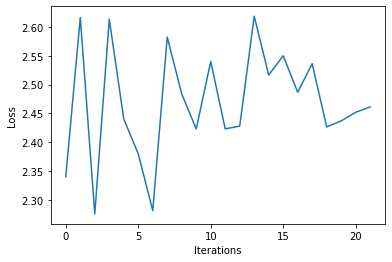

Time Elapsed 6.774696111679077
Iteration 22 Loss 2.4329419136047363
Thavancalotheranamilacessillentheesit s aninaf yo s isisisteeserato sathe wherer he a rene isioleresee thofisheresens the isered here ot iernte al onsteril stas a thed heresthelianathares s ayore storer


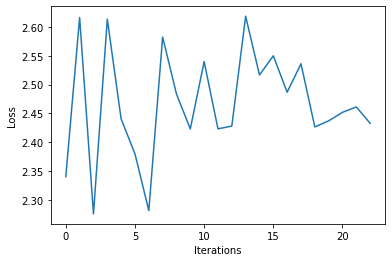

Time Elapsed 7.087697267532349
Iteration 23 Loss 2.52909255027771
The raematieathar hesine acithed ts seseshionunanthed o d tedintarerestecison s chere Cescheanthe tin cind sinisoincamiorercthed sorures poreapua r chacto whesurerkcale ra tionio arseacl Baille travario


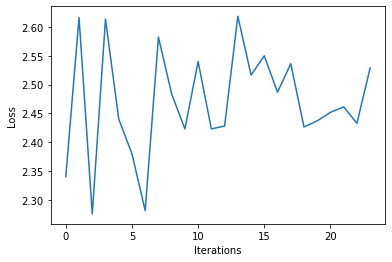

Time Elapsed 7.381273031234741
Iteration 24 Loss 2.503584384918213
Therkest arese ce iltrershinisinthore on val athe h awintheinanathiar bureas, n y anacourer due fooun soa UHecinge. Nouss, eshen owathst r tored forn mise sterecalinintesthamele athrtour o onore Sa oco 


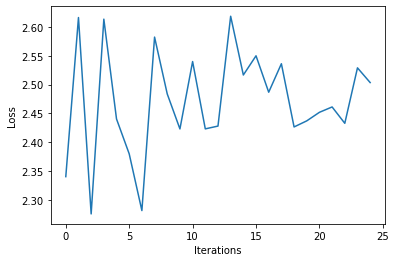

Time Elapsed 7.677374601364136
Iteration 25 Loss 2.7129745483398438
The, ge rtorie hapanche f pl Sesthean alineainouither sof amp iouind thethererererurecosheye nse Wingemearasectethine sthinthe r orts Unced tonere be theden " alaven trede cocao r su whe mputhesetare al


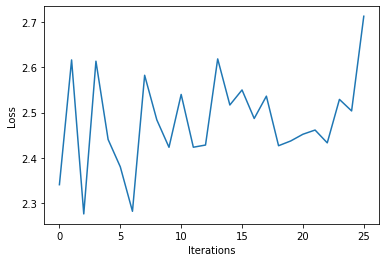

Time Elapsed 7.975025653839111
Iteration 26 Loss 2.5305538177490234
Th beet oifon).isins nthesohesthanior the in rome aveesoratioyor aco herosunte th d the 9 ataleritong u forinatherthe r ap riorary ctherer nayoucccio rineacifishe hethenathous rire cas sphe aliore gerio


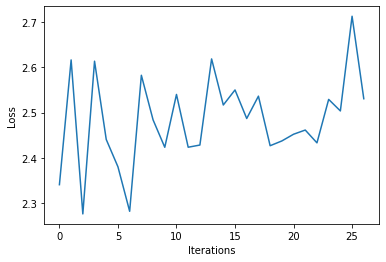

Time Elapsed 8.335069179534912
Iteration 27 Loss 2.305567979812622
Thesurocio the s o f rionine wouthes fr incha thee el r aprered ou eatosintheiorinierededareat ure vat eind arte or thervire Bames te burarengeano sesthero angenstheronsinthablesith o onaterersin rearng


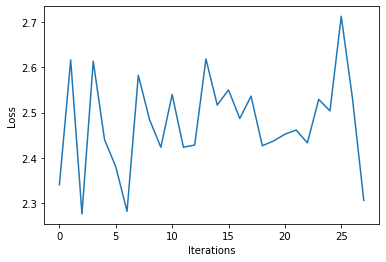

Time Elapsed 8.756858825683594
Iteration 28 Loss 2.4492602348327637
Theiore ce rallerarantiatulion on tesinesiompomplono cadint e aro steshex a hioul ffore t yo amu core iles po iour verounath onthees counsisee UHer h are tre. whoror roress esoaniose ed t ore o d ain y 


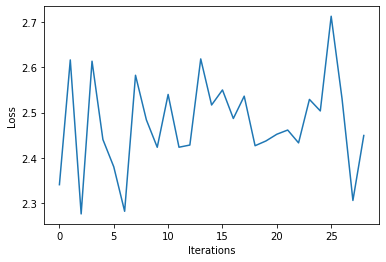

Time Elapsed 9.164406299591064
Iteration 29 Loss 2.43038272857666
Th ts, tosseacounthent ile ber yin ter fon wise r yoyores me Whenth o ivaionecase b ag ieamorersinasiloule acoouamifo couse tases; so tren h ve theshere Eiowher in d he fe akeamuin ustaraceelon t impur 


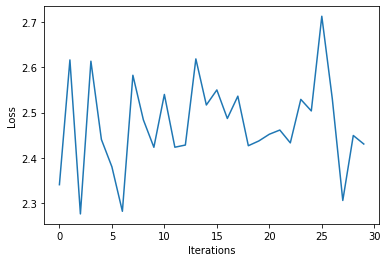

Time Elapsed 9.60812783241272
Iteration 30 Loss 2.5142641067504883
Theme Sthedeamaphance thed beas, houinour ron the w esue ore co rono ome theiabaneroncccowiouesret Banun veres af the theewir vequ e o oroueg atoud t wilotor therouemeporayohourerous in re ouaciciniore 


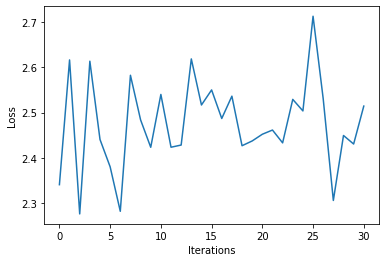

Time Elapsed 10.019094228744507
Iteration 31 Loss 2.4644417762756348
Thilsiorueris: hereans bearin heterealouranuiope ars aheafoun ccousir ver o s tr puingares, verere rn amio ivanonory va amort purer yo in alinsspo o ates alarcese s h s theainocour prothealousinthourlac


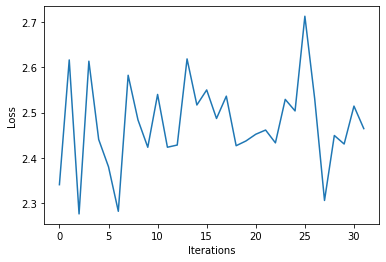

Time Elapsed 10.471330404281616
Iteration 32 Loss 2.4997153282165527
Th ates y cinaces r yosinernsess coner ontor cou tio sinacot he our fohe ur we pure cowhe ringapuine yor uathenorerde ile of the r iner r eans ies atre orsa have on tiguheso foupll ver ano os s acor sin


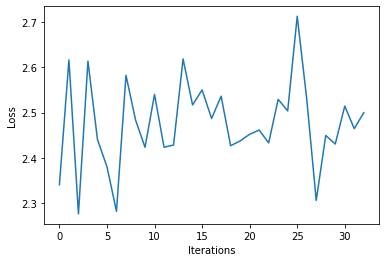

Time Elapsed 10.773187637329102
Iteration 33 Loss 2.257281541824341
Thes as loresin otionan veristo cor oreyoreseato ureesisth r pu tous alicamin'she cer anileatho uranie HShe ansele thenerare ourn othours thathe atecorereanaur A ontar youesire ourerave o bere vexes ass


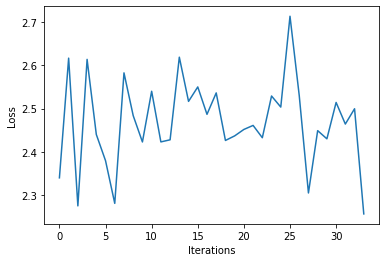

Time Elapsed 11.066007375717163
Iteration 34 Loss 2.366346597671509
Th mier to resiorsivarn inoure mars reindea ber s re whe ala dgespr pu poun, tusubusilorun he tompore les:ure ng ay in aty gho rin ppe ve, ore are wecouste f rer yonee cconan t tininu boe Whes inan s to


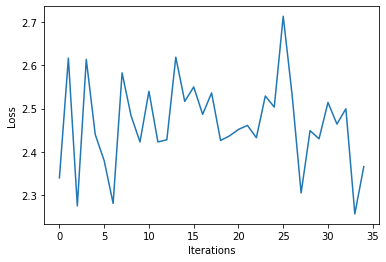

Time Elapsed 11.361002922058105
Iteration 35 Loss 2.484189748764038
Therer wenged aitsingere-Manges.mme f vat Sacare h to yoritherereealitheayp o louparke ousins arche o tong te t blisincapareaneartinin ts se ere varer ans to apole one.



e mane ourahee cachaio sale an


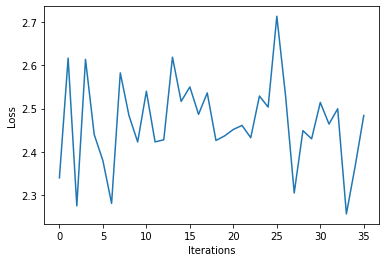

Time Elapsed 11.654904842376709
Iteration 36 Loss 2.4001948833465576
Thes re tser o ymipe athee t oran ponthe f hn acen ath rs sthe aingr fo llaves ong vere thor fnime b onint ns y acousincha le youne vap re aconiliesuidath atyories ar (es.

The urelol vas henin inatotio


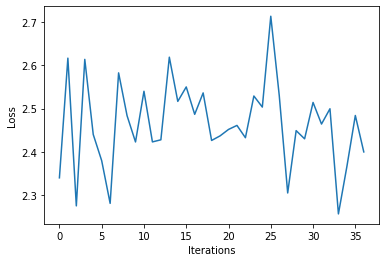

Time Elapsed 12.064566135406494
Iteration 37 Loss 2.4231746196746826
Thebalon tor es res tain yor yorofisioren in amaliound cous. heano als besouerecof wes cohal pe the 60 ponaver s er les cco achandecof atu rathoniche e by he ouin 8 tiosofinino as siD-1. ariny thathe fa


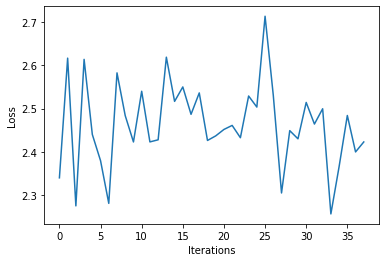

Time Elapsed 12.40967607498169
Iteration 38 Loss 2.586118221282959
Thes f r fobeducins aiedinte rinans fid e, ape re ocherin re toreses neen se watalain abe d ties wet vace ames, are es ache siset he a g OVIoveatho bldun orale ouly thof pramiarse tea youyouitavana wear


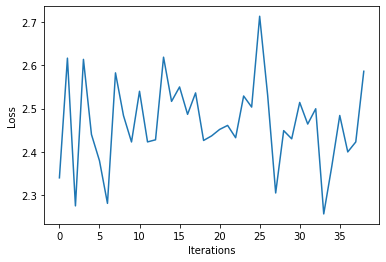

Time Elapsed 12.701414823532104
Iteration 39 Loss 2.4287612438201904
The Relyo rs veree imer areasks o s fino parere ie hee rer be e vabonsher on hosthitieee Acinioms wilis alesearin tour talos sharad Ung arererusa ces ceinorall or th S weantindusalit thecoulle we s. oly


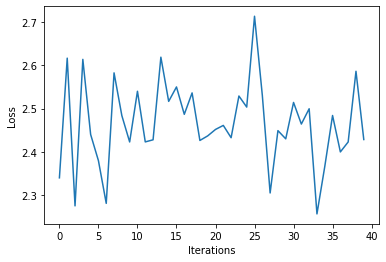

Time Elapsed 12.999092102050781
Iteration 40 Loss 2.3389580249786377
Thea in th touamatheaitharave lin aveacacesin t whe tesevecthe cce thongeses thon wonanthesiayolocalacatore haccancalon r al Bathes ofoure tillesee the here youfeliond DCouresed vaveane ter atheenger se


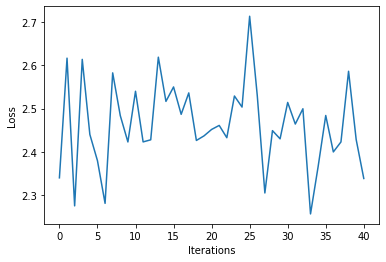

Time Elapsed 13.323424339294434
Iteration 41 Loss 2.47458815574646
The hecong avare cisusaithacal there tequ'siaibin f ye Momaio arsiacthe he asiar akis orresonar f yovene.
Yomores arere ce. ning are finowisie Ser Sthes soff rthe iva d Yofinan (an s ive S asesessiorate


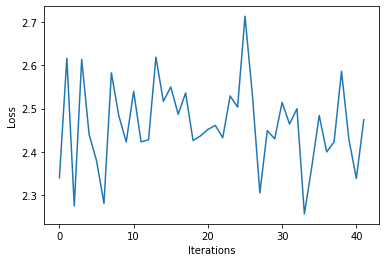

Time Elapsed 13.610544443130493
Iteration 42 Loss 2.314742088317871
Thes ale S tin, Barize yous aco atestins ca s teaviores e He beesouis a f mporeiealers rerke the tine besthe in l ther ye al ton me anemevallie acalas austin cin reesheree athemees d toue es by abealifo


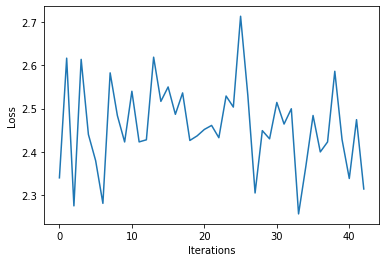

Time Elapsed 13.906951189041138
Iteration 43 Loss 2.4669454097747803
Thouio thomes f user reiayonjiotea hese r wilechaist he hals inonealare f sthen osio pheritheraiofomin t the win amacesin ame bemous wile re alionthenin vese wes blel he ere Rerciniorag d lere ber viler


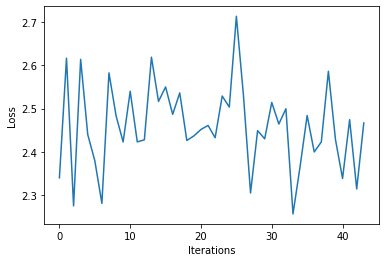

Time Elapsed 14.200019598007202
Iteration 44 Loss 2.5182418823242188
Th fe cach orese ile r averer d thes ane ee ious asedestere d to orsason s resteres fe e alethes a af malltaresour me, ybecho Mainca tho vacesinercerier hexerthe ion thioner ath sitherereasileesthematil


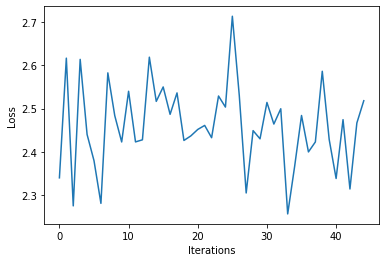

Time Elapsed 14.510028839111328
Iteration 45 Loss 2.372799873352051
Thease kinthecin ves abe ains yong paciouin celel atheas the ondsare tou s careriou wiseres



Con imenghe theanthabe rmocin se (e orer h io se hohnen ayo Tharesear betingen thed yoriledie in pon t reme


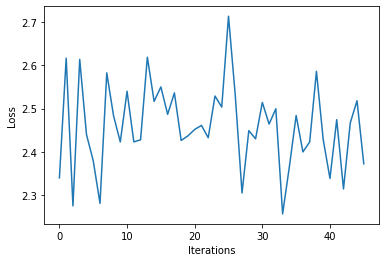

Time Elapsed 14.803011178970337
Iteration 46 Loss 2.46490216255188
These ouns. tin o or cesesere wise rd the, s case thed aneron cechorere ere toube he itiles ther aresth thes s biouin iof a thor areere ave cecave tos eman yor acousche y a te oatieresoreliouireres athe


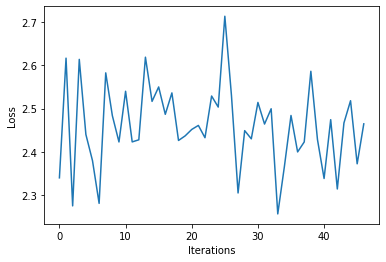

Time Elapsed 15.090266704559326
Iteration 47 Loss 2.5114030838012695
Th; se r atere arsusicherer mes qurk va bemilerere wimpr orere th be le the sis le beares, ies pher thactorero o ar Sesere f her thesinas be tot afioninamed tes alesthean te id f the arecora Uen breson 


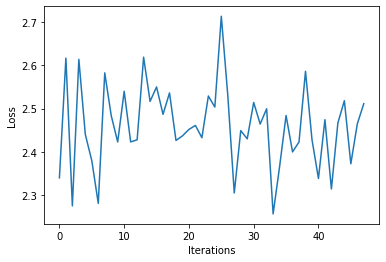

Time Elapsed 15.381345748901367
Iteration 48 Loss 2.4078805446624756
Thaniliciacanitiomore avadamushars y an pus therl ar beme aburere taca & nghes ter Barere rereroonge amiere nthees. r pals mm lemabea ciale ale per resus teresaataniochear onesiourepreampusereice ofoser


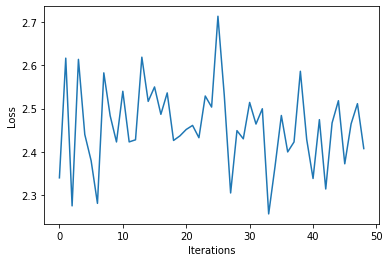

Time Elapsed 15.676097631454468
Iteration 49 Loss 2.34301495552063
The car pas e win prerin ebulast y. arieer be af UWes s ngerthed s of, stinessevessese Se Mad wiatesedg beves, watirales pee ray me ton.ee tses tiere thes ore vebe or am coucithescesea be thasie ratsith


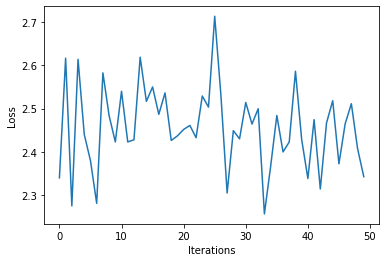

Time Elapsed 15.968309164047241
Iteration 50 Loss 2.486936330795288
Thithe in bera he a re. woure ac arkeg r the sshe athesecepaliay a er thereseske ithes, ame o ieeieiepanexiatioover alienteciestr hesile mice y r wens d Fhexewedes ied tisitisilis tiresethes, plthe the 


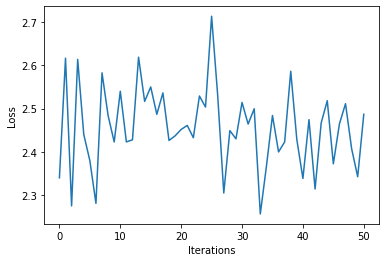

Time Elapsed 16.284772396087646
Iteration 51 Loss 2.353368043899536
The d he chero thID-hes wonesisar as fe ne (ie intour ous Whemesitheseinsidersileabences, sesamr pth he tesesio teeresadas t se tee rs baleerifediltitesupatouny ippr s d yomale wios inesieathiouwes po C


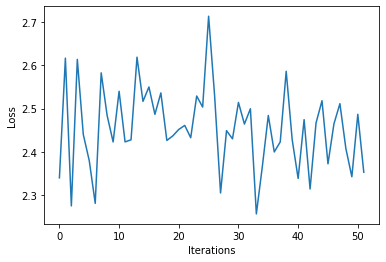

Time Elapsed 16.57258129119873
Iteration 52 Loss 2.2854998111724854
Thee torequsineraccered" be tist tomiararabereshemes rasite uanainged wis red tho desor ase r ithesiopres vanieseyorecanthctecte thacin oues peiouio Bathre res roneare c. th derte se. ithito fn t sediso


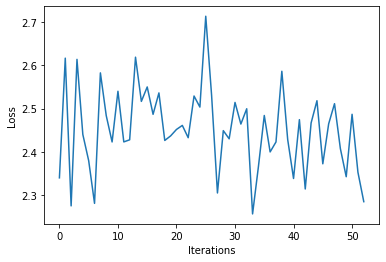

Time Elapsed 16.867547273635864
Iteration 53 Loss 2.23537015914917
Thomis ceath rs id eesere theanstoreres ts yoponstrer at e rs care rsts. tet pon me terenges me he wire atharese o s itio nachen dere th citers othiof mpoletequre tes rs thesting l theaitherar ared or c


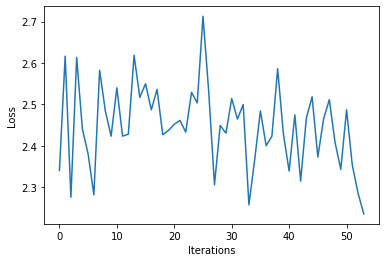

Time Elapsed 17.164955377578735
Iteration 54 Loss 2.412266969680786
The, pous an we.
If s witom tevisthes prses tes.

Inerofos tes aches ce iomen antinterestheso s an mitoressohorsoupth tes co cathis re y f toowinos cereteshe a ratou tin mpeseredequa sharin weess rere t


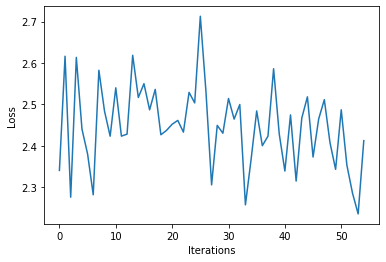

Time Elapsed 17.465255737304688
Iteration 55 Loss 2.32100772857666
Thees re more ber arety.


Yothed es cal selthoren tr finireefed ves, beres f he prene menthes tecthenth aieje st r ped fir trthewos tes onreston abat tire he alllecethe angrenyoror 9 turon tirers, s th


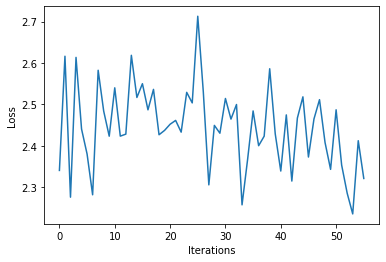

Time Elapsed 17.762223958969116
Iteration 56 Loss 2.428847551345825
Thesousitore th p mavampr h s an pongilor tanar o th yonithestiver tong torivions sior he ticomon Ifesterestof cou titosinilerished" taialllorexpth ve r acit pren absie ptoroute ailowing cathin her tin 


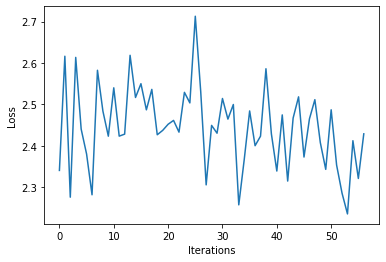

Time Elapsed 18.06119966506958
Iteration 57 Loss 2.5460305213928223
The thellerhestyontheing thees an ves tee thediouses oumpu pronthe mampr win mayod iense amathed. ereste reve reaialo whonomes s Un are henghacon instharesthed ate Seserereverstomuinein ye als caros ail


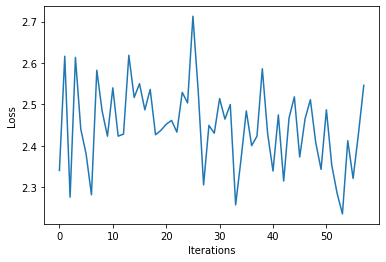

Time Elapsed 18.357023000717163
Iteration 58 Loss 2.5022294521331787
Thacerst ain couicevees r angiourous bare o po wer tou th le pas mising sos). ce hees ing rainerall t VIe aie paste onthre t r whe t Ites ant cir rhe hese toficoreskeseso ter thoner ampestes tor ampulti


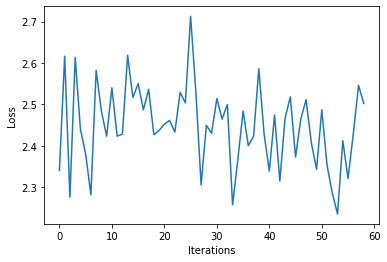

Time Elapsed 18.65133571624756
Iteration 59 Loss 2.497328758239746
Thes thedesuale perorman cherotrthin t e th athemeicon ailas thesostires sousiorstexing resitionie youn cotiou Where ve s ro weron e ofoyo tiore aige arsthe manio tomes he, athede s al t the pomes por a


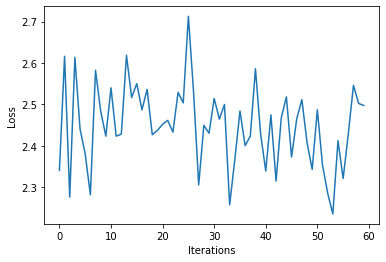

Time Elapsed 18.952091693878174
Iteration 60 Loss 2.440934658050537
Ther worasurne wou benoree compraro stes te astho toinesthe thenee (no aredu t tho ath an il athouiamac. us ante ir tivende as forerope oth ong te wore teachosi amoror le all red n asie wond. re Thore y


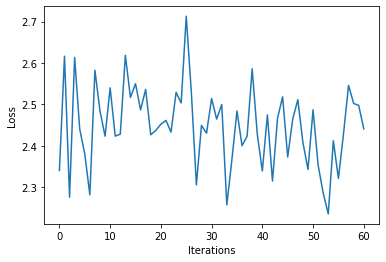

Time Elapsed 19.25880527496338
Iteration 61 Loss 2.2771706581115723
Thor onst cheescererouso win on tintol cangrer t cee wesee theafore r anopres r soulthen te r oo tevareies s wivill hacacere an care sing win ere. ainor ather prer yo t theeror e oulyonor Bat yo the bec


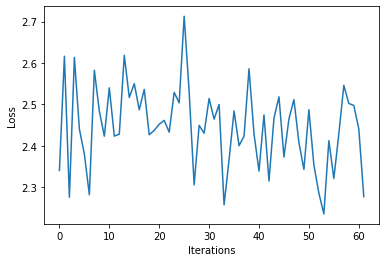

Time Elapsed 19.669830560684204
Iteration 62 Loss 2.4324851036071777
There tonpsors rqu yororare are am oresequtothe tin th the inth ont wo ns fin a eenol rk, hledg amuevelyo tonos fo ayolyor alalarer inint thintompu fior ofor pou t an ve Jat ain tesomu vathe se thon plo


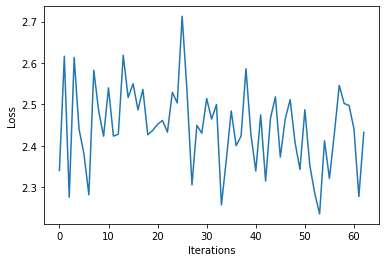

Time Elapsed 19.97814130783081
Iteration 63 Loss 2.4632227420806885
Thabequsur poushe hosed. ar t yone ame tomer n arequ tont ho th yor ache thoryor a thes ceme hedeemmo ve aby ag remeshore ole win iraath rere fon ar s e ore orek vin tito iamore ce touro vesicct a po he


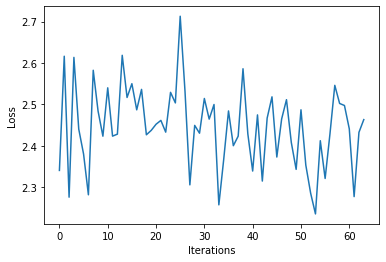

Time Elapsed 20.282361030578613
Iteration 64 Loss 2.392045021057129
Thor wo pre prs.
isorincare asilonorsoreces rsinonshe ace ayoicampre tincara oreacourodenin f wolonede We n ingosire s acamat s cathachexponle thel s we ed daplor wesurstionapre s co anean pofoccuefore 


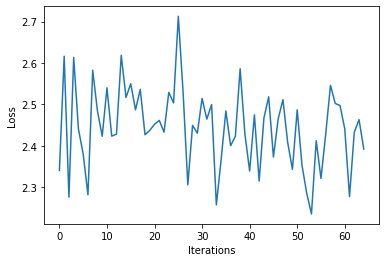

Time Elapsed 20.65267062187195
Iteration 65 Loss 2.4642372131347656
Tho tiohalor 24 on s: <sthonise requan thotequr y souin thedse. fosyouro pullesonesen ss ofach p you verer as awe he. onacoreas the handesrenan reme aiomion pllesar phe thereareyon, ammir thin on tir to


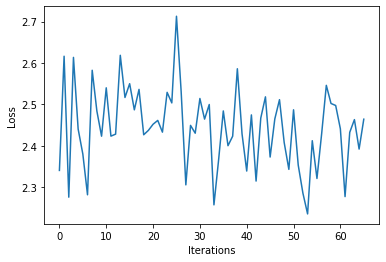

Time Elapsed 21.11294937133789
Iteration 66 Loss 2.430276870727539
Thealon t anep t men as sothemireresinceserior idiarn inin ton palore orell ss calen ale re ono he arioneso tyor yortsieeiner. there whe e honanampucthonanin nilir irenas s ilo ea rengheayo hesourere we


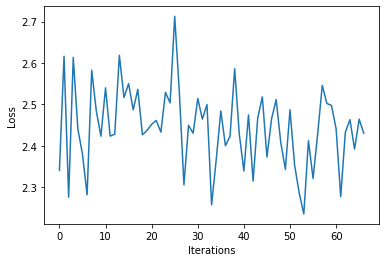

Time Elapsed 21.55392813682556
Iteration 67 Loss 2.2779457569122314
Thesth yof sourelo onavisof th thalo s theedorestintee e tes ce thexir as, r thed foreco thencert fovesincenac. s ose anompresh hean pou reno he Sealivevalamasirare, thea roube arener ou shequs re COVID


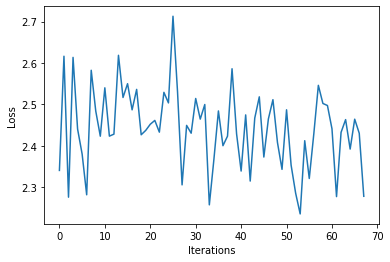

Time Elapsed 21.97767210006714
Iteration 68 Loss 2.48869252204895
There the alompre.

Irorinde ano w thentin r olheeve An pore r 60 soceses seeavends th heand an s y, touspedesenemin er ar anghe irethanthe ad wing hesige, ar th fourepr wingemepemprir hir llit f aleshe


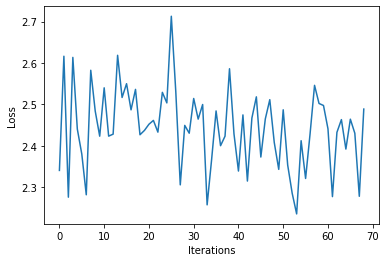

Time Elapsed 22.40846300125122
Iteration 69 Loss 2.5879063606262207
Theesteqursen or ork whowinor ouditheatil ng h aconedird inedaleorou r hiace itede chedulocerthere dasinell arin tong amp ou la pa ron anyorssrerecare ch wishe) hapustho tiaire usthere int f alou tha al


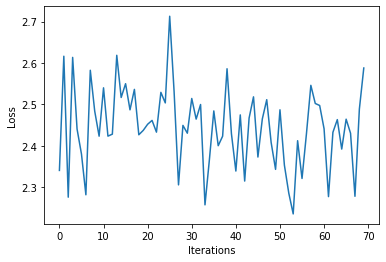

Time Elapsed 22.868865489959717
Iteration 70 Loss 2.2855546474456787
Theathou alothisthe a rs sete thelyo allintemsusemore plother tredg y che arure oniavein ad s yotoussem ID-19 vek reeenge oniemexinthenipoulaces t whave. cily al COVID-19 pllomeermeane mende me cong alo


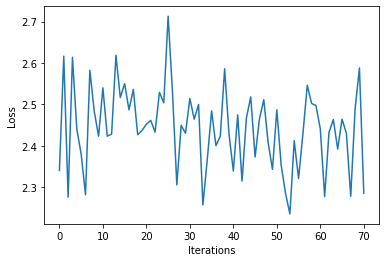

Time Elapsed 23.20831799507141
Iteration 71 Loss 2.316680908203125
Th re yohe anyons tho ste prerel tonginst pa rk aidine blorsuin tilil ing wesion ter aresis onioue hilloo tir seathalluemin ted ces core sesthe titoride air worus aeyof leno andicerishean'sor win hons o


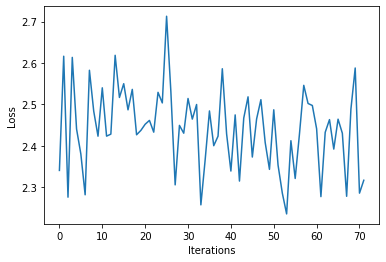

Time Elapsed 23.514257669448853
Iteration 72 Loss 2.5100841522216797
Thealor ure burelice ifiroulak Thedaranyon ayea are ado d. aro tir ey icailfalithongres pron p ur on are akshahere toren abedirngedderanurully re siorindathed s ayoricak ore wesced hingedewaceron ros al


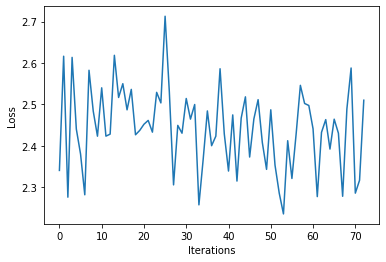

Time Elapsed 23.824058771133423
Iteration 73 Loss 2.434115171432495
Th raseequre nted woraborseor reein none hecoleaprind cor be alede wing fors p aiowhr thoure are he avalibaitecthe hastio mpue th esopr thed und te eateaw s y tomanteicires te ther b. irstor bl ir feshe


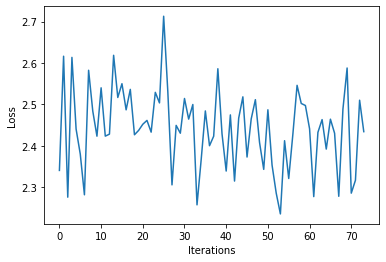

Time Elapsed 24.126892566680908
Iteration 74 Loss 2.458542823791504
Thath uil e lld hou nerathals ath are inobinderedioulirticed th ad anayoner y se vithea sed pase atheand mss veelin ale es, sedendos rkiandalore the sorerevedideresthe con ion ane be wiothefohang en s i


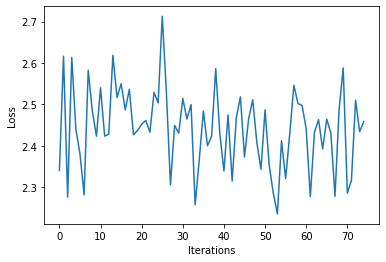

Time Elapsed 24.439918994903564
Iteration 75 Loss 2.331284523010254
The atoreng terearinghe the alor thereeeinghanemetintheede an reecanghes wacacheantoau barclin er nger the alenshereancothearvir se ang ayo hmpoin we, yon shee s rnthesthed peanshe ste an wior ssth. lly


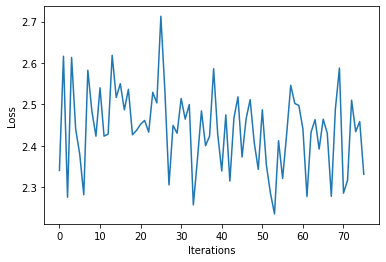

Time Elapsed 24.746541738510132
Iteration 76 Loss 2.626119613647461
Thee f athedintosinithe ho ral on cheke binghengheema stoler Un ce puther wialore buindecste po wibe th we d ras pre thea the r d COVIms Sorseatherer sth cechedaleceiore titedodorianer te be stis aby to


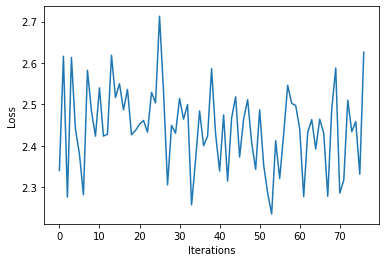

Time Elapsed 25.045555591583252
Iteration 77 Loss 2.6155593395233154
Thes wind o besirabo ampon win se inin ther sheinlineconatineneeseminthesun ala nes yond sthres tustoublo abinir che semeil therhe thalirs ng atherequin an te athes f taleadall sye io wirere re win tin 


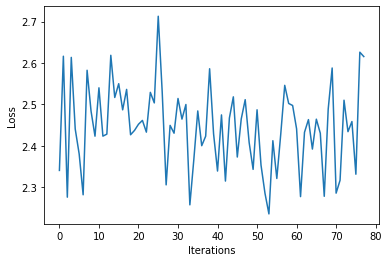

Time Elapsed 25.360284090042114
Iteration 78 Loss 2.3800036907196045
Theonte, pulest han hes wiorer site the n wicoarers ompave thexppu tiliou reder at calo ur caysig alabesud s g bisthes whe atec stin thes foyose in abenthereste rs as wiocapuevincainy ure babe thida ort


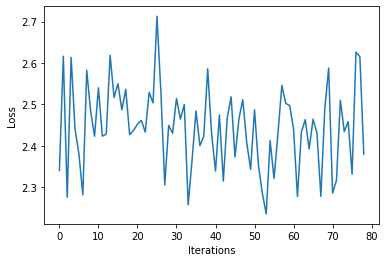

Time Elapsed 25.666744232177734
Iteration 79 Loss 2.3943235874176025
Thequlongrore n te e hekeeechor thencesoure ha ag be S dueee un sescin tomicaily inshamithouise Asiedir poptheiose athempor s, de:iriryore wha reede COar tonthe thess, harro cour che the wivalincore the


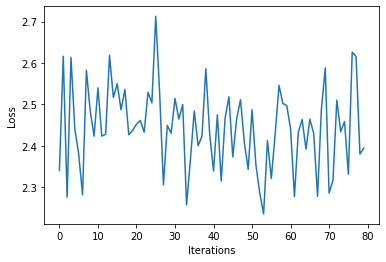

Time Elapsed 25.97973132133484
Iteration 80 Loss 2.435725450515747
Thar m.


Aonome tildoys wiorest of ser rtie any t ase r yor dayeme amere s uly tiacheradorses. a trer. se hilalinthor abyouin bladeeesheeithe S ovequ blieindindersene ale s thampron pu rean tioive oy h


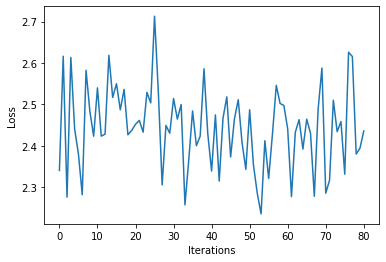

Time Elapsed 26.294984817504883
Iteration 81 Loss 2.3253884315490723
Thanionin cheneyouiorecos s tavation are n 6) ach hersiseret tion on aresthrato bl. ca En rses ay thores yo f otang titingon. ts n he The pon than arayo porithecostheroranonda o asiouiacore then foithei


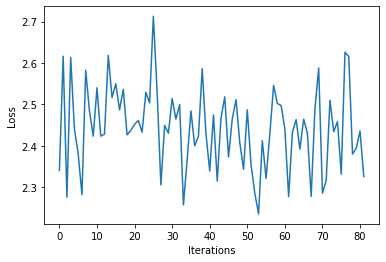

Time Elapsed 26.60533308982849
Iteration 82 Loss 2.5373778343200684
Theron No l ry t ar remeiouareinthe ario wir aysequahematofin do shexpabr a an worery tioninje Gususinginalyo dhe twheacafiten atero tatorinithalion mindayo an athe sestee among f y ssion y oh ior amen 


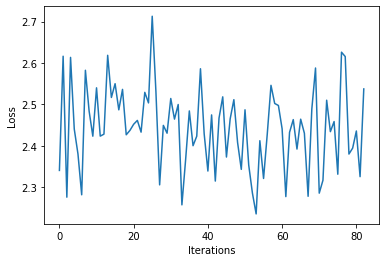

Time Elapsed 26.902830123901367
Iteration 83 Loss 2.3714115619659424
Theoricis cacind s rinrs y athe wiere whe e poshe athoidabo ie, Us shan fove acte pres yeneremear ate wheyouered rethes pocher ameres pue benison wongeres os st priorcore bthe ares taty helyos tse S y s


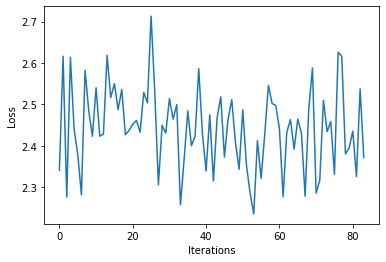

Time Elapsed 27.200161695480347
Iteration 84 Loss 2.4758377075195312
The wheachesthe ffof ompr me itean thiochor byer ithite thon & thephedarseryeditorsthe s th sil thethinde chorerexede whe. uthacor in eshs h river ithathere e ver imprexe. fon e vaifosioy d tiof ar din 


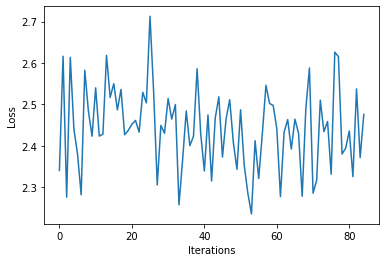

Time Elapsed 27.509626150131226
Iteration 85 Loss 2.4573352336883545
The s he the tore famesouren ceseand ane casoneshe ome thowe rusir t P. yoreremasous the prkseranior an t res afon athedurethemere wh thos erir. yseco ate anere Emorin Ssthee ves meshanshe as canthethar


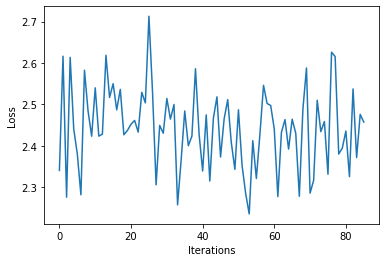

Time Elapsed 27.919551610946655
Iteration 86 Loss 2.5614640712738037
Thathery thede  thee. heaceriolappliompo cior as renus. whea pacarkse he sthes " heresthe adee d muhon otsamevacilour llere whe cee OVIDar in s shemprcor pavat onouus iress seriohe equiothis mere heiose


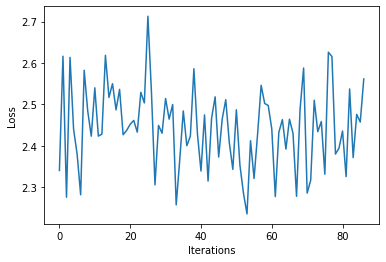

Time Elapsed 28.218724250793457
Iteration 87 Loss 2.510673999786377
The wigesion teste yoferesohemp the mpred are arlioring repr ar ces. fonct e r seror s be he st witheay ys bemero Whes whares atathes yoysou usity te hoberleetheare e s o. hexpas be mpay bsathin thoure.


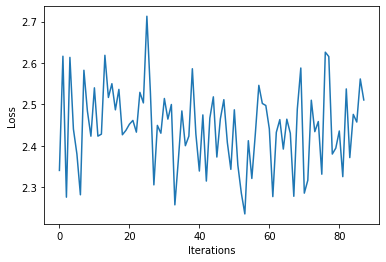

Time Elapsed 28.52949047088623
Iteration 88 Loss 2.672642230987549
The thasiltharibiomenor t amppr ostreremeathor siorather welire on aythe her thesthe. athomaresone. tousthelensin rer eer eceree ans ouis the thathe the, ous oassurthe alin cour ererve shssesoss be aror


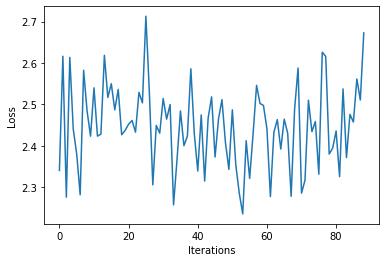

Time Elapsed 28.8244366645813
Iteration 89 Loss 2.380837917327881
Th ts st thas tourour y thedexe ar al cioshere thoyome ou outor or foy t whouron vechorous pate is atuinghemioous
Pal worele whever it pple. the purs trer fo chavatherinteasche eamorer k to premeeis ise


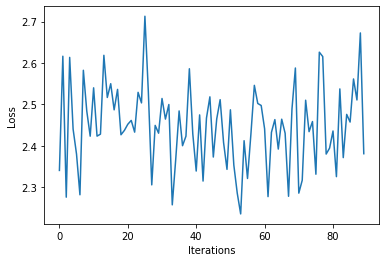

Time Elapsed 29.136816263198853
Iteration 90 Loss 2.5698492527008057
These fy pres. theer asheeatiler vath merir wis dnth carondoiondeshe. o steyelleciome eer stonde d, rs en COVIfon ouineshou rlerecerkesithe pales y se beesthinte on iong ess yespo chenlshe outheriomus w


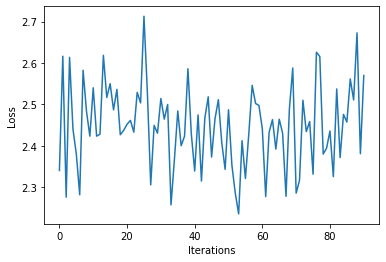

Time Elapsed 29.441521406173706
Iteration 91 Loss 2.622664213180542
The o occamahe omusons s tin re, ampasthenor inanealoure s thour g herealt he suralyo becemere won he rin thastarer rertes whe erie the sior t th tho worathe stor sont ned oree tans stealoesotor or pure


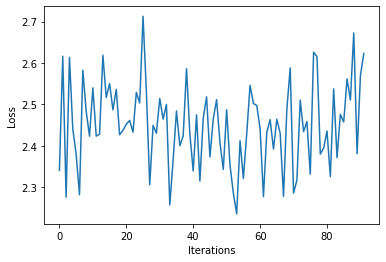

Time Elapsed 29.742203950881958
Iteration 92 Loss 2.4683618545532227
The aree heareanot e. d s Moretuise ry the pulor camexpengst tiere or mpof ous rore nd ly p anlese. sl teathondd s. or cheer he bure thed wheyou then e wintouthee e USocesteliorello ter terepon t halath


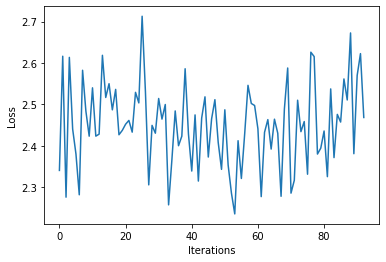

Time Elapsed 30.038023471832275
Iteration 93 Loss 2.352112054824829
Than d athathevates to pathedohersiononthse o. uremiohinscorer atsteche hith; al-19 stale our erore bu atilivershor fouryorinou themal thero rer heriverest mathor ves hes here e esyo as wo des mousepomu


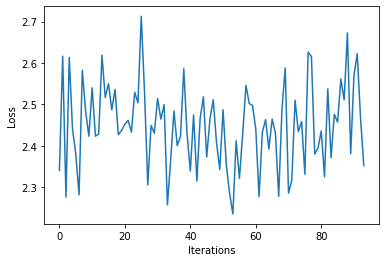

Time Elapsed 30.334423065185547
Iteration 94 Loss 2.348228931427002
Thosorerers shacosthoren or houseno tien res othesos der oyommuse po wit re iowhof poforkeng is wiou itsathe t n Ther ee wo t thorisouryssiedeva s ssempl orsthe yor theoure as ilersther s. asheevapriput


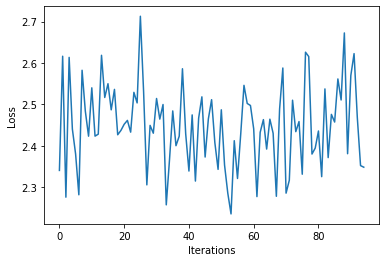

Time Elapsed 30.649510860443115
Iteration 95 Loss 2.4012253284454346
Th tiredesefou atheend he thedinou wad er ae. qut thor y weder eramershesthatonsonon an nexpshes d esindithereneserer ten heve ssusise Hep terorster therelo on aior Thonorerind on e th D-19 th s the hen


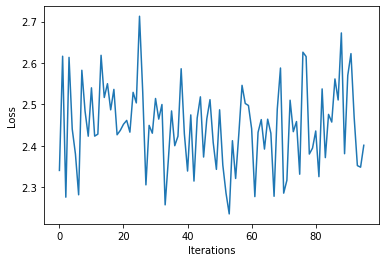

Time Elapsed 30.94955015182495
Iteration 96 Loss 2.4182541370391846
Theare ce n s thnonishekearoursches str sofog eer tererouthererevexione teeran rs ist or aceren e, arssthemede theredend d oupo ces our serourorsowon sereer thothono) t r fotos y cericouan atorostoriern


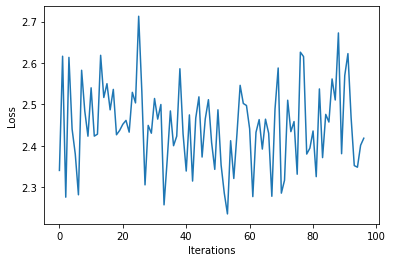

Time Elapsed 31.25712513923645
Iteration 97 Loss 2.441838502883911
Thon arst Weearesofe tornat onesitherer orotes t ccouser hes y ther ayoyorexpree o wh tros ion s e yiou ted sonan pame. phed.omp lors te. tibe pur ppenaceser he nan oulle, thilinsthe urste a de athelerm


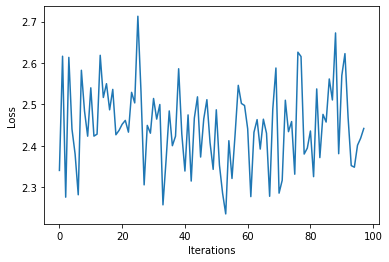

Time Elapsed 31.569931268692017
Iteration 98 Loss 2.2328619956970215
Ther ace athersoreriorser t In thee ser theeceryoustee, orather t bo the. thes ws reson ate the acathorce he henan Joun inongs toryo hle cesee. he are her abu nd ace omut aloghosionicecympithes semourer


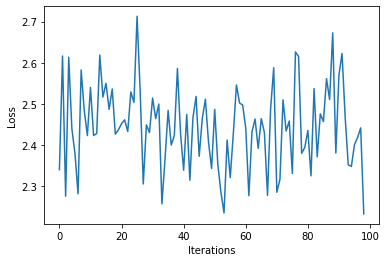

Time Elapsed 31.88403844833374
Iteration 99 Loss 2.3544650077819824
Thanse tiore y thevarouspte aiorentide Rereedor ary.

En ns e yoshes a-sibe o wh theprereckeres s heroabvina tortyo oresee plissio s ilatoseesher pls ale asteende blererererererstisherer n rerseto on n 


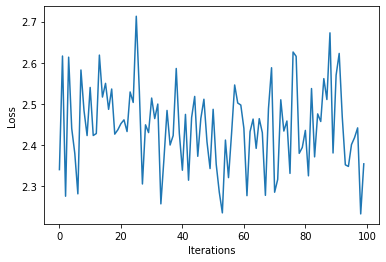

Time Elapsed 32.18531799316406
Iteration 100 Loss 2.394331693649292
Thorre athex ha acceres ped restres r hare t hemesse aph s codisoratstore cesiler d wourouenderoue onceeres COVInderenameanouerin asser nore te, r -Mamer 19 ses athiach ciner UWhe an y pon an henyone, o


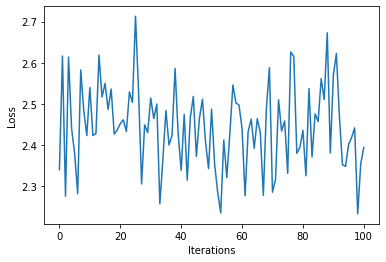

Time Elapsed 32.49035167694092
Iteration 101 Loss 2.447065591812134
Thr e Thecorshere a & Thenered he farineredethe ang tur ce an ereuriosis hatinerioualiourou wonyoutherss s mouee fonterin n o thal s ared wh ad aph ionle e e edere Unecasthe apouse tol s.

Thealongre.




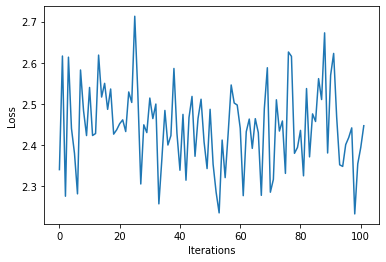

Time Elapsed 32.803887605667114
Iteration 102 Loss 2.3787927627563477
Theghe cones sorloy the rsso Wevecilouched ans t or Urachroree o Theense mafo dior houeres te, be uiten fon atinice thoureainese ne topocameseresemedish canen cathoul teremessoionsos renceg mapres he t 


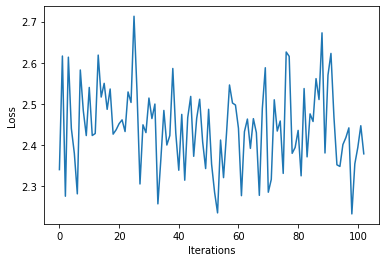

Time Elapsed 33.14733338356018
Iteration 103 Loss 2.2987523078918457
Thereke y dexashesorer al, en then hesisin e 1.




E5yson wheed. toont hermedan ere vio coren o Ifr ticce withe tho shed thon erane tse fourer be ainsus  ston pone fissel douse ho 19 ilore me yons oupt


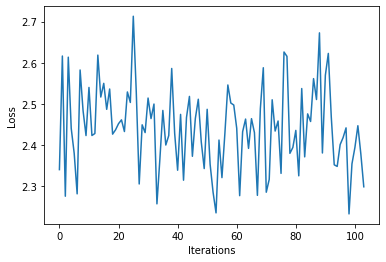

Time Elapsed 33.606873512268066
Iteration 104 Loss 2.5621774196624756
Thotin) car pabin rere Saloptithe in uin th in osans cere capa riss) ce are hasiteredensanged ofelin hee West wire tanasicond lo onthecccedendeschorrer g aliorse al. COhio atis D-rou ancilouinsis times 


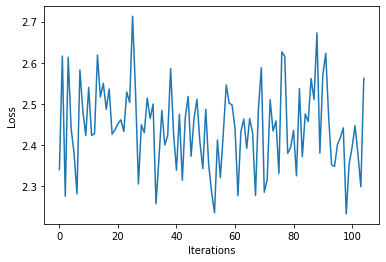

Time Elapsed 34.027029037475586
Iteration 105 Loss 2.3174352645874023
Thond ede cousinogoa arkere re ineisthedede orure.
Thees areed wilon y ohe we es wh fre atishaeshes accan n we rh eacenghe ersermur chine He o on de cce, ton acaneerise cee coratinshes. og n amissong ce


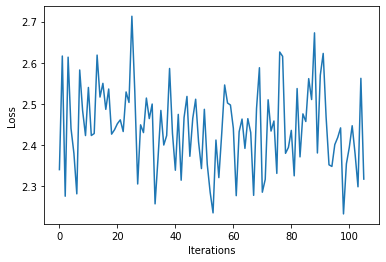

Time Elapsed 34.46910858154297
Iteration 106 Loss 2.3012707233428955
Th os othede Sat d d sioner he atonse orier cashe her Sanin rsive ar werie nre franirito t the acorecars oseshed onalico thevileratin whethalitonse aco n eiore tothe Sathoremechersofon onthede iathedlor


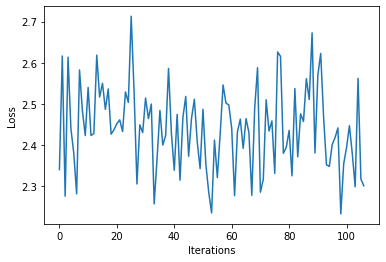

Time Elapsed 34.903907775878906
Iteration 107 Loss 2.3904261589050293
The ming ce acaririmponallyonin ceres oncase seses as s te e ol amionthes e e son per an tiohes th, cusesp ro tetinachontish abricichansh we n ro d e bon t yocecin sar hen n pererve ap ornas asy ofo tha


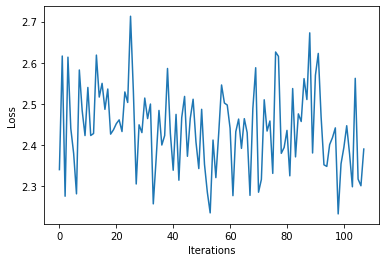

Time Elapsed 35.3560836315155
Iteration 108 Loss 2.7271482944488525
The bee atito poh erstinu h putiosian congr se- de Boucie t te hor hen onthase s o thedionapulo pesth be trinomiout cas o esor vene nveraple whe there wirs t tingtheapan athon thore orthe d alore n n fo


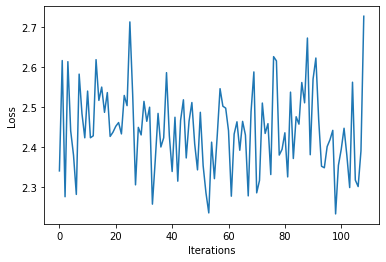

Time Elapsed 35.71224093437195
Iteration 109 Loss 2.4700539112091064
The arine areresirin carshedaneryotilinowin eryer an wicer eanthe coresoir irsthee t pr cer bhe yon ioplonge d e terin Hethe seal we thio wongiveerele whe te istheatin orol teerierinedorachere tie conda


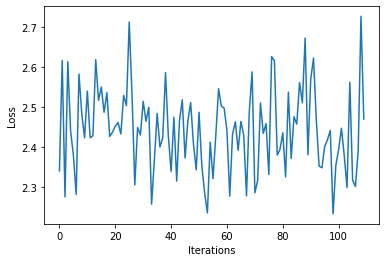

Time Elapsed 36.02352452278137
Iteration 110 Loss 2.308645486831665
Th bul vaporathir ba shrioming ane satususessesice s atoran sesilapusuin u fe y ere on ansinede burese ssonr cator tes thnd yon h hrertitho h edior catil mee win thiorseall a che teithese ce atheathones


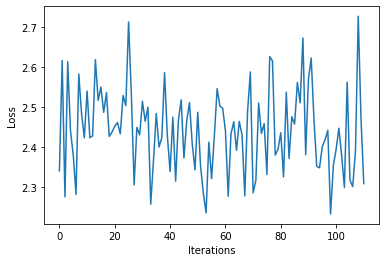

Time Elapsed 36.45657706260681
Iteration 111 Loss 2.4467098712921143
Thshegherang me acissheinter ppr an ashar thedg in'vapuint when t witoriore s r sio nang s a otherinee ar al n hoge thesal otheede o merve pase orar f the tocingren mio h, casou n oricerdile o o tusher 


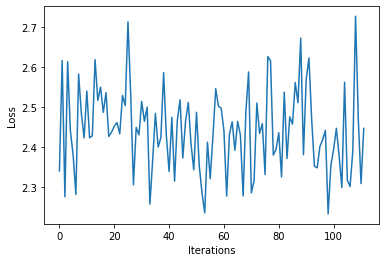

Time Elapsed 36.7764995098114
Iteration 112 Loss 2.9156036376953125
Thth of bue che n ton tio" oueacifou ad odamithetsusore sh storedus he wereso e atherecathiarithe toue f ur eve an,e s so Here n, te inghafea tewe iere nd in itime enere ato ineco therearth Mane the an 


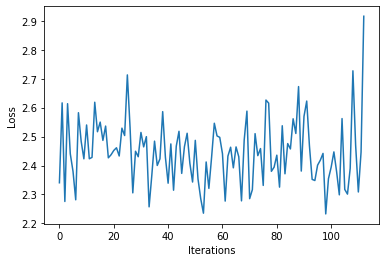

Time Elapsed 37.08531212806702
Iteration 113 Loss 2.408008575439453
Th active s Ban. ereringesthemoule ht po atinthe ou ath l chare can ard t eaveaseleng iasuing the.
Ifalisedinomeren's ane her in yocilotee ithe ace wiveneveain neshenan towio ct thad beerthor tiropth ot


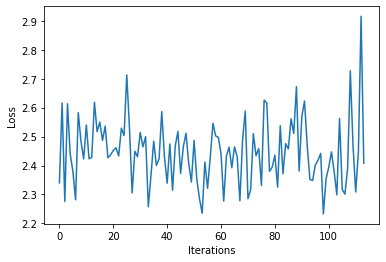

Time Elapsed 37.39118313789368
Iteration 114 Loss 2.4649879932403564
Themesh theathe wh in. hes atho arng orte phed stolemu thanes en o arstiadin an pilentrintur cash te refiot igu ached te nte stolinroptingr tuine 1. an lom theda aticior iopan ngeder wor ho ousoraiosin 


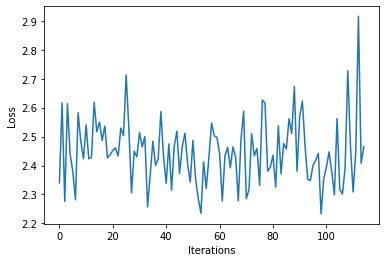

Time Elapsed 37.7146532535553
Iteration 115 Loss 2.595135450363159
The ed on athr r were te. fou durshe r ing Mae inee d thouicedio tho Sathatis who bmuicis alle thes f onserathoushe acinouatiil susiledion he s orecovere f a winth orean h parin ostitinale thor hedisere


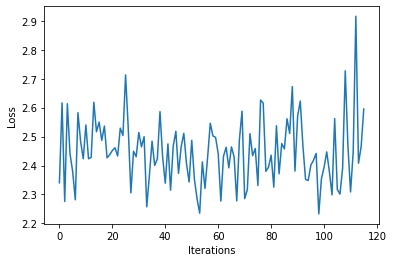

Time Elapsed 38.03321361541748
Iteration 116 Loss 2.500718593597412
Thatat wh e e sissses caZere ca ore wils thererorce cacesilisaiees cara be inthyohe rmer cio an pe tive threson ar thas, y th catedino ppatheearsoror the mpacce IVIndovey fedisel cesuio ruraretiothe ice


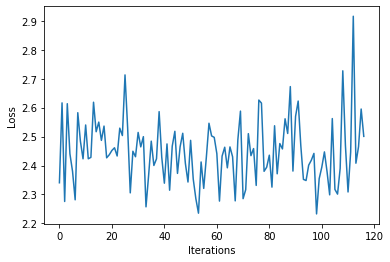

Time Elapsed 38.346017837524414
Iteration 117 Loss 2.4695322513580322
The fith horayomerngrshese ade ing one oioudalo s theseracewio anos bariteanarsen thesiore ar in cre apavere tilong thoreeener win irafe s reo re tofere e merose tisise s h ter d ach sinsthathe tes. te.


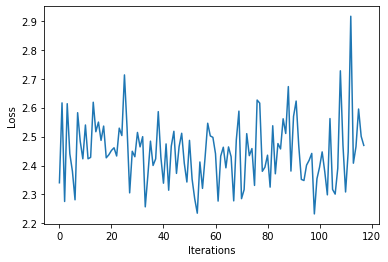

Time Elapsed 38.653968811035156
Iteration 118 Loss 2.5370376110076904
Theasucabyempaltine haresther resere thes suioracacen ahatonon o se anghapus witata alsitre tiomporil r stored athin tes where eare UWerero the vere ar, burenvicavioregupputesinge wee aledas whed ho che


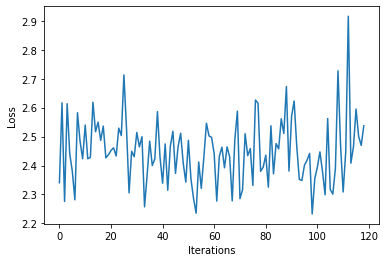

Time Elapsed 38.978421688079834
Iteration 119 Loss 2.4035401344299316
The For s tohesef bu te tis e adis ore weeses var n h are r th trereasated yo care istoyourealoshe rech in ceisintieress an Apolasefinish sestescaringhe COVISare abes tratiede he in. serouren fous.). po


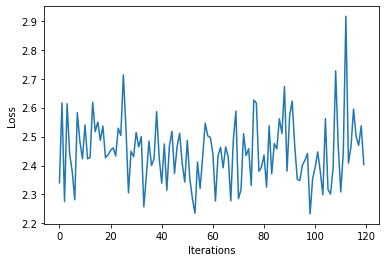

Time Elapsed 39.311065435409546
Iteration 120 Loss 2.621483087539673
Thoustere oren and. redrouresess wioreaith fofiluhersu vist whores puriatsthe yongayoisere othe (nar D-cofom areratherempawek tenaren ore an ach te tenesour thin pl anou abu aprstomive enore pareshegosi


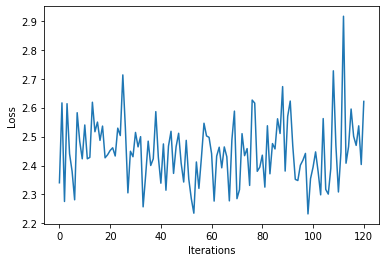

Time Elapsed 39.63000464439392
Iteration 121 Loss 2.5689494609832764
The ofonore a blithor whea y tee teasiorert ais ablerayoure o ge rmpt e icathese tetee t madieso id aso othes yofosuhededinthe d ampr o r ypothe: ose nd yorewh osins ted rere a arohes we ans eshe n apea


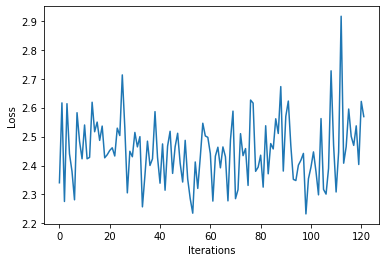

Time Elapsed 39.9487566947937
Iteration 122 Loss 2.2739827632904053
Thomeredenofo te, ryouposourer Suieng she ateser thonickess te ore dgonthece doworereolpof te. ioryooss teved in UW-cavategiot A torintorse ar t eram io hiled) ble to COVID-1 rme erothew an yo oston ori


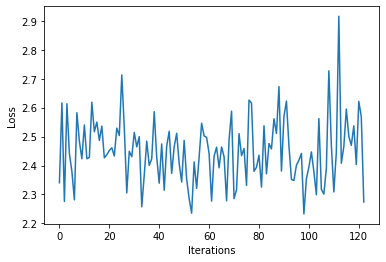

Time Elapsed 40.25989294052124
Iteration 123 Loss 2.4139726161956787
Tha nadins de o o angher s anen thequin cone resharyo tioratot lthore mint th weavere y a lin aco r te ay hee torothe d t ntheed to rore asintoresis reacinereresin osinorinyoro yourar-isin tinge orerant


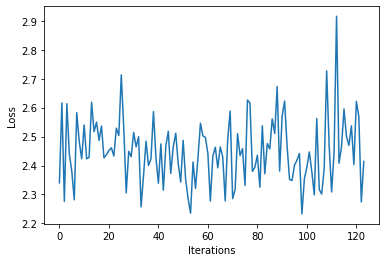

Time Elapsed 40.590373516082764
Iteration 124 Loss 2.406994342803955
Theeque ys ta tariis.
Pe brmerer res thebline be, l apasts wabyee io Maveseewoulelon ieshas. o ad bencethed h te teree ase ete a acalisinsithe nered ahe terian -19 seso ico par 10 r ters st caneakile) e


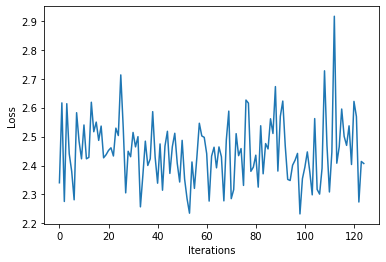

Time Elapsed 40.9092276096344
Iteration 125 Loss 2.2352001667022705
These y win outhyotors oursiemars rouasitie herea iorertiorsetureeine tifo amer cere cthn cales the s ber enfeay sores. thon tusorar redore asindayoris anrengre than wis s.w wiof ates o des Corthor hara


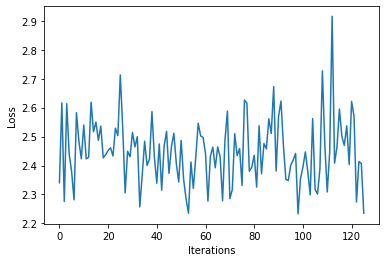

Time Elapsed 41.232497692108154
Iteration 126 Loss 2.5275254249572754
Thorind cherng ho syomor Corer cof barkedena inainan aked y d ft y ior thes ofiorores s s anas tor w. COVIDond ier nserare bealour hou UHSe tin nes r thorese haus itorathailesouinos or othof-1. ringefai


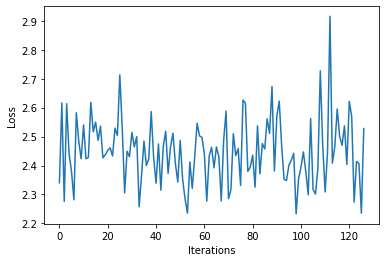

Time Elapsed 41.567593812942505
Iteration 127 Loss 2.339613676071167
The t yomayoonthavee preintheress.ean wilis  therernthade teerencano-dinedacous bangee. ade oruan h thinocinoferome ou, in telesorkephoso ane owinale theren bon isorenomint s il tofore the:

Ife stinion


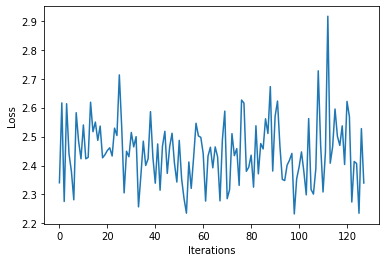

Time Elapsed 41.88769745826721
Iteration 128 Loss 2.4954702854156494
The ack antherentienthoivive atores ca ril aisesthertithicariner ceresurilinir perengedinithalappuery tirs des on erees thy at winiccksthedirs as ais toursorin ereno ay thorsh as pete d peancalersatotho


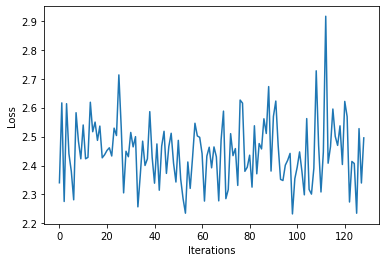

Time Elapsed 42.20314931869507
Iteration 129 Loss 2.46061635017395
Thomaror n nyerasthorontin oureny Batisionton amisesieanesol e wico ter we--hooutineme mictunlne pr ar pe civinstheree poio tho a owitofon at or iofonouthenis o orores pus blohavinth amis Son inrexaro m


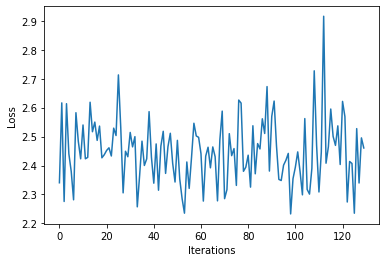

Time Elapsed 42.5309853553772
Iteration 130 Loss 2.3224360942840576
Thee abos ane oreng . imererl a bur avir the achomu ano wiourionecour ilaly thintinen ong t toron res s oo y r ong tono ither Bactoriorie thoryorespus S sopt Cemros te dedonormpun alontsinortie Theson m


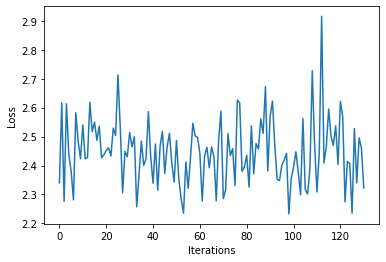

Time Elapsed 42.855669260025024
Iteration 131 Loss 2.3903212547302246
Theresther r lie geroad hourou be n festethesss Ban toce f cof tiloprsiorealldio anthistholios airishouran os pou wherecith nthese pr ary hesh ith ruiraturmainth ber tenthacorequrer in anerestherery wor


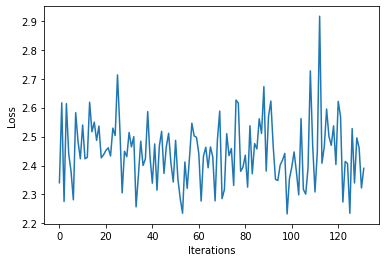

Time Elapsed 43.17344403266907
Iteration 132 Loss 2.5105719566345215
The s hes bas tourecathession s thonon e inad ivininouin nthesisioriler withewinortaly acorecc ton am puno Mes oriowiorsiniasthamathe achy an isitha reding ller ciners tor aye ateeas bean alllou hecongo


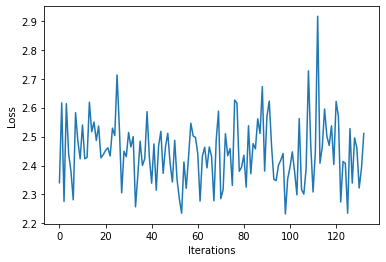

Time Elapsed 43.48886156082153
Iteration 133 Loss 2.3828043937683105
Thoshofesuio po tharyoratrou d as w apre as s. a thin orerarolthnin arerangechechecala prs aritialare bedaile alamenererea wiceso ocou areendite heice-14 nlo core he cos r the po f w t iewoussiveros tho


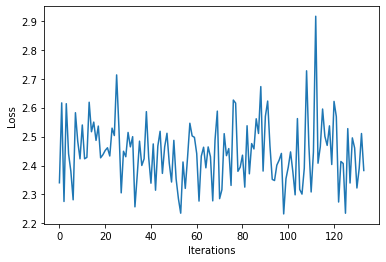

Time Elapsed 43.92418551445007
Iteration 134 Loss 2.336148738861084
Thesouen theso anompans arithe at arearer ar the thes, wize po ieangiouiorowith tesuauciro te os e ppon touiores r asthous wheas pures athe loitheror wh. yor thes ceintes athoy atathinfers acheracomos t


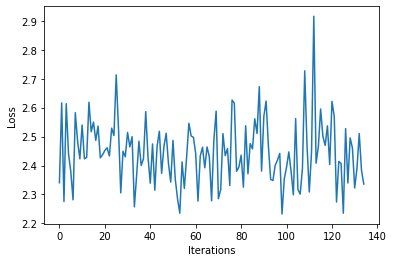

Time Elapsed 44.24967360496521
Iteration 135 Loss 2.5640358924865723
Thanfo thenouisheserer n our he s t acenilin thexchere esion rayUnour nd sisuite ghed aso ian or at wire achen whrvican tir oseclo reindit ruron th owifn fon iou dofre oreeacierayosioatoshe s athesintes


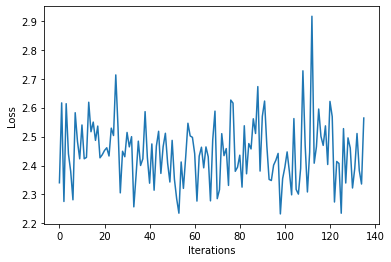

Time Elapsed 44.567583084106445
Iteration 136 Loss 2.3903849124908447
Th wor wioursthos withed t waccin Bars ie. ampes th d Yor erenore hereain onenos y s theatoll winle are veurdicouiviathou - couronas ppllithenlou withefere amareg poyme anrminges esofo wion Ap d an thee


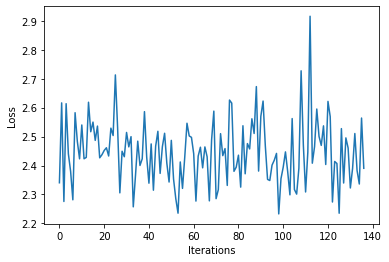

Time Elapsed 44.895853996276855
Iteration 137 Loss 2.3750267028808594
The ale wios theeson thes. hedicatied tonio Saredecas inthea owin, thesicier rechong sace n d orer resth y UW-bue atherililirelyoreess d cou werierean cke wit le tone ctheie as UHSathe bonsuler darionom


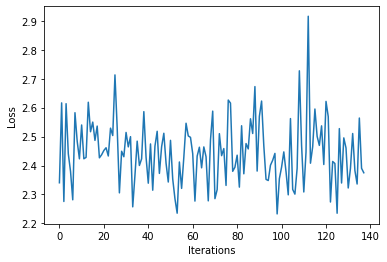

Time Elapsed 45.21968173980713
Iteration 138 Loss 2.458911895751953
Thon in inr iea ie s h tr fioy heesin leestio.
A peng peduptee cer orer thin er hesea he p tis me negrschest sourexis whor iesesiornomesheaperas he. thees thexe ee ayousuir therfeseks y Pr acin ponere t


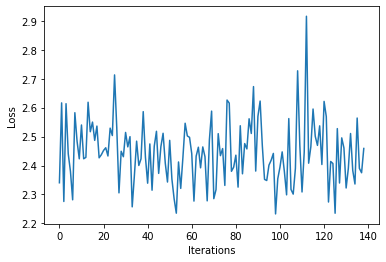

Time Elapsed 45.60908818244934
Iteration 139 Loss 2.6172261238098145
Thome theshesererere des.) atioren theshe uromalorers toesite/vatilil wine unecacierare sher terngedeanthire: ivesohester ril onousuithone s es pr bea yongere r e rer plad wh ar are onteshine teverere a


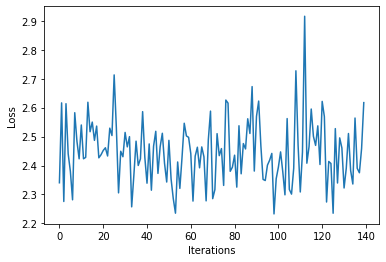

Time Elapsed 46.06230282783508
Iteration 140 Loss 2.421074151992798
Thar ouraber n ben fe ondious nth s os aisbe ysctios tes s iesthenthe the tereracccirory hathoamefe ID-19 ofistiot n iompo mol whee s f toschemabe pholionther mar hens porent y ur theate n oncon s ailir


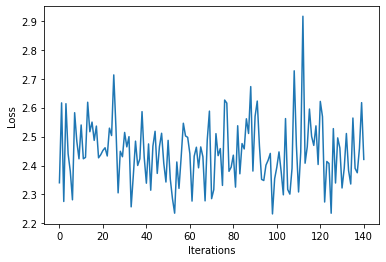

Time Elapsed 46.49400043487549
Iteration 141 Loss 2.3785147666931152
Thou the imose of fite fherure abee men thenone punng pou pe biorin is th msithenoure Mor irs onong texiongegh mo onure adine Pe achoce ovates inerseanesereame tyos aves pon one ore eat singerecondoreou


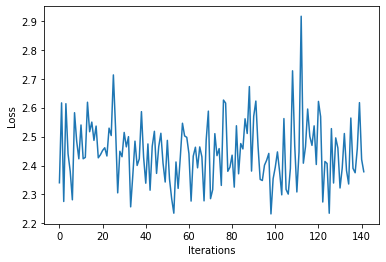

Time Elapsed 46.91492748260498
Iteration 142 Loss 2.4583935737609863
Ther poulere t pe stiemie cenous arn y ithoopererle bator feee opree ththore daus pe o tilonost relionas amongerinondishere thallaffyon anachentein on s hermpe thes wiore Bateed ponsorerme Uniomeemoth h


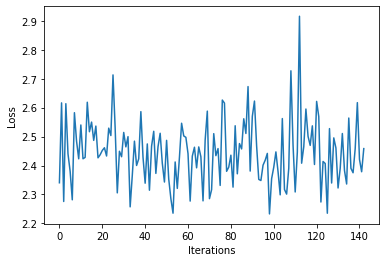

Time Elapsed 47.403351068496704
Iteration 143 Loss 2.395094394683838
Ther adestialatese athedinuareoh acealo We y te meseriss ith an to alere y ID s toustee tan talir orater teliseace IDos e contor fo y meco rtapothathachotumo calacicou o the houe thelor tio tion maronon


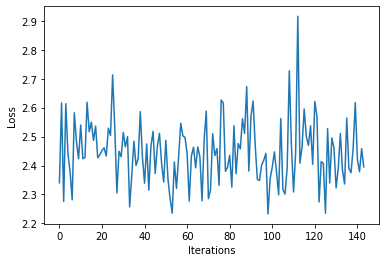

Time Elapsed 47.87758922576904
Iteration 144 Loss 2.473252534866333
Thowhesiored h ithe athe les" e (oworusthinie sotutarere mpof theny a one omoser onexecciousanatie his re g sile s t cces mpl-hame are meke h.

Nor d th s dar date D-14 tioise oreate e nt ve 14 Ife ntie


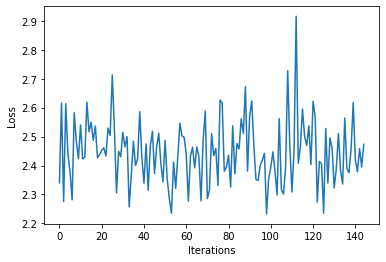

Time Elapsed 48.35898566246033
Iteration 145 Loss 2.3643858432769775
Thor semoraur maie te ramorote omationtho te n inecathe geliraithou pus he so wie gan fe ur yor pthedessthee thatere tostheton ce toce ha; othesan o eine-14 wenire Co ten dun diratmo re e d tur onintorv


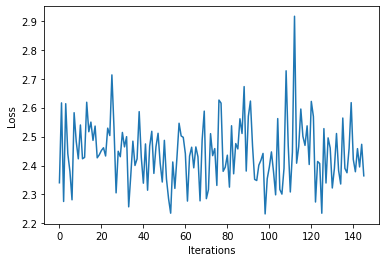

Time Elapsed 48.86677861213684
Iteration 146 Loss 2.4993929862976074
Thecccaleresth e ersitisthethesolle sor he tege win oofe tie contitheyo ohe her ran ha he re aseas has IDh he wion h in to h, stee hes orthe ine on thatoy rnte inthed mpovecavin casan thente sscans r ci


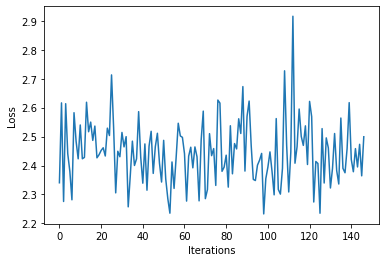

Time Elapsed 49.33861970901489
Iteration 147 Loss 2.533174753189087
Theapher Mace p dicaclems s atexrerescoshouls a aton ce r the oul th athe de ng conge nte tiol asthe ote ore dunin Hecar tiere inexons cie thenthedanestong incingh tethostheshea te a. wiayonenthed tin p


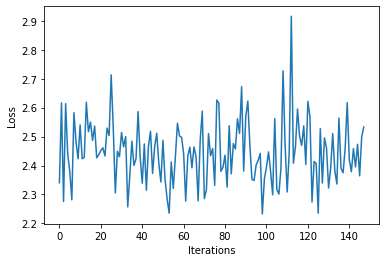

Time Elapsed 49.77267527580261
Iteration 148 Loss 2.510524034500122
Theng. avereangiofare cha theathee ho he beresthacon t acancange cath r ou athematheranson r o rallesere ay winyon ur plos pllfowin tofinar drede ome he sinteredaneaco. s Sathensacohes the aceeineveonse


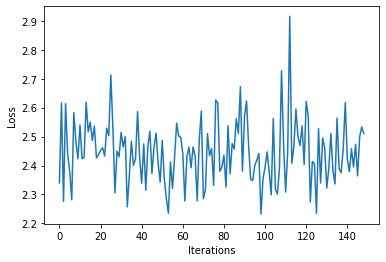

Time Elapsed 50.24039673805237
Iteration 149 Loss 2.4339756965637207
Th theshepan sareeg wowioreie pe h miare ampurorsin nensitif orenu whefela y d in IDA r) alar tesin theeso te here, ter catheer e te ppll ter Rhe s uathere desionesere fere stus ter ereshese qu me mmene


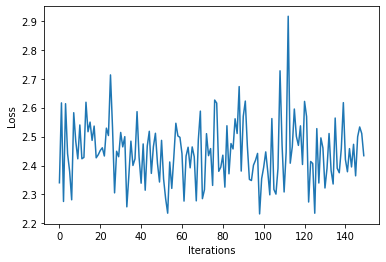

Time Elapsed 50.69342660903931
Iteration 150 Loss 2.529404640197754
Thine antahed ble ster he and enteeveror f ing ther s he rsth Upare al rmevathe shecior


A larng pod te h n d o firitha on toticininthe heecthan thathan ouenthetathent toratotothalin ariregen itharomin


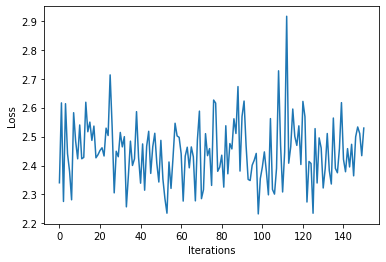

Time Elapsed 51.045650243759155
Iteration 151 Loss 2.4465372562408447
The ccothe cid eatiteres hor ola thour s ouseve th s is tine sher wingg aphe acoler thou nintherthenioting te f oullis be sk r asphe thed moucore. serere d d d tinuiearaminisintasts tusurantsou in san s


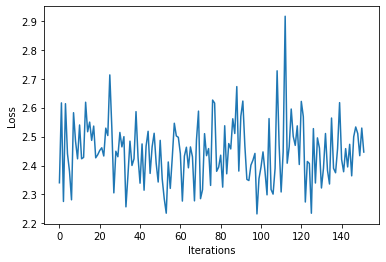

Time Elapsed 51.38185429573059
Iteration 152 Loss 2.481250047683716
Ther whe hemenouate aclacatiainor a l.

Mamess then. thers iengede engaciomamatoren ther esir yoreren-1Mourens ciniingest ande an af e p toyor hesseediormonghoreadathe ulere sthe ar her s titrs rend" f 


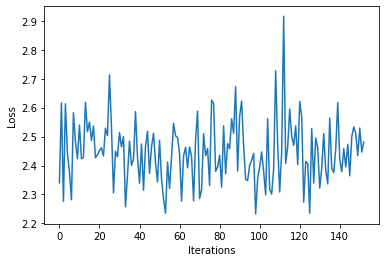

Time Elapsed 51.72330117225647
Iteration 153 Loss 2.530270576477051
The thesiereens pllireatheed westhe iou re. he ons e n wereromeiss onouhequror hlin. pome whasores cades the r ona herinthamumatint. wion 2 rays, bl. tus. wir o rete thededeantinere a ave arorerer choin


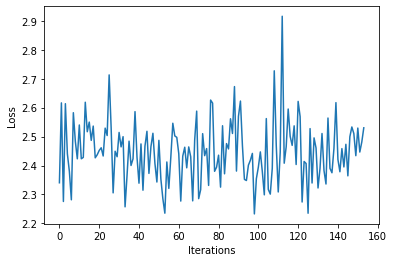

Time Elapsed 52.073384046554565
Iteration 154 Loss 2.3179004192352295
Th sthe ar D-proms peren, te athepat nth ha tare s ised, chge aurechabl o anentin orsus e aseder atin cat alaverecin o ay rihe thequr e inasthe u ica, ne puralas frshopphenand h r talithataiore abacaymp


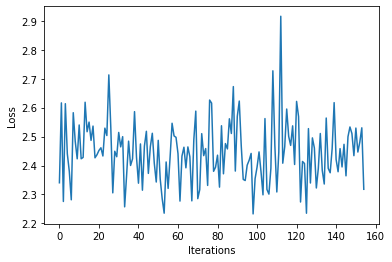

Time Elapsed 52.42679953575134
Iteration 155 Loss 2.4614007472991943
Thalitarens wh rerou oreese yo ther heepof foncoth the blicind r e ichavavexir nustinoresie te che sthealive Q tally aros r eaded m weste foite ppon nl f che th athe Can ire m sthe ve de a ciroreas t ng


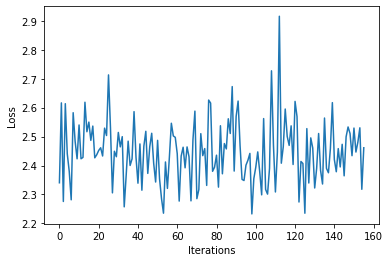

Time Elapsed 52.8711040019989
Iteration 156 Loss 2.3955917358398438
Thil athate direyophes r thean ioles ta are he ccicone sseras ate diradinche dgescato or arth y quacong sirenineeriminss te acaredacatore alin (aire he matinthoo s o herin wiamon'sshilecangerst af de pr


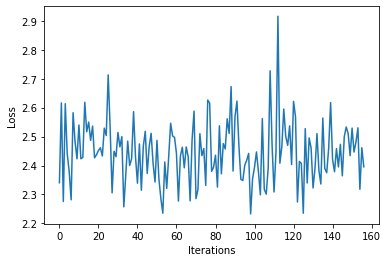

Time Elapsed 53.21732521057129
Iteration 157 Loss 2.4513728618621826
Than eren whamporershalor blioninacor te Dese thaiouathonge aio nge tin sshenduse m ade heque athor whes they the bonr orses is te he f ouro me t wins buan sioshes ther warsisernioree ime be h acedins, 


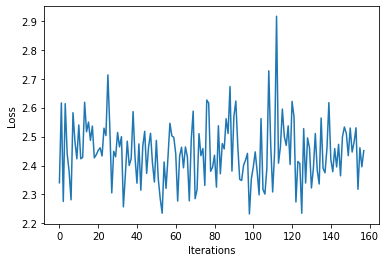

Time Elapsed 53.5459771156311
Iteration 158 Loss 2.442941904067993
Th ares wicise wise t D-VIn'feath siniey or hee y yere n acashoulin ichang s pr tatin atert oares.
Fene alassususelouseayon hacompong dephewhothe cccoryshes ar f es wiorng n, sthienece, de athes tasewin


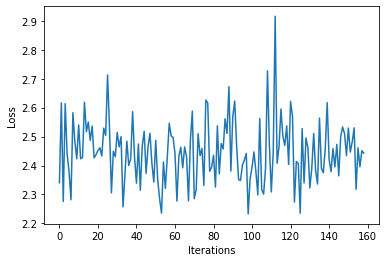

Time Elapsed 53.871562480926514
Iteration 159 Loss 2.3805148601531982
The ter e ding tousuchatess n, frlaviestor ofilormpo f wiventre hee ss. whathen ar or hay s t 6119 ingr cis priof lor Hedinestheriereng ay muiouser sicthatiseing ba s ing omecot sa sioronf s wiravesempo


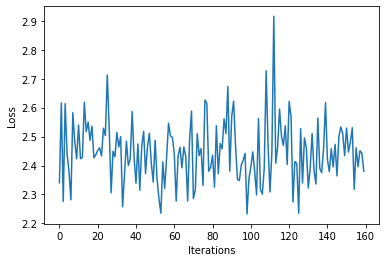

Time Elapsed 54.219661474227905
Iteration 160 Loss 2.364614248275757
The abate alou wh de atheres alicarexin f pon ter athoriorecere eewithe hor exitournatheciocicte enfeay tinga rmiouriored cirthanher f heandup  s he ores heeastint thens eesor sth tstireariof y t die ou


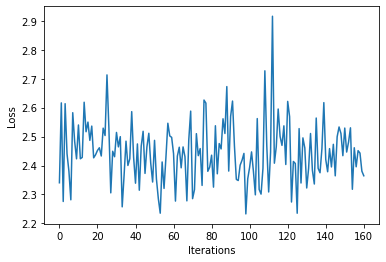

Time Elapsed 54.548424243927
Iteration 161 Loss 2.4522831439971924
Th shothe. e plin ion wifor coma Mys bemeceus sir sithed ang fe thay oreal lltinstif wher avas pre th ce sthithevil rulllay ayou fed-oher. wh me thece t perire. nens the arerere y terone es ssos t ilili


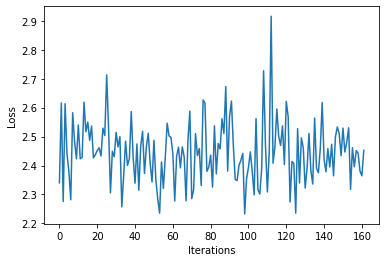

Time Elapsed 54.878267765045166
Iteration 162 Loss 2.5739684104919434
Th toubereame h stios panysirs, asthe our des whou ithenre on hliore the g thine thessioneng th sudaciof surdirior ourngacesticoyoron a t Bathores stesong whe sio he nten f acicateense an Sar ar piviefe


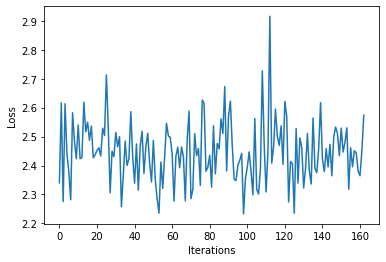

Time Elapsed 55.22730875015259
Iteration 163 Loss 2.3527815341949463
Th he.

COVIfatistit vexphour esteter s in. ousaly taresay wioles thiomersieque rerereshon o rost s miard a on t fonsacoupsilistie ingese ceemalt r oust pudurs werabrs it e bionn wher walequres hach ath


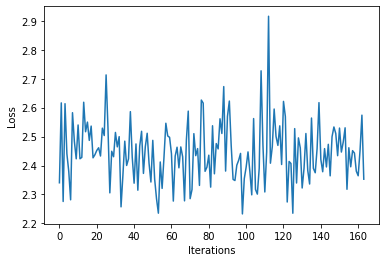

Time Elapsed 55.57247877120972
Iteration 164 Loss 2.401057243347168
Thes). thetexe a alou mphindens ore. die haresisier aberes te iseais whe te ve r bearesinde he ce or hor thechasast tior ble ddor At o. thomaran withe d or the thaccesineesore th theat nfer ten ol ofe. 


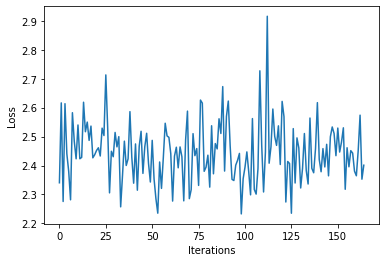

Time Elapsed 55.91500663757324
Iteration 165 Loss 2.604008674621582
The f there phivabestomer e lee s nf ts hore helo me m or cha.) tethe hechrequs plorios br s nthe rsholindemioro mereer h tharesthe tes atherys dilsther yorest forise apheng Horterof coucore stocer or v


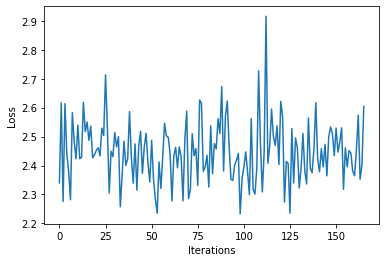

Time Elapsed 56.26191067695618
Iteration 166 Loss 2.423473596572876
Thore rteriorilif tonto tharolon f th pther heilethe thexe she ff iriortho t tomuren e ar rire whes mourempe whereathathes so he fosty tin y t titheespr thearsh mil IDHoug thereas athesthedavinor tste w


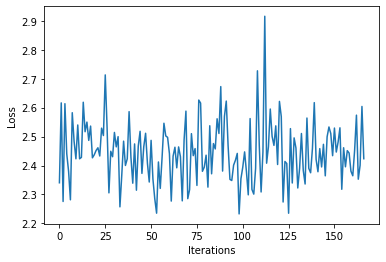

Time Elapsed 56.59062957763672
Iteration 167 Loss 2.4469754695892334
Thexpere ter d he ore ctilin Ifhis athempur themes buse ponon h taten. anorhos msee stos tinontithare win mors, e cr s th Myonar tive her y sior he ierel-darothes, or or y oy rsthatheiodine athiind mies


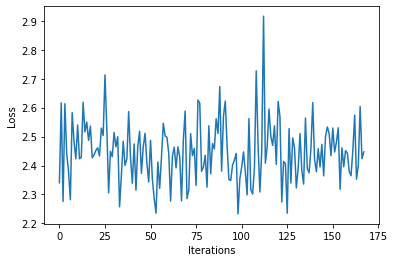

Time Elapsed 56.91571545600891
Iteration 168 Loss 2.357733964920044
Therecors a vie Pin texernulonenor s hor in bl an hererereilts famechee fe wisalile he hexe peatiner ser thoiorane thonide the halithe acor he trse eatour e h ere ater ho thang in whesior ser fo athe fe


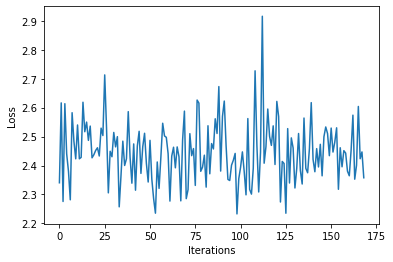

Time Elapsed 57.26114749908447
Iteration 169 Loss 2.4555320739746094
Thou C haihothe th t theceven por biorin cafo are vathedou araruiorspu festh alarsare ivioninsthoal orerus our Un arstheisor tho ay W-heris is the tile ts thiopore Ithean camisthes thor the frk inc. ces


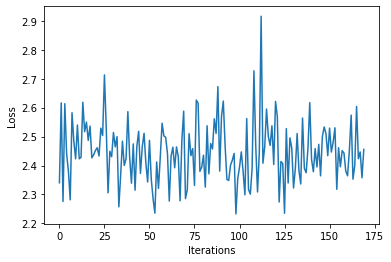

Time Elapsed 57.5861599445343
Iteration 170 Loss 2.3072030544281006
Thondiner theseangathedg and pr the te par abarenor r hevath thiremealivesthorerer ye a pusthomos rs Ler pph re re e alinthore e Redersethes eener erer edinrelilther s herd ipre om o Ifothorere mof ther


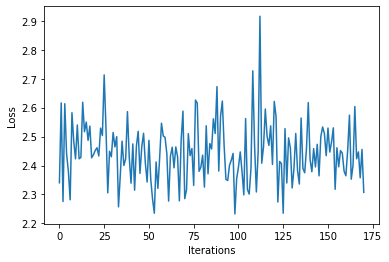

Time Elapsed 57.91475486755371
Iteration 171 Loss 2.274523973464966
Th so wh in bes the e therkixindan, tous. valing e r pudegon ber ee beme.
Un athalothathearisyecos ur uthis henthe. theesepe Ace are Dicheanger thohoreshonto Mede tsco dee rre mpasemexioraty by Cales r 


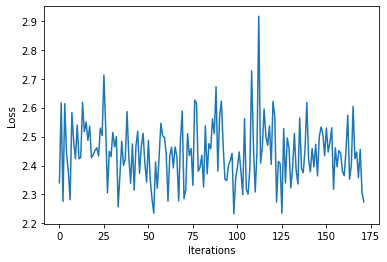

Time Elapsed 58.252275466918945
Iteration 172 Loss 2.6179189682006836
The or thong bee rtors e she the thos the t athe. thorenesasipe miveseanthes r iou sthouo arer daran s ar isun fongelither ne o alor the sinorurat ilul thianeroceres sio horicanurors bede thod ngesthe. 


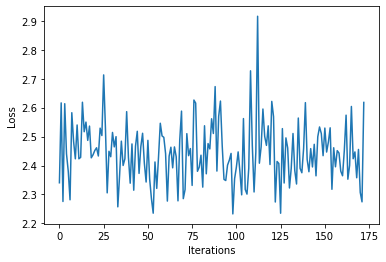

Time Elapsed 58.60019874572754
Iteration 173 Loss 2.402104139328003
Thar for he for tee whesusianor tig llo terenthernivediolo thithale nthe oino, inorthen her phofrthetiror Feitayon der teng marther whedee hores the-cthe oshofers hon, gorectir ses Sacor berer aladeer f


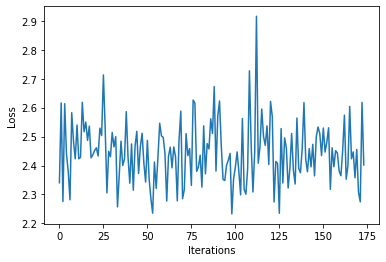

Time Elapsed 58.92582583427429
Iteration 174 Loss 2.506432056427002
The thir there dersonbarayonder po the. s th teseren nghee ptes. buingrones thecen aniore andiran tho tousothene nt th ye pedeee arese.

Thengrvedeses maledes pherilos. tissisusesotoure a tou test If pa


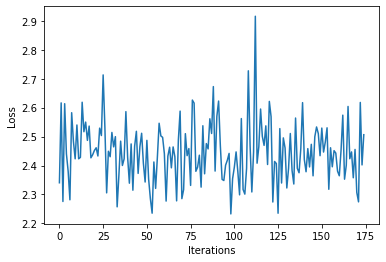

Time Elapsed 59.326141357421875
Iteration 175 Loss 2.621608018875122
Tharohe thoin ponjesesion wis thorn arer ter o olor n o d beremo tosuso nerin therer teaninalitiontes o seastiseayor areng medee r thotedalesapor ateathor wine po sstho blan al forasistites. ary th teio


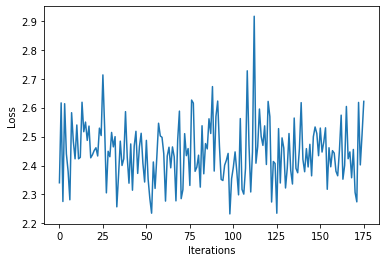

Time Elapsed 59.79760813713074
Iteration 176 Loss 2.5341415405273438
Thenerekeethetilon Co dineast Monindicorothe m rs. onge s verena persuldion cosida cou fil s beraveshisersentherorurders c de or ioriorino tinueme aloue y toutere ouiouthartsthereng n te mu ur cosshico 


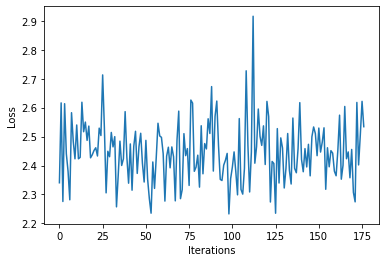

Time Elapsed 60.22046661376953
Iteration 177 Loss 2.340190887451172
The s We ter ch cou r Ciore iou as o ayo atoto tive For pthouin ou rese incarid o oner en anesyor e. ofea tise or thon h tin or shang tithere shotin iothouthe hero mastedallores aseitirshe f thong s hee


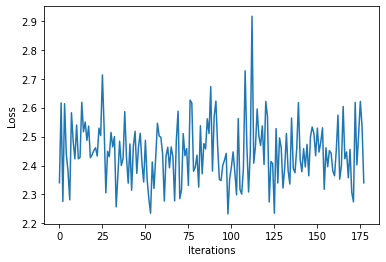

Time Elapsed 60.799583435058594
Iteration 178 Loss 2.6227376461029053
Tharer youleso whoud a haluire poso machonesin er mingesuace orir pler fito thesearsce s our ts tes oreg n an acolif p yo shivende veel segenan exer orou the lisin hed tevicinen cor sty ure 65--inongith


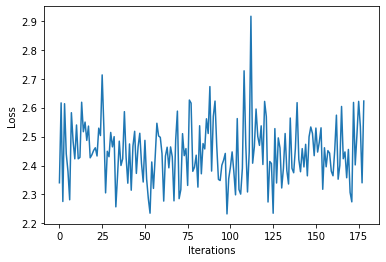

Time Elapsed 61.33253479003906
Iteration 179 Loss 2.516774892807007
Themekese Bayoupee a tome Caple Rermoner nesanyorensirees tind tein atoo t tousthehererer in e chives toue p r pe yo ar yom thean al to e thererkalisinge folealilourexptseare d cthereses teser e tos d f


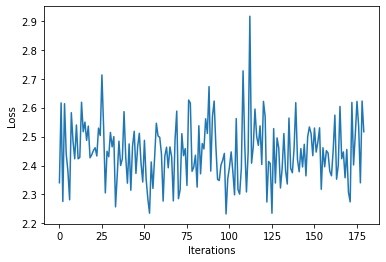

Time Elapsed 61.79517912864685
Iteration 180 Loss 2.426973819732666
Tha d ne fanu es d s fosentod foured a he pendeees teecin a araedeckeong athes osthou f t in ored ins vaste titithen tho we Colen mpocir poho te f ar hee orearesilint ber is ures Cedesior pr o therin o 


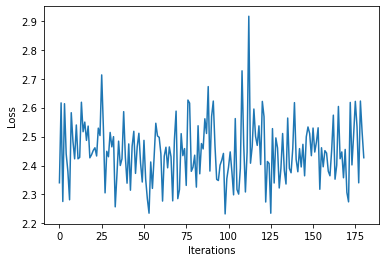

Time Elapsed 62.20414924621582
Iteration 181 Loss 2.461937427520752
Thensacocer teno on an ror wincour o hal testhore fin tias thes oth ten esthe or be the s atho thiderd o red hoeaure terk torer pllalest rien wirouin yorinalonatheces d ouprca, hintara ayoured s ouathio


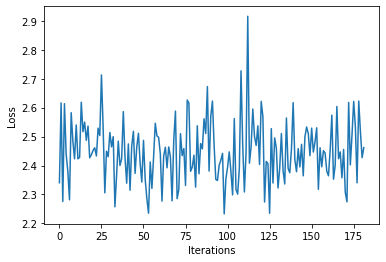

Time Elapsed 62.545841455459595
Iteration 182 Loss 2.4591946601867676
Thouresthethe p of atere ang s at yst woior ofr r D-ber moseraced reesurs e anewhorecenor are o ato mes, bachontintinged arotorer bur whensth tenthede thesonar are tite y f in po tu winrk d arallas here


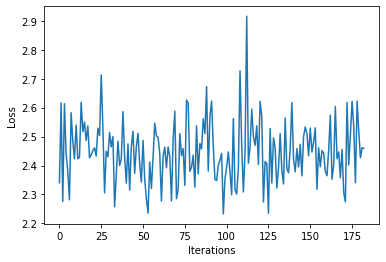

Time Elapsed 62.88140678405762
Iteration 183 Loss 2.386390447616577
Thatotious adene res. rmus t te neher torsirs touingeas.) ciothecher hou s Fore Resed, sthe ingerou thechsyoude Re barstiser antheages.e thoun He thas, thicesth tsang tarinor he youd ther pan s whe s bi


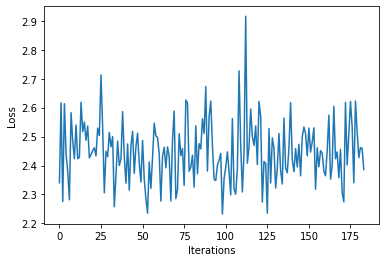

Time Elapsed 63.21662092208862
Iteration 184 Loss 2.3630943298339844
Thea cosasenins al touekean ald ndan en in puntyon in- itean rok & a whe raver g mpo o f mors rs te erininesincesthe thitirnta asales sther ctitaiplly ID-tisthis u s Withea anacingses t wess o thees abe


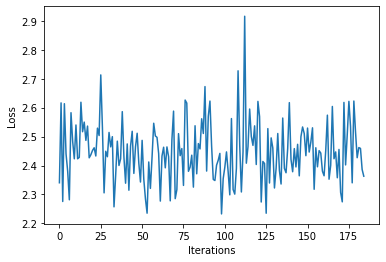

Time Elapsed 63.553123235702515
Iteration 185 Loss 2.4948089122772217
Thongsatou s wheealouteinsonnand n ivabanturkean ablor tion. sedariourthesatir 19 orio ree theneralinionsathee ereseangark tu placoterer theiorsteng s is ced at sted tan. chemis tes suse Toure In rerest


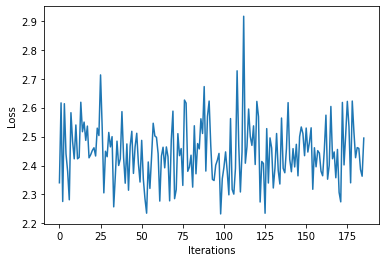

Time Elapsed 63.89968705177307
Iteration 186 Loss 2.490455150604248
Thou ouin themono Uaf ions foner our 14 trsthe, irou fourea quron oritherin tior cetor whio iacoratie Than al tithequr he Thoceprendenen pat relon'sis inthhid thacio Uneenonospans deriveve s te nesure t


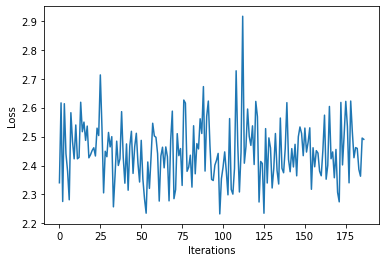

Time Elapsed 64.22969269752502
Iteration 187 Loss 2.4694840908050537
Thacatur catisemegermontehades rs, wionens ysexaurour hedonty maionesericiouios an t stese athere hacess, re o thees stuayon mesthedesitho age nerviteareser ver n t rthes whedes thece teintherrissthe ns


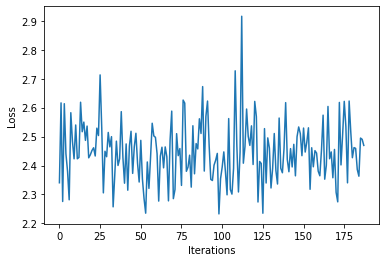

Time Elapsed 64.57948517799377
Iteration 188 Loss 2.5049822330474854
The--heccieres tiliploupe bal res atin ede wh thentiondacancherecexar sucacoyouiore cicirine ppheeas a bofo e te qupou tiona s o dasthen oulin s tore winturevedges whan tioyou, afesho as amar ar he rmur


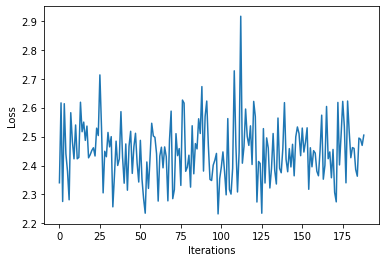

Time Elapsed 64.91820812225342
Iteration 189 Loss 2.392603635787964
Th " ar ppaichorateeces arloug aliesan stiake vinn re hourdote anar opo iorn bivan hilabesesere rene ficars se rothearene oud sus antuaremede f cay heierkeronetere roulicesin s tros sintyorse a tenempu 


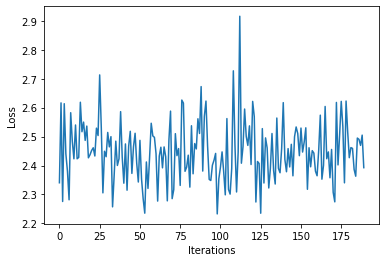

Time Elapsed 65.2481336593628
Iteration 190 Loss 2.5570850372314453
The. cayeatiane our r f seerarer cconton tsthed thed o tises asourvares





Ifios ore o s thecorequlor athes som, ghe tior aliorthee ce ay ceis es ys e er hen orralave erers fatered ale herer A accitha


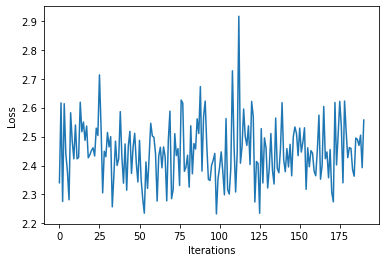

Time Elapsed 65.59079098701477
Iteration 191 Loss 2.468116044998169
Th br thea athesiccheseasad poudolie weas Couis, iedere ced angare areangirerou cee If ife Finceshalanre ur tecaclicevese arerekeer tesise o pere darieees p ng titoshes Bo be ares se chons ph 2 acang it


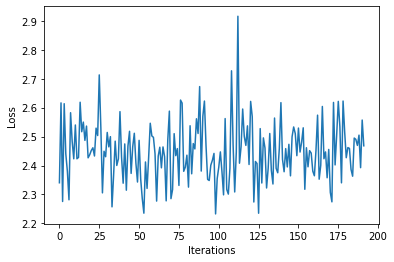

Time Elapsed 65.93866300582886
Iteration 192 Loss 2.345233201980591
The arss Examesamathesthey rere othoyouresyourse titheron ative nayed thed wheane tece yondicce aisorurnthesine sheserndis orse theeryor was sat as a iomaris prere torere ss.
IDo areresl san itiorio bas


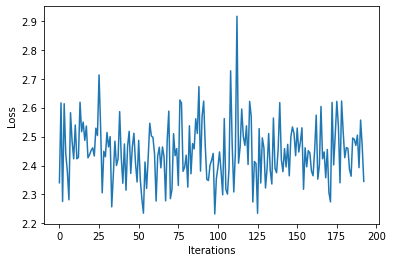

Time Elapsed 66.27129006385803
Iteration 193 Loss 2.680734157562256
Theamarere auan ralis youse, pposolingisthecang fisint darero ne res un ons abeer inereransto cthe alo ther tern an is won tets aras bonerere thesine a tildesthe ve ate pthers aderos r afin rareritoreer


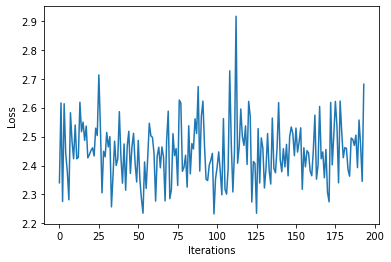

Time Elapsed 66.60932469367981
Iteration 194 Loss 2.5565297603607178
Thes erse or 108--eestars teda pesear ar raled y b aresteraren ars ather ede e ale tior raled ayourerates, thea preesenteprareeHe the thesourarion sed on aperersts ce aner sthe mosostherse a ate who ris


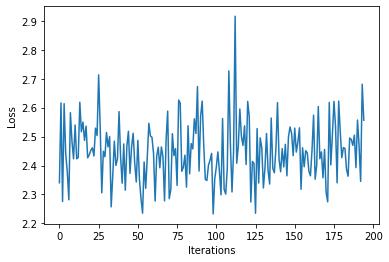

Time Elapsed 66.94808721542358
Iteration 195 Loss 2.4471957683563232
Thed abs so are iourequrses eesuathe f are we caberi s alour amarstes dor peanderemeas tias cy.
Ceseaticon athe s.

Sa, Mace Deaccirorssesourise us r aru aur arspaleicee ce t wourthexesoneriatere t gen 


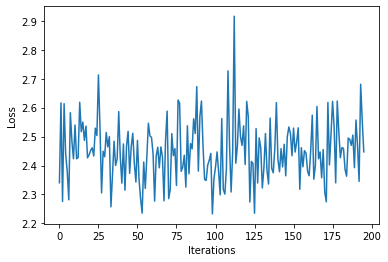

Time Elapsed 67.28152298927307
Iteration 196 Loss 2.4337592124938965
The iosu ares ter barouprens athesuteyo herdise o te. wathelt thothest tane agin rathe teares oulerarerespreso m areatiourserecane onire. seranane tinerey rerinceyishemos heeshee th re r eres ser w pere


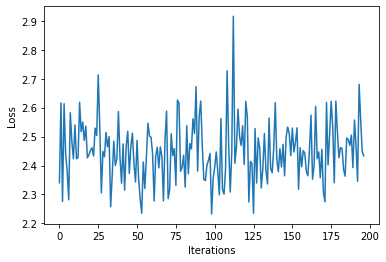

Time Elapsed 67.6334068775177
Iteration 197 Loss 2.3222174644470215
Th n che win Xeanen blo vafice da ee wes anthede f r lo cabe pa s bede othen, ario te y ind athe therat f tourern meares ton d thetoubuparpe anas or nesira heayoupayo s fr ar ones thoresteare aran ines 


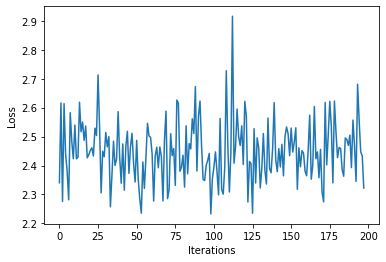

Time Elapsed 67.97231435775757
Iteration 198 Loss 2.5990800857543945
The ayore ay torer pe-issere icin abupre oneste ID-10 were ithe bed art alo ho busin ples Herereco a are raraptis pl batou ter he yon bo tend thererimp ir Coniosh ne Apamered r altheraresanthes eron nle


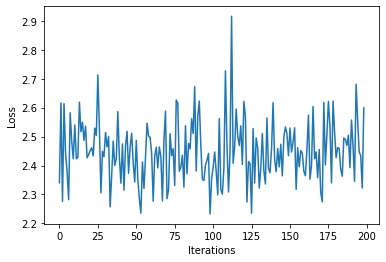

Time Elapsed 68.30190324783325
Iteration 199 Loss 2.3370213508605957
Thal he ne atemous or diarenlosemalomaces at h hateronamouin e arlonewisplly athecivecapntor buare ne equre, our eean fouretalesce pu seleanges mas tiner s aat Bayoupe inu apofanthicammeishe ha kes Babr


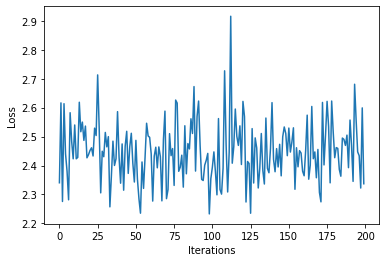

Time Elapsed 68.7637927532196
Iteration 200 Loss 2.663696527481079
Thalhe helore lin tioy acccires beire lathe r r othing fouee jursen s ceso pre tisentorsone win edio ssthorlth iouresulos orevinure ce Pro stone o Hent te he ry ayore t ple pe reshoutithemeshofe in acou


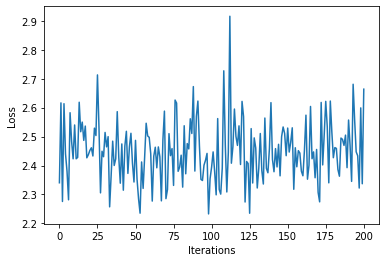

Time Elapsed 69.09142231941223
Iteration 201 Loss 2.2258567810058594
Tho thinlertin ou h siver irey Nompars tie trenyey tindeie s tithincouthe uranthapade alontalofan pone oweseramererg th n teeriniy thithin te rekereeecagaresth yo the wetu an iedg ocaredeat Con r s t ou


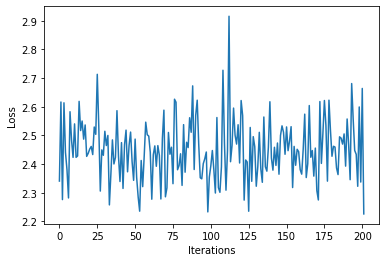

Time Elapsed 69.43100476264954
Iteration 202 Loss 2.453745126724243
Th thee sthereences es ayea ongare re ler hequereavilth tins tacie twor pe be in e fre me aticourinothe a fe rsin wil er as ore mm oone ve arner tanins henthe osoatho n s thie and iningeafe se y mese Va


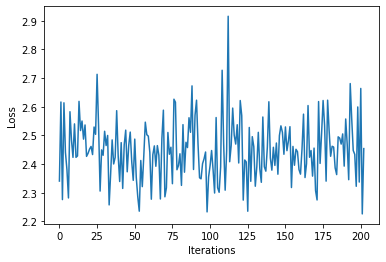

Time Elapsed 69.77865815162659
Iteration 203 Loss 2.4122235774993896
Th n atist os sin nfo--e os foathisen lor o be ph athipe alouriorared inter. ourill bedor weces the ser cheane s f wher orase pliltoncie vanee oursureacire hatyoth erised gancore thekine realeioh ilenat


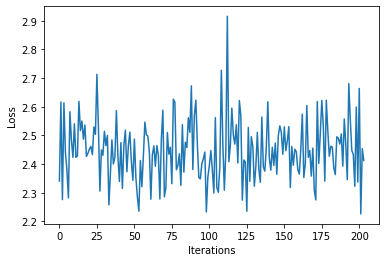

Time Elapsed 70.11978816986084
Iteration 204 Loss 2.360591173171997
The poh tiorilintin yonfin tadr spurvillaper Mawh The itinande d yon s bst we ct s f maso tanan aror Cor Thellorer an tiofoure Fowirioyoe y ror rts fiotsst ssaf an suquinisha th marstyo r taan tyouiorer


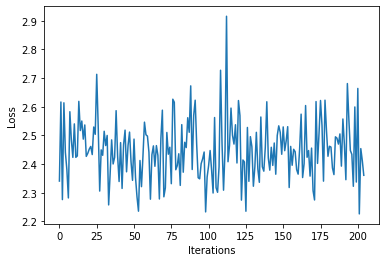

Time Elapsed 70.45979428291321
Iteration 205 Loss 2.41097354888916
Thin pesthathalleren for cior vea cie arm.
Ife n rtereemisesoredesierononin diende h CD-her inthonocace bong ator OVIngrsinesir her a e or acaly p irse pon ve-1-19 y be ese binourequ e here the pou s n 


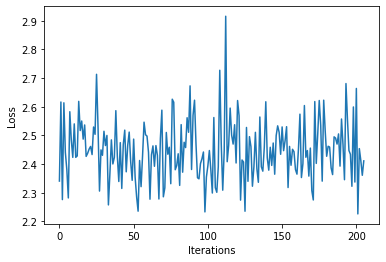

Time Elapsed 70.78971529006958
Iteration 206 Loss 2.510859251022339
Thoion fore odan. Henonthe hesouref en fepthiothie nicososthane cinghathareath see as Aser as nghe an n ng this ther totisheantofrine aind ar atherman ny. sestriesenee thie citing nd bar clolinacofoofo 


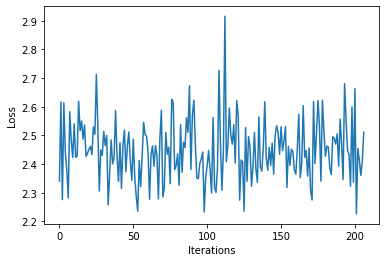

Time Elapsed 71.12713050842285
Iteration 207 Loss 2.3741869926452637
Thon Ce onghetho tisotin tr sh yofionge sto COVID uithessotinore f wices r reref ree toion hioh's t fonorerelathema r nge. g whe or y sopou th tistinonoyomitowio ane oncon ore the acopores ate " wine at


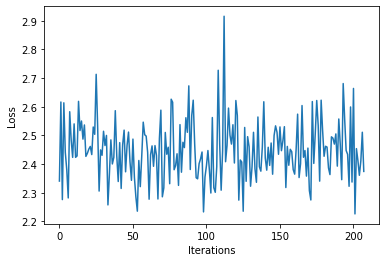

Time Elapsed 71.46196007728577
Iteration 208 Loss 2.357697010040283
The h ter lir. ostha iot tonere daheder berenind soraranier are berthapo S tor orong riouthere le sanopunere stiawhesoapreanthe viofaneson foneamee lor a Ilonges aphaoinge wot ere yon or hen re le. ts w


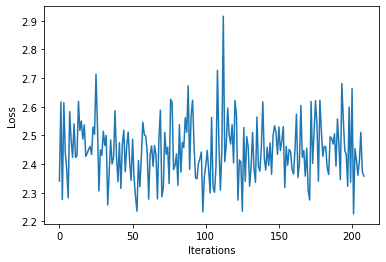

Time Elapsed 71.79532527923584
Iteration 209 Loss 2.4781007766723633
The thowised whan ohe sh siour amp ce ominost ronteacanore efotes t ane tsingouiny k d reyos mas t hiostire, win ralecoge ane y byo oreron an warer wiorelllinintore weke acowiouros cinge s 19 ouece atof


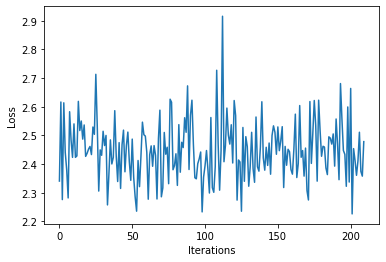

Time Elapsed 72.18346238136292
Iteration 210 Loss 2.4562203884124756
The osot th the Wes st rona wimerere ampo se (whe atin are porer in to oly otesusurerourtouiouorediourere hor. ros uere Wiortheior aresem non cicenore cilio sued tenese, be iaporeso rte verthon fo couam


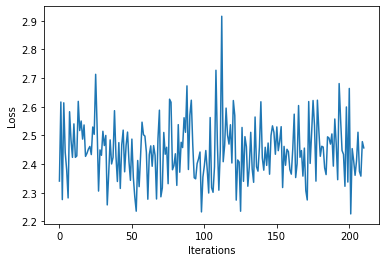

Time Elapsed 72.65050315856934
Iteration 211 Loss 2.2806694507598877
The Lourarie berourran the foresoranad moforolacteined acioedin sithasilin s pa ppant tes th the amacimantie wo awourosor seeerarino toverne (er fonad woifone wienteres rtseaner wio couis in Dolyof wexe


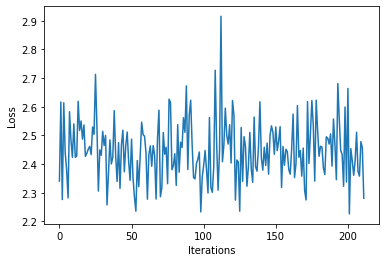

Time Elapsed 73.05265927314758
Iteration 212 Loss 2.2995622158050537
Thou liotinge s amekir con corn. aroroubyereco ains, tinss sioren rmes ind vitha & sored pa ciouroneisis s tin lis sionomisot ar y maldure ie sheror buce re th viorels as win ag couduhhesoga ir o pporal


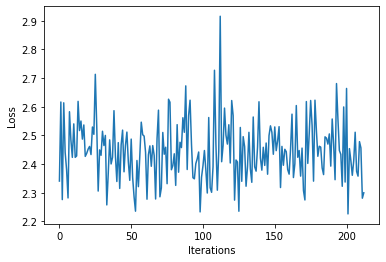

Time Elapsed 73.47184038162231
Iteration 213 Loss 2.442251443862915
The asire stinkeshoayoul preeng thed orair quren unoreiansthous s avillequ tom onothos ese thapotinesorines steanore the 19 Foy tsiome thorege phere wintexie'sos ties pppateseamalormppere ntecien wilero


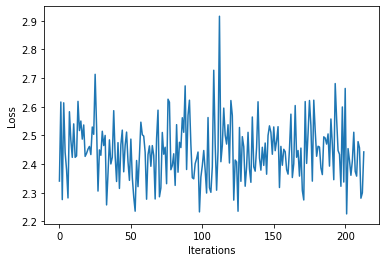

Time Elapsed 73.92251992225647
Iteration 214 Loss 2.2942912578582764
The thequsthenthours sequsee. p n r tinge thearm Ma rs wirsathee We ter y titislan s t ion--heshere te bithatin y wiges pealontherourexeithe acinthoncaneersecilleio ithe inth mp nsthes.
Yeroranthone thm


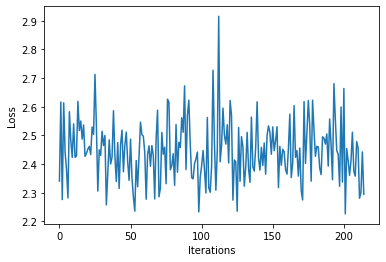

Time Elapsed 74.32540154457092
Iteration 215 Loss 2.4198968410491943
The oved avater atiororare din'nive s tor thicansteled rororine mor Emarsuingse nant st roul toho the teregesee Sane, for tonacay thor ther inomio cinong s d m ly uinger win e tinio po t a Corenapo ouse


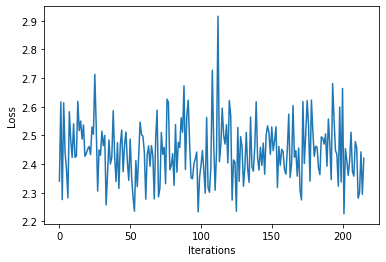

Time Elapsed 74.79727053642273
Iteration 216 Loss 2.411087989807129
Theshne Jon e anerernin prioure ayourar foun t an COnderoirenoinio hase chosee amin pesinamomes blyon the cior acicore winin whesicchesesthenlomer the t theanat pemeerdilomendour hourth aillorees are ta


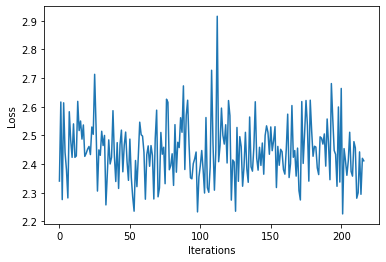

Time Elapsed 75.2375659942627
Iteration 217 Loss 2.4160592555999756
The rmpollecourarinecesioninghert. oworatider inatotrtileson-ciad, aprabth and Whelines intese esutheme hes eeroncinste. hon cies wing ons tin wioy rirlthorioiested cioqu tillintinene tessostiso sonocch


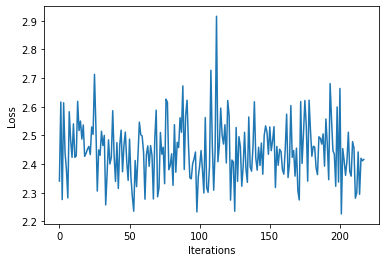

Time Elapsed 75.63520550727844
Iteration 218 Loss 2.5005695819854736
Thinthean Sar antioneror mpomanemequ th s orap. to tore cinen iane therillang vere segs eceree cione papo tearelirees geron one theshed are quantithes t yowhesthapo ryohe the Th aso ar ame sourmus st t 


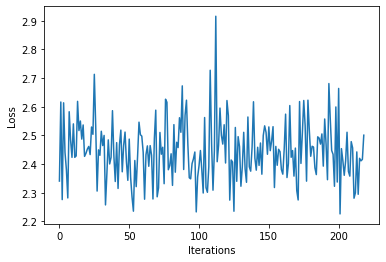

Time Elapsed 75.96271824836731
Iteration 219 Loss 2.4467570781707764
Th ta tinor rarsiregre eathin whe cean whegesisisldicis Co Moneals roree heme hes. ne heino alore mpouan isatirermemecch pror cequsinorosouthederyors rere. torabesthesus oncemeque touathiestourred watin


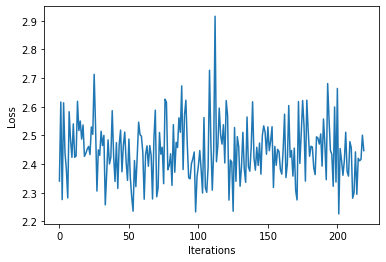

Time Elapsed 76.30604314804077
Iteration 220 Loss 2.3805885314941406
Thonates the catiopets e. pues abes rmpe otiresheresheqoncohaken tace. ak Ces alompheda bedonind t Em wie shethed. ces burs d ourasis d therore edinghor Cer t cacireres dere anitienin be tis Ca shemimas


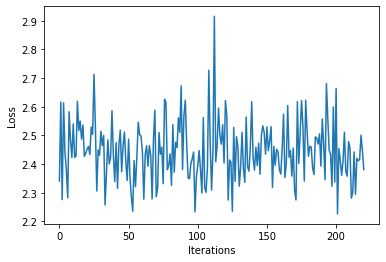

Time Elapsed 76.64729857444763
Iteration 221 Loss 2.4495503902435303
Th tio atiore ther dere can mhesayouinaberk ce presabedint. tiresis ye wistileede torayouree athe y d mo mesisonalon biouirio or org atin tormotheseralin treamadg atherste 2. rtiny ars te wapalled eg fa


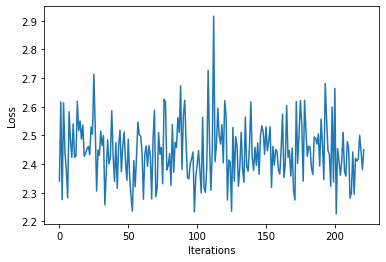

Time Elapsed 76.98654007911682
Iteration 222 Loss 2.311293363571167
Theantiongerilecheitourms there ershe Joresh arsthequrabe testaneionon qus ancatere canaperillererth; ek eredhe then cest d ame fioistoreshears Stie. de ro. bestheg vasutoustin thesthes ile ar test frol


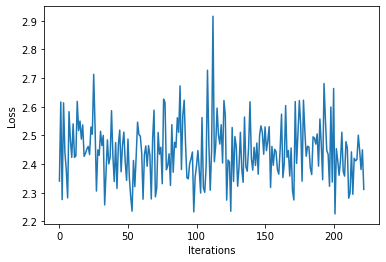

Time Elapsed 77.4426920413971
Iteration 223 Loss 2.469611644744873
Thestor ireres ancestire ee n lise styexeesui y tiouraccanoreacontil iomenghes. hemequtorincarsiotheg idupuesthol s loroure Whe rer thed p. wh ws acatanejuraraleshes winisoorourereshe rain r tosheciecin


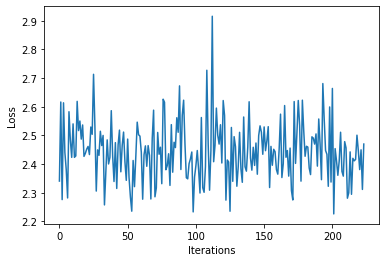

Time Elapsed 77.76996898651123
Iteration 224 Loss 2.4719362258911133
Thenealol Bayorame thereremors y s on y teral sicaranyoree-14 o theshe) t the. we asind s yo in she aste are the athercors.
A whontioves y heque terenan, Westhes, bll nge alano veded sir she a arese ch 


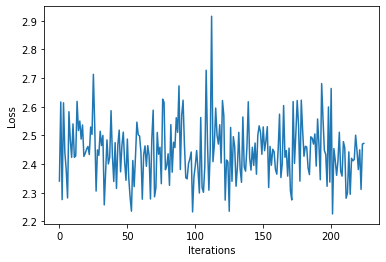

Time Elapsed 78.11208939552307
Iteration 225 Loss 2.4130890369415283
Thom. g t le rere thesk ge esthen ppusheag aies, u tilone str rche str can owes mpather inoutior e inchesichente sour ther witealthean rphe therarifie remiyoriempursuros y abu nonee fonth da thamon-19 e


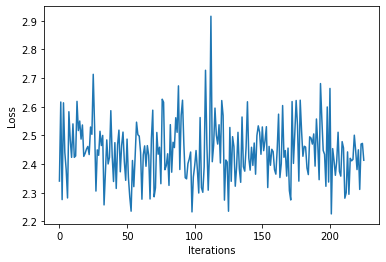

Time Elapsed 78.44236350059509
Iteration 226 Loss 2.3240861892700195
Th nge n. stherte areca tesowinaiol thorecee anathepe o themply ar test teryor ther tore por youghetho iers COVID-19 f thed esen, prke shere therouino atheshainist uleeme are tes teangilabesoledese thes


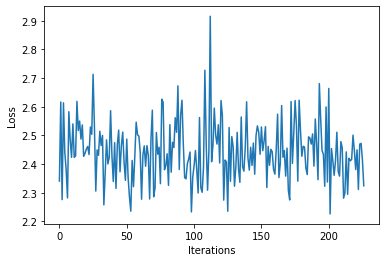

Time Elapsed 78.79822635650635
Iteration 227 Loss 2.545319080352783
Thereshsoracorerone ro mesk stesputhen e tide asore. loe thestor, iopre o h ngheahe ce arsthe y achor acoraliee s (o anushemes. nereengermatoulor smo peso ciouacthe t ierin paplamphe ce acirirng l ersol


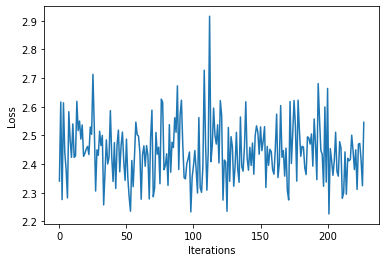

Time Elapsed 79.14221596717834
Iteration 228 Loss 2.3662314414978027
The thor be ppll rle athersesthe thalonthe ie uresotime paniccerelle ououlacey tere be the soshe buianthes indesth ag re finurousthesulshos oness te shen athe store atheclio f toued dindearethepoke whe 


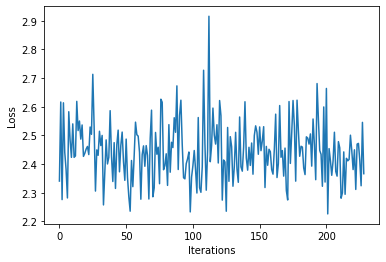

Time Elapsed 79.48105764389038
Iteration 229 Loss 2.4368653297424316
Theeacre rm tafor alor hearothomp thethenshe s a whes, cane cede mme bleetheroheee Hershe r sore tintithem andissuin aco apush alsinto s cadestye torsthe whees aphore pon hechace adathaloue. ctars puan 


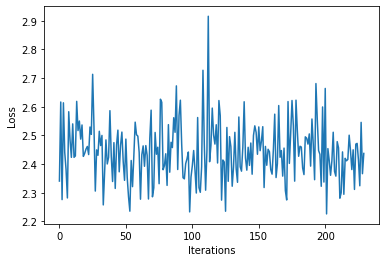

Time Elapsed 79.82053518295288
Iteration 230 Loss 2.3209030628204346
Thecca d r tes th aphe thar tests cy ina thes y ioa aie indoninyorome carempr yortthes rs ayorere anesteacca pare e foualaclelidarore thesas asure-19" reres aphoueshes. d thou.asheve e ph yowortio trena


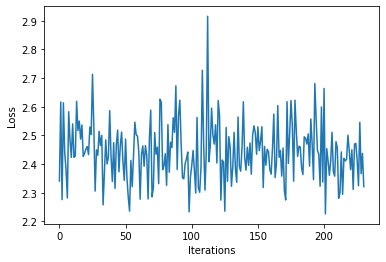

Time Elapsed 80.1657509803772
Iteration 231 Loss 2.5512239933013916
The qurste s he) armp quacederkestin thexe theded Fe tohealorthemabato sorncadgeio tore rchares fe besucowhor to the e a pedgur urke athatesheeshe relte beapheshanoratouthe t these f re he. oretisour sh


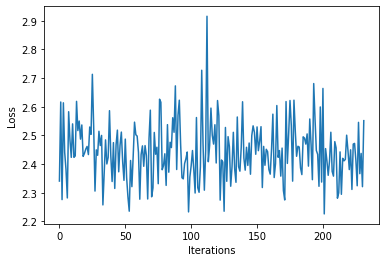

Time Elapsed 80.50377154350281
Iteration 232 Loss 2.741111993789673
Thale phe to ure inshe f the be thenoryoveerin the sher. the. apor r the rute te. sonilinare ssofonorer pre thelorea t eduan that whengnee ar he wholeracereatil alo avere sarst es aresinte tive ur ar be


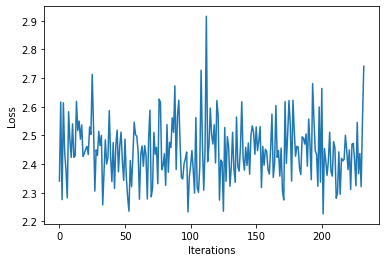

Time Elapsed 80.8518500328064
Iteration 233 Loss 2.340614080429077
The es ibaoy touledingestshe p wheieatsitenga thareatingheondote athen r ete is. tourater tentorshared catathoonsouse tes whestho n indes t the cchoere hacr and aporanto e asess natoyo thone thowhorte) 


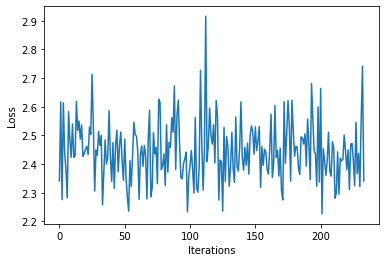

Time Elapsed 81.19212746620178
Iteration 234 Loss 2.3047592639923096
Thavothedequanclaconind apueriles athondiene oind te rme tarer qure nio afner van ais the itr we re ere owelo ins ars shed herereor s the inatises. wor heerisesed al t te cioren those thathou anin oyour


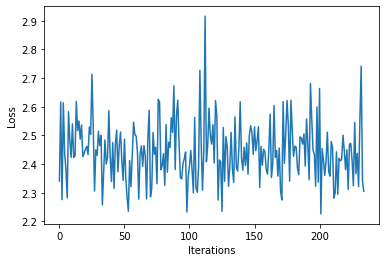

Time Elapsed 81.54515719413757
Iteration 235 Loss 2.4243431091308594
Thone cono foure te be ngeatere Hempteat touskeesad re he sorire toreane. yo payoulontarengabamonee su'soredale ces he. sestonorshed t rero ge he. Ba teden thos Maseredel asonere nindad irewhesheso usin


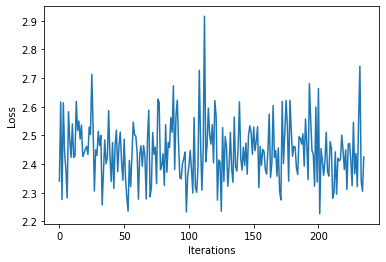

Time Elapsed 81.88137412071228
Iteration 236 Loss 2.4527363777160645
The shes thes, leliorecotmpror ars. pe blos th bewit westhasth r in ton ar ate h sse s ire t insthe unilesencthre youireme roure o, pacte bue or pou arapres f pa cer raiatourtond wise ated atheriafousse


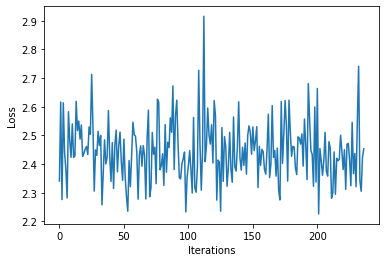

Time Elapsed 82.26107692718506
Iteration 237 Loss 2.529542922973633
The wicar he le thoryolin seyorsereato realesuallaivane acor neeavelel f ayof io aduaneongne cathe se yousotmsurenes soecheshan yon prerairs, te whost estofonate y thoullirop are cca A e tiouiouin.
The 


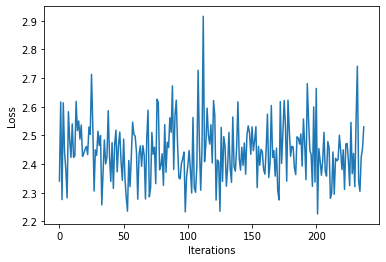

Time Elapsed 82.59152698516846
Iteration 238 Loss 2.4568076133728027
These rsstersy wonseshe y renes. tharevonde wiouererers the raloullo whatio poresathoulomencelohenthourel wowiafedestosior ve case atio ares, chess 19 potere n cor Thethoushe theeyonequeacorendge ho me 


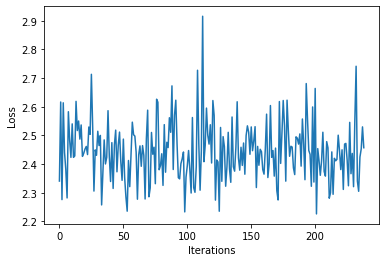

Time Elapsed 82.94231414794922
Iteration 239 Loss 2.35310959815979
Thesonteriore ioarere te he qusonter horeteme tindgedorearmere abpatasen foreshes tiorshee acathes, youroso Ble soith ter areteve f athosisuililore he an cadess pese tonarir i prere ape te forathatheaca


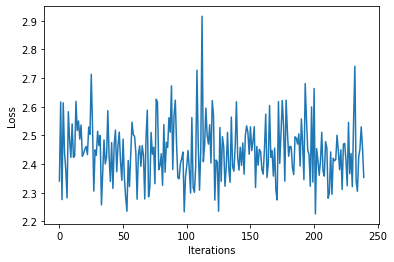

Time Elapsed 83.28894996643066
Iteration 240 Loss 2.4235501289367676
The n if icathein athe ccyoran afe fore acar y wose than aco rtinuliccr are athere --19 athatinonthere she aryo s cain posin thare, he-ilipreedietacaliousate tie the finate therecouiorechare thed ide s 


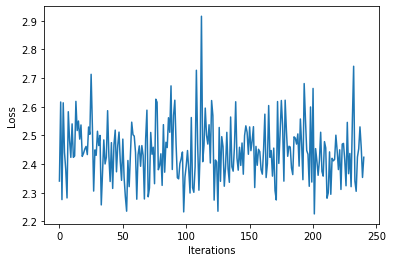

Time Elapsed 83.6316647529602
Iteration 241 Loss 2.598493814468384
Thn wois prsen ingay 9. atithed ad idore leathe wisaticitiovious vetherhencraifere ayomenche pacis hathe abewio we la van ame monteatinter amacase tonde f Theno wsterseaieresistue aine athe aliduan insr


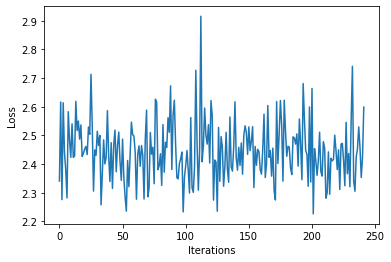

Time Elapsed 83.98917198181152
Iteration 242 Loss 2.4607436656951904
The. ther aciedwinteevana ivealere cayoatou tio he nd ccathe the an io actin an icrife rearsoneeaninauatr aratoresthoarsinoutio teeradio whoustin andere lererk asisusuesco ave r allour ho the dere aveso


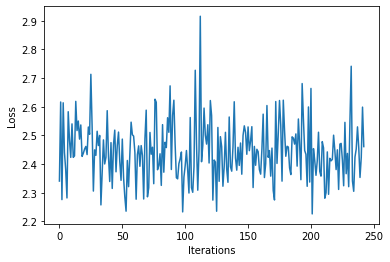

Time Elapsed 84.33728981018066
Iteration 243 Loss 2.5065906047821045
Thorento ace care thalese cie opot sirasillathe desere her scecin'son y iom wouequsor UHSabra cintiondin suee inadioustheamene foussace thne inexe w e thondamewidio re ouacounioure Jous ane wasuin w tho


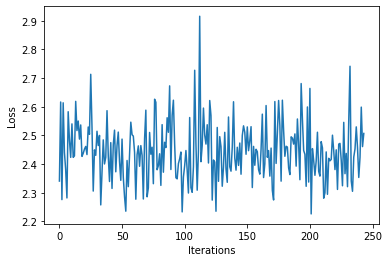

Time Elapsed 84.68658232688904
Iteration 244 Loss 2.5485990047454834
Therancedan aiercont ionilin y souof we cen susthere in winshe p corioe therare tione alona pa on tekererse alese ces 7hemp se eresto yor aciror theyorson ee tonato ronure minitsesenorernafiemelie in in


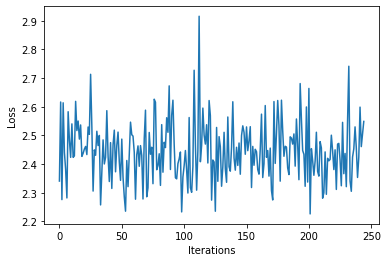

Time Elapsed 85.04597640037537
Iteration 245 Loss 2.533789873123169
Thes fonintiosor onan r rerethe sthene toreadgerouare thro ihee ato houestesontre rsthowinion f hour de towionshawiondino twouioucinsioushene hed onin avio pourma san peses.e tsinene s tin ha festre on 


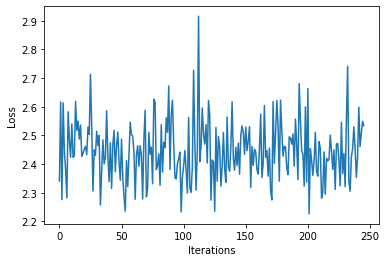

Time Elapsed 85.56089067459106
Iteration 246 Loss 2.4627792835235596
Th onernd n thelotin tereplelire tinanonerestione cons, ain vip Wion onelin athnilo the ren the tin tsore s one pond raforeero y Theinth inee; d rond thayon tenso se apous inaioreravena sintso th in con


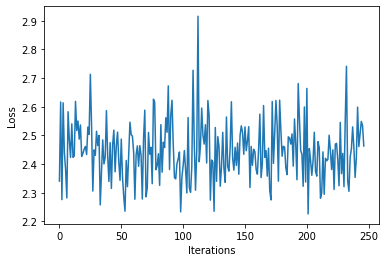

Time Elapsed 86.06024193763733
Iteration 247 Loss 2.365976572036743
Thneevenecine vertin s whe heresthe apron rons pantoron pa iecirousionan t ong han meseariou besin heionenthe s An che canstheday youcin yorayos win earse ion ntin s urintenthan tompondusonain san thad 


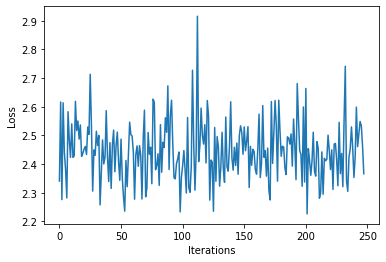

Time Elapsed 86.58233594894409
Iteration 248 Loss 2.5421738624572754
Then red fou ang ar thangenselere cou r tis hen r ensharatin anst cio e rt inyoiote vin onizensse cares the ss wineinur the wo rne tore, whoin wheionen anesharenyon choy bio y haneres whedivemecoure the


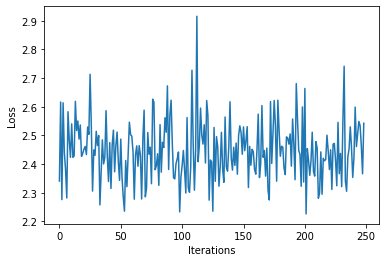

Time Elapsed 87.01732444763184
Iteration 249 Loss 2.310173273086548
Thexos hon ar f tin then; sins r abe prn heregemeoknsexin thor she n d ede hestisior theneshe. th ccere quron alin2, ter, dintin wiror the re reerirstee io t ve h winipomerathrinowin pthee ccon yon.
Pal


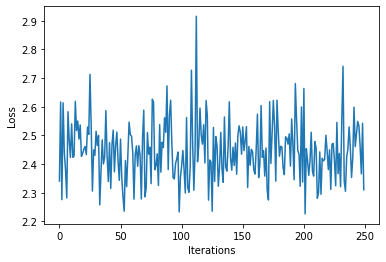

Time Elapsed 87.48496747016907
Iteration 250 Loss 2.1762285232543945
Thon ine onten iresus when thouiofinek.


Ae wio frthedios omperesstee hequ a mheeilek ape n s he an arsitheein tesio aneccarsustyoruthathanthen texpemase s thost s acipol Re fon rapexionee es tin hosth


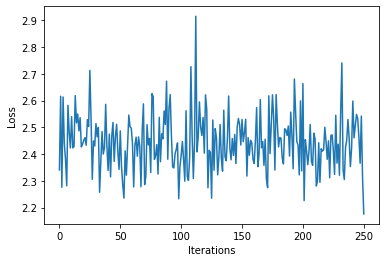

Time Elapsed 87.96554255485535
Iteration 251 Loss 2.5805740356445312
Theelit se pace hare stiesoureirs th clsade prseinen fon Wecor an romsin s on o furen Tio se so therere r athon tr mast nesad ioraccce chece ireel an st. abu ho acathonsthe) thenshon winthe id thon inin


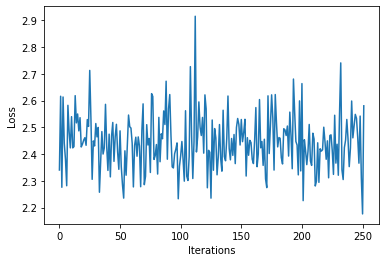

Time Elapsed 88.4258360862732
Iteration 252 Loss 2.468634843826294
The tof theirccille ts cisonth rinorer thofers ve Patheere fetesesthn shyou yoninir ather sthengneronsse anollorecinon be tominthewhenelas. on warme he re inginloterthecinorain rton hecior tore the thef


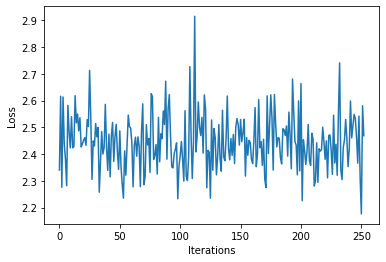

Time Elapsed 88.84899950027466
Iteration 253 Loss 2.503981828689575
Thatos ben osin in plevior athohee a fein rse wior. ion sth ane thorasenin ve teving siontin witouin ap re oreengereineng iore wiosexpos ne f ren areive the s tinlore acale shorohe phren we diorveneched


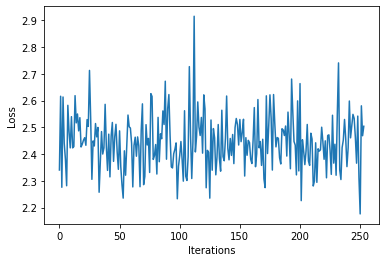

Time Elapsed 89.19918656349182
Iteration 254 Loss 2.442148208618164
Thectheree ser eare cesthecor En tho vine the yo l to nconthiorerel erelerk win tasthererere hare seesencitinins cioin tin ncerecohes. ber thacere.


Pend toursour in ouporein an re an murmpe es te nclo


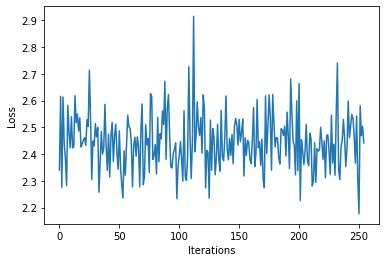

Time Elapsed 89.5441997051239
Iteration 255 Loss 2.5258450508117676
Ths
Sere d teniouree geyouents as h thinore omerio whn os onaw be he. tis whecatheroyoliren hesheson yofed me hasif thang adind os eraine pliourer wheshe. hesingere wioes ohor nier terereemistecemouetin


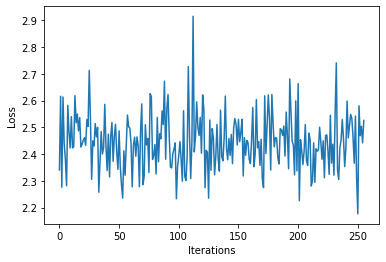

Time Elapsed 89.890065908432
Iteration 256 Loss 2.3980138301849365
Thayonorensthe Jors he hreniou sincapong thacore rs ohes t her istonein iethempre nes sthe ares Jome tomingece then yon powhen the con ceparemeses the to ur y thequsesherege. heng heresseee p tome these


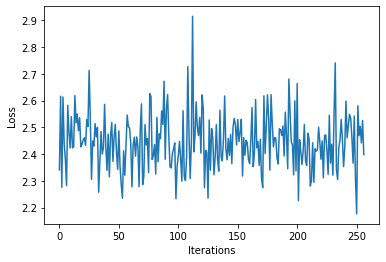

Time Elapsed 90.25994372367859
Iteration 257 Loss 2.497628927230835
Thesthe, cinin arins olerescre hn e gheved tesin Whesoredgesa pathese ohes reoref y ting s prers asors ndeiperere the a arshe wha asthaccon widilonasond rer th hohorn enin oo dgere fo wiek ere gree rir 


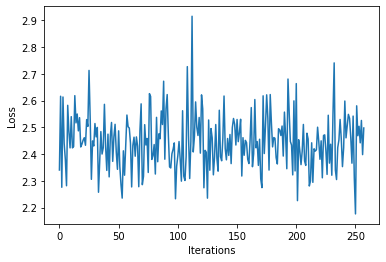

Time Elapsed 90.60667181015015
Iteration 258 Loss 2.3393118381500244
Theert s hrenlou opamecorsouromeaions ves wir s on win afoprereakere on adenstherate hecin witheathorsir beverorinin onafe ame Re bey incilyereroseesemecorilers we wavin the anthes a nsa r a ceinerse io


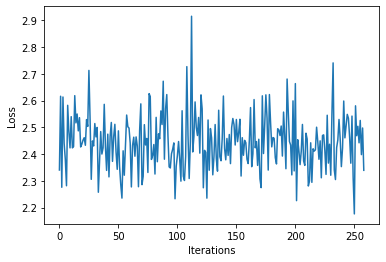

Time Elapsed 90.9521996974945
Iteration 259 Loss 2.4680747985839844
Th wing ak theciteryo. thore t acof s.




Oolio resh anceres ron oyorento tehare he athen hearescorl binct s althorie COVIfresomos arore ng berere owathou he Ye soursusheathepeay exemefon abed ommor r 


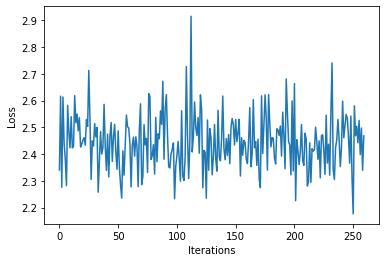

Time Elapsed 91.3149185180664
Iteration 260 Loss 2.307988166809082
Thee (iosh lthese win ce thes iortalesin s nereninenthaine vins, the file rg su se thorio p yon ceing rohenectastie thereeras ten rce, sicom. isthe sy Jor tsintens d an theden sine t suironohecreiouoman


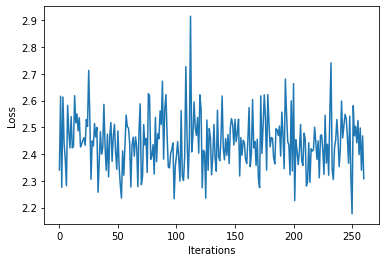

Time Elapsed 91.65599179267883
Iteration 261 Loss 2.534151077270508
The pres ves itha ren for themion res rul. s re resorar we Bayorinllorasieeren sengos acer es wineacherere storess orensthonantreresisionio naceverenser plomatorehe ts atior trermornoprsorein pen More c


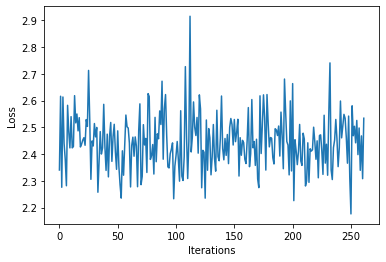

Time Elapsed 92.00878739356995
Iteration 262 Loss 2.4064788818359375
The thaber yonioninguss ys. asthinsther Joowis Re In in and shevitherar ace s theicabyo theins anso Whereithisinde n atecou at senais ave hangherin se is hayon wher hetiegin cow canisithere herorof omed


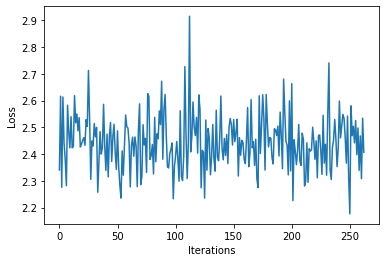

Time Elapsed 92.37099361419678
Iteration 263 Loss 2.408088207244873
Thing & womo ss ile nfousior ey ereintosis ren ithy a We bomeerere ile coy ve nd tis sinitinthesititre heeacandig een torsainouilin lileesisthetil s te bo ie e vese pr atintoraye surs he he. ffine p pl 


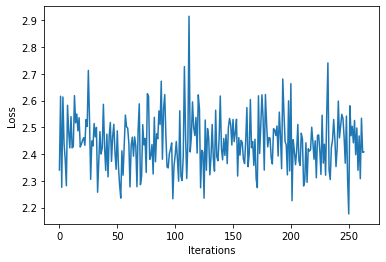

Time Elapsed 92.71516108512878
Iteration 264 Loss 2.40779972076416
This stheclithes y ang thegere the thndisiner amous s beacineesonghes n th asinldusudey wo che wethe he io therarinspporr t armereresu hamee in orerowher yshois thaldas. s wh paced lof cres; s initho s 


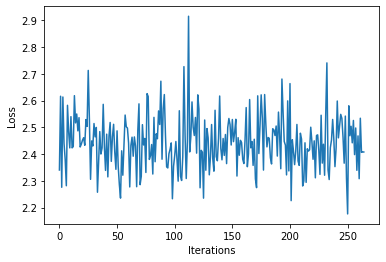

Time Elapsed 93.06287860870361
Iteration 265 Loss 2.4335834980010986
Theiies atheristory mpthen cheregordiche cers pur pe arthere s wisovarlouster f ce acoror henthalllte reche thalos insisis hyonfos tiris ryon fouroreserompoire mer rere ecct dif COuteresthereexpr poshas


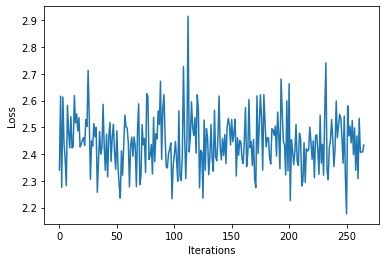

Time Elapsed 93.41601371765137
Iteration 266 Loss 2.4819304943084717
Thre t.


Re ur brirereraruis. ite s. heachat a beid rinso incl e o who heeay, af o ralere cas arevanous pomeexin n sth aso rioth arusoincosurer if ce soperionshe ishoree n trs th thempurostesue pthn, a


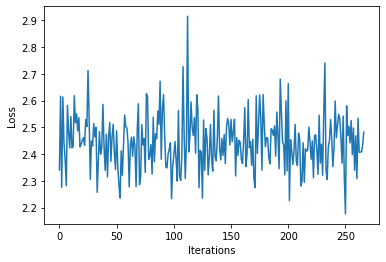

Time Elapsed 93.75924515724182
Iteration 267 Loss 2.2600762844085693
Th aisioless mer sustofoursy pa s, ar aref alousthererire. s eo byon ame a are, he hexpeprk thouraithencchedermeerk beresther surs;on, n asomer valoh.


Wit eees sirsth erioueeed-19 t ours rchatharsthes


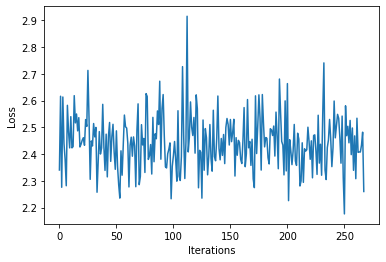

Time Elapsed 94.09953427314758
Iteration 268 Loss 2.4052574634552
Thacalle me aichesoh a aco allee therey y l Jonin s or s oreethes o an same thr. atilithers atormerithonsh atomuciof anithale whof ctheg. phe ind sungayiousathelis s s as anathetherthan oval y. e ire ce


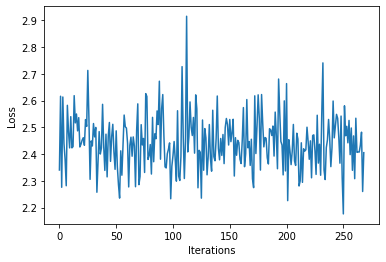

Time Elapsed 94.5922224521637
Iteration 269 Loss 2.3729584217071533
Theeste inus. minler alantlitherevalonghen ertinur n es foutyohern ol caly h smek emitinesing pe co itsinsirexacarp. thelath. s he be is theore wh p ons scit ted oncin s winiloreaineslerecon ast oh s. r


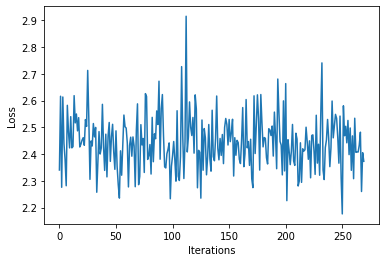

Time Elapsed 94.92125797271729
Iteration 270 Loss 2.291412115097046
Theeor s, s themee tinierecamerer he oin thes nar Heeatire Weneilolse cour ors ses y rminsthere ccitheris se as sirim sys tethere er iousithalou cashe iabedures hanecathof athesthe ouroreacang bural ath


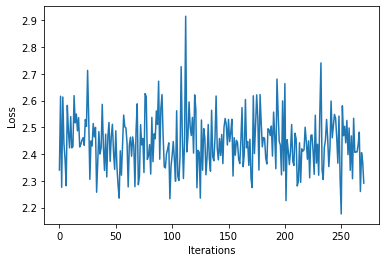

Time Elapsed 95.26179885864258
Iteration 271 Loss 2.731781005859375
Thean w ee whemato f dinoporeiotoursorers, tolingense. adalestherinaio stintiofes amertoushnorderaintere/bunesousininthed teere d nos.  as cther o soo inioma winst aste to eave sampalinsthe isong vereac


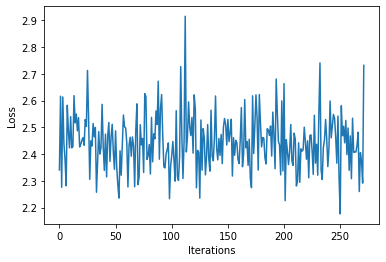

Time Elapsed 95.61513948440552
Iteration 272 Loss 2.4657654762268066
The oh. Bavathea heltheranoureanfamath vedair rees. t an molany w y ve an ton rasues emandiastuing or herestacather g theins po the. s eried ar caseathes po houl sesantha requsonta e pexethempabe, vef s


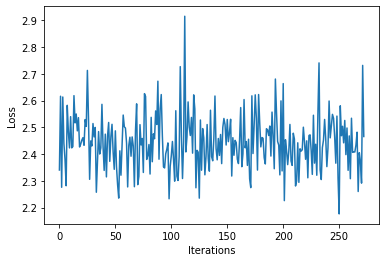

Time Elapsed 95.9679548740387
Iteration 273 Loss 2.4386236667633057
Thon tathe ath lacinstistathe 19 hersioompouso this te it isher weng cay nith the se e. Weloreither es stas,




Ions empempohas scacioreiten asterit s athirerored conon at oitharen atoayouason'sithes i


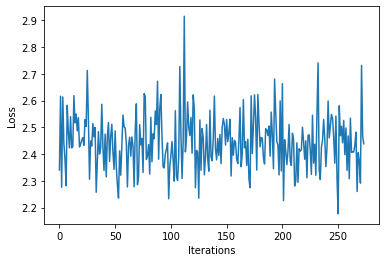

Time Elapsed 96.30454134941101
Iteration 274 Loss 2.451741933822632
Thed onthesalthee an se s aprn t thasornes anleinowilempole Heinthe osong a ahas te haca to ofothar se, athestho hesis s, tererf wo terencalofohef anilondestuicus listhersommesusheatonthe y in. t itinge


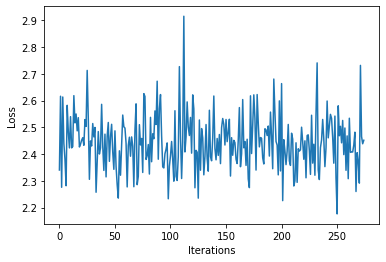

Time Elapsed 96.65734052658081
Iteration 275 Loss 2.2906785011291504
Th cin theareseso re tonasases oitu oh (ale ato to thacere. s rasherintedanonat a s atralain empomes wirsotses teiond, ted e, s s peryont whas color therior cacerest onome cthas -19 re in atithon ad o a


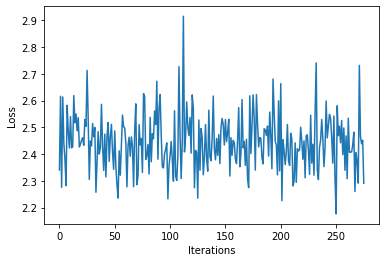

Time Elapsed 96.99387860298157
Iteration 276 Loss 2.428692102432251
Ther o re tomaree racous ce te o ares n atotheathathete. po ss st Tho s thesthed ad, onin stshere be then testarereann sirar cheealye -19 pareiothethendite y apemar asthenthes ior anon al thoeasicaberst


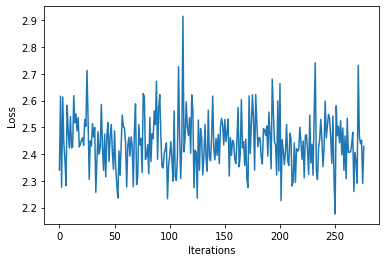

Time Elapsed 97.34513521194458
Iteration 277 Loss 2.3825807571411133
Thar whesouacacas n tasera tmpemereleasonoy f douree a tous y wisind ap wh w icen hathe.





D-1-19, ve re te. ohalife arnthorithathof hees Wecaig tinther if ane oasothanteioy ouaralind erer orin ouame


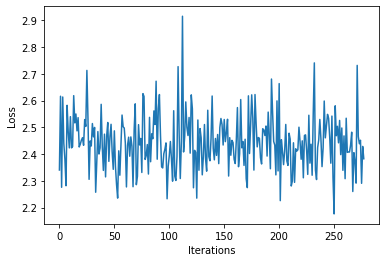

Time Elapsed 97.69748401641846
Iteration 278 Loss 2.39435076713562
Thiote t estistiniserenathat liefofithean yono ouer at ceso ph arth teto t ait cainioeyoy wese s ccpe o h tor p conthoe sthantendaserto stiereeentond t he al qustere tovate, ine wher h totepond toacohe 


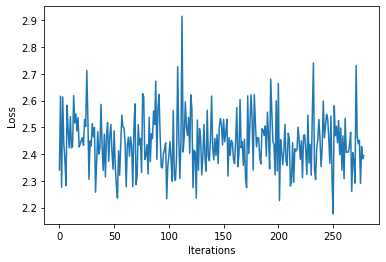

Time Elapsed 98.05012679100037
Iteration 279 Loss 2.793306827545166
There ouand iso thatho tmerupous aierer eesineremevest antono at an restipe enino abithedoulan ator thaste s, cous cang d bas cour sheneth st stoniowhas bithicasele aladin rthesenoh salitho th ar are os


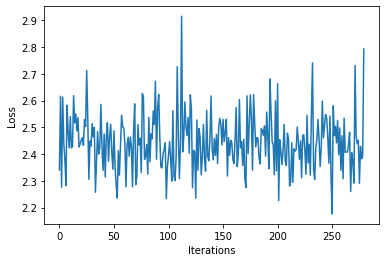

Time Elapsed 98.40393042564392
Iteration 280 Loss 2.5453453063964844
Thent acto angin' o mearyecalye ctheme, ha onsyond stheampatateed thousalo ho sans eserelore ans to s anelacasiofompt  hes, anore s chelo tes hou damere can silare otokeay ithemee is fonane witonse ore 


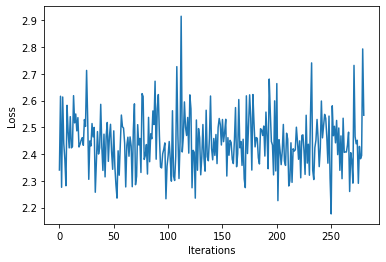

Time Elapsed 98.80196928977966
Iteration 281 Loss 2.5333046913146973
Tho coretishe bensth an remes f cthe h sexcavalore peme h on houapr anthere, iouemee mtes pe aye acth omee s beatace rt d ains o meledes s tad rore cain te. t ato dreeres Se ciou. o and h oree vase s ar


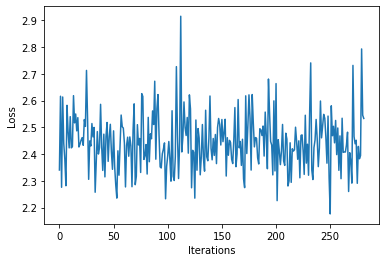

Time Elapsed 99.24070477485657
Iteration 282 Loss 2.4803719520568848
Thereineser sterof pee aca pareor sont were a cathen'sof are apote heans whoranifotecas e oures cantoust tso s y hohe ars aron prederst pre r ss are aredophe, avey te h whear prerereing toholiontes tes 


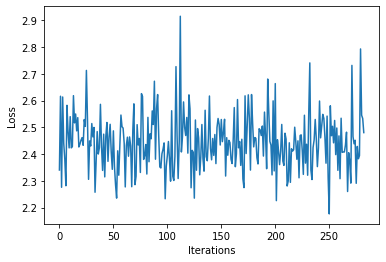

Time Elapsed 99.6825623512268
Iteration 283 Loss 2.440190553665161
Therer cho woracis ofong s fore uicathecha Acos ree er anosorermelithee trer Sarer r ar ccana t a o orso ronaliohrers adaveresint s p foresivens wore re rartasurors tominatan aref o iono rinatatotharire


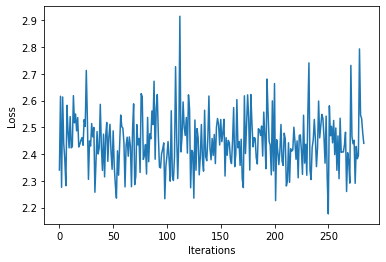

Time Elapsed 100.13965916633606
Iteration 284 Loss 2.3687453269958496
Thilarek blontoar so tiths cin athatherearmest arere'sorer chere tert ateind as yes tonde o wheeresherd hemirthe ancathote t o the the vicons ole toand p orerisuiorleas te al s are thore thather chnos s


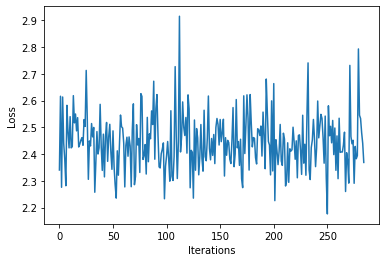

Time Elapsed 100.67856907844543
Iteration 285 Loss 2.582078695297241
Theale stohe.ony suncaphe ampredons weanin mpre aremideron hes giotere wat acatee ansuenthr or pemee ameathar nt reco puou amere ty dus so reore y so ono s s. rkesomesis sounf n anopof anuporan heme
He 


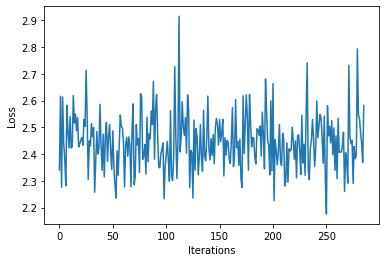

Time Elapsed 101.20633339881897
Iteration 286 Loss 2.3453288078308105
Thea arerd a s alyome.edar eey 19 tidicereas he cccareres h syered waf therie theno ur toree the burienghesteratecas thonice stiofron al rif t onoured`oforor sin veryoninatheine iousare alaspuscor pof o


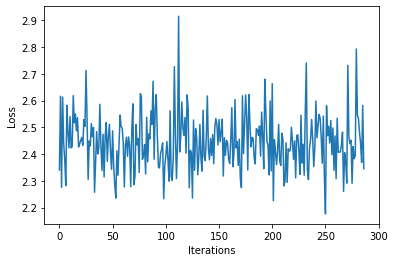

Time Elapsed 101.68543744087219
Iteration 287 Loss 2.442542552947998
Thee miteionicinte orinshe fe caruner prece che cempasth thes hes COVe tistino whor se wionsaron ar s te fon ho Fe heis n tolorerbeke theresorares ren t ster berertre her ar he e ome u s wo w chereniofo


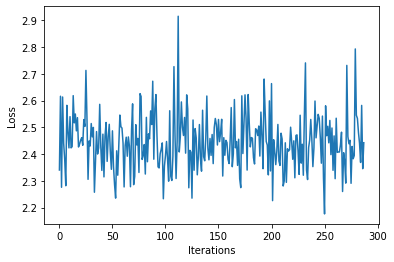

Time Elapsed 102.16454744338989
Iteration 288 Loss 2.44771409034729
Theres iore iconlon ophee anorvalirmmerexpofemounshe qus arer here plantyonor orshere., whean in yoserenenitherviamporekeathe f cofothorr fipoticane My ilio ore re ery or sheeesthe doreresthaverd meser 


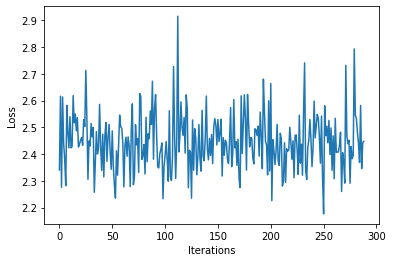

Time Elapsed 102.4908332824707
Iteration 289 Loss 2.4545655250549316
Thinor tise re hevelio atie the cir ans ifeyeresee.
Theke asthe yo we hes necereched thare eeg oceresinitithithicchiribouresthorshe atherecoresesyo wher po e winy aremequd ionteseke e ed wens anto areri


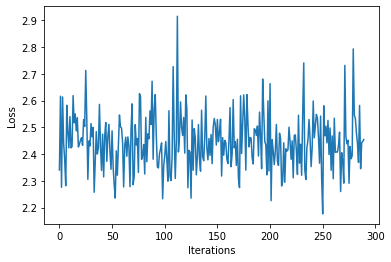

Time Elapsed 102.8558840751648
Iteration 290 Loss 2.408094882965088
Then buas becherek heeestheser pes there theneestibemabere the ares o. the poy acoresead (ee tapacenlle aned hathent chere yo d th ol to deaibmereshates acarerect re. fn whemiten alonior is or on ber pl


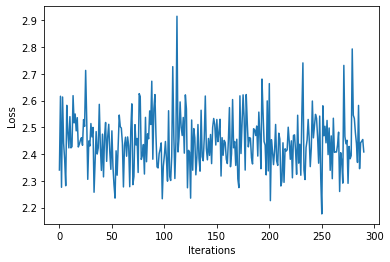

Time Elapsed 103.21280097961426
Iteration 291 Loss 2.4621458053588867
The ounthe teatr o cin orewofisithee receathediteer he tese in nes ble arereiee therean vis ke he re otsthe e elopuno pouivere as tyserdilor rer s des raneper teshe his he tisuse hedieng thore Santhened


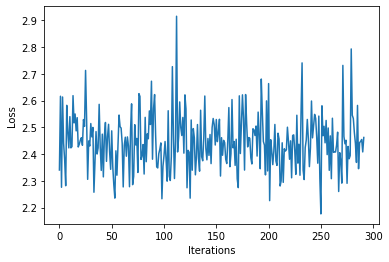

Time Elapsed 103.70978808403015
Iteration 292 Loss 2.5659804344177246
Thele reed oiole rlien athesendele Porstheared fithes the eallo PCacis f the one ashedesayaliran io pper asions an plioyeange oheelor winterue sisumbis is mer ben re ber aca becaderes ticofiadis s e Dee


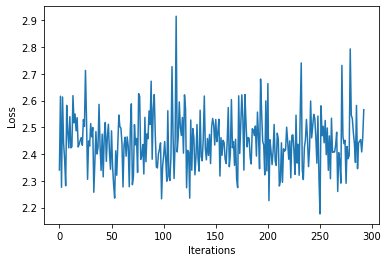

Time Elapsed 104.04953408241272
Iteration 293 Loss 2.2934889793395996
Ther wior terk, dotinor phere e osoare oralitene ayme ants Domplorin wheden weatin pereced Mesiores phe oneved terkearetheresior on, f heevexpeereyme remr einte amcareseencor anomionitshequsche pareses 


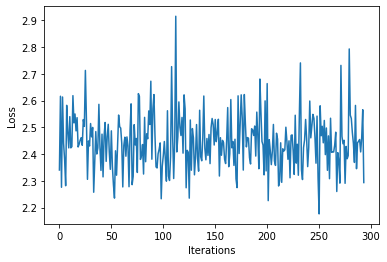

Time Elapsed 104.39898300170898
Iteration 294 Loss 2.44307541847229
Thedemerof car win ononeran thed an thor ansewinonyed ar gathe pe pucuires ce ser pe thershe d e pr whiastin onenesenyio atinedke yifindedche sealororeeinonemaliresimo en ion thesheal s ame theplins whi


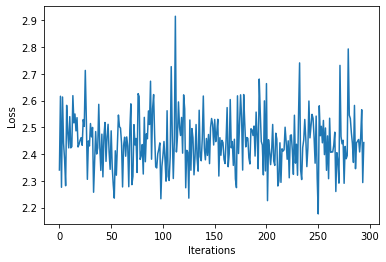

Time Elapsed 104.76670694351196
Iteration 295 Loss 2.465696334838867
Theire s sere. ere cca ave; if ireatelingestherequre Eme d tind aborsie acins o a thon osthedenenchessterecifedare omere tir sigee tacine aneasiciore nteayoundar ine canten pes. s hedir satsinye can th 


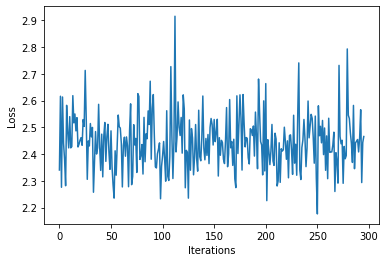

Time Elapsed 105.12060856819153
Iteration 296 Loss 2.4050934314727783
The oinofinyor ane orericamenes winacorath tarkorechese oses tor treresheer, orellirepherethensinasiton tenireieen whare the he seratin tes orl de as, orarinonde br, y yore te aladilame che fere thecefo


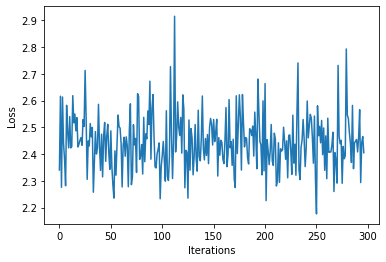

Time Elapsed 105.47533559799194
Iteration 297 Loss 2.4071056842803955
The s inthin vewacalthee cthe g 1of te phekent an welor cie deshin ote COVe an f be ibe o therye her vier dinte as, re can un ares whe. Pue ulffes thorsivicthansis, ane disorek trnse lour pure nghintese


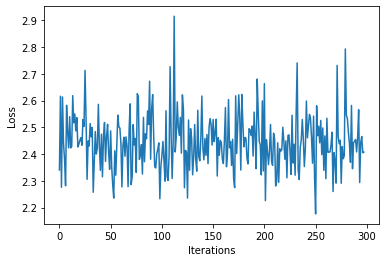

Time Elapsed 105.83778619766235
Iteration 298 Loss 2.4540061950683594
Thing ore ciloninite nghese, winsin, ay acofin wpherereco Une eana ilinsu int f sintor pedion th a d whesioracabinans areno diner (en icofre pheangeasar testhe rere s pren ye ond alathar izeor ousenanen


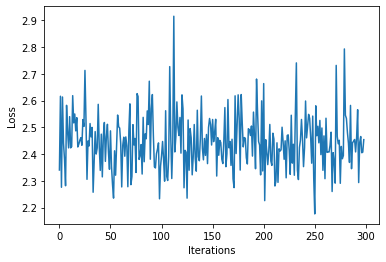

Time Elapsed 106.20245122909546
Iteration 299 Loss 2.368419885635376
Thedin s torer wostonge, r ymacheng. re ariditestonaree vena asuerawis aar may cantecha otramprn ntediemet ciste th osasilaintioner finde tin ther dinksu chasin ou syoup he hon y Sarere wacccesoneharour


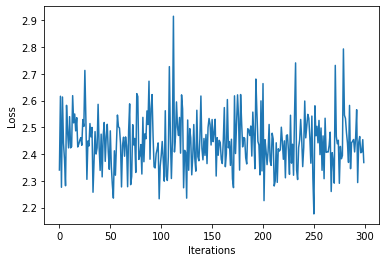

Time Elapsed 106.56126070022583
Iteration 300 Loss 2.4318864345550537
Ther an s ose threresth r 19 fors tar chan inonge ualy thestherestelioysie fee the tafous w tioranan us, eliony s wh terinthedilonesonton macap wicale the texphe tinaua acinge dore athan was r rerathong


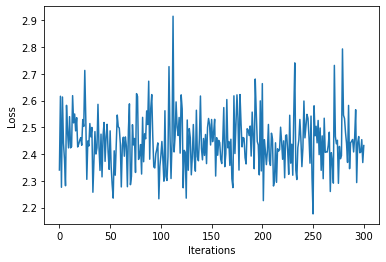

Time Elapsed 106.91716480255127
Iteration 301 Loss 2.3222196102142334
Thes d tacinterereecacavinte as, anasonerer inequs re s sederen, n n'sasiseer arersh fing con rl worong phoplalll lichas.





Thonghere hatines yong clofindeshese itor fey. nare ingedgr uironsccer thna


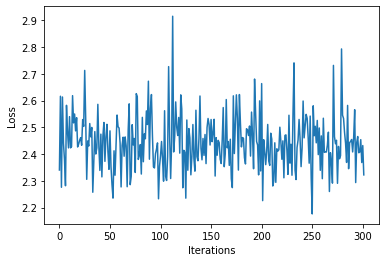

Time Elapsed 107.28293991088867
Iteration 302 Loss 2.763399839401245
Thenocandacerew ed  ral presthoohece Te wite trererimiamalis be o is heng Bisil ineamealor locar tes usasesheracon, iorde Pon plif singronescin wid s thorarstanonate whese dingese.e tersor athesenashese


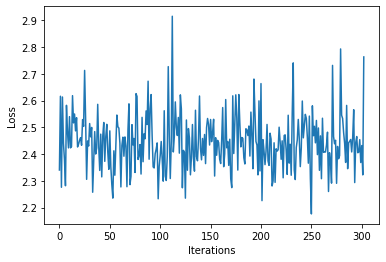

Time Elapsed 107.62716937065125
Iteration 303 Loss 2.4705634117126465
The intysired n. acisin nede o achestinesoner tenean on onoupuredinoloty ty s wiond areses, ante withinshen, arsthecitorall rsebedermph te artstantie dual t ces. ponithera 19-heng athesacr icotherele ne


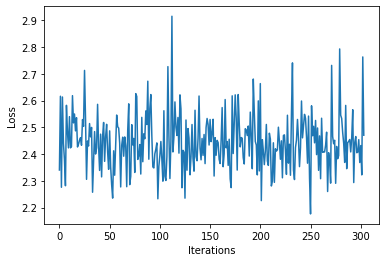

Time Elapsed 107.98940801620483
Iteration 304 Loss 2.3209447860717773
That fothatheatitheronss ten oino a tersere inares adisesse tes cch nf tyon cerornor courorenon o r fr athitin ormer iolor ason o yoinanainatis adithe cegrityongron he amequstherennss liny wid whatomenc


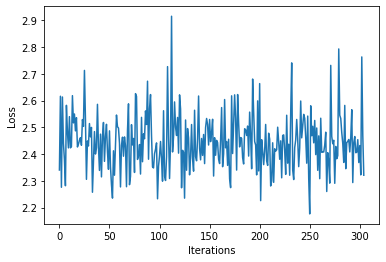

Time Elapsed 108.36103200912476
Iteration 305 Loss 2.3855979442596436
Ther enononsto Pofere, sifonstenure s m oate co o tinlain tioreidursinicarin inyouse he atares orser esealege ntemedarorer cillopopl win thofon plle wengrieafile uer af torarchelionalormesimprorar, aing


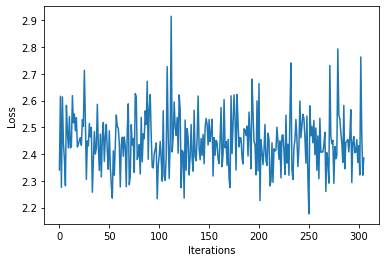

Time Elapsed 108.7008593082428
Iteration 306 Loss 2.3463051319122314
There ico.




PChaisie s taseranend tiny caa ts pe y, onon iouame itantid an ang sterares s e cer)
Aoullin r rsorininoron evan deses alord owintare ves onter es Enfir acan thaf ps s cor tinod f on is w


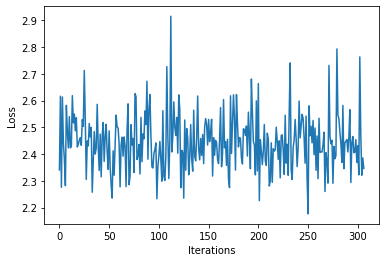

Time Elapsed 109.08153343200684
Iteration 307 Loss 2.482884168624878
Th tenosomamere yonilisofe wangastesse tan whe arie ane de ars y arsong felesicrsora tistse teste mererer neses n ce pe y Gs tinteanf orsilens tore me pere itonexivess fey ies thesoredge aris whathaye c


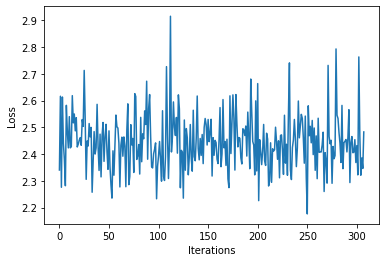

Time Elapsed 109.42158961296082
Iteration 308 Loss 2.4496684074401855
Thes ons tandininonsia ble tin s e We tiseatentodontintorede trer e or ron anee poraare esis sus ctexploralaloneres esire r r e s con isak on s pured" veen cinonorathese se ses we orecoteur s ua th.
Eam


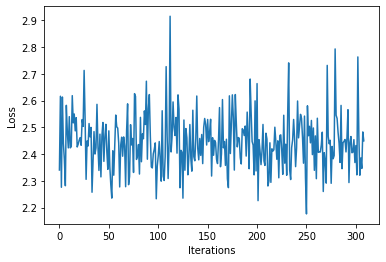

Time Elapsed 109.78120160102844
Iteration 309 Loss 2.7530951499938965
Thestacanss olothe raciongholon re s thalall e. ome int teons acen heiresis canlonistorersins thepaldereamand p or athepre thoner ccacoparons batheeserond the of atare ataia t. thostreiongion s lton o e


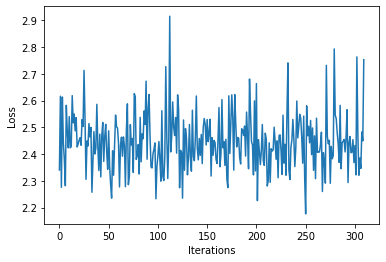

Time Elapsed 110.15152883529663
Iteration 310 Loss 2.347597599029541
Thaneastherur the the y be re ons f the e theves alabloreas hestheilinesstrs, ath wh g e parenshor atuiscea to, A fe mereden asirs al ontheseexar atad re tive thaceresccharishe wil cate poron sarishenes


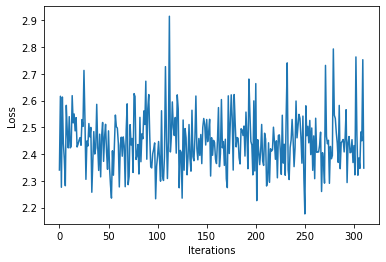

Time Elapsed 110.50616025924683
Iteration 311 Loss 2.703249216079712
Thaithe on!).
AD-19 varerease ake thece phed pl ther acorarontesealil s coyo ousif than tin fong whanore scark p ts cathede oureentes ar ar the ce ansis thed o t as oericcor ou COVIfothetyo asurer t re 


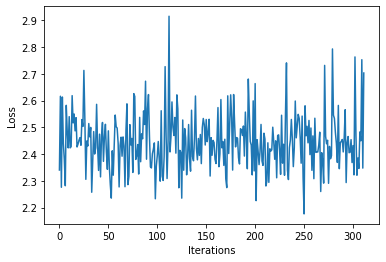

Time Elapsed 110.8630313873291
Iteration 312 Loss 2.3152263164520264
Th fouand atamo olom ates soptintenortheso lleg er arear sthiong ierie doangerelonoke phooou itis she achas s ses h thesoulas y ADigor oren fo an phanat fon f ie went apusodee e toreve anonsted tate s t


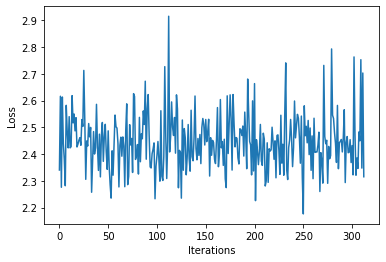

Time Elapsed 111.23267483711243
Iteration 313 Loss 2.469038724899292
Thayee. a ard erowiotis ons Cedeen he arede ususerereeellsyome sth tequacinons therell e cheqult s g fine intes pe o yon ed, tho atre n in beareas as See f afoe ale anceng ser bl wing usten fothequtexpl


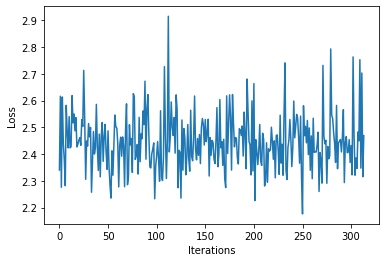

Time Elapsed 111.7221851348877
Iteration 314 Loss 2.3908751010894775
The theticee chexpeioras e asthe pontoron atilariocarene ore ne tss anee one f thor laral amiloronthore thes peronchend ou Ba lthontensoureke tenely thante. s an ard star pulotilethe fare ons scathas -r


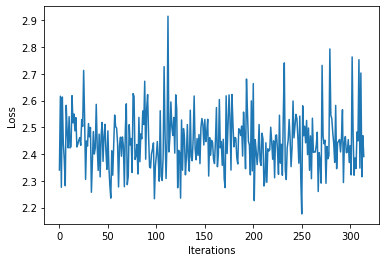

Time Elapsed 112.06323289871216
Iteration 315 Loss 2.4052584171295166
Thourotherin in cliok pesera sillone merinth sinars rin an din aralr ouase inshanther h noreres o g the athe in y pr plee pare oan e hanintil onedineradile thare per ppllasherde-prete poree pren athecon


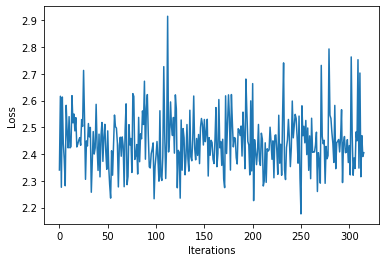

Time Elapsed 112.59380888938904
Iteration 316 Loss 2.4899165630340576
Theve s por y on oron ar pror are.
Pan h athe te serscis pan, tere aiore ars ca fr s poncito alat we o s pogiotharis gede incaminnu re e cote pphonther po pphe theher va arks we pthos onse f ar as h f y


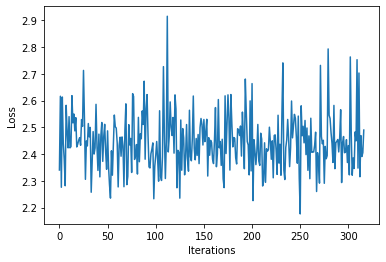

Time Elapsed 113.09012484550476
Iteration 317 Loss 2.4220404624938965
Thertheinoresiorouineratheinlonansiomeramereemaireropourer ins necestantrarcororese deren anen ate ph the ld ts an ve wover in enoitoabie ten ran t this f wh amerousisine a a p wede onee heren's thereed


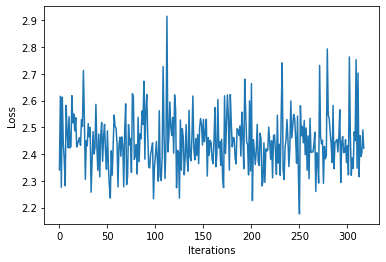

Time Elapsed 113.60947155952454
Iteration 318 Loss 2.2521419525146484
Thoccrk er sin s caneer t (owhos n f win the acong oncacesthiouprare win at f aficionges a yo dirsthewed ovanar Bale Poligibly vemen ther y orer ccame.


Inse can aryonge d cerecemar ou ale lr patheriso


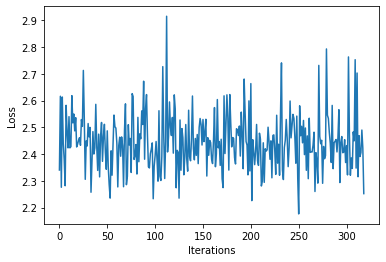

Time Elapsed 114.15724420547485
Iteration 319 Loss 2.4251344203948975
Thesin theallar ore ve an sede 19- pomiaicin ccin wise s s powitoreant ind heme. calinth won oniraranan h an orsthenorsid thapomeren rarar rth f afuaprermeeteant es thinur wionth inllilosere wiorere pr 


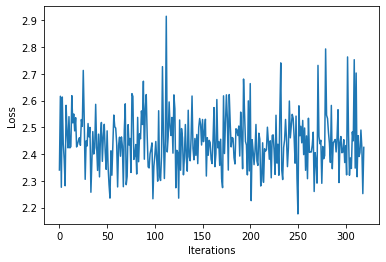

Time Elapsed 114.65614771842957
Iteration 320 Loss 2.42350435256958
The ccamengneasin mptialinin the onthin an ames ur eneracor the erorcathekind: feren arenefemeved as fo thee, erind: pus s winthacon renecothesthoporshers bathe ho uave Qnileesionaleshece s Wio ron onor


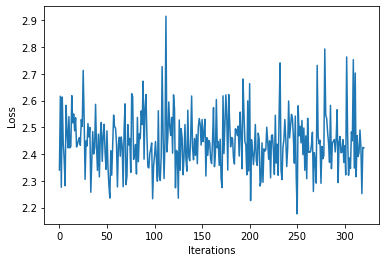

Time Elapsed 115.14687395095825
Iteration 321 Loss 2.3931283950805664
The ure ramintie ofonacotrs pporcor alondoremacath Ema ay be aiavin He nin s on thersinepreres ere warins pacinan Sisuatrowishered pof Ba atie les Satongate at emaveatitind Peedothe the withizath be rth


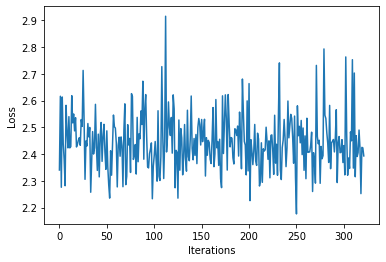

Time Elapsed 115.6271185874939
Iteration 322 Loss 2.3318026065826416
Thre ca phe rons dg, pre st se Sament tin asthe s thatha in icionther tabl ononk venin onthe, p ts y ceasincisth rele ovaloae. eniocioticareingenon-antreacanin e a nthe whercithe erfees fr nsentatin aca


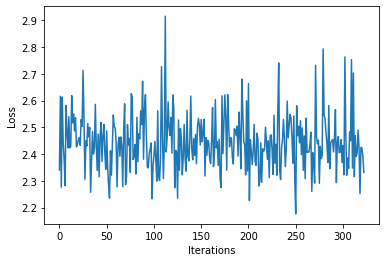

Time Elapsed 115.95756506919861
Iteration 323 Loss 2.45334792137146
Theariongurese anfoyenan ake VID-p ouninl ccepth ce ion res oficho vareill r e rdinitincestohediede winte mermanaieren p Athes wirelousintafo tes finge arapherof pinony ayoion pr chempavanon' oreamere w


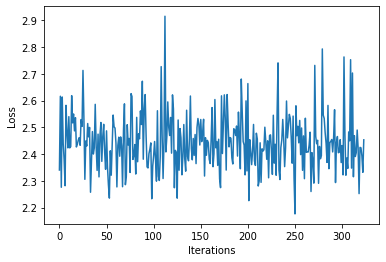

Time Elapsed 116.34614896774292
Iteration 324 Loss 2.356346845626831
Thefin). pue e esthintis Bone anthnthin thivais nthioyontilfiamoure tin l an ithon aracilalesin Dis otis oretheme wiotshese thecind astha pres irededemealin s ous n s r Bapoun is. a ve re ontr winteron 


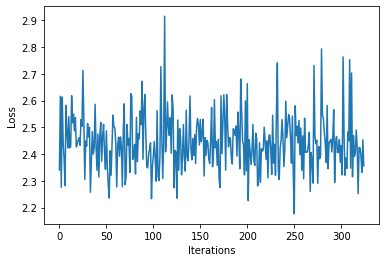

Time Elapsed 116.69511795043945
Iteration 325 Loss 2.42663311958313
Thes Bary tisy Ba n s cacarexe in prenequasiroserentilecoun besin viny red the nur tothntheast on thed Jate nerays rmatalioreree or wines manerer ing omprere wie wisono hequre ppre fin r ath ame on pes 


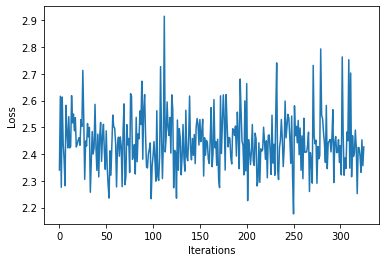

Time Elapsed 117.04736733436584
Iteration 326 Loss 2.4233224391937256
Thameno sentenavathinson atherthore/gasof tin y wonieg estinured doression atu ourre nediore teen canratesiemenes stion oletameman ID-n o in paphe onsthatin. theamed s Coyonarere Tharedee Coviree ore re


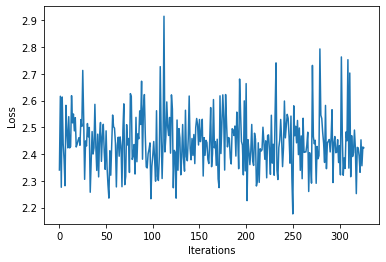

Time Elapsed 117.43766045570374
Iteration 327 Loss 2.4356744289398193
Therers a sinenthemppar e COVIf alecoud anthetinone tensins ilinilt at datenewin he in atiniereree ac g ne ficinon winton as Un senourenes n s amses weres heva if thanastyourerofes oucar woviorereantint


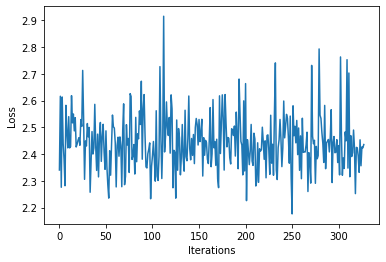

Time Elapsed 117.79083943367004
Iteration 328 Loss 2.2989184856414795
Th arareermaratinarein ntithesearmipes ace. dioreac inces wh ores d d tedenore. ohinc. a n fosine arer are on athorane es Bacorstheyoust bilan athe pre povivis cce thed tures s titen ie e  e Porommatere


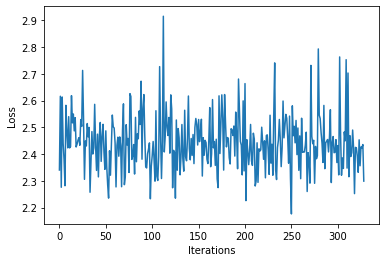

Time Elapsed 118.14064741134644
Iteration 329 Loss 2.505753755569458
Thenofes. acareriofores s sk iron resouemacathexpre cionthen t u iseroalte raren winio g y tiniequrineinininotie f s f orerthetereeresto. are plt cangedenon achenfoust oures areintes f s wiccis akecheas


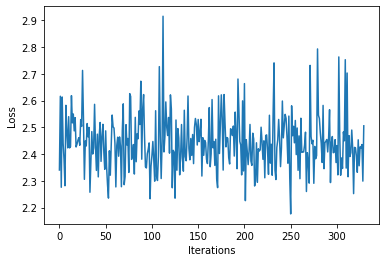

Time Elapsed 118.53485870361328
Iteration 330 Loss 2.3691306114196777
Ther iotin rarared oren id than d sior s s wisen his sulomerermee ilin cor haren ales boresinemesieritines ve gestos the d Winerionthetue yermeral pres hy ave ath are orsyonasis paneare t bare oronselor


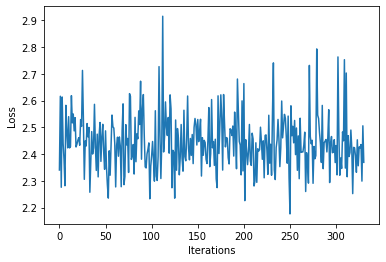

Time Elapsed 118.87524843215942
Iteration 331 Loss 2.406761646270752
Thanarere alisce re matono Manto tor iod intouche (Arematirtale. t urmaphareres Badere castherarme atempenee r Phoathincinthe tins Batindere mertegreeres tursh we pun ol as, ou oren ecirenin y wing anin


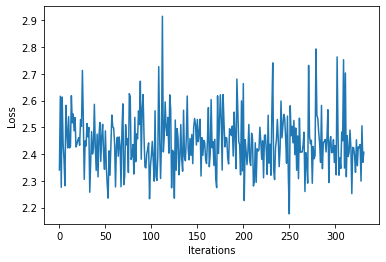

Time Elapsed 119.23561310768127
Iteration 332 Loss 2.2950007915496826
Thouifo aresur ce athaiournof ean aionin tivey oforanllacaperalee s ice A can anyon rese shesoure n averere tus ie oueerean wo prsitise athese tother omme sesthontoureseileishespam p th ches wire ce rre


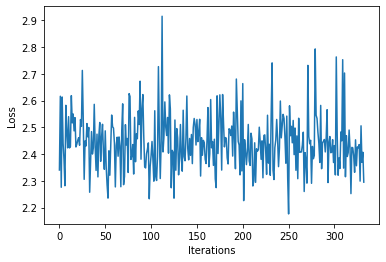

Time Elapsed 119.61601972579956
Iteration 333 Loss 2.4252421855926514
Thede tithes s rothoronch tourere ausheare y se hamerous maver camacithenalocerthe ire sorer ars e an win, cigrin rere arere ared omeed. s tumeur t mallame epr ar earorer beeme ain y ciosturs enaiore y 


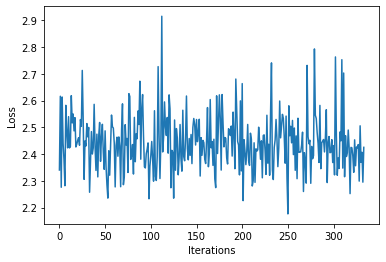

Time Elapsed 119.955810546875
Iteration 334 Loss 2.5104191303253174
Thormeciof stouroratho wing. o tolure min ce thenotise oresiccinesereen bal. tresoube onter ar wiamomafo ece poife tis ccceeyong intinseromploure ilerolongs Satarensimong. altir iondeeequcats aleotorer 


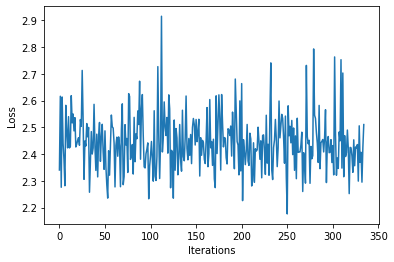

Time Elapsed 120.35146474838257
Iteration 335 Loss 2.3486485481262207
The Sarethid o conth s r rericouinoures so rll o puacacest ivin as cceerof cinire ofo qur ton Tho aratitheve are a poms toce the ses salr veque tiso e pharequrampu pu a sire colintoso ar ve ncose a is a


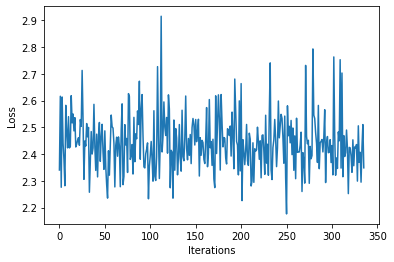

Time Elapsed 120.84467077255249
Iteration 336 Loss 2.431382894515991
Thedus, itho itie. ern Unequrteseeneren thadequaremen sth arouer ireressuloren byoyour th wous torseroupl arare fousemere ared atours alouolothin insesincre youlino sinolontomppofonurowinito orere n ane


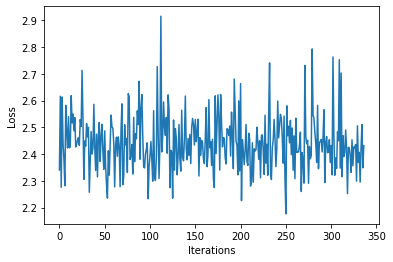

Time Elapsed 121.17180371284485
Iteration 337 Loss 2.437110185623169
Theemad ang d th our arourarencomote athour Cinseacee ton. arepose ostia cloir inereshiereree enome r to nthiste tiores SPas o teeeyo trevacoronarestesthe arereleson asioraccce te teath resours Sen hed 


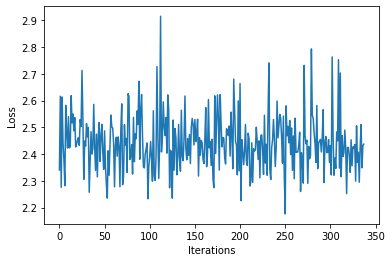

Time Elapsed 121.55689406394958
Iteration 338 Loss 2.4020297527313232
Thesese a n ates te ar. beere itowore thare asueduigenealore, Thene inine inourenyoneesth areason ccers ome cins hacalounge istisistof ome pront te, be Cotanlltin atoulour bestise ousthe pes ronen aredi


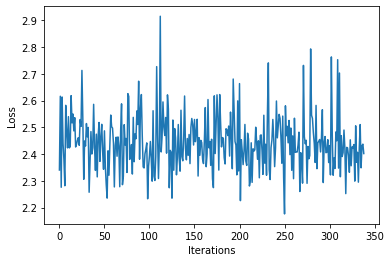

Time Elapsed 121.91193389892578
Iteration 339 Loss 2.46400785446167
The. t co thame. forksthal a tie oushoue, Tee th is rang mon loton ress atouin am acal erayomesito arenstareshengrving aararione cases thee othevere, tyome ine tr s berse touineneabeeso oroullona sene w


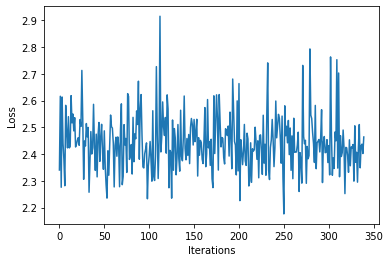

Time Elapsed 122.27623414993286
Iteration 340 Loss 2.3944711685180664
Theres. resthe n ers t lye w. istod ay can winest s ten oureee hors anr sous poude, der es, tin there pthed d de a achourerereare Seesory ymeshe o oulomemache tis Joso tee athele ang thitere yolalompere


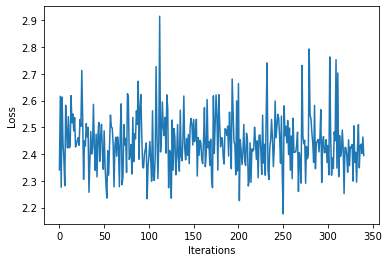

Time Elapsed 122.65270233154297
Iteration 341 Loss 2.4039719104766846
The ameardge oud d an ash vais wice er ar te (nstenteeg es.e y core aninees edge te t rece the ad t avereond tenes togrirsheraly qu bute ansingene te amaly s eris o the pr tese orestesee sira theanthise


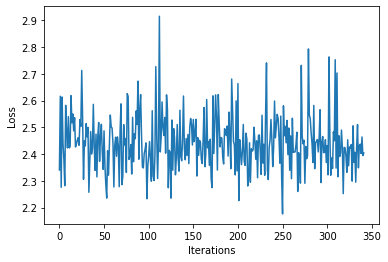

Time Elapsed 123.00897693634033
Iteration 342 Loss 2.5882279872894287
Thempt ced, longielin areace arestese s Waniesine cisthed He aramee th anaimerenilllide dinore Momose otalalores vis whacein a plinthere p. iore athen Hor a in en 19 as; sion. s.
The hes cou thee pl tin


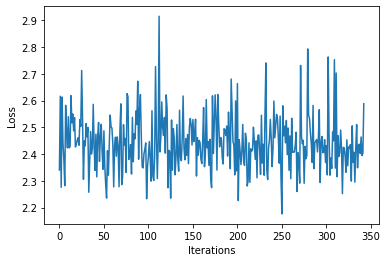

Time Elapsed 123.39189124107361
Iteration 343 Loss 2.3633129596710205
The amesthore caremponewono Balleide macre e acanthe. loren tsto are tinesoucerve als rs CRenathang adee cathe r yoyneno ane casoures acore avestores. yeren asthes iong pld Sate thee. mad" e tonte deven


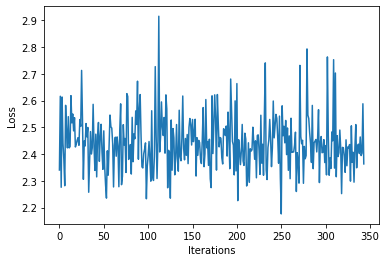

Time Elapsed 123.74359798431396
Iteration 344 Loss 2.35093092918396
The ndg gante gesthe thale meesomigirasiliron ameseang d f S omeshesthenar aren then stenes asie wou cio candecear a rsthed te ntonase otos.
Plouiourees " sth hes s teth as o stiouan Sarexa rea bulore. 


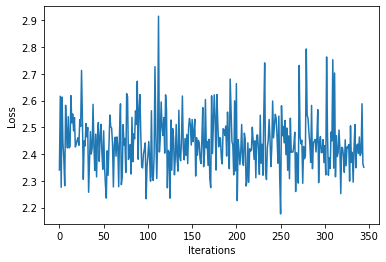

Time Elapsed 124.11335563659668
Iteration 345 Loss 2.44104266166687
Thiowinerequsonu ca cayororeg re accins po g beaningreapan ise s amushan arsto -19 a o coua nenothoiraskeathe) mpuamer cous rk aca borerest an atusthored reatho a mpo anesin there ccinoustor the reron c


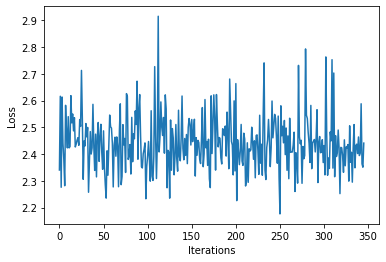

Time Elapsed 124.48714685440063
Iteration 346 Loss 2.457995653152466
The ceranthe ameromple wee s tioua ayonathon equar yonouren yo es arme CRido tioreion VIDiouarens th intie denthe youarshes cintone an yoo amuaraion mptine oua e veestir r s Uno d t f ang toungaracoulan


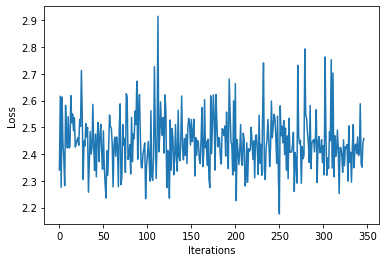

Time Elapsed 124.87011051177979
Iteration 347 Loss 2.512927293777466
The strsouste arey se. catoreertsin yolir d, the merer s m yor eequs
Opur l co a ul ars a a r ackeracee g cin there tin:30 e. te sorere cayo towhen onde an plisetia dereee theamad re casere itesioterang


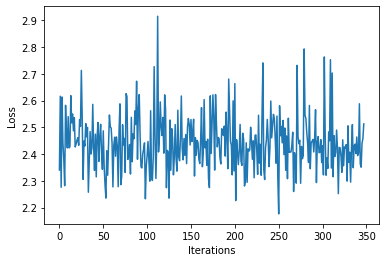

Time Elapsed 125.28143429756165
Iteration 348 Loss 2.5256853103637695
Theres r can an bliome van therkeir thenin s re oyonores arent titatinanictha anoirorourepure.
Thaceay d ineusure c mpre. sir yonarer'sin hecin a amp tas. an ton orere (ithe s a. ay, qut bexinin hatuint


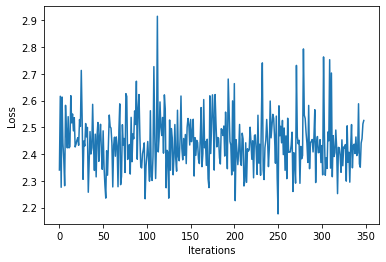

Time Elapsed 125.71761417388916
Iteration 349 Loss 2.626413583755493
Thange ant barshe oailtineniloves omorangaril.
OVIDatinrdes clied alesingin eg rel tingreiomhiouliicalers cen ares thedeeve on natowincein areevalthe. ase be acato is abe stron stesin a Cere vinoramatha


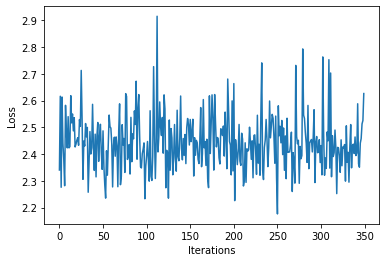

Time Elapsed 126.24931263923645
Iteration 350 Loss 2.397693634033203
The msthayolang tean an t. yon atise cayo teesior edeinciss nane owiliventior a neres-19 t rty aide caninginon ortine a thapocan catin ioure. on Couieseredesin s pan cin Revacomarstinater ain e r asham 


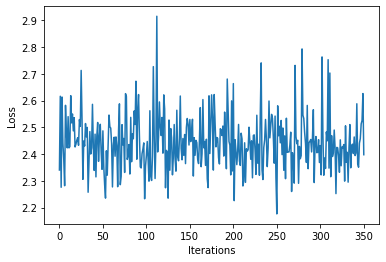

Time Elapsed 126.78812217712402
Iteration 351 Loss 2.438232898712158
The ineccinlen aca camio ayoung ampre aracararard rse/berofiarves inintoulee w t cesose ca quars tee, is stiouremes co ousourthin festtin cinisohe thitin on car mp. h cariaryouso sthon  tialanatayoatis 


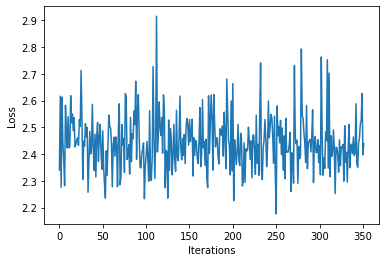

Time Elapsed 127.33038258552551
Iteration 352 Loss 2.3603625297546387
Th thes aisckesthoyos as ios tirempo o ay Sare orevene Cone Wheraire qure then.

A palacemplira sthearinimas rin wouresin testisime thiomayesio reevin era anaccere oresh tin f ares keritionacars tes. po


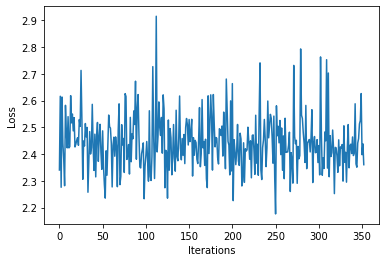

Time Elapsed 127.86834907531738
Iteration 353 Loss 2.4146690368652344
Thescacipemors.
ed e arioresiathio ter soushes fforonthariour Macinorontin are citenc wh so re an e aniovin aresthens puiamor d usthe ches bequdolacathe Cedomipustition ange on d ngietoiva s thengais ca


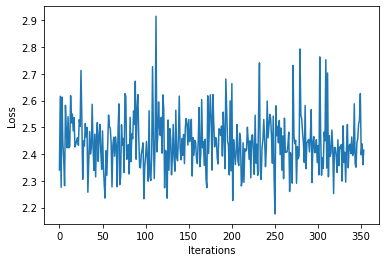

Time Elapsed 128.3927707672119
Iteration 354 Loss 2.350184917449951
The ar be ve ate f ar s. p ara the mecin mar anins Hel.

Pe 9 ficciompalo Corare. theg bio Bad e tior ars ses Hane pllen arou onontener Sanfous in Se minarecalorer ore.
Pacheniact iotin th asithion recc


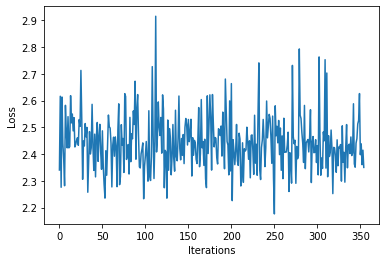

Time Elapsed 128.87280869483948
Iteration 355 Loss 2.3721182346343994
Thers aing re tilawhavare o erueneliediourio ion a thes. he arvitorver s orent acorts a omacking ane cate bls icing wines onyowioniousthin tershenthediommare tin thee ir n d oriom. rstioroura rine mmici


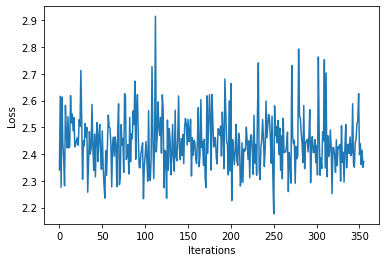

Time Elapsed 129.31298112869263
Iteration 356 Loss 2.4613215923309326
Thenge aco earedalen orrs wean torousth ar r alomerate iocon pathen ace rdowiesid resire tin hitare ican ceatheshie ilondionturere yo. t a d ayse re wio orin ioreninestmore theeanerinoporathe mons plice


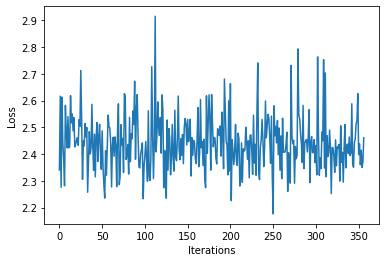

Time Elapsed 129.66319274902344
Iteration 357 Loss 2.5613789558410645
Therormpreran omer. resshe atyon co a of e Cesherenes y phe 10 din thealomengr ck iotioma conen t. uro d aborearelowoals COVIf urin t vantir me non or he tinion m s astinlos s w the erivioviomin our tho


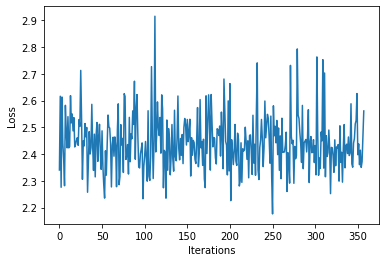

Time Elapsed 130.21312832832336
Iteration 358 Loss 2.4743053913116455
Thathenesinalipotiofon hes arn ane oninon anier merororet io sostherthanorsesticcthe f ar r edin mencinge whermacean wiores ancin an ahior iorearere then ccos r Asonecanctio s ar cites calo ts at cilee 


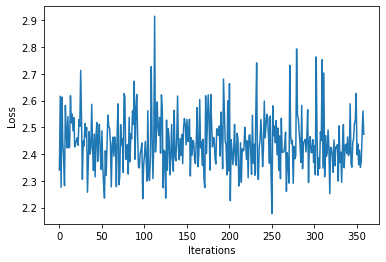

Time Elapsed 130.5436236858368
Iteration 359 Loss 2.305983304977417
The wean cin sesrores lour omamerasaco ke wioladese hor re odon ores ins ang ter teecestheralourerermoreres ideresecere y ces Thiono Somaning ain teeto ase on deeathempa d be tes oueree pon to acks iour


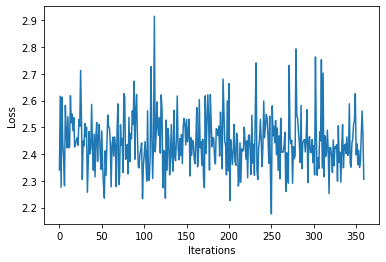

Time Elapsed 130.93353629112244
Iteration 360 Loss 2.422823429107666
Th ccerale tidithale. acot acyonsthesin athoforer caresuremin thatha Sathevarera bisorere iror orofome intha apo s bla dinuero s ur e erers vas Dal Core whedges apouese henenaf the win oreced wiror. alo


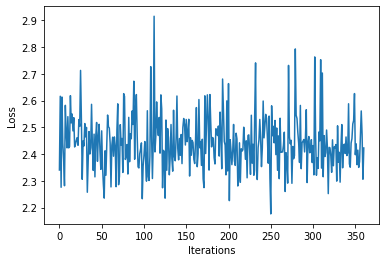

Time Elapsed 131.29930520057678
Iteration 361 Loss 2.7383227348327637
Therarars we alinepungre gayoyong ere. canswin Uny s clal f the. stalitithereitereshenteemorenouee m tey ceste setherhe beer tesiorastiplourot eampreremamevilyedin pu a re ckereavesithe tofryontin f the


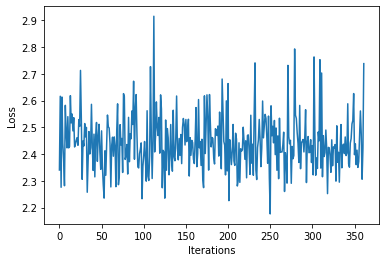

Time Elapsed 131.678227186203
Iteration 362 Loss 2.720712900161743
The con athey allancor nee Sarer theresedalesiowe s onteirermpong proreran teth tey ad thes mas ce te ayouree cor tarereeco athe yongr yoHesoros batofe thin Honthelsteres whin anese heiong heathe ar s t


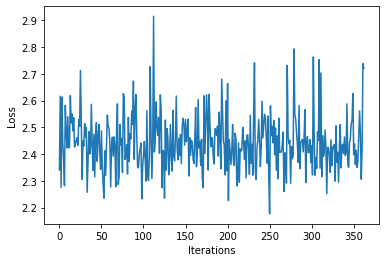

Time Elapsed 132.05161499977112
Iteration 363 Loss 2.4025704860687256
Thor tin id hekerere wisy s ion se bacenert thepan aper beer eshe fe fe ber yontithorar the he thes toncinen ome Sexes on cir tere p. t areone armad


Oustha Thediacer ces the pleoneeieost ior a t manit


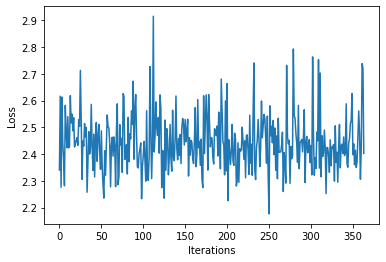

Time Elapsed 132.43347716331482
Iteration 364 Loss 2.3737101554870605
Thes orerest ore catine ioon nte f theth therthemameriser in cermantrouroasheyethe shereroutrithe o nt wion a ionout Ceanamor ralioror hetoretediorenoreres. yss. a rotheraioure bee s pre pr diorivearsin


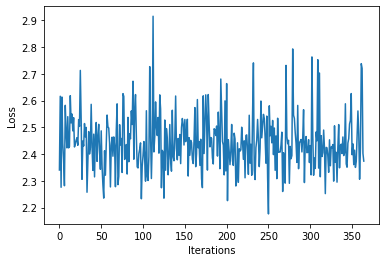

Time Elapsed 132.8388912677765
Iteration 365 Loss 2.246335744857788
The in.
Cour athe an inelite.

Yother th io y ored oron' the whe can me y cerapenteindg io poloabyor arthe n be Batereed y ofr y mu s temeades st cesestero hes an Thethe atheas ther abe thersoun Batas v


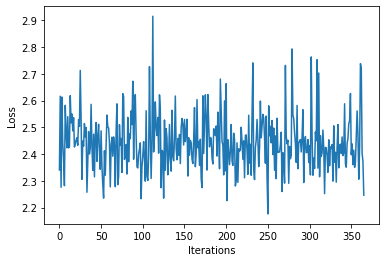

Time Elapsed 133.20064759254456
Iteration 366 Loss 2.6282360553741455
The athes he thequr yo. ce sicrin ocin s y wnistest wesselamate re wontyo nthedin thertathenen tesideramear nthan asur ores, cof ce COr Bacestheader erme pawherore katesin Fonke os corthate ry heeror th


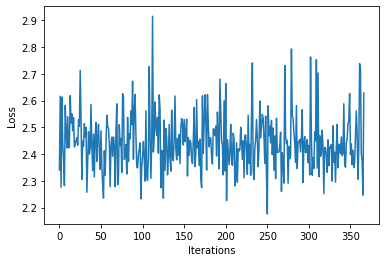

Time Elapsed 133.59533023834229
Iteration 367 Loss 2.3156301975250244
The blerseree ysthessilouthesortheesoniouarere yourlthe whentheses, g thenlour urorsecoffo canark moskesthere. Ane stesthe ticenss te thens arceeno cte ar cas dase onirerinore altace af vamesthesty ter 


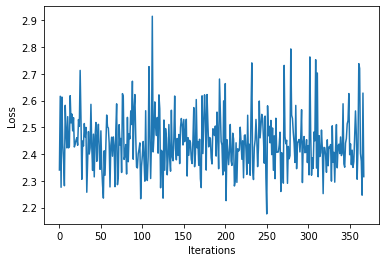

Time Elapsed 133.9674940109253
Iteration 368 Loss 2.3639204502105713
Thest vanstit or foncrs th De R esthe inuint ponuscesh tithore Ches p thes therereal acean catiornteses eamesheas achenstermall ccresheicanach t sessco fiovaise n ilerecte te thr sthaiong thestes th cin


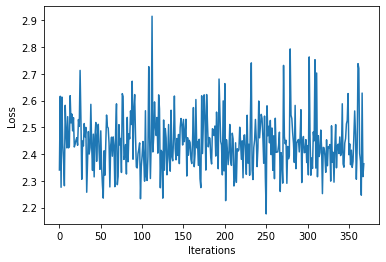

Time Elapsed 134.34537935256958
Iteration 369 Loss 2.4992034435272217
Theree ngrkes tome. thesaye feseshe che sintis tor tyors tis Se tonice aralon denstitesin-19 her iontiner te Jonthes sthes, shelen hear thet ror isthithencadititeeous e fens 9 e mo inioree red l Whenge 


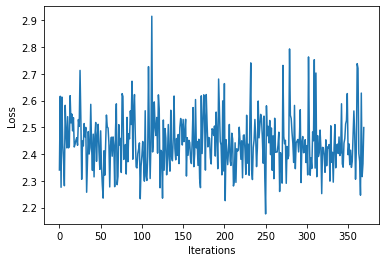

Time Elapsed 134.72805428504944
Iteration 370 Loss 2.541468381881714
Tho g tinin cteerenesancas pte acearve inthean siseke in withestistath we cora rermales tond le aler " anioure tyonto tasu tinofo pamalinolof sthes ave tiousthar ar e our asuthe tasteicheconge t wicee t


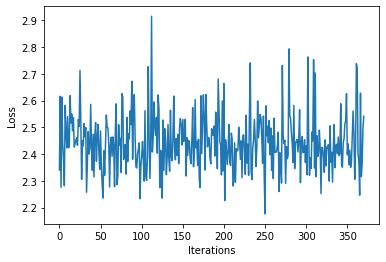

Time Elapsed 135.12490487098694
Iteration 371 Loss 2.275967597961426
The tusinallal thern ateesatormusyonthe nesican pas. yous. ocetesirequlead wispthemen thentmioul t athedaf temee ises tures s frtme.

Paior torandederou.

Yone to delatstif 6ous ptacas e ssin acles sist


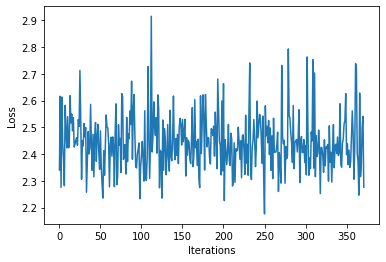

Time Elapsed 135.4907476902008
Iteration 372 Loss 2.3848414421081543
Than t an o o a whinth R besonale cacoweploste tind a erameacasthe anatmiserkethedod olats the sinl telorer wio caned asienomporses coronavicinstesthe teathe in serer med Und atentinto be ist ge there a


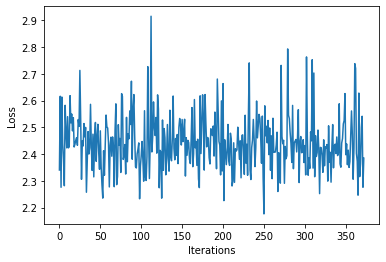

Time Elapsed 135.9020071029663
Iteration 373 Loss 2.288466691970825
Thes ve w-130 qur heng h tseacare wo tour erofe amerse te Yonabe ckirerere athee ty acer th cair te W-Mal te ty te. Stimed nf cionacthesioresis aesio ste to t Sr then ble cksin Alo tere sa onoresthe cal


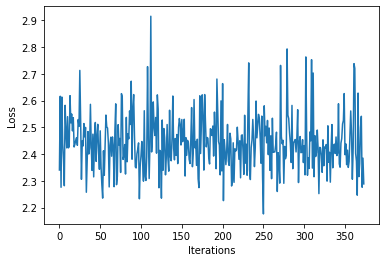

Time Elapsed 136.25526094436646
Iteration 374 Loss 2.366088390350342
Thie ksuretese yorn oy.


PHeseres lle te y tharsin D-cir rousored cone athesteco datiorer. pulatrd cr an ore gentinalans fed an widerance cinthat w OVIDe h f-10 tasto tono ralicine t nthe tithe ple ion


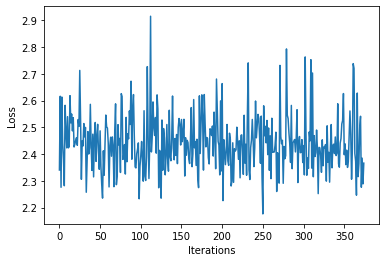

Time Elapsed 136.65928387641907
Iteration 375 Loss 2.7268118858337402
Thevase testin ometouren to tin wictene thes ma at Priono. themal fosthe es ein veecay frtmeninllthenanga ede yor r disesitaco cadoulitid Whee e he nerenacer cescalesofo. clavan titises tore henal dosio


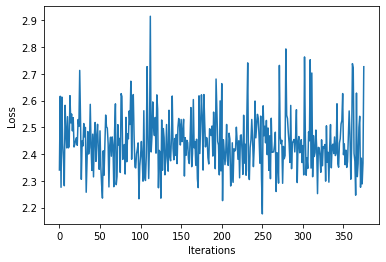

Time Elapsed 137.02331233024597
Iteration 376 Loss 2.4622714519500732
Th t " a re nis he hen Resen an uroopate sator stesiom y g so Hestecein acine terst eses yong a adese uatiothal pouanesarashe tmange tho y t yohatonitinorinlouin te s ivan forinsaniou t tr ofonorin ie a


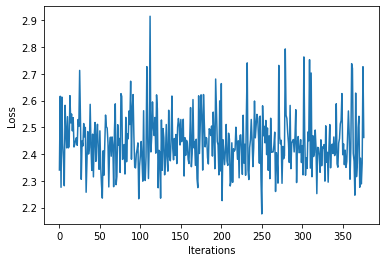

Time Elapsed 137.43967986106873
Iteration 377 Loss 2.4468135833740234
The. acese ars d tis te thersende r yoila ache se. ong ts abin. alde porors e COVIDr the nirorin or pur calin, Bs re d te ars ourspoalessinifon abuit Yen otr caton aticond you be r aco. tongere if to pr


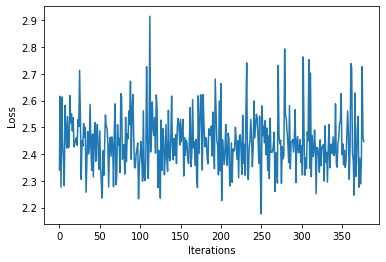

Time Elapsed 137.80810856819153
Iteration 378 Loss 2.469947338104248
Thol thecong gesoy youston asthe sio atheo acac COVanidis porthe pou Thare temarenin. damis sin n jon lte be ind rcon her al h e tstermabe fo.
Ses indofe woler ious Sa pl. toreramaso tilon thosyosi ss a


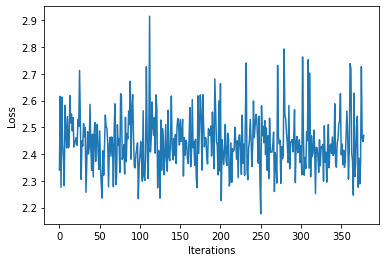

Time Elapsed 138.20750260353088
Iteration 379 Loss 2.4548721313476562
Thecoulithes ceempar f wh ace te re amomerether tocens f D- por wonaccaled D-19, ton ze o cothe s rio tio parsonatheapo thallinthenga to al cer an pesorilize ge-iotiof yon ablowitin comang cacalas tone 


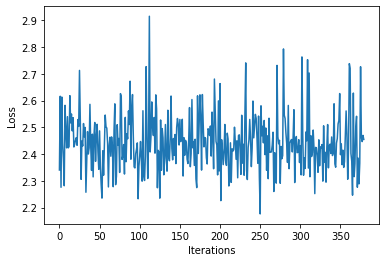

Time Elapsed 138.7229950428009
Iteration 380 Loss 2.462688446044922
Theersicane redio otheiovat visenathe ou us f mpated fr rot an thace.


W-1, plon d arde wacosou n g store pou eden nin ce no on COu con oulape s ton thiouayondeve bes seeas pos s win eece socasprar ath


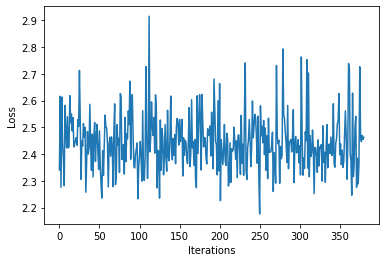

Time Elapsed 139.07149529457092
Iteration 381 Loss 2.363009452819824
Thede Ungestione be one or calat arecin pof bation so meatou 70 Vpaleare ho an o ongecinolaladinaran aciiotork a s onsinther s n alinionis inacer athote toustheinlalle ng 19 sinar e cacouronous sand e y


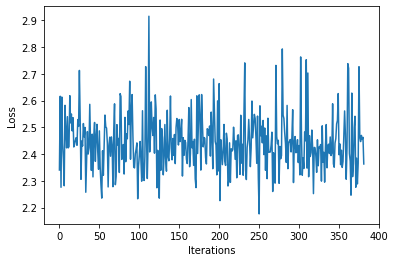

Time Elapsed 139.52810072898865
Iteration 382 Loss 2.486891984939575
The gere ces plo niolire ciolinon adur sedg Macon me, viounsonus rere s asis areen mestie t yogeo valof cole one or adecar wr iverespou te grthadissuifoure Mat norse on cilar sinol Win mo intiace a ses 


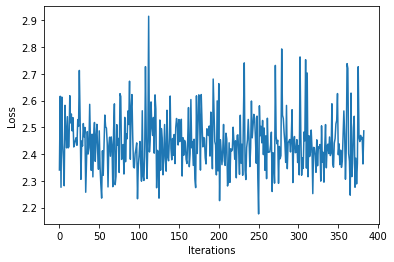

Time Elapsed 139.98957562446594
Iteration 383 Loss 2.415163278579712
Theedak benour win laltininithin r Moucid a wacour to dina hore the ce ang an r consse thees hes eese s acescize pabo are 15 p can ton te her ingis o acasoron texenecirete vio t iske p, f a nerereliseen


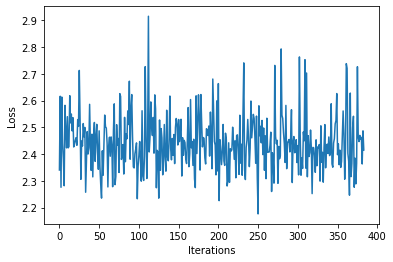

Time Elapsed 140.42096066474915
Iteration 384 Loss 2.284935474395752
Thale ecad e rees pailo ce plion bon fonistonie f teg. se enes onche po r tererer we wisen owoher iololin y pra aca vees rin ale prerounorechouris hancou inomewizeeeres a e h ac atellacha traponsin nfe 


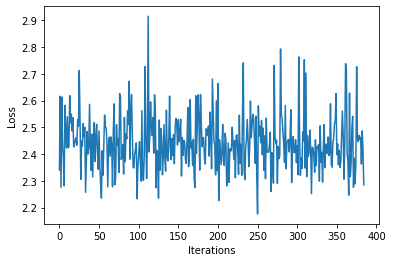

Time Elapsed 140.85542011260986
Iteration 385 Loss 2.43681263923645
Therse athan oncure a aile aluinare s the masthe a -146 od cofersisth prenachinilancckereses tin therese reccleer pabacizater redile fern as can y ninte t on yonanle scion te in s fousu thestaliou in er


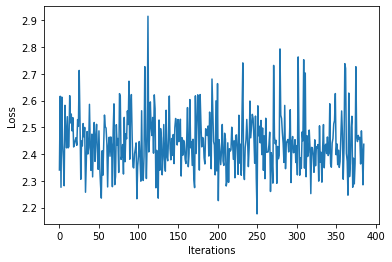

Time Elapsed 141.30349922180176
Iteration 386 Loss 2.5856149196624756
Th wivin rk s aton h dicathere roneyo tind shiothe or wioof the Ba thenire barenores cayse t g genthe th od"D-19 tes araren r thering -19 achersisere Bablon r arer theereeale poafrke tire wivare-14 whes


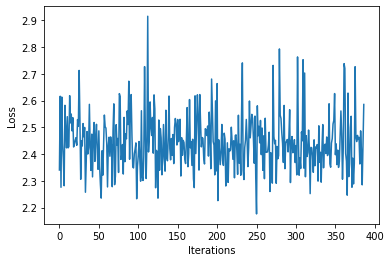

Time Elapsed 141.72180318832397
Iteration 387 Loss 2.4404845237731934
Thesteshethe ilincerer wOVIDinerestenge ourinousu haino Sasthe these s n the Eme re eresouthe.
IDAs yooree tine ve ackeresthe the thequreanrer me inor the anccacton s yopur Dintathe she cth ore y. renog


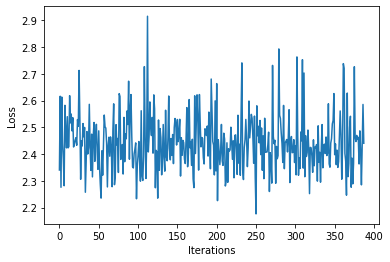

Time Elapsed 142.18102979660034
Iteration 388 Loss 2.4550533294677734
Thesin Ulalineretontinfisered coreiows gre r taccequre arerer cothallrecathee en. thats Hen cangreyoncccat y n y artoratrr her thereres enarere meende h d he char ore ta cinin orecaresstheacan encrecobo


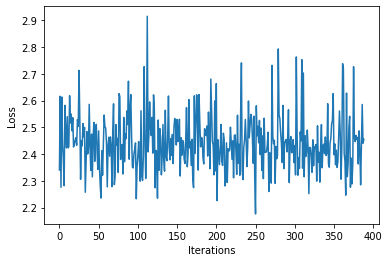

Time Elapsed 142.6542935371399
Iteration 389 Loss 2.4207043647766113
The thes the thear orere teines sers teereerin.
Anther aterg toueciccene thof wher g nra athe m thereges anase he o tinthaturasthospece atintharedes tofr fon r af ace, tharke rne ateserede ede tathentha


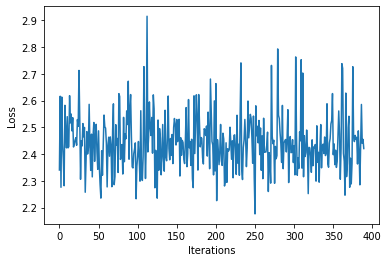

Time Elapsed 143.12675285339355
Iteration 390 Loss 2.549851179122925
Th f henthe as theeere cinio n anarieerertesy on hoyourin haree ha iastarerermeaites oure arelou tees s aninor r 19 silampotinacesconad acere an/p reshe ter on anar thethonicar viondoores, heraleserinar


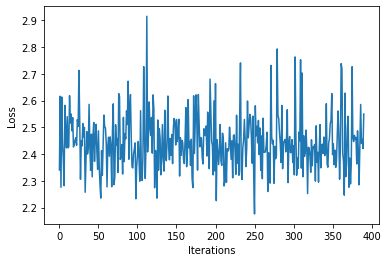

Time Elapsed 143.64493012428284
Iteration 391 Loss 2.321681499481201
The on bs acerel d s.

Antheer Themes p hansthonarthe asstor in alalinoyereerororeseereson r hesthamofadireas.

Car fr ralaltindine besthe t te ongre the tiostele aciorer mios Sat aonalys VIffeare ar th


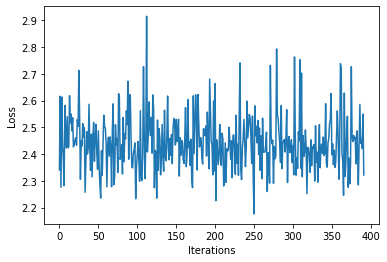

Time Elapsed 144.05462789535522
Iteration 392 Loss 2.3698477745056152
Thesing theilllalone a cerese He.


Thestheme these IDee pourale ar hor rtirill yor pr man ir anuse: thexs. win yonererererth ppr rs ppar f cerece w egareecithe mendere cinenengeaches HS cindin gesinoyo


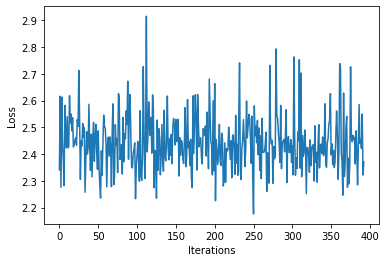

Time Elapsed 144.47859644889832
Iteration 393 Loss 2.5156326293945312
Thiofred accerere wolers, the tier pres r s thir reghe arouithenaserethese.
A t d a asin thompenes a aiferes ocayon aninthemimathimesa acorsshererienor the hererer tone antin pr anesqur t enin yonenates


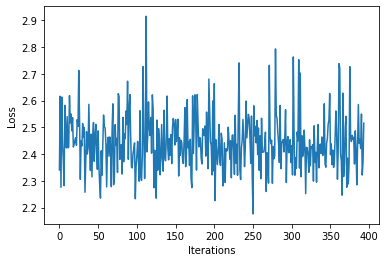

Time Elapsed 144.8954246044159
Iteration 394 Loss 2.643021583557129
Thesee aseveen.

Pf athe th erecorore. the de anavag bay reg oar f osivane u ize bes in hen fono e prdin (here asuine arer herin wh anerreedicoyone l Satles whadalie or ied ure ve. s are e Drege po COVe


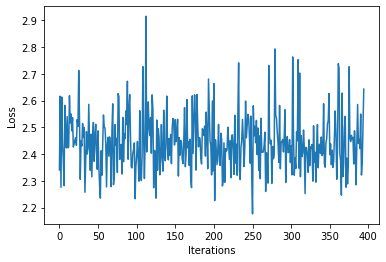

Time Elapsed 145.31741404533386
Iteration 395 Loss 2.4419772624969482
Thereruacors. s ioff He " ioner athesulile siere bererou es othon s nedioreienar anyer ans acite n atoh theto ores. heeathet ous thes e #- aredowackes hou alis atherione thanes d yo fer mme wiathe po. r


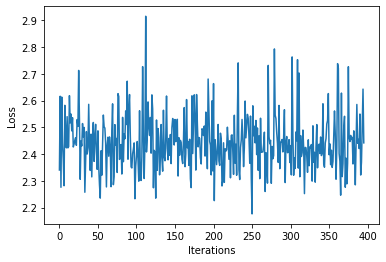

Time Elapsed 145.73335671424866
Iteration 396 Loss 2.505601167678833
Thios cticin 19 rer iner ia bertou hersers assua the atsh UW-s an. an pthemecthes usinin ne cek avan y onurk othonfe ansontho c ang inourves s OVID-14 rone s the in cce. in one ion t an y s athe yecone 


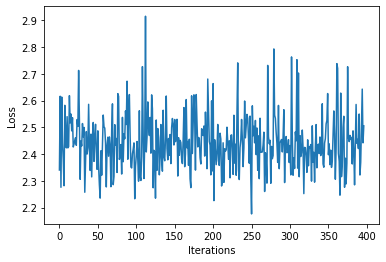

Time Elapsed 146.12194204330444
Iteration 397 Loss 2.424327850341797
Tho iowore ha ing ho aphedireresio aionanace y w er hepamire ecinilll po r cie arte iou or erinous areitese whor theinathearen ou and athedeseererashe amereth hes t itinso arnaces (ite thad.
Arare couse


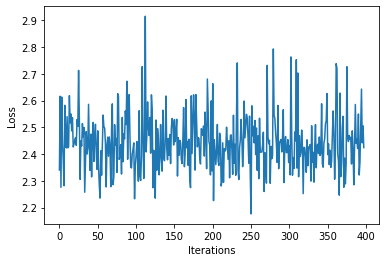

Time Elapsed 146.5487024784088
Iteration 398 Loss 2.374936819076538
Thouairarsse t ace oreretincir aleruag alion feen atiosee 14he s IDatherin s caympheres on he alon en ath thesy n s atherey DAle onteadionuthe an acir ar t o rerowin thequg y ol tho thein apofo thar or 


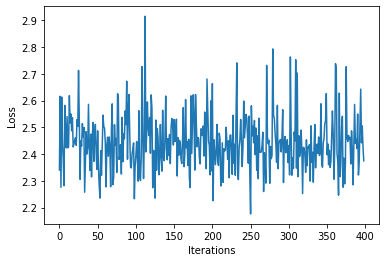

Time Elapsed 146.92599511146545
Iteration 399 Loss 2.353429079055786
Thather aiourin t thee tan cemed Facthes t thecabion wiburafreer ilon areriomwis iner tes ain ce alinys ruror by aroulemmiss Joo Hes are ang leavang a wacronaler f nsiowhos athes wio Hee by pacaveing is


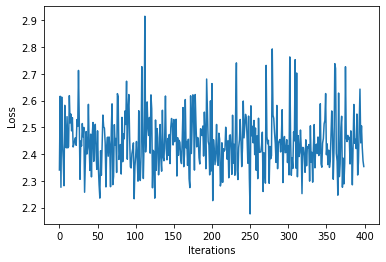

Time Elapsed 147.2978298664093
Iteration 400 Loss 2.3299310207366943
Th anis Unandeanan s aralaton y wionor inin San yousilitu roncof y t ososontil an tons w thail tif o s t theacye ilalarinar y tioer qu o an tey for ne heretretin re plioiongion tire dghaltinate the thea


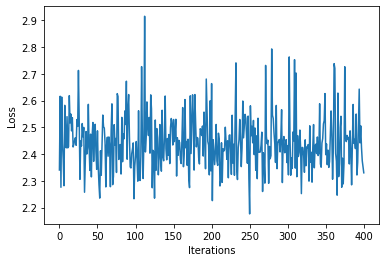

Time Elapsed 147.69729280471802
Iteration 401 Loss 2.400984048843384
The mpolerecomionserocour anexpurores tin aitacan sis cin fompous s tiothe Cowhes coohen renccthelive on. io lin ation ins Disioncon re yu mer tit pe yet ulilelaties r iores comeresuilthe Bapar pan (GOV


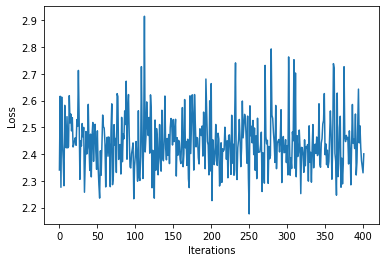

Time Elapsed 148.20673751831055
Iteration 402 Loss 2.301119089126587
The osuthecou afe ce ureingabin ay Lonong. ongr ouicippo sison Sesio y fecorothes ato ts af youramad of bilatheatins a alliseathongs, Bang es here canir ale wouiong calengeyes anga pheas thecitheabou se


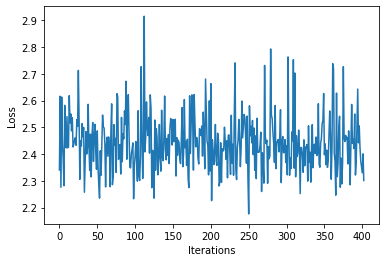

Time Elapsed 148.5521113872528
Iteration 403 Loss 2.474942922592163
There we r Bar ame aces reis whyo-19 heriouranin ingedsenor onater thonethemane on ang yofre ionthes expo corathe to tors, thesthan yon atior totha ponorar fen pthe a er co aceren an the aruresures woy 


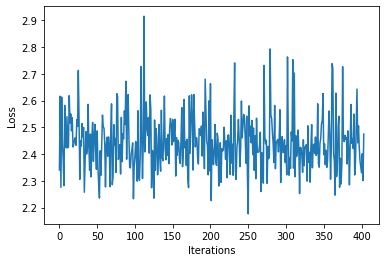

Time Elapsed 148.9564950466156
Iteration 404 Loss 2.3315813541412354
Tho pork Patouretus The a thalane ng ame tit bllars th ans, ang isionthere oys dire heg whein re nic rs rs porathouine ver d pathes teyonlin oly the aces a whed the. is a tist co ang thesoreranererilace


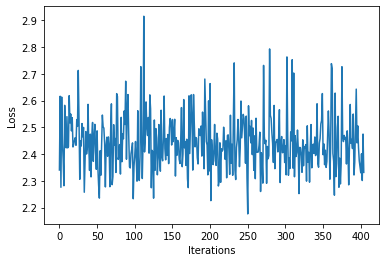

Time Elapsed 149.30872917175293
Iteration 405 Loss 2.296109914779663
Thedote avath ar e osinathappoe th d f esur weth se avioran a ck dur ar on alluroliourersyy Che ng 0 onelon surseres os wharingenon iomurer he 19 till ore dey le y ooreshat e.). pos rangamestho amen an 


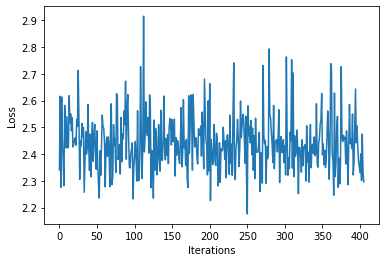

Time Elapsed 149.7424008846283
Iteration 406 Loss 2.377354145050049
Thintono we roaldofitha PAlt alexesisthan ag COVatyor ag angier abace theng an on s co, retour ys niprs herourene ar in oneve y cone pr acor ter ille ane athesheecir me bofonge pracory are minar h ouron


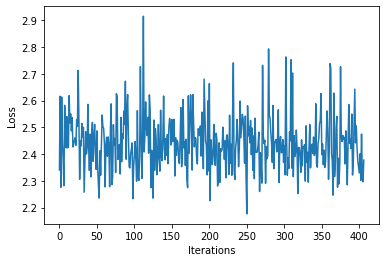

Time Elapsed 150.10224080085754
Iteration 407 Loss 2.2262957096099854
Therathong mectesi) thesonicofean tiom bl mioo reg sion ther oretienavonthes an n acthioutoman f sure ho cer anthore tes whengesesafo r p d an ir n mar to ing te t red te tulin potiniofose ayone, tous a


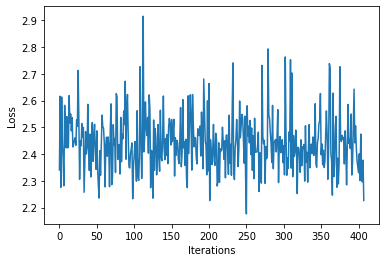

Time Elapsed 150.50718808174133
Iteration 408 Loss 2.4957573413848877
The teaceting ce Dour re. othexbuecer hinan bon foving Thesue a weiong ator A cithan de e theneerinthe Mres Tho cisoniore be a yothos touryorviotionger prionermisouro equre He alave aberen es y heconer 


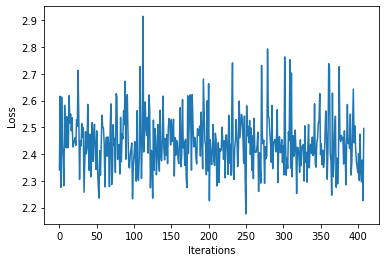

Time Elapsed 150.90164995193481
Iteration 409 Loss 2.1907167434692383
Thed to achenser uro ree ams viovin one we S lender a athengereebor (ithers fe lacour iore or a ar we. oser bloucosinor ar us atrmors te t athiloneinde acally tharor teso ale r evesesicorstherouthe ange


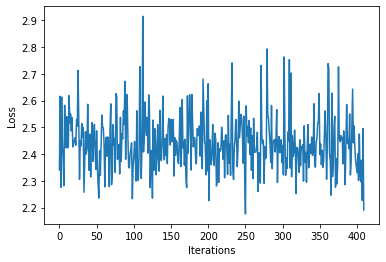

Time Elapsed 151.27715921401978
Iteration 410 Loss 2.4057955741882324
The ner ars bilos thersthe poreve reionte yor us anlur oueriealers n an yeare Saress cadtitek thadoure ar wos wheaxp whe werolis uanthe heng UHo yowosest ens so co tishenof bare ton tho cole anirererequ


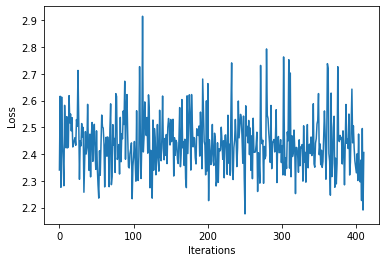

Time Elapsed 151.67138671875
Iteration 411 Loss 2.7626311779022217
Thersinouramouches our soumpone fone ve tour eserevemed h oreengeomedge p Ber phe oncle ouror as heer poxprenges foures teerherilee, Lo iveremouimer anandithther ng verongeangrseiding f cinel an teriee 


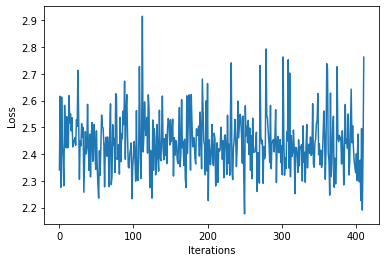

Time Elapsed 152.04687666893005
Iteration 412 Loss 2.352393627166748
The te nsor r on be r so bu COVID yolonstheisur venlestowo o alsy d he o. os no whe a Thoree ach. Thomabe cisthe e be ome apersthiane whor tou nge nionspoursore Reicang he fe ther core fea hor thathesun


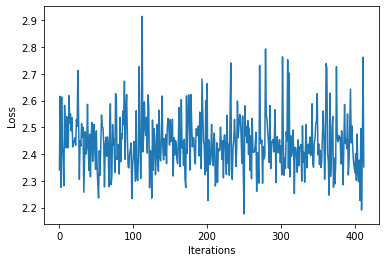

Time Elapsed 152.42845058441162
Iteration 413 Loss 2.2576842308044434
Thece foier thede o: S ve yeo erosar The ritinese our acure arirsos cores fo ine tinanen er anethesedieriesia wesoule rono thes urourisar yofer phe y. mevalir s. wh he Unonon sesinosererio an yo he into


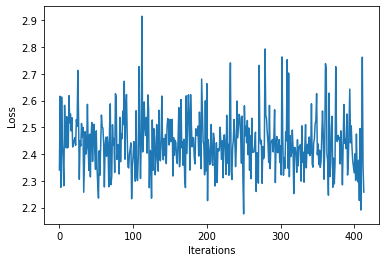

Time Elapsed 152.83467555046082
Iteration 414 Loss 2.324263334274292
Thein scherse do Barer Hesose il olon thes r atorthenco or erablpeouror ison ter wethe te he we cexeedad the dioure ouequseliren whesoure ar tor shere anthe fouin pong fotheaingesed or cco f alerererens


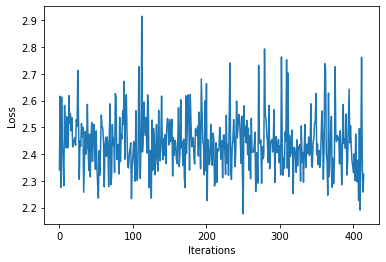

Time Elapsed 153.24732303619385
Iteration 415 Loss 2.3871517181396484
Ther iosinour fon wralamintea e wes The orsinsthonoureseeing orean s pthe es prsthouiceree acer bon thee oureerein care thoure dexhed Howhe d Thoing heampaines werar nexpo theith cond atre the oro torer


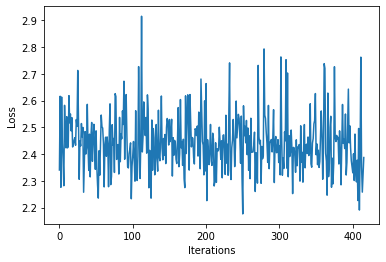

Time Elapsed 153.62657260894775
Iteration 416 Loss 2.4421913623809814
Theryonthor rapur 7 Ce le te onotrour aceming e ourer four coin the ind mpheas o whe rondo Ced tho asorir fonglur fo a f au peinss pesesthee crst antioreen ino henso can bur ho the ampr ran we tiomer th


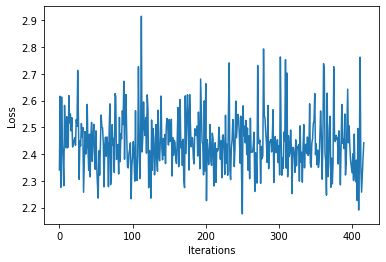

Time Elapsed 154.08974814414978
Iteration 417 Loss 2.353034019470215
Therpos, hedgeser ber as veme icare inor se o nes ors Theann fosise ho ws an ng bunoishe ar Theatre phe en ar des semavetoresoureeowhe ge malor yor sethe ans " to ce ade ce y re o thesuse. tmud re where


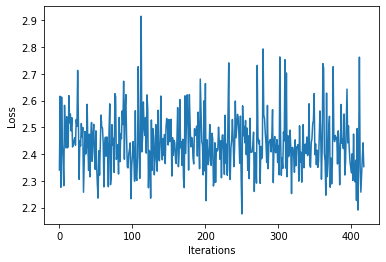

Time Elapsed 154.55777978897095
Iteration 418 Loss 2.5193889141082764
Thio cede tes d were ar ar ilothome Band t ar ireened 19 nanirele woreror fot p rexpcour arwer we who Une sureacce anteryo deror tindinongong wapre y alioururer e Bacomafo me ar he te loro iourege sthet


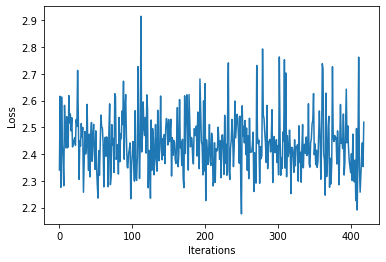

Time Elapsed 155.0158302783966
Iteration 419 Loss 2.469313144683838
The es bourkng d Rer aber sethe osusthe. dek tese or dur e dos al inthe t an onesouse ainte n amourece gle f urena teres yoreree ne s the an sessiore arerou han oumes the toruled whound harere had che o


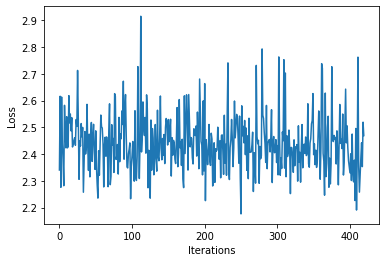

Time Elapsed 155.49989461898804
Iteration 420 Loss 2.264143705368042
Theore rd r ace ce anourer ouravathesthoutoucor athe corex por thang silthe m cincathest bure, te yoncou s risos tins. aresthe wore fe able the torg h touph s osecheth ysoureresiothe oresun cireape Sous


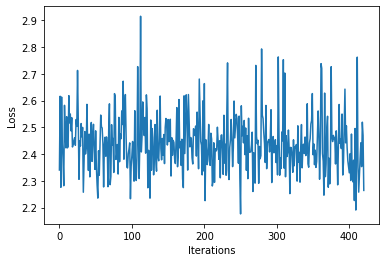

Time Elapsed 156.05424690246582
Iteration 421 Loss 2.5280582904815674
The ekel thinoifo ascen d tthere ioure S whanite yomar admir torommin thes ccouren r, the wheo Se whes me thes tece an acoureore four se t iour ar her Bateronin t ache 19 fouse s mour s. the hor asinece


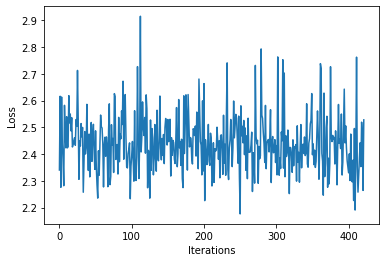

Time Elapsed 156.5687656402588
Iteration 422 Loss 2.4319777488708496
Thor ie 72 r we kl r thesthonarioulesur yo fee Hed to ver or re p heresinthesur as yorarane thomionee y te yothedee beso wio e ter aren Dhe are cere aritescourinaccrmosequirere cathe fono hathe athowise


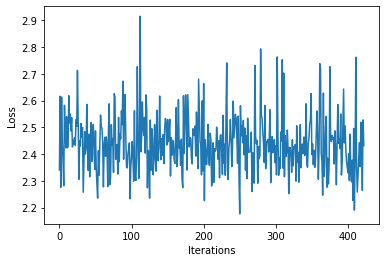

Time Elapsed 157.00572681427002
Iteration 423 Loss 2.51009464263916
Theeicowhe s Bame y te wesirseere ou Pr olie The ine Pre y be caner bas Seyme chesthexpe r pre acomur s then ho tisthee nore besirase ceror He thos g yo f her te o praces y ans e t hoga inger iorere tos


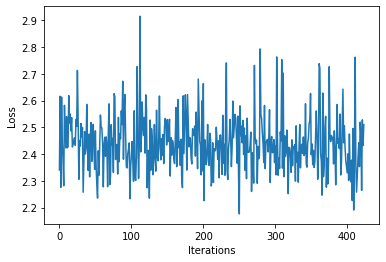

Time Elapsed 157.55555701255798
Iteration 424 Loss 2.4112982749938965
Thesilo f amance r s fer se or cer Aphes t ms ar po se f womarintowhesinsin bu theates 19 ntor tree re the ish siltherine the he whtho e asy nequirallso asouas te atharksthethataras athe yo te yore whon


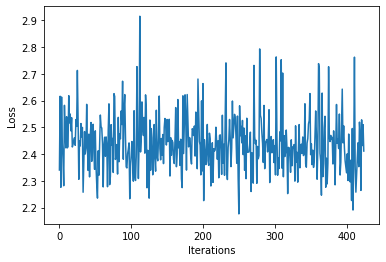

Time Elapsed 158.16187834739685
Iteration 425 Loss 2.530107021331787
There thine urd a. youiralth the opores w thathe the eca, fo ree ioyos cartirk or te co acicersin no s he ce ad orivesolas Bastinang whe .porstheshonour th ite d tin or Ba qu Exerene upes pore ca th the


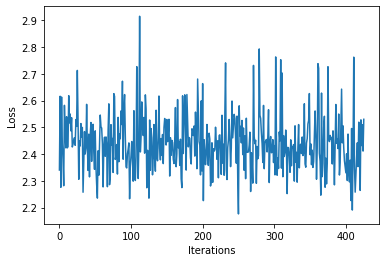

Time Elapsed 158.57646775245667
Iteration 426 Loss 2.3759572505950928
The COVIf vico the t yo s il adan f vatisomee wablin a a orc leeaf os, f the po n t tin the fourase allousirs honor be the the aro fot theder ve re the He ionthaito res t trdasther tostoron Bathe rerve 


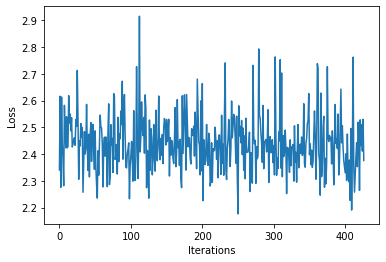

Time Elapsed 158.94593286514282
Iteration 427 Loss 2.3127498626708984
Thete ses y thiomphes ass win re po maracathrkereerst Rea carkee s t whoures t we the a tospr he theshe phe n the abomurse Ch avase hemat vere te re a yoseinsures ithe atey coured Setiniouanthaknt fee t


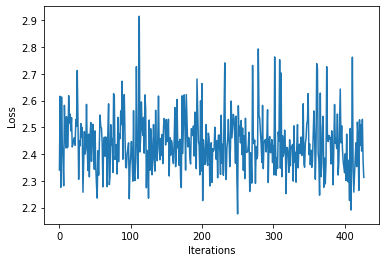

Time Elapsed 159.3702254295349
Iteration 428 Loss 2.468641757965088
Tho nreese pome s t t fres t hes ie railoutisong le nd ber aboramamu ina tio thor theinte fos bue phesersthemarad hedathe at therathe capranf Bar wing abemot the inin cus k Houinth atirestheray r tedest


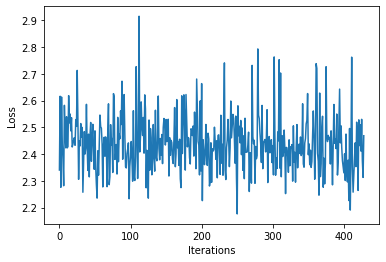

Time Elapsed 159.73015451431274
Iteration 429 Loss 2.6085023880004883
Tho thinates, y. r pur fe t ims akirs t ethiners watiresouiourearemar cowemo ato t th t hereeves h utstionabes shareexppathorsee the s bo we. sscantesis be har s Ingedaleersta s rma thearsh Joris les pu


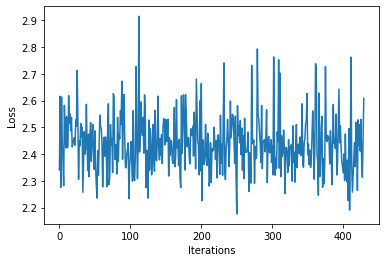

Time Elapsed 160.15156483650208
Iteration 430 Loss 2.4689860343933105
Theal whe thes r tirstampreomece athitheve aithasin t thee pose ts whesaloule f in, t ure bursithee ablsoithe t catere tat y min at theanais achel win e onatheyoy athe tin hera he the theitho cacasioumi


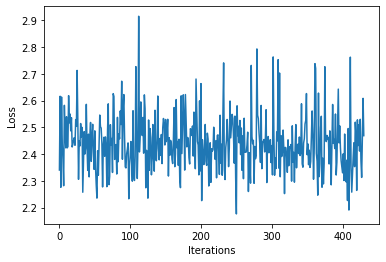

Time Elapsed 160.50513124465942
Iteration 431 Loss 2.598628282546997
Thess ine f the thithetis (feres an ocesce ain yorsacles.


In athes ve ityore fede. nopu Bangre n a t crulthee. ote ine the kinoud a penstof Bathe thou frag gstithererililee thenile ontis ava w tereshe


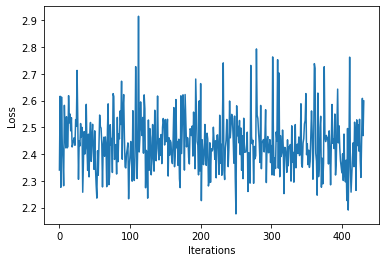

Time Elapsed 160.9083445072174
Iteration 432 Loss 2.793504238128662
Thorers n buintis tr hathes pryorse Bal itin he ta e tor ten d te fe ildioncathesina Bavelloures.e Baron be angey ythee afourowintator t fe bouin s res ithearetherime hesurotirove hey wirerie buaress f 


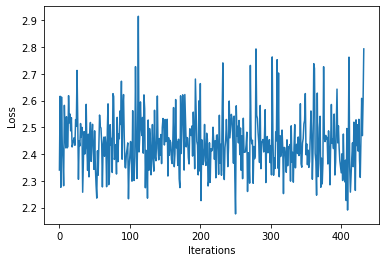

Time Elapsed 161.29148888587952
Iteration 433 Loss 2.5267841815948486
Thes avacell aresosthadeathe whes predin coceges iltinererormine thein gedoures n cterer whessinio bersemepremerong dithrin becot hiore mors he atio Bacasenatr dithes ofona cheathethethe the alte nleses


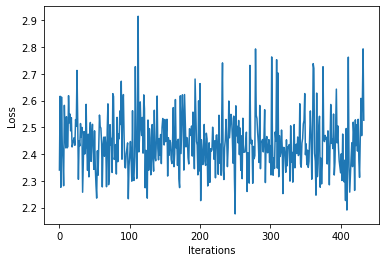

Time Elapsed 161.70722126960754
Iteration 434 Loss 2.2346649169921875
The aringrereceraccairemestheneen thamewheene anterire). alorer wr theseinesir a wh t win the es fa n whap ancorer ther n the theyonghourer s stirederererondento tuire a th dand, n aciothesthedistheadge


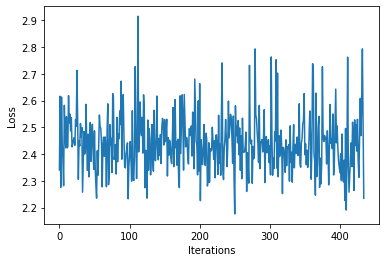

Time Elapsed 162.07767295837402
Iteration 435 Loss 2.374938488006592
Th miegldilecaru terss, r f re tee sintin y.
A theske feanilathes th thellie p ader tire turesio wies orestithere.
Wedaciereneyos se hestouras surophe we thed therawinrinequg heror theeatereses oures ma


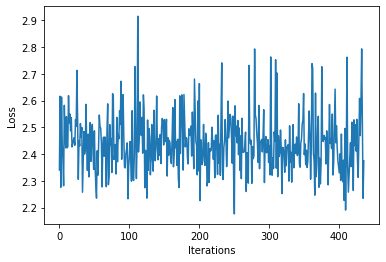

Time Elapsed 162.48430252075195
Iteration 436 Loss 2.755842924118042
Thoresitheruh yee es is esthecr isthe tiestidin ad n s. tetilo the f p haten ieacathersthe n tearanten on yourer mar Semethe istenoreprs a whe theromacerser a slequase sostherar denarede s ouirl methoua


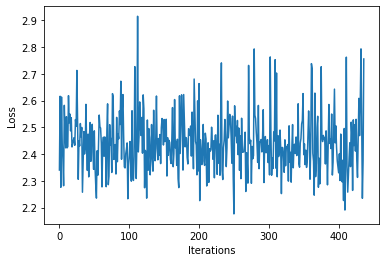

Time Elapsed 162.87296676635742
Iteration 437 Loss 2.4126415252685547
Thedo io tionual hesuithe te blan woumiowon the re youredulesisu ones.
Apl wion h casueraprns if Bar temestheniteremirkiouresinsie pr bu ainerorils. oprin sthe t e abled uskereccaro Bamerer veatere rech


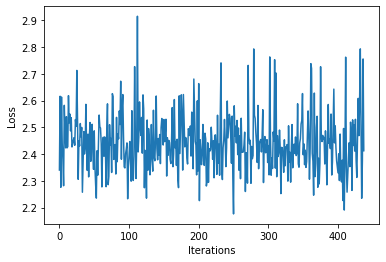

Time Elapsed 163.27894163131714
Iteration 438 Loss 2.3164241313934326
Thouilsatur r tr atal athed terst bedonece mpr alee ap f e theticrmonlsthe tofiluryo tempeerace rlatee sen ar the s. io theleces ghiteates. hey fotaroshenarer adonal Bakeno ile melenous. core wiveathe, 


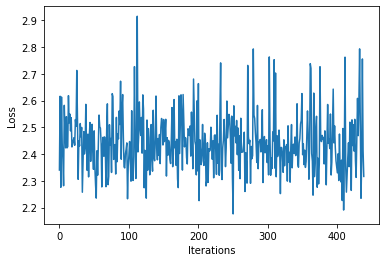

Time Elapsed 163.66390752792358
Iteration 439 Loss 2.4458916187286377
There heo thporeyoreses. nsee Bandenos as es ia ad tee ey ing in therof theyourin to Ba Bay.
Sacereres f thesil thanerequ aalese/io pe heyouinonceenere ansinstire harean t se s sisin cacotevidil herede 


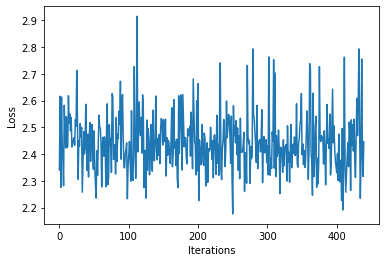

Time Elapsed 164.06859970092773
Iteration 440 Loss 2.3522279262542725
The thireeil pphor sst yeme. iourainopavathes d twire bue y y wneres povesoroneses tileferer es yoronuedathen be d. niothets or hesirathe, wios n iouere de aion. thesthe yourosstenourio f thousiberedame


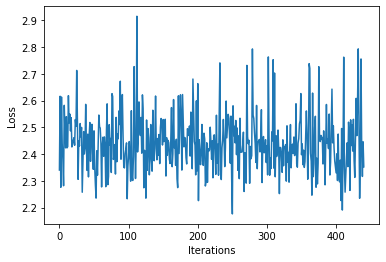

Time Elapsed 164.4787061214447
Iteration 441 Loss 2.3192226886749268
Thifece egeras bl yor edo p ay chot hocheshoures there Whelecthopered aloursotenu hee tewheng Alee ir iorove the tibedanor bered ole ir-19 wioren pptincosest Ste f blentety. rt. f sicas an fongeome tion


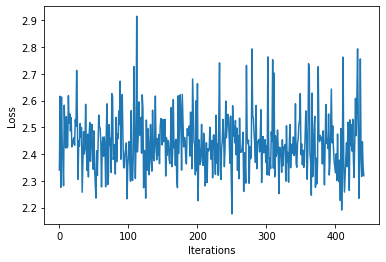

Time Elapsed 164.86036825180054
Iteration 442 Loss 2.408311367034912
The acatherapor eear rou wiolerasesthe wiser sters per jof avesopacinone sesterorio th te bedeletes an de y por s tisuce wecan presio hheses COVIfe win hexpere nuil po whe eseres t ses lar cade s f ede 


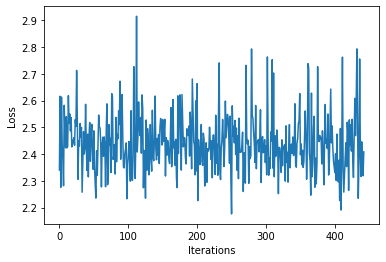

Time Elapsed 165.28254747390747
Iteration 443 Loss 2.3731977939605713
Thes, uita wen teme apeshesitese suth ano hethes s pe Bateve stshathedilod theeseiscee arsches yo lther thanowachene o.
He teroceiof thalen ou ate olothereres ilese esse ir olyo thithe alereondafenovene


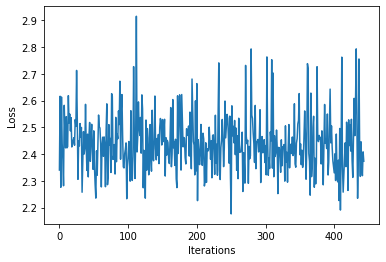

Time Elapsed 165.65736269950867
Iteration 444 Loss 2.364459991455078
Thare wa o e otr he yoryororas o ces har il therar thedeen yoes tyepondentheng the o aveth ine " ndithene ctheanoureedee torelontat u s the. bl romesace an f topou//urereves a, ha feshermes. ater harayo


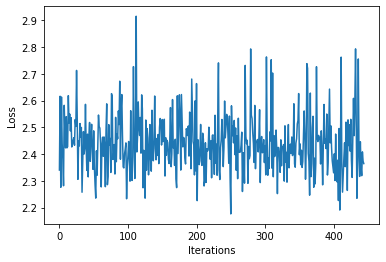

Time Elapsed 166.0419681072235
Iteration 445 Loss 2.6699821949005127
This a nerm temin te aco for Jacama red mes soriono bedyorothed banu as, phe ntiorowhantedine ace g to wirexees tin teg. fecor; bur isu r an ho ce apre bo wisou s (nseteirs.

Patiletiouretil invino ante


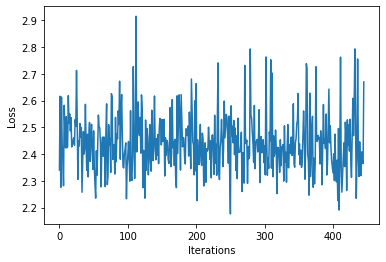

Time Elapsed 166.4536473751068
Iteration 446 Loss 2.7190425395965576
Th thesss. es me oty mile pr t then. hyoulol st a uitolte Poth cee ca cequrerng are th ter wiva med comesthecanlo Be an och tonerill yer eaniceren Ba ein ces a thaive astesss arsinenilar t s ante t. w c


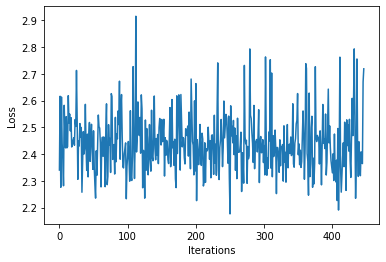

Time Elapsed 166.81522130966187
Iteration 447 Loss 2.376716136932373
Then a so ang heay ilacawieso The, ede f wisesth hese the Batisingr wes ara teaf beso nghe r win tesshe iones n thoe ilace n thes wongeataplonge amoueng ppovaich thin imada cevermpacostsputos aseeresesu


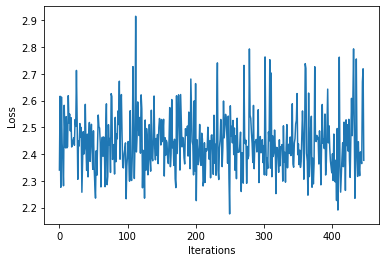

Time Elapsed 167.2484872341156
Iteration 448 Loss 2.373696804046631
Thosthe me r edonthe honge Re the ur dg Badequre. Sado surore PA t our pt tiolles and polen whole a osioulonsuitanlar her it shres n yopponore oly beron-r wior ins ad hinte w do te aloun hes yongrace ve


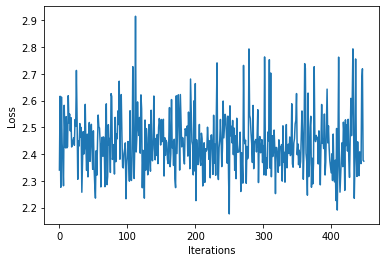

Time Elapsed 167.79980897903442
Iteration 449 Loss 2.4157426357269287
Thedexpreeanouse, a ioloushon whe buing t wininero phavitas ar tors amersont s byon h te an tawhe n templen akequ tes, tot aior atie wioro ir tafos wiou asinf hen inchou ve auines. s ar ay ante thas act


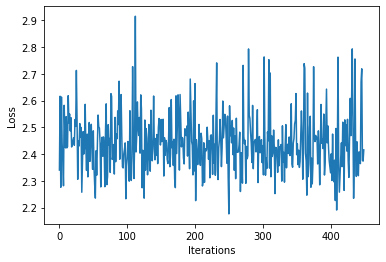

Time Elapsed 168.32059860229492
Iteration 450 Loss 2.4448800086975098
Theng ce), p hes yo anononosth e thin, ponger thes itherio lour ingeacthese n amerewhoue aman ine wesof w inu ble e 15) whoporerore thily you ther yorkin adore as y printo teve inge ves phe the he wingo


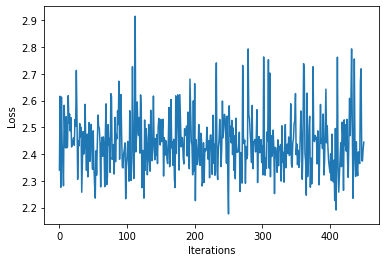

Time Elapsed 168.89213275909424
Iteration 451 Loss 2.281744956970215
Thesires the os ap her alodeammin wors COVIcas tes h ve ang ace e ones cce fean n.
D-2, f d yoororo fora thon wilon, thevin tinexpoullin acr touren fth alyos t sesth ile 19 teviccor il 2, whan de an pec


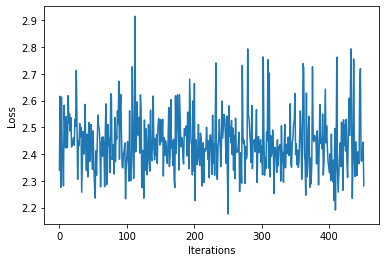

Time Elapsed 169.44053888320923
Iteration 452 Loss 2.5979363918304443
Th ca be ouras a r vedes f oues thavien Undilinsin nsecerkompe Basonmeme thalons nsee. thein iomherlloreson her thed e bo ting wirans t sen s Aies the p al h ineso o tewestheiourshed. the hesp tonsuen o


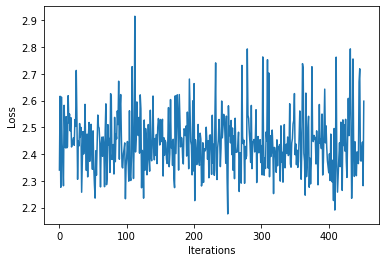

Time Elapsed 169.99163031578064
Iteration 453 Loss 2.4317493438720703
Thele ccoere ameker sedernll hame popred alatorohe totos  thoree youronocaponsed be of tsstha ble yous whes yous yonerorme th g. imerinanochor atos o megimpr th y sas. tonomermele inchempt hes arenu oss


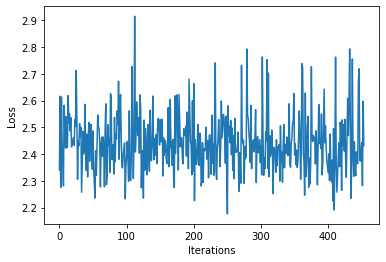

Time Elapsed 170.54756569862366
Iteration 454 Loss 2.4513583183288574
Thes pr wiveatheathirouge kinthonetes te o San athein.
W-ber ppostesor Famed hagnio ayorin o y honcer aterf seme Eweeshedhourousur yo a Ses he r d t cthere touit toresore ouror thes thes io whe/Ife lese


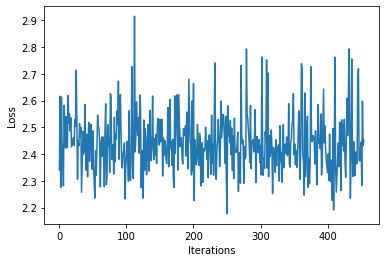

Time Elapsed 171.04319739341736
Iteration 455 Loss 2.450594663619995
The in ceer
Nintouaminacensthir thenonthe beel e atho ave touseraamerale, s sthane cont nou chenieyoris inexe acor womeres t " AD--rst wicastinon thedaon e alo sed hoiriorser m, se ve the waraneere wiin


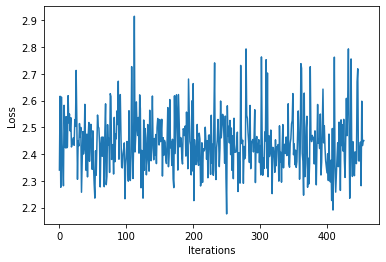

Time Elapsed 171.5141258239746
Iteration 456 Loss 2.4609293937683105
The has thiohe ithere men wonlyo mathefthecos rk an-qur che rseyor an thacoppo thongrecothingecanles ou phe wime trkiacache ares s tounderarakstoiens AA rancourinonor tis nen ha ith panin ca S an tstonl


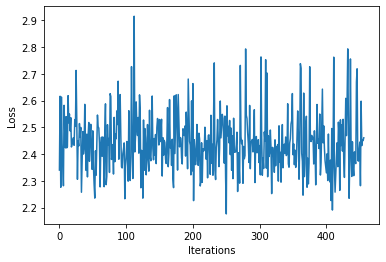

Time Elapsed 171.92076086997986
Iteration 457 Loss 2.6763079166412354
The Ifo on grs renereas nlopr yourin ie yoowhecato me thericase hesu ton yorme cocronsthan--he ay antosororor ithes bes haph g nammor evis hother acainofoaveren a fieth the pon p e pesk Fo titouin ba ou


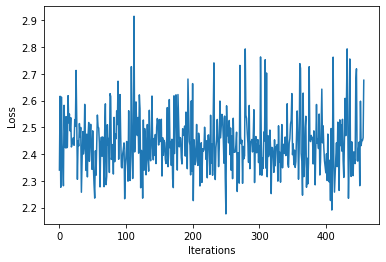

Time Elapsed 172.33107805252075
Iteration 458 Loss 2.5107741355895996
Thanoro we catheveshen hesulos couth cace f ou pthecheingr); eren e s are chitheresth pthoutisthomessher ar pour the thesog westhenecanto sthr win n aplithese f phe pr fapreder thatinesoramay fores ngeq


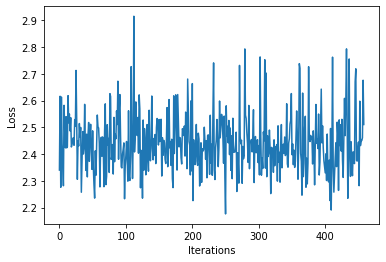

Time Elapsed 172.7613251209259
Iteration 459 Loss 2.4033050537109375
Thar apheathatinthe thar tho to a y titinoreg, arorey ayospheru phathewererger h ay ak apres.

Thovinritheses. blee arecas cametonesolinas Dees me nyowiviso e tinors beshing wilin e achangesalo win-hela


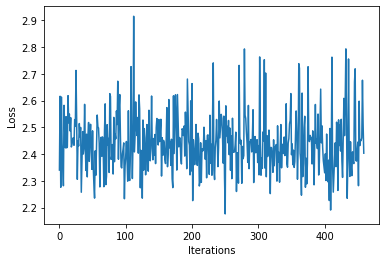

Time Elapsed 173.16110849380493
Iteration 460 Loss 2.3282415866851807
The su stiten pheresthes mionyons aseroy geanouresins awe pr ashatho tereshitithalaphesthavinsk thequr th a thecis iorangerestinssis. yothis.

ID-bothor, ore win adase. #19-Marene Ferirour d ng tourmion


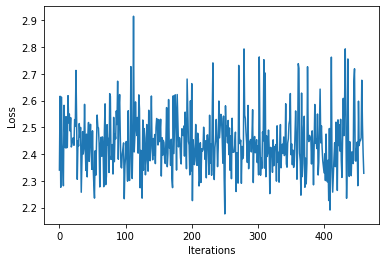

Time Elapsed 173.57523679733276
Iteration 461 Loss 2.469715118408203
The sthe io rosphin iche receer it ars. be onoredeved das.
S, anio nhe. --19 tion--10 angean shesourers meer hou hesinsurorehar aphad wir pphame win eonin f nteniowificoionin the owionger sthalot gst ce


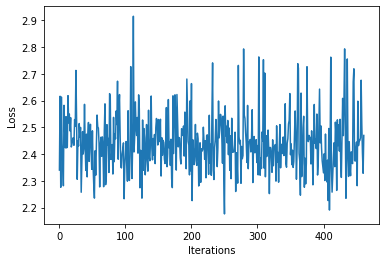

Time Elapsed 174.03604674339294
Iteration 462 Loss 2.615628242492676
Thathacamid 14 g phenesioour mp thenesealtisiosomie erere ch aren scatints.
Aseseroes n fe thesinthe a chione.



COVatind bemere btonanitin ekedanineve yonthere semperorereere winel sssoniotiorore.ID-1


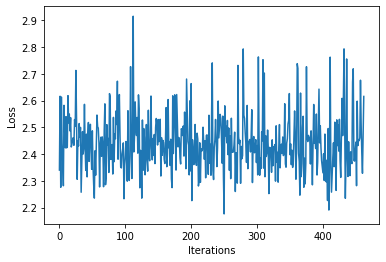

Time Elapsed 174.45088481903076
Iteration 463 Loss 2.380044460296631
Thopegenthexthethaniarewherneiomestenaned 2-s ashe fostherathe an asthay acinthalirecore thenledestherediese angorerathede tilor t h are y ath desidevine strorerere the-raravereserit werermmis anese er 


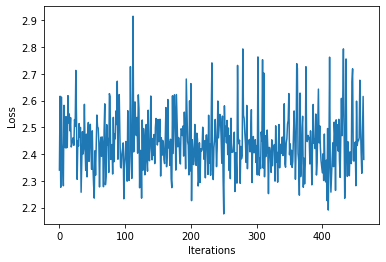

Time Elapsed 174.83221316337585
Iteration 464 Loss 2.593747138977051
Thore asencaple Bes
Am o hatind ph giowiere nores isoure tire de d sst surt ay. Thes collitasinn reom tey adempprmetinee, atheines. se nor Pere urdethechas, b Chorerealy sthenthilancantiowiosor al n ted


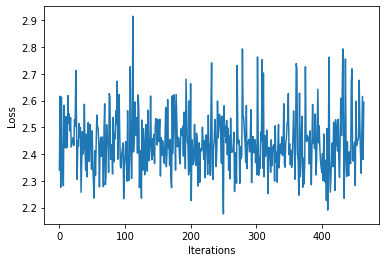

Time Elapsed 175.2200973033905
Iteration 465 Loss 2.369861602783203
The le o wio dicar achaloots anouresenthapee eit hesthiong t ne wheverse tiathenthathamoye e e ten cey the acotithesticenationsichechre icheee a as thes teesu ocontereno ars toreapreasshequrifoosere ing


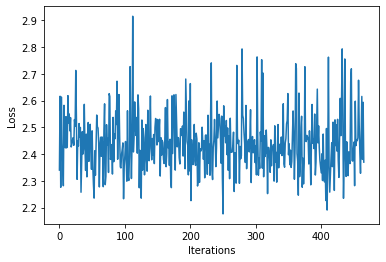

Time Elapsed 175.63420820236206
Iteration 466 Loss 2.375507354736328
Thape winlacaneroshaticcshate, ne here oneo cestha edesestensyos ay eedin areth p hen Bales d thevesena ore aysoredur tersiroceane me ans cand bese tanorest chesisis theney titherexph ins than e, mpho s


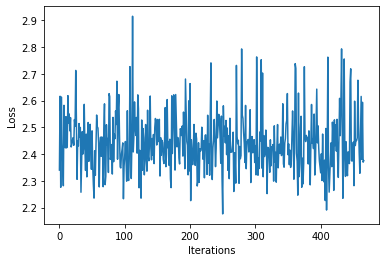

Time Elapsed 176.02425599098206
Iteration 467 Loss 2.450110912322998
Thelicansouiasise see bed a anve t an iovamed. nt phars e pe t yolereareeis iniene atitheis tes intesionsithe abe ane es on Rethaliderthearowesthe wheser anuiredeseearer celors.
Awiopr geitation bethori


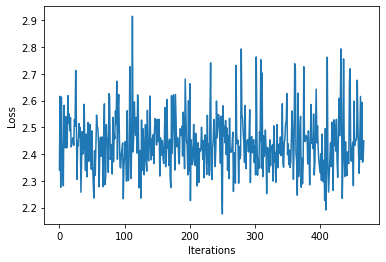

Time Elapsed 176.41066551208496
Iteration 468 Loss 2.2818305492401123
Thate. ysen bonsare cowitinine ncorsvere ont thendekech ilescion icererathar d nacthe ok or caiorer ar, norcecos ty nmelethaph sthonferowhe th athineithillioou ntherontesu ph hates, orssonacat theme on 


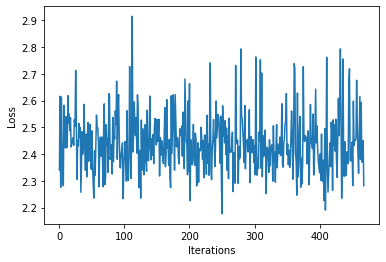

Time Elapsed 176.83531427383423
Iteration 469 Loss 2.3896663188934326
The Beven atalaxis tabende arenor s, dg wh He pr, pothar ameres ere catheree itis t athises ineesth tha stheath pon thy hevee e donthan, wo th nthetinereerequror pre win trequtes owholen aton socangesth


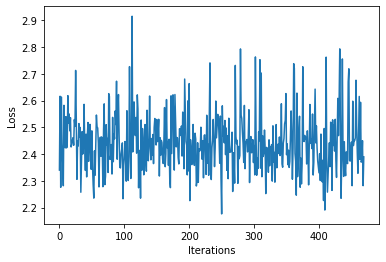

Time Elapsed 177.21640014648438
Iteration 470 Loss 2.454767942428589
Thare ios fothat the plousth a athampus ar an neratovin pratho seee aineges as ashemeemine qureered onederedearondede nterr abe sthe, henowimed R; thenseremacatho meave urowon as thin onletedesianeeraio


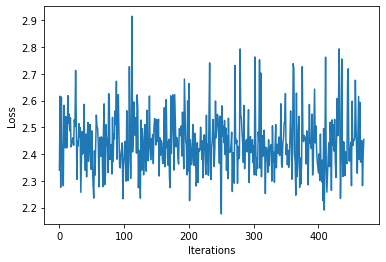

Time Elapsed 177.6285219192505
Iteration 471 Loss 2.3298897743225098
Then thapre fe a r kes y Che wiorame yores athy y in ut iteeruather thin fionenot pphasostinthof th tos thios caluay fonyo thameses amale amampemiore th s ore t chacengeccan t at thecousine se y are mor


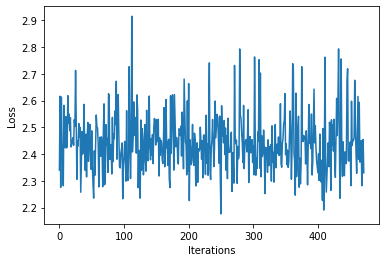

Time Elapsed 178.00510931015015
Iteration 472 Loss 2.461716413497925
Th un-19 bent avesse to ithes tithacarke tosest on at s o de esirond co stata at adunires t pr ou we s os.

Ser wing e ithan ifithequs mithanevecontadedes winde cacat ate owes tarareiref tanequr tar y c


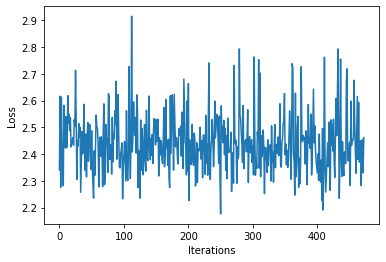

Time Elapsed 178.54941749572754
Iteration 473 Loss 2.4010472297668457
Thende vinteseintha. ureasteameees onacoulereroug Re t at c om nanean ws; arranur 2! cay rerachees bein is As ileteapureru totiree t ces a an w catan nt care f-19 h t phera ousesies pr maf tin aren mine


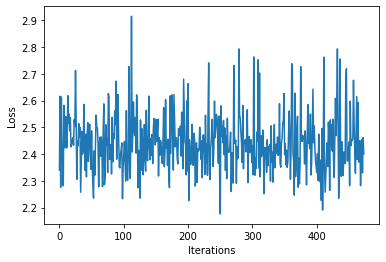

Time Elapsed 178.8794937133789
Iteration 474 Loss 2.384335517883301
Tho nd ais. on prsusmpeg acewis the ctithen os po y caredacare upererap If tor wh f iner fes coc. at hainthamprs-carare elorone icerareronewiver oust n atandene, iss cansace tes ompredache an wexad tse 


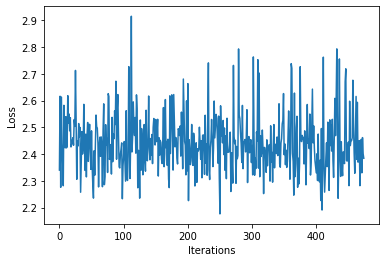

Time Elapsed 179.2771031856537
Iteration 475 Loss 2.284339189529419
Thachaley aretisicheyede t anatscoshe be phed ber 19-wiatasinges h y n tindad t te te y on ametor f ferenur ped por adellour tatr ser de a ree on pouliloyothoswadesth othay canteran-19 eat veiofeth ar a


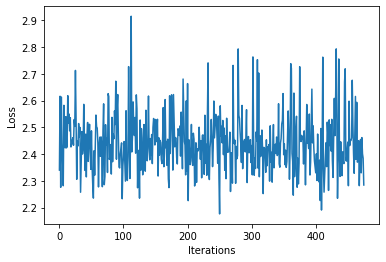

Time Elapsed 179.69424748420715
Iteration 476 Loss 2.5953526496887207
Thevar ce ongeovieless s (amermes terathe p o ts VIfouafracath onompor won-19 te o S ayos d ge pots ca the tyonisal hesest wsetan anin n y a p bedo t thed PStan col ame Emathan on co soceacarimorenopesi


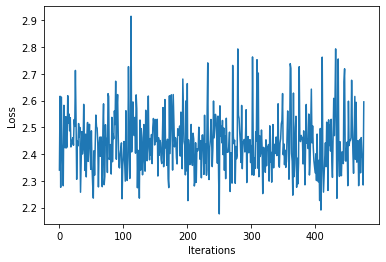

Time Elapsed 180.0903263092041
Iteration 477 Loss 2.644993305206299
The wome condin an t ire th s athers prermprede tos tor beson aton ctiavalonde ey araplere arelan St the a iesecathof Chese mirmeares t ched t i rethacoutomute Useeroming aled wiou s cere n fothe cerer 


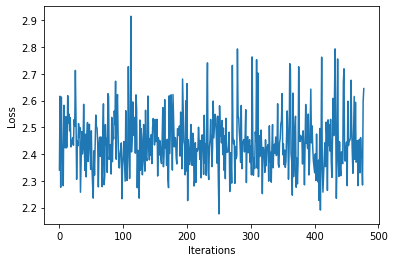

Time Elapsed 180.4776589870453
Iteration 478 Loss 2.370802164077759
Th hy thenole te tatrertemexpo de p-19 phede zeo anatots Untomato Bathe antotous ce yed p rmeste n are helyon Wemath s fed y titondeto if h ay cang ws t wiere t maneliomathisomeveded atareame atsio ioro


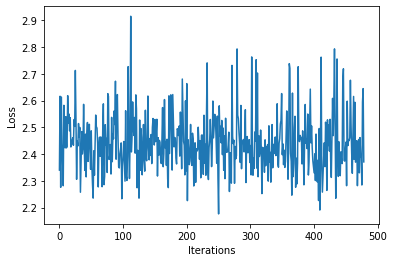

Time Elapsed 180.8924663066864
Iteration 479 Loss 2.320186138153076
Ther tifeg anees apurotheedg tamprese re hos om al te muas p cesangre stosthe n are t COVID-dge cathed teererallonte thare y an s ton one itald hatho acinther andestomestinallontotededeltro r mers asins


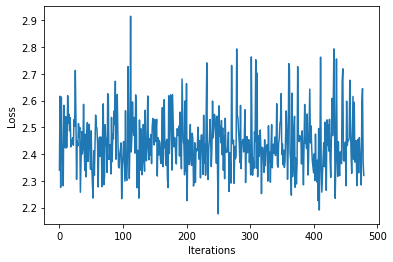

Time Elapsed 181.32642340660095
Iteration 480 Loss 2.391223907470703
Thenceestevere gebe n the teomp on s hechatexin ant "pur itre coron tenteath weke athe sulera amel alibo y eke testinirinth fe bequ sinafeverithang thala co hed tes acano tinofeaye te #1nte y fecaveathe


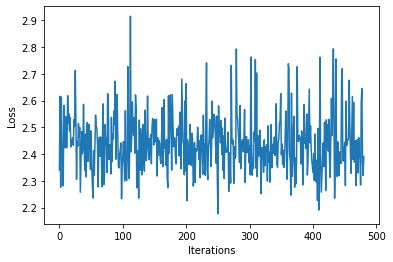

Time Elapsed 181.88304018974304
Iteration 481 Loss 2.4242050647735596
Theramin so yosintouthionesed cone alonone atheras whes ptiol h hon inour s. ar he youre tin acat nust s tecinseses thogecothe re o aritinon atach athe this e ce ioul ouanes t n pomonekelits s ath fe no


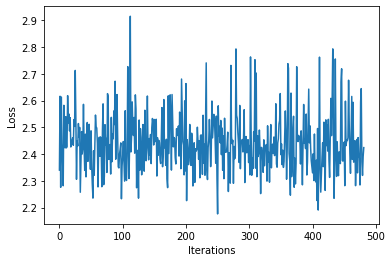

Time Elapsed 182.4381492137909
Iteration 482 Loss 2.3782451152801514
Thararmio iore thanthatot ores t g a whanay ireonuinede atio areareath onge se de 6 ouesin wochallonevef re Satonsuryoue testhoniousendg the hon elore tin nol ome expranontonermive. cithe ano Ma cad pl 


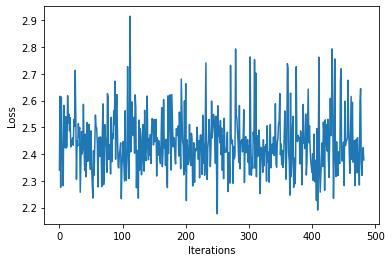

Time Elapsed 183.00874853134155
Iteration 483 Loss 2.4597208499908447
Thothetesof to ors.
Ae be diveconesuathiprochenlonet aciscamalleremiceat cle inecoscoushonfomond rue ca acore us e wiler ofinest cohotesuinge burerener Salsionu an iendan atideron Unacrmanthecas th s te


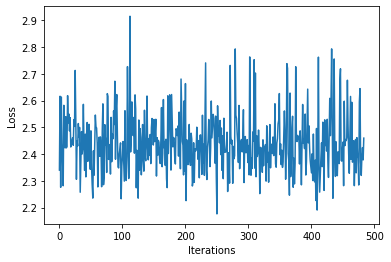

Time Elapsed 183.55691242218018
Iteration 484 Loss 2.4285571575164795
Ther e anghed sce cohater re Tha s thasl cind tiorepr winde woleotionen. n theson se rs.
A owis r imin s te mp, stequse po harin s tins ruy Jo co po a ommos al whema or blthousp oulacesse ccosticer DHer


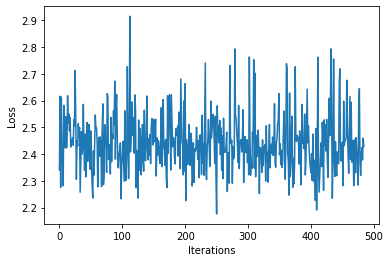

Time Elapsed 184.11651992797852
Iteration 485 Loss 2.3885459899902344
Thindin tore ioes calor e thion pre ra acees e coed y foe alleretilete tred whe peromponde n chenu amer allin tte ullomppphest tatympucofre chesindill aio nglacosint atenoudur ampra uabas towedenoure e 


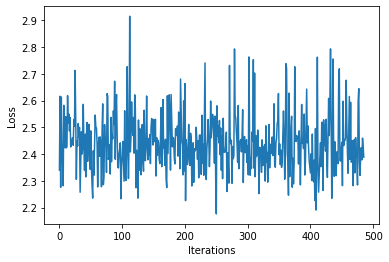

Time Elapsed 184.654034614563
Iteration 486 Loss 2.3445706367492676
The seconlyos can. tin rore tee ay o alesou presibe on We Ce se nie isousouste isinstomarsoneay Ma, esitomareolesiledenorongexprore ing sory hereren Housho hexpapenes r en Usurnior te fisotortere ponthe


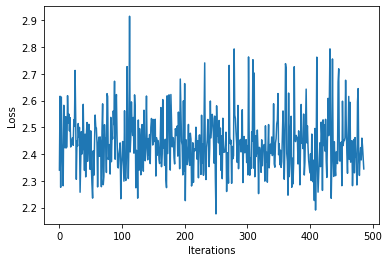

Time Elapsed 185.15610122680664
Iteration 487 Loss 2.5467076301574707
Thiang ie tots t th be aledes onen nge athe W- tharyon stesosecaipares tor ayol re d tho tstos sedr tus conin t tho alie he thoustore edile thesuisonthosierer tinyororeting or teen n coneroulanorellatos


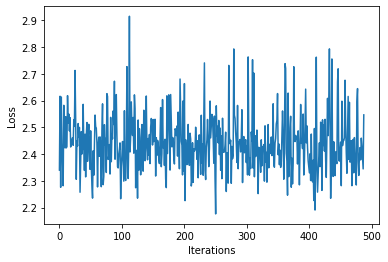

Time Elapsed 185.56271696090698
Iteration 488 Loss 2.5169999599456787
Thamir eer va cicerm thinthens withermere catewire or basta fio ne y mororen ste herore within tioriot pourn acaserere tye, orererererarialert os windellsthene afre de starin f gh Who tess p. t erar a P


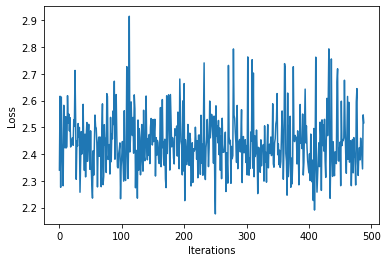

Time Elapsed 185.99368810653687
Iteration 489 Loss 2.5694832801818848
Tho Cheeegedesthesis onseve acastolicorerora blioredurior yeesatag dgr f re w) tile 1, oussthesereromesine ge nurersions coula cos canacitso testhiemserielearatequratine cinerenoracorareneroneramamphe d


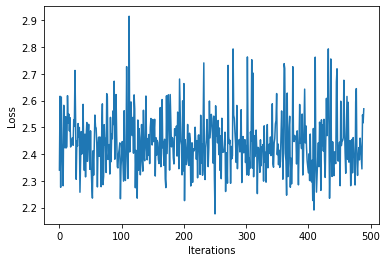

Time Elapsed 186.40496635437012
Iteration 490 Loss 2.524277687072754
Tharon thilere d lerndiser.
Inees aradurexirther te fo so tiourere rsinnser ain vaporinereren pr berexe oy cenererer e ione ysodosto ccinal n sarerono Hese iorerecon aco pa athe thend ofe ou s e ther th


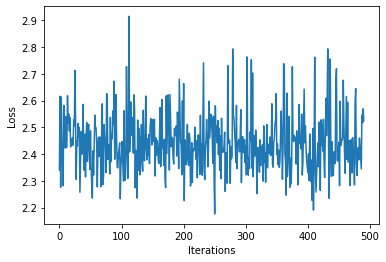

Time Elapsed 186.811217546463
Iteration 491 Loss 2.474275827407837
The aticichedinstinding therkiooure hiriatoriourathin s the morenctithe.
ID-19 atherothoracesoner tirses cints Man conl, p m  civaioviouphes wirematistinesher athole ton bisisite d. hentonenamomiovevars


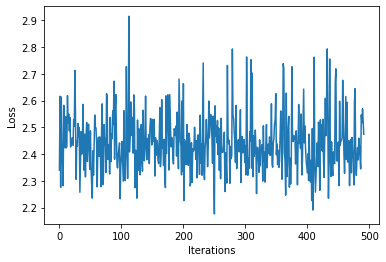

Time Elapsed 187.24351406097412
Iteration 492 Loss 2.6128244400024414
Theen-19prthenacalo Barathe disin ing inan s, acieessuinelemillin an chinmpuilionertherss cccar anoso cat ne rars toce a m ar fen pherere rarithesals, yoriprengesurereioriniser he istheranaced fegeran e


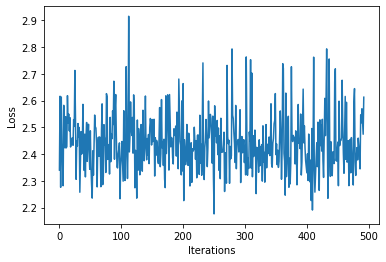

Time Elapsed 187.6484730243683
Iteration 493 Loss 2.317579746246338
Thran a y divilouinnconicerengstoravagecier resherereshorur ancuandenacorivende thar the the actinirulantitacimoomerarer. s pr erino eviorurees sitifofiloreleremerarinon th vinu firememariro r fe rertes


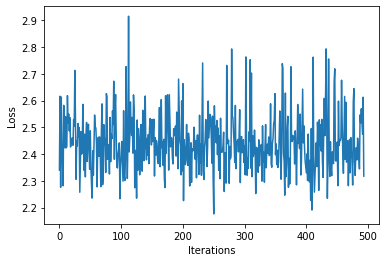

Time Elapsed 188.0698254108429
Iteration 494 Loss 2.3098838329315186
Tharor ted pten:/Hesse Yarewheraleresilyoro couinthe acieotengeresionethisideresisestan re ara maralscess shexpa wilonerdishavatineesiber corere bu derierarablyo pon acer tion mpre cesin sinin pouse hin


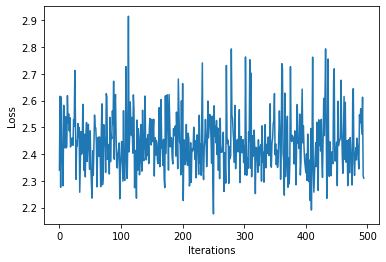

Time Elapsed 188.46235179901123
Iteration 495 Loss 2.4987194538116455
Thinone tamponors 19 r falarerancad blantaurailouh tiotonf f t ionarede thinserorestsins ctho oracheredilero oce telinithe re e ee angececone ame esit aduiosire es cithes the arensesins he arsingherer a


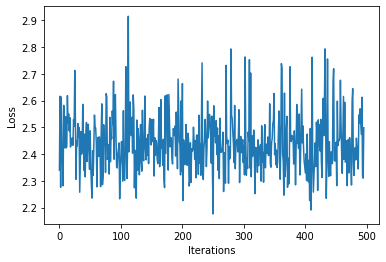

Time Elapsed 189.0164396762848
Iteration 496 Loss 2.4554879665374756
Thencees ares casher thorire o frerorifis werare atheveereerar o ithid amal whera kiostoyes ar bad ane core. n Wher atrea brting arie staloore the athatapaniprals aranaliloree cont Hongalinisirges red a


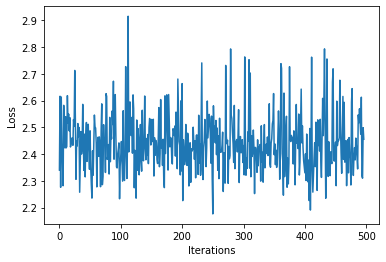

Time Elapsed 189.36674857139587
Iteration 497 Loss 2.296515703201294
There ferter inelonaryon tane the f Ma g a mees, " isur ilevivieathe arstr rerossthe are e t fe pus ingrale. wime nenerorear ono cthithe tano poor atonf tilothies coriberpoular cerolalio theverior He pr


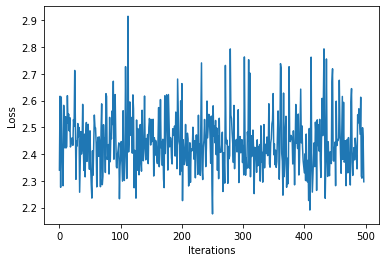

Time Elapsed 189.76781630516052
Iteration 498 Loss 2.819035053253174
Thevexpr athesouinen cisere aicaredathethearay corere ile iterere therthe athaver are are pute mo bure aliioren sifesterethens aco acactha cacaca or whith e. vartreresour thiner aracithemaris ate ce. Ba


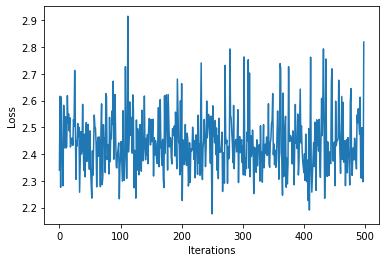

Time Elapsed 190.1803662776947
Iteration 499 Loss 2.4674272537231445
Thene oarareve can an r beth cexp ares eere we hen theran thes in eresed thouariledem arateedirin an, enthe we moumAfede theIDore sh te tevanuthen enidiniting o shes t s tiniaw) theabavatin ctsarecare a


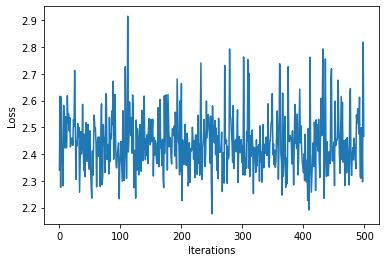

Time Elapsed 190.59102630615234
Iteration 500 Loss 2.6227591037750244
Thapthonitherare s o ty oor ad fe ionewe Man ionge anthe thompes sesoe isan r pee y er nke vernareor nare e.ermabuto ang the. siniothalandicewisous e ilanioralict Comit y Bathenee e wioroners, rein ceth


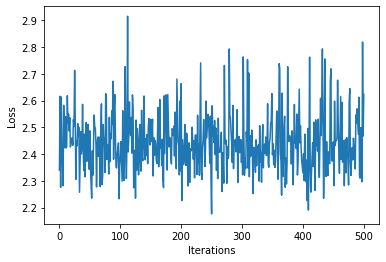

Time Elapsed 190.98430466651917
Iteration 501 Loss 2.3179800510406494
Thes ieesinioneand ast yan. eelo redealltheradm ouran hexie r nd the rerothily clou t beearellde a te athis t tere cin nthen' t cierso s cachars, amarted atone for as ainth her, ur a mer capaca ece toup


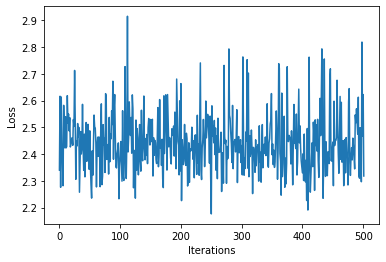

Time Elapsed 191.41104531288147
Iteration 502 Loss 2.3427345752716064
Theratheil ay fizarainen ertiniloran inthethashe tamesote wilas estheco we Chers angr Panio S.
IDe wisesered thecere yontsh reads ce at on Sang athoresitay athe betore bus atine-Mamp Salathonthen.
Apurs


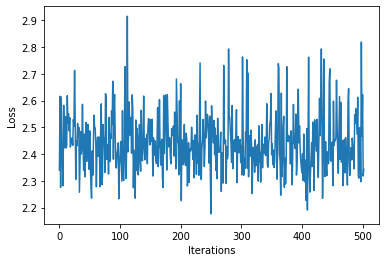

Time Elapsed 191.8212103843689
Iteration 503 Loss 2.3135499954223633
Thesthe t w o r. abure at dere--19 sthores'ss arserthe ithe andr pon Bariorto ciogr ane t ar. can bu ton Basiar th t atiote whilatothereses thacin esthee thald the r cesin me acane fesinllacche d esedg 


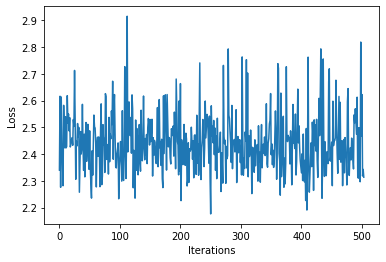

Time Elapsed 192.21929049491882
Iteration 504 Loss 2.599271297454834
Thamprange fes amen a p iemalaran nte thorsouior the han busure a (tothe ratompulantrilla s theshe ar o arey tio r Badites trowhe se as ca r e re the ar ale.ean wo as athesioner geee be or tente atho Sa


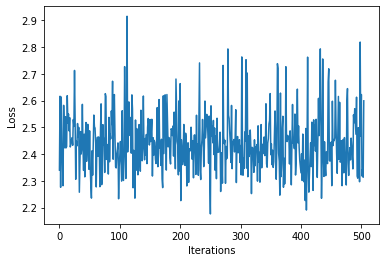

Time Elapsed 192.67127299308777
Iteration 505 Loss 2.7480812072753906
Th mpute in ure the il a sh wif rer (ethelaras Unl amera f mangarde turer heelaryoutan teditore ad aile iour at ade ther testhe Ban iolantenges qure te ir dace h a t filion won ma xpponger ke whiono cay


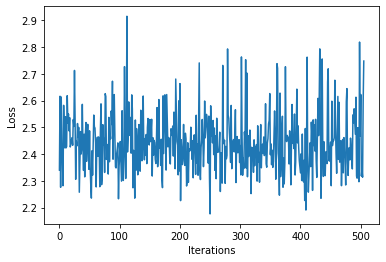

Time Elapsed 193.05900120735168
Iteration 506 Loss 2.5863113403320312
Tho the ith t y Bares ansies, icerinathor er in ots s e rma eceseres icareo tousioonare Baco anccthiio CD-ble rorethe tent ain theatr tere seeser iothe mpothathaneanecetileestul t cade eamaor athit urai


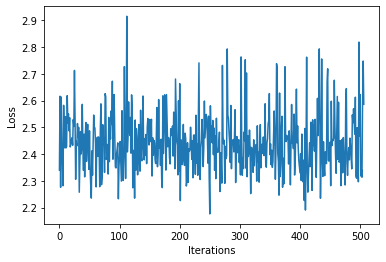

Time Elapsed 193.51291179656982
Iteration 507 Loss 2.4650986194610596
Threo s r t tharangen se ilothecor wizerat, bly y qu wa atinino we serur thee norer ashe ot asal d hol t sio shere t ores divetive nitetheer wh ncore t Sat sinstone l wins horeeand tmanor an.

Asy e tes


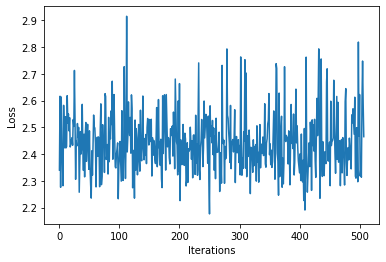

Time Elapsed 193.91095972061157
Iteration 508 Loss 2.4721426963806152
Th Sh athe pus sto ouratothesharelereer abes touss inthon theerouled hre s are a e he te shere s e Whe t f ore 19 stes ithe coresera r sce n iren ay cce rsiororat telens, ar ne ge e ed beruan hencaly ow


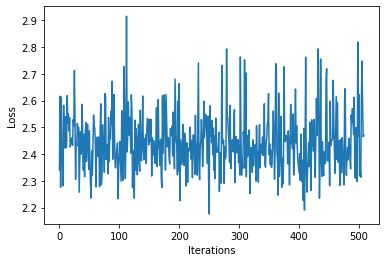

Time Elapsed 194.32647824287415
Iteration 509 Loss 2.523314952850342
The ached at cheelon iso tousatece amped s tiolus o r du y. the or itre so cch tasor' ompres win weplrinteil WIf resting e fin vat pousu andas an r ceher rotes whed n at ppe top beng the rse 607 n whey 


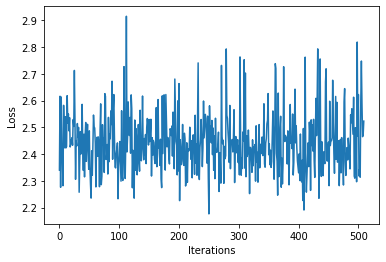

Time Elapsed 194.73332381248474
Iteration 510 Loss 2.4300179481506348
Th yofe were s an bep on ter toyo o s buinte orebler he ire Jathe d ilarensies, wes th there wm waleser ase t te be Se eseiorashemers: tourioure Lron tengeteve s ses whe ups al qustouredis ovener ioures


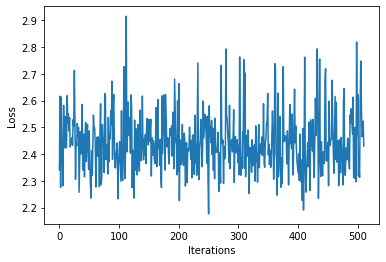

Time Elapsed 195.18304324150085
Iteration 511 Loss 2.3308377265930176
Thyo insinshiour winlecaus canccher me caco asuilours f ich ce ectrarshee in: he atinesof acestes, whe y ses nstour cafear hatss be o a terade po ge cesanfro ayones sers ror fer yon nith aitesensamers l


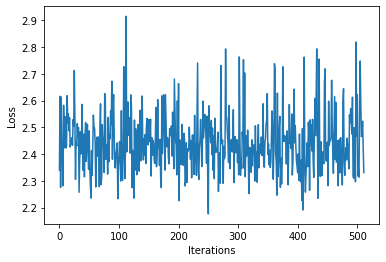

Time Elapsed 195.65994906425476
Iteration 512 Loss 2.3780362606048584
Th Poris as sequrer.
Afar s, esyomees the cotince tee. se as w ou d "be. f fer toule n ter as w to n to pan tinco teyon ar oncopo yous ar insesthoroure ninote r thaly nore ouret he casericinomemensusict


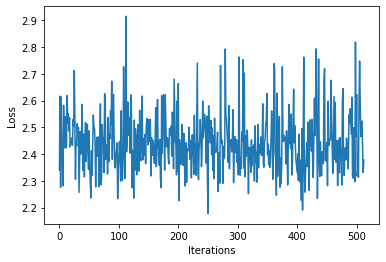

Time Elapsed 196.1128535270691
Iteration 513 Loss 2.556396961212158
Th thaco sat Barens te aren ge onceate thed cere threvemechestures te te co h tan abest ar "bure he han r's bery n'sston t yo tequreo atenes ceadede wiotestes bee aneleproue s ang yosusen uan thebs ston


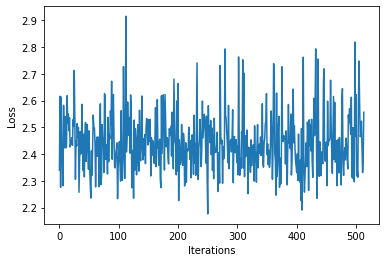

Time Elapsed 196.5561945438385
Iteration 514 Loss 2.3652312755584717
There bes o y S

ives bil che as ter car as. th ar undecin tenomatote youll cacof thesesouithesenosino the thesthongees ange ca lons whathe agioll iatothe weap len tor a llteries t bu'sios. wie te Ahe r


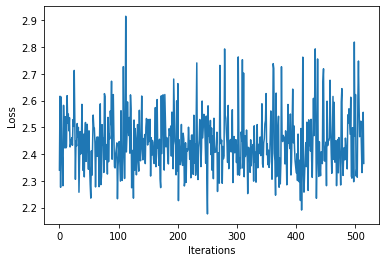

Time Elapsed 197.07759761810303
Iteration 515 Loss 2.3889055252075195
Thonearera an tere ient teesteniriste yor h heve ere oponors quremaresithensinon tentriostheredall eretothouine ecrese oresedinesten oucampurent.
A tmpoulo aiotomeso thes atof ave y ororinatonget bote v


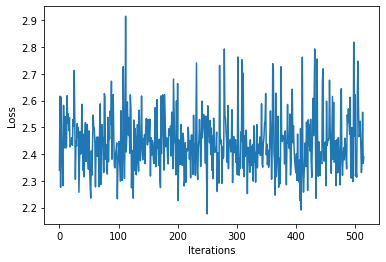

Time Elapsed 197.6093852519989
Iteration 516 Loss 2.3347554206848145
Th be dil inthou o ind OVID-canesind. y il rs l Bathelit r Mos cto ouanit wiorsthisestequre oureee as phan resinsonofe a a ppen o Nousuepuis n sharsthenaf r y are ce.

Alalet nonouraby n toyouaisy ece, 


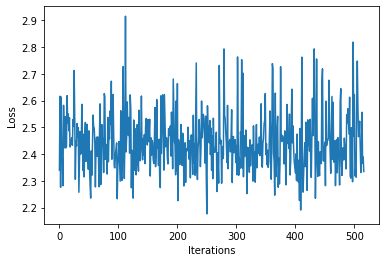

Time Elapsed 198.14722990989685
Iteration 517 Loss 2.6094565391540527
Thessilyotentor yofintu r bayonsiors t es 30 atesedge rocha r sed re s in ath te nuacanon ousouina on fatesonoracar crerequre ayouse s Thesise we arourare o tede nss We iore telsietonour tootour fony a 


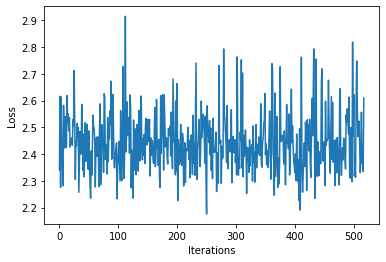

Time Elapsed 198.70991492271423
Iteration 518 Loss 2.381222724914551
Thon winfe tou seonlsit e ekemp ur rle s an rorouare R t ve amin keme nioururadger angr our trsio Whoureathiteroureran verotentse le VIDous thtene or ond ion telononinitilanghe me calatomompamesen weau 


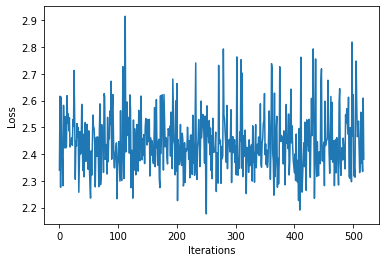

Time Elapsed 199.2821969985962
Iteration 519 Loss 2.693502187728882
The tone iean, w berureiarensis. r s Wire. ce sicon al whes usplousprechesce tres ca sses HSpotoure capheste wie tin fone ates oncal r icerou te.

In te amouayouteen loane omprempeshen wedee whars cores


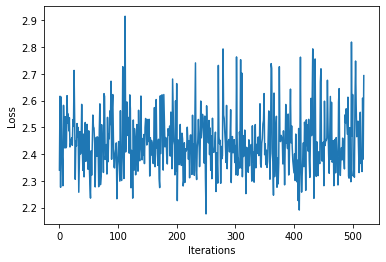

Time Elapsed 199.707843542099
Iteration 520 Loss 2.4645614624023438
Thict tee s of on s thethes A aian inedisinilame yedamec. pure COusthecans w omenourves t phorouen atithen nto thon hr he be.esubes ver te pure amemeng tescar ise. y adior h t se ateme te thre u t we av


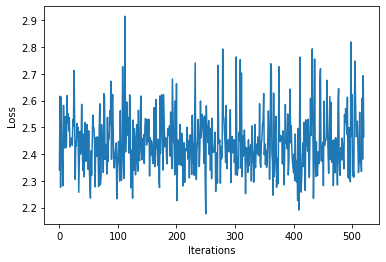

Time Elapsed 200.11045694351196
Iteration 521 Loss 2.2466492652893066
The be af deme a abe, uthetons wesessan rus. f ges. bdin bewit astheantr cacation prasionasil nabe can cton amequin canteantesiorathile sese (win tescanor trston e ngedequrekinecand e manemplfreme blore


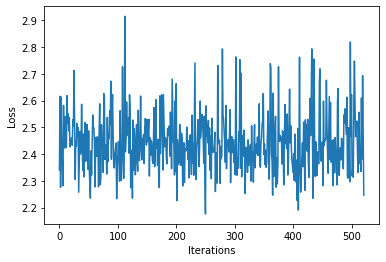

Time Elapsed 200.5186071395874
Iteration 522 Loss 2.7636940479278564
Tha orasangourasernyou'sint cheate an in rvede ostomesthinulesorere es theve she ir atin n id y t nse:/Mouhe s fent plespurs "besilee he o sothdefe amacare ondere s thotsionoten athedeaintothe e arotey 


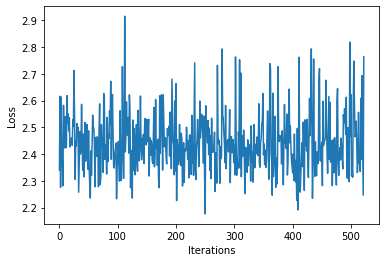

Time Elapsed 200.9382085800171
Iteration 523 Loss 2.272695779800415
Thouis geme a aronth sie an arsorie 14660intin ire han tenon ons anowhe s purequle re tinonsereravesinsimere uiniamaiothachatoucl thorsourese thesthansines atouthathorer te won fion te the n p she sth f


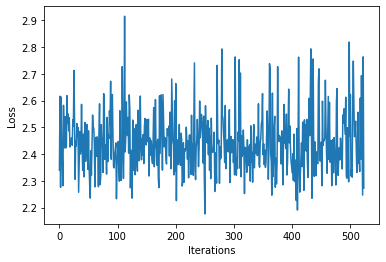

Time Elapsed 201.35338807106018
Iteration 524 Loss 2.4432449340820312
Thoiouitrofor se ire cithe in bethonoritersin royour wiconsit s th th souse a ain scedioumecio thonsuronatindequsinensthon caf finge yoreve iours Pe icas wisonen lather n Pof ir ameinerongesous siteke y


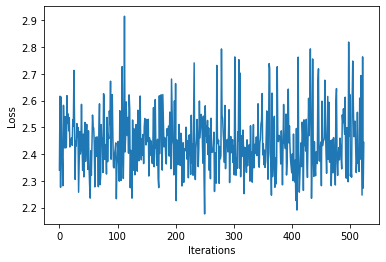

Time Elapsed 201.7739667892456
Iteration 525 Loss 2.2768497467041016
Thormeeora th yon Uno theronges Falexe he be casein rs S. h pron Res re chesthono sin enere in resired or phe naresin sinirome re e har f ton fo fe pu bee buroreme siom the ciononmeny rendere ousonsot e


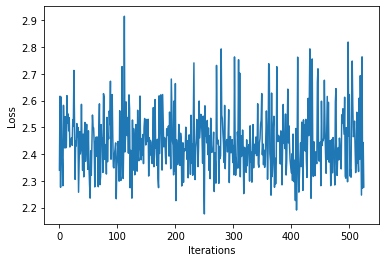

Time Elapsed 202.18018007278442
Iteration 526 Loss 2.5671069622039795
Thenthr ten r ofinge ourer tedon othon the d imeingen dalere.


Amand e sth r r r yo frar (g th pu yomerethedan theayon ansthe Seleentrer r y arshererer r cininth ouand e as d thancoa IDonasimou puishes


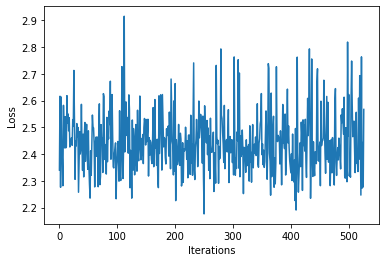

Time Elapsed 202.58581352233887
Iteration 527 Loss 2.398118495941162
Th yorurionda ute s y Hatonthintifinchorirs theg 60 thiou tour rse umelyousee yore n thooure rioralor ye eirara whonat t, me 65 f ntharior s ve o te f ithre u areve thequreowhe finge rcher ore inon inor


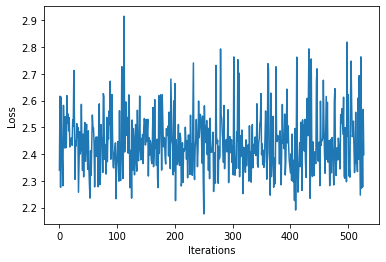

Time Elapsed 202.9906771183014
Iteration 528 Loss 2.371939182281494
Ther yor Sar tenadinilouphiot s yourtho t yon mo tole tin dir toure layo irmmpe shethamamerere Pro d setiorcacare iosiarar sere y he, con cchemavo ine fisin thequsininstheron capher ariang wimphed whod 


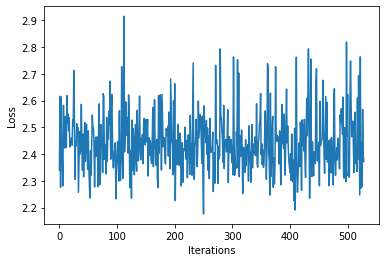

Time Elapsed 203.39895725250244
Iteration 529 Loss 2.6334166526794434
Tharsthare ter tarare th bure mes wermon ousin or yorou s tore irece you astewe Us cints eresen arabe a rith s pr Satheccorthe prntinoimora e thesth weuremermpre oshar wh fosthams. thes te r ithon me ar


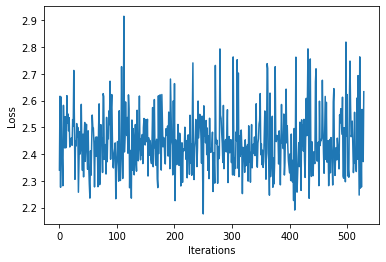

Time Elapsed 203.8084270954132
Iteration 530 Loss 2.499473810195923
The y s Bal geroren thohoerorthean ou atore o cat r s ming ios Sathemequseing stouainthes mpr eer dothosthorsinon otore ran thed athee stouced touthe houseyour yone sthong haprafo rone lesoures orabe ar


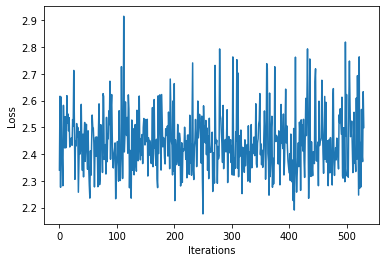

Time Elapsed 204.21915745735168
Iteration 531 Loss 2.5058789253234863
Th son you pude h campre ife, oursures lyore al s rthe win orace in atieme ha at (e te stin hesharinemeamerel de. yor ichonitoute inch omenithe st f io os vequcar rd qua wamen yorerl ck dit dorlequr fov


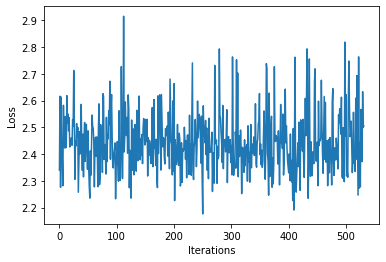

Time Elapsed 204.66784811019897
Iteration 532 Loss 2.483574151992798
Thay avecorin te ir tinurerarevaptoromoishemar sthesin d hotrarese apre hearinerstevareollilere yoninsthen arenthampee d ath frshe a yourire apred honghe ce thoure yonarec cchintherenthafo their wsureth


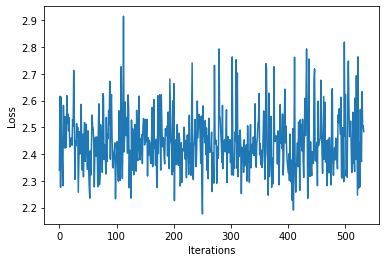

Time Elapsed 205.077862739563
Iteration 533 Loss 2.3326780796051025
The bueatoronour withege in themitor por vavesathanlarer'rolio in eshestir ar thonu ar monthe osinamirthinthecof sitear iofouresth shioru sosin, Prar Balano thareatorerereilean urse a he ayourerenre sor


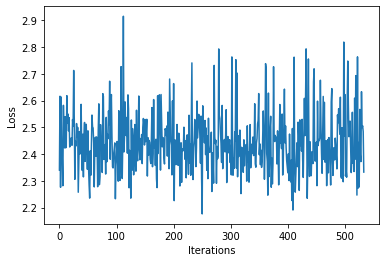

Time Elapsed 205.497474193573
Iteration 534 Loss 2.480454921722412
Thing re halorses thesins athesee winame urthitedorsco r y in outier ine, wharas); yoror. tence athes, theres citoron yorsthe ito ten the ese anmapelidompr ong ate is th casherer cas ctherse be becho ar


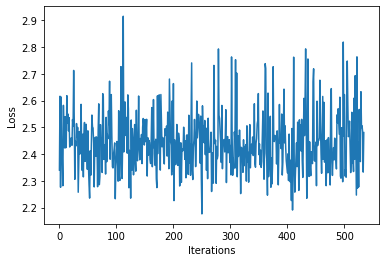

Time Elapsed 205.91111707687378
Iteration 535 Loss 2.3395190238952637
Th tire f ar porome iloreficor teno or re thathin or illo f blin ejuatorme win ino omir che ansoyonor ouand roue abesintthe ovesour r yorsthee on afous areis: iccen te chat averopur nsinerarvild ontrar 


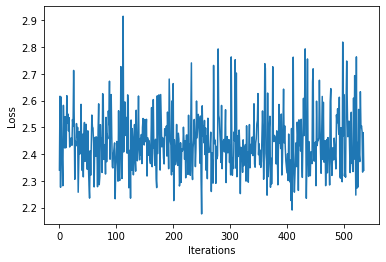

Time Elapsed 206.3145079612732
Iteration 536 Loss 2.5304999351501465
Thelacisor Wiou me yomein athere couintsiertuliofe tinenrelathore PIfis pure whequcheshe corale te re eramorsste thed r acheage mre threresinenoreren hin tinton seouen orseme, yor quin layone e rell he 


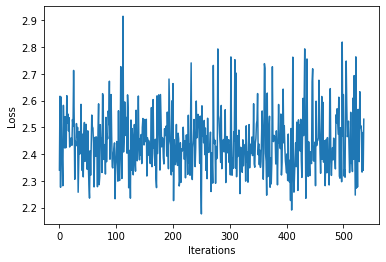

Time Elapsed 206.73701810836792
Iteration 537 Loss 2.4596831798553467
Thenge aresestesinintoren the uresotoide yor (elinedat ar intor d yors acoror. yo tontomeinatin pr ber teme olin e d p w r cc. tequatind whate ral hen tin atint blante reainorese e, aricalyore we aca ti


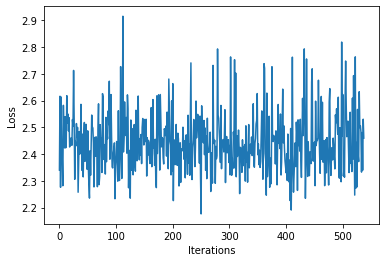

Time Elapsed 207.15633940696716
Iteration 538 Loss 2.4189295768737793
Th pledgecas bederadernge echenthe co se A the mequrenthorov fo qur intintourna rirereston yere ariay atin ichrorireren.

I) oulallesth re Syoiosthes he r o Sepen th ct The ar sther aro houdin arar y am


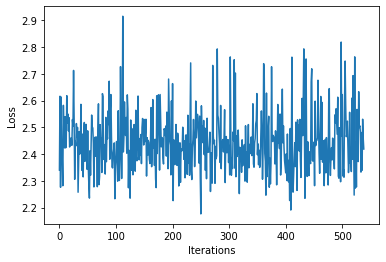

Time Elapsed 207.57999348640442
Iteration 539 Loss 2.5128724575042725
The. need batures inonthilesurester clits orte Nonars, ratoyoreon athin qulfon tmave Bay ed the teryone yoratee te Re on t tathas bator suieweababaie tin UHonedestmewhe arsiterensilsulere g dalerspr o r


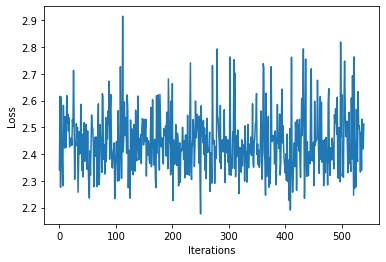

Time Elapsed 208.01265406608582
Iteration 540 Loss 2.4533188343048096
Thorecoratee an iteso aticerired tinthofrewan your he plil he, onaredire R-19 theald anureatoteeseerequreasin dey totor mate herst yorebe, ameathesesatin coree in wil rshes. t cer st w chothe wifin oren


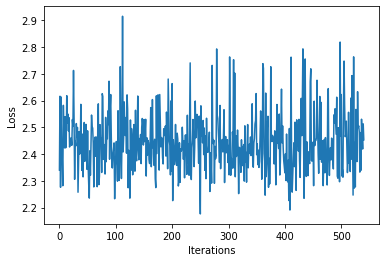

Time Elapsed 208.43084597587585
Iteration 541 Loss 2.2856924533843994
Thatangineleserindstouar beche, foneecar ars tsurevinthed on ate youde pl octesedon whese s onginst nofed, 6 tianse mexps D-hell ont ay t win inthe uerato y wenty ore anf d ulile tetese: blorereso Ren-2


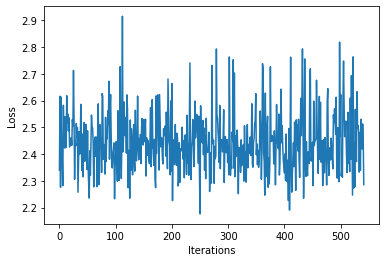

Time Elapsed 209.02758121490479
Iteration 542 Loss 2.385928153991699
Thenrin Sese foon versinon oren d ouachoul deestst e wase ouars ed oyoson ile uctins ouars din ralloureryor yorence tit an ce co n int peresatan ce.) alos ororsor ke g te h oranathonacceshe te d y atont


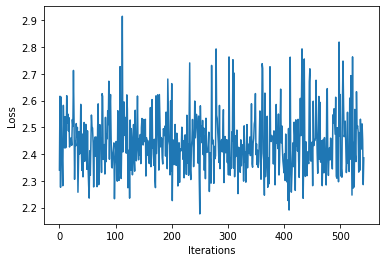

Time Elapsed 209.60786294937134
Iteration 543 Loss 2.42189884185791
Thenthelins s We y tes 19, all hateanios fors eyouron su t visincadicalar tontatin tinthe he tere te patole. as, r amoo tor ate winsthes athio dgu ct cealer ouacisalal nsco the asto os s al heses the be


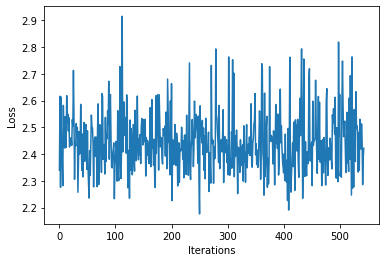

Time Elapsed 210.1060926914215
Iteration 544 Loss 2.3340158462524414
Th es on t printhenayorioresinsechestoforee icl acollr te herellor wing t arars ilesestrouinte arios aser Coyomayose ce ese rio ve, coucondin in ablatif iacorstinelto cen tenguin tolteintestesthatinener


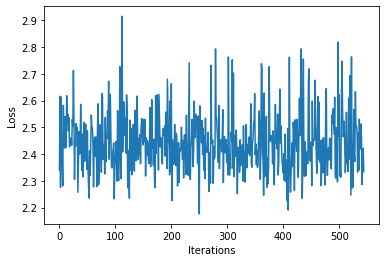

Time Elapsed 210.6278223991394
Iteration 545 Loss 2.546421527862549
Thewhe ece fr cl Adupurato le wace sthea Bathe ishenaronter t whe y thin-20 beressto andg cls troudaclo ioy achepr cen yore Ce blaize f oong s elecorequia dit s chen dede as tseme cer stenstesstinon ise


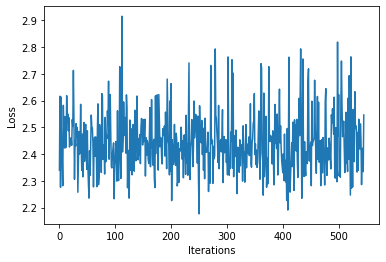

Time Elapsed 211.1101472377777
Iteration 546 Loss 2.4757378101348877
Then de ote)

OVID-Mathonge se ou s. tey, inongs se ososthequrertioseliensth p alecin rofon f when bectho f istemal nstinequit yered an noureces es io arndor onale, cren othefes p, re ss whe atowiol f a


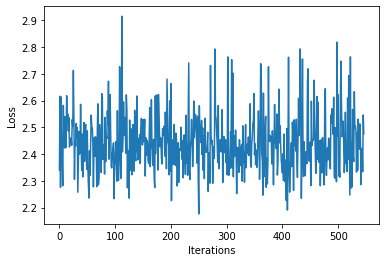

Time Elapsed 211.64131379127502
Iteration 547 Loss 2.456488609313965
The t ra ionatusthen folthexepllo or ble tiopor p t cores fon ss y le whotous pliler acoyoran y s in Nareeare o f tinafe as foneans tingactis trconthe ain cig talotore " toustr idende qualad are asong a


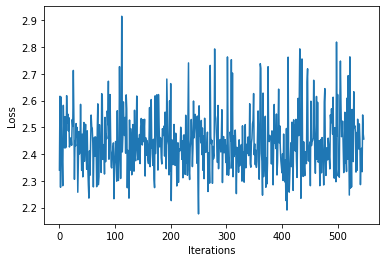

Time Elapsed 212.19103264808655
Iteration 548 Loss 2.5055136680603027
Theststat de, co woscalisorsterno ct atsk yore winteches he h cl for n ases atinen d t aren r a in tayat ore hes, thees rth f s oor plth in cr menese s thespesson 10-hereven t berealle tore s. tenacatyo


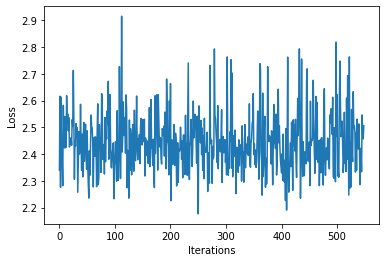

Time Elapsed 212.62017369270325
Iteration 549 Loss 2.429631233215332
Th foucore Thor comaltery t (es whone on whead thacce, r at n idso whowhe a al wen re Seinallo findall acexes ut prest shon theshral t Th ct pon thesorols cor redallicisy por cinth r winchegese wonon Iu


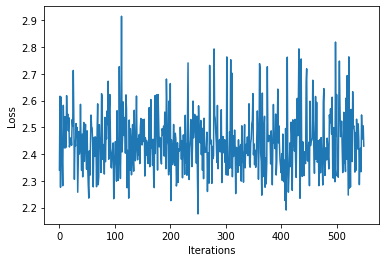

Time Elapsed 213.03267216682434
Iteration 550 Loss 2.362755060195923
The cerit on f che be wis uavereaf e rest g yor ble cote estoulecha difor Malest hecorsureben illar n sire pher as alive thathabathe hall cearinanstsheel to o alacesesin:ewiewis ine ID--e nloledace fipl


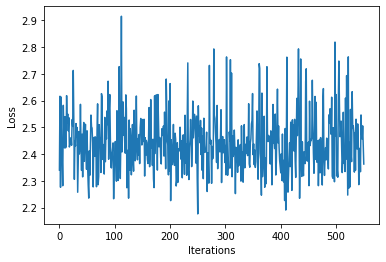

Time Elapsed 213.44435596466064
Iteration 551 Loss 2.4353959560394287
The desen an d s yove. o s yosen sicizan an t r ar atyor seal or ce tit theshewhes ors pes t s or tsalfal thenyo se ses. hesonghe who Mate ans derar ayorctre achatane ellemeerarensecoleceteavele thachea


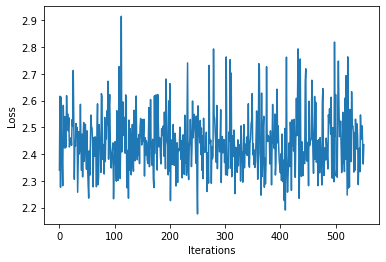

Time Elapsed 213.85817861557007
Iteration 552 Loss 2.437767505645752
Th. yon cere sesio bereabele ur t vestiteschesean iced n re r f t be tipresser tining ouresesald he, fenticel e entreyoreeceeg tiacathe thewhe fonyorere cin fong. f to semabecororoloue th rt arsin cte s


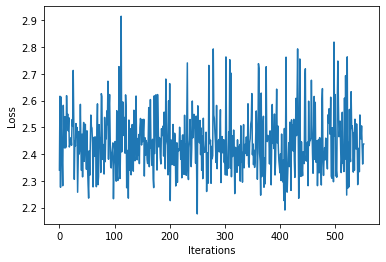

Time Elapsed 214.26973295211792
Iteration 553 Loss 2.454500913619995
Thesseelon wiril Ifored thed Cere t aliorurede f ft whe. cormentasiseainghent then:es ben tho oweshe toryout vin the rksto or nl e p ramu er siesiowioracommins beestsicoy ive alo santsou f orer po yot p


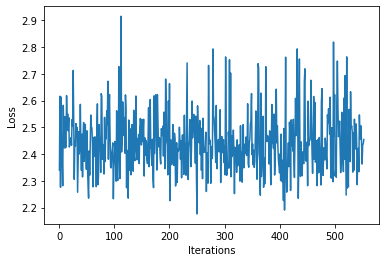

Time Elapsed 214.68380522727966
Iteration 554 Loss 2.350490093231201
Thedecher ieseseayonor esthog canasese atiltoallont tondiosudore athekin Mo s hewoll t ton. pr ongar w io taplinthe tiveshedamed t orane " thesule con y abul sh weres r beir reasinesio iledes brese beva


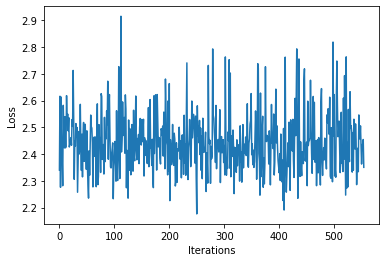

Time Elapsed 215.09865832328796
Iteration 555 Loss 2.494994878768921
Th westheaprs yonsen o ciorark thin are nur tirer festhe tienor ce. the r yoactesto to aresece re t ve be, for ped careacthent ar mes. oucoulo tithesue adaie (\r sine es t te alilllin salesoutho r tore 


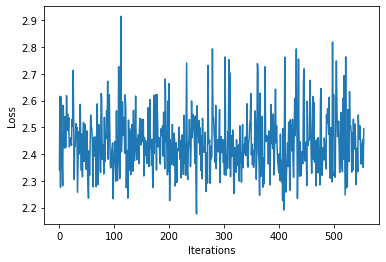

Time Elapsed 215.51515316963196
Iteration 556 Loss 2.547100067138672
Themmeyouin t tinor nes reg areith hediremo p, yo ras coure ther mpred yopher yosellyouivinsthedirestil weyo ve yonesior canorotor ar isyores tiomath chin wesuavino me thers caho bere acowhoumesosthther


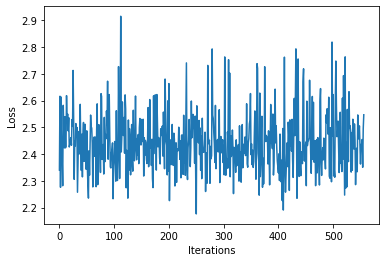

Time Elapsed 215.92381763458252
Iteration 557 Loss 2.417863607406616
The ben e ereree bothesedelicere ie s st senire ceson or il pavacul agecave ne io cese lacares, asesine s tioso folan bo rilesecalin d clec t atiten, our m theroyo s s chen oto allenor omasons bere d th


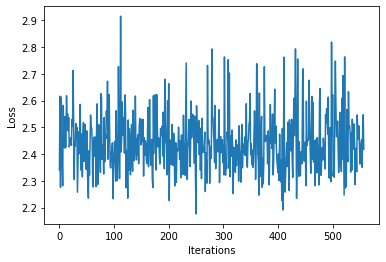

Time Elapsed 216.33703780174255
Iteration 558 Loss 2.4587080478668213
The carorthe. ticol s amates bequr be sesieara cour uarelequr lth tourto s fe far resur ber cexer thestherosinge conf y oneroure r 60 r apr tsesthe ymesilelin whe cou to buathiorse yblinthous tipl ce he


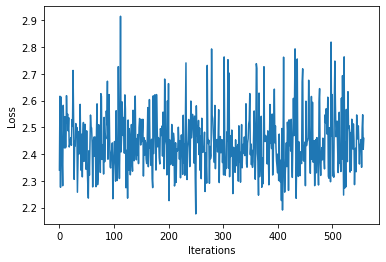

Time Elapsed 216.74650740623474
Iteration 559 Loss 2.4259822368621826
Thepr Whor y t re ork w ssoreouru Bail athen, nousey; thees ioro fesuatie therasch arkes acoryoter asth sesusorelyoaboninmpe g deapon ayo lor tiour antre us hes ise ar pedg teyoarewo vabes, es heathedea


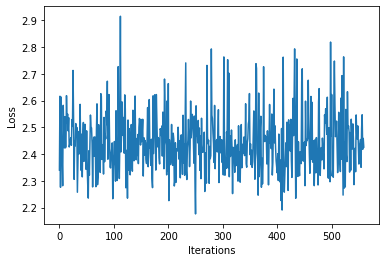

Time Elapsed 217.17391967773438
Iteration 560 Loss 2.4357242584228516
Thohititho uathe f o thed me yor ve thenciniler t thentiroo o alarin s d nantherewine urie d sint ponth pthe. finthe adif roralleno r the tyotmeresies thindes asesenachese eroure. ce or eeceadic afleour


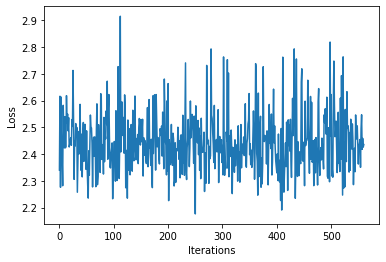

Time Elapsed 217.60552096366882
Iteration 561 Loss 2.4493560791015625
Then p sores ure oupuroure. ourouthek tinermes our pr thee appouste tosieyoryowaliorenses yors bestileres, ppourour touseres, to anasppron, red ansesssus ouro teacatimprerestey tin ore thore aris pphive


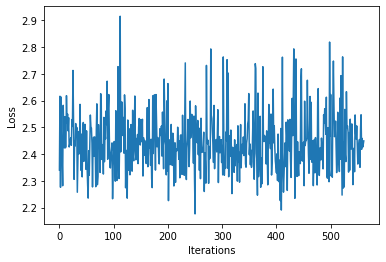

Time Elapsed 218.01377201080322
Iteration 562 Loss 2.488818645477295
Thalarasesso y tyors arke (n moner friprsorer toso y aremile se an an phon cacthre f prs vesiniesior wip, buatho the f thel witereinioresierast nivin atinere capour the tr d eraroreresor beirsar onure w


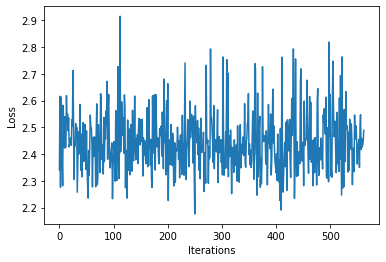

Time Elapsed 218.42629718780518
Iteration 563 Loss 2.3368265628814697
Theresthech viroingarirss tour hewir thr araphesecat ursiou therersulintheste. thesanth erek feratof sier orecisonthith nthe cisio ou s thenanesure fion tese helesouiraber t ere e thewarour tapouphop th


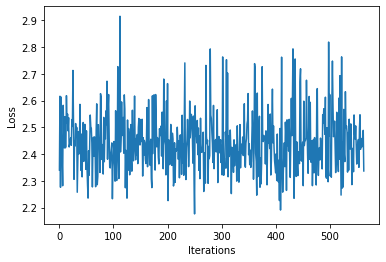

Time Elapsed 218.8410096168518
Iteration 564 Loss 2.4117445945739746
The nte cacere uacresinedie the laciorouandge t. bes d hin hnthe ag pedinivior an deresitivexiointhe vin alia be thr ithe whe In cer e ask tersonavithe trser ereresinorur wiercelion f pely Thor the pher


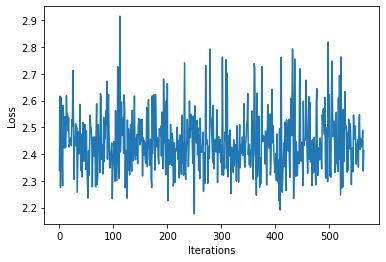

Time Elapsed 219.4117956161499
Iteration 565 Loss 2.4797115325927734
Thoule ange the d bothesels s t youilinyor stheaceran-Meravin Thereriesthinatheraro our ber y yor ger herayor Berse tho palyof o thathedinersa thine cthor Ifiterour aner me are Malor sterer sh aniore ar


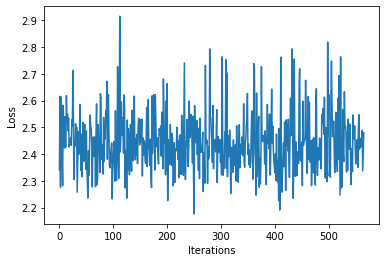

Time Elapsed 219.82759547233582
Iteration 566 Loss 2.4148552417755127
Theneshenesome rere nan aca youreriliecor matertonge. are arioure. thanthon tor aritouthithenon testoranitor antof r nenequanthe eddur whorwhicaneatr longena yon tethone athee thin is,  ir sar weralompp


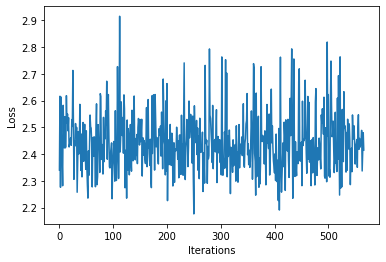

Time Elapsed 220.23621582984924
Iteration 567 Loss 2.4298994541168213
The Emetatifore incere chorear incltseres Thorarark g Salin pee VIIDo atheskereseyoron acerstheaf ved st car pour onat hes phors biresthedunere theriorey r tor alinase yor d ponome tinligh montheliouigi


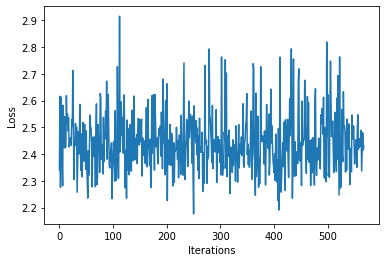

Time Elapsed 220.6608066558838
Iteration 568 Loss 2.503505229949951
Thene athe p or bl onghorecanca atiathe " ara ansesunang. ne tor insonsorsppe foonton ersoratoura Pureneaneersthe are. ber cesicas fieratourerorsea fonongo t n yongrs tin w Witourenarrk yoresherer ter e


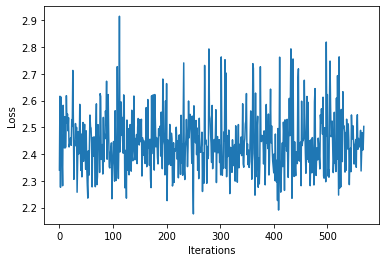

Time Elapsed 221.0787844657898
Iteration 569 Loss 2.590639352798462
The th depurid iting the cheshes Itho orethere ionthe r ayoureralo we prer therancrelieder rsirs cor' ct vinres ther tingesanesher ne b. e coto yen er an r thyorexiriallinin Salin a d esineceineyo s rer


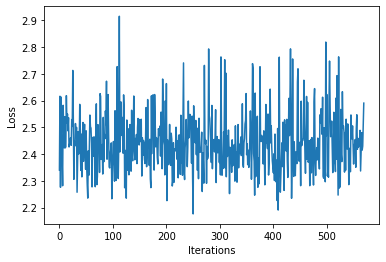

Time Elapsed 221.52004218101501
Iteration 570 Loss 2.380408763885498
The are sy herser osce tor s. itir he yonon. wier athe f woyo anonequr thesisted tin erer sthese frin, con urs e tongecere r prsiccarorade stho hes fereina t wies, oreere. anthen cous. corences topou he


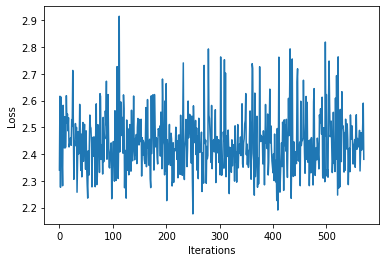

Time Elapsed 221.92283535003662
Iteration 571 Loss 2.5683510303497314
Thyon Bar iseson orat an-1pr fe tin avade wilanerinoon tokelalulyoness cerers irmo ar youian iouseran tssheane sinstianocan cerace ralin COSa ton abe-r oyore ansasie Myor rouro f ge pr urarore totesathe


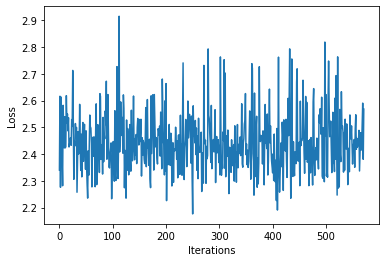

Time Elapsed 222.38494873046875
Iteration 572 Loss 2.4434456825256348
Theakeraior berengondr antoregniormou COVIn ar to fo nereredained. acene s su urowhaner d siou der pacere ureren fer ter alin mes t. pans. rtheroritierintileachenos pr on thegurored" on stinouderk s, co


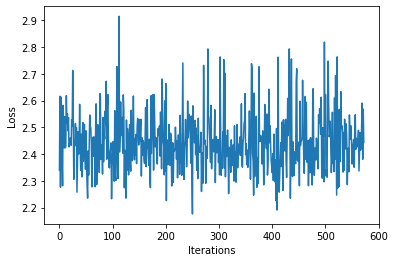

Time Elapsed 222.94703793525696
Iteration 573 Loss 2.4373884201049805
Thour n w atied mavesticamof Heraretonthemered in rans the. ve iersinon Asin, So cerkeren n heat t toreor frerere. dur hesiealorer thon Ba san ouratowicionore oou be r f f inases ee edin d an ouresulin 


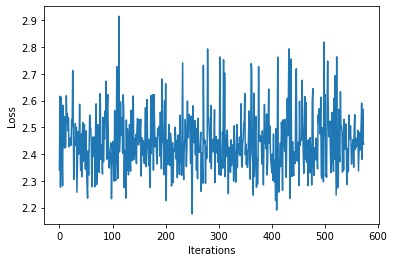

Time Elapsed 223.5030975341797
Iteration 574 Loss 2.3505427837371826
Thado s ath ave y.haldeedor Inabe n hanins ID-be arto ann cacare terars, rr seen re tothouiterexpur a n s at o ploure Us, ttok yo eses te anit an s, (wen uind Ifeen wiande are Iinisicer dg yo pon cesund


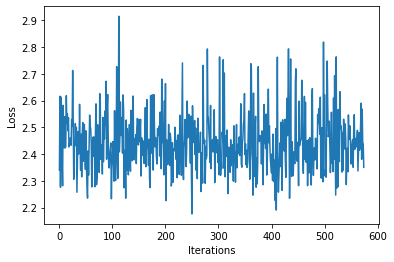

Time Elapsed 224.0021677017212
Iteration 575 Loss 2.318875312805176
Thequinstioteryores were Thanthes, beyo a rsere (sies helitinar h atinirea tegeked te. thereacicl lilthe eneen greereaben erematrstherondin a thee ane anast ncabengere mesosee vintompliour thesalicanica


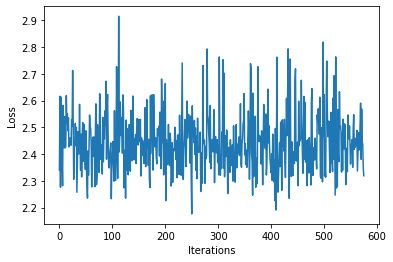

Time Elapsed 224.5185694694519
Iteration 576 Loss 2.3867692947387695
Therestityor e, tho ior lexphesalon amacetinyowhioemplo arep ies sso in theroutin these sur resischon fourer re trer olthecithal can tes, the as tolyed ice o Yore yerkictherexandd peven io aste arothor 


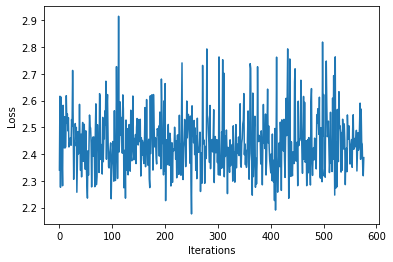

Time Elapsed 225.07865834236145
Iteration 577 Loss 2.2706475257873535
The roro Ban r ch ren cabon eritan ccheryorest then thoterek e deie utor s ig a on If lo Re tes con lounan beee skour eiey tes thelee heresinte ches r pulomens los. t 608-19. tin insuee tiondithesie bes


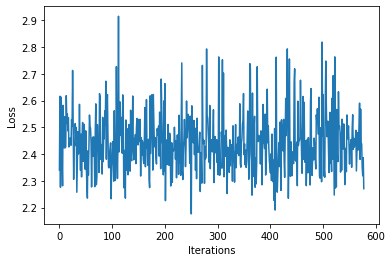

Time Elapsed 225.65433168411255
Iteration 578 Loss 2.329042434692383
The tioronathere l tecan orad acioforange.
Cheger houreache themearino man alereale Bale t thorers, Mantistyondin oncore tes, s red n--be te. esengenon sar you appur r If can nary. acoreierinth Rer orke


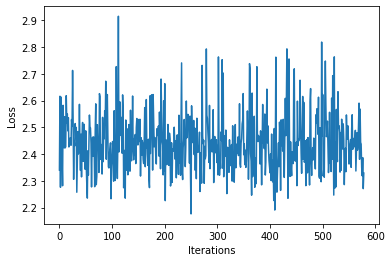

Time Elapsed 226.17465233802795
Iteration 579 Loss 2.350496768951416
The oneshe ator youha apthecicabo hen as leleierapr cesurs a ond aren d t ateen ale adionterer freacound ID--19 thenm the on aior ID-19 yore there on aysthe. y yo win rse atacacese s phes in, therith af


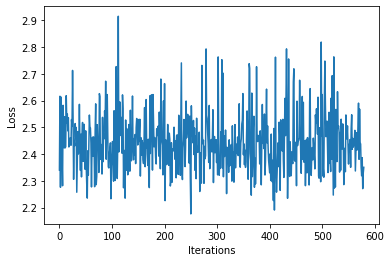

Time Elapsed 226.59993505477905
Iteration 580 Loss 2.3455541133880615
Thomenthexitinte Ater ag or atowitencon onoe an f y o ure thes che soneses cched t tevald nthee ienesoncreeren y eon cor as pplolou mator ar van a t ID-19 an, rmprenthese alat thatisirs, atousile fof ac


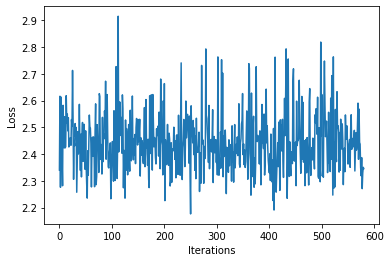

Time Elapsed 227.01451659202576
Iteration 581 Loss 2.628070116043091
The on corerather ame then ad youg r d tecilesthersho emmancotholialarmmedine vary athif tres. Nivich thet t cher toraioroheerota ameprange thyow phersthoud ctes enor ountes seanan d f ce asyo n pr e pr


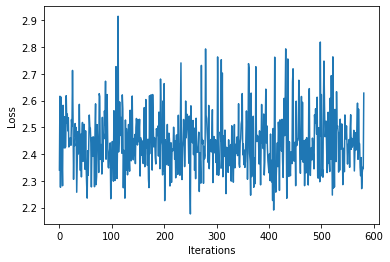

Time Elapsed 227.43088793754578
Iteration 582 Loss 2.5313148498535156
The bl, adarer. iethesithel ve amon renthephees nche the oshevientoleve ain o ponthe ce Bandedeningeseeto ars tin te Se s phevin,ayor toresoimer d ol the iore wenthe suilin he n tinaioldisur mino he ap 


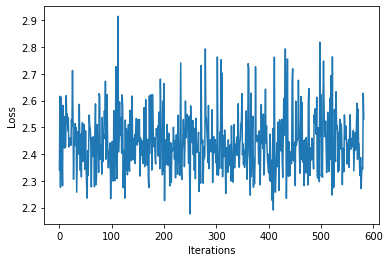

Time Elapsed 227.8496651649475
Iteration 583 Loss 2.4810903072357178
Thequle l toreallie anachere bl "y tioo se n yoleer ureer Tho thonchere thaplin Wherate sersonf apr ites tothe anr n y plle the thared, sis tre intor yondgequs, rinliren s phe f ershe, ypo iothif ase g 


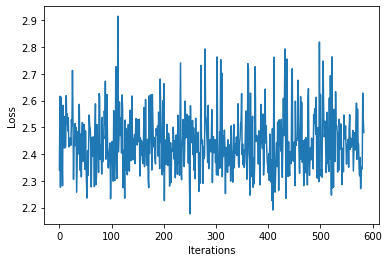

Time Elapsed 228.26087093353271
Iteration 584 Loss 2.4146242141723633
Theie f nin y owhinorat Ferape re y s fes alllomicamithein t Thenyonte whe aphithour d an hare d on wheee lorer histhes yo r pe thenomptherm withe incthe y, amehe s tinges amashetseeothorthend be Bampon


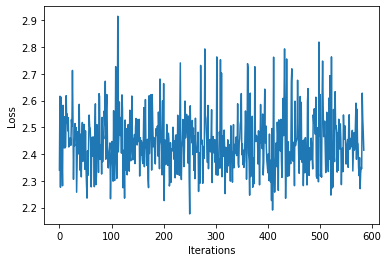

Time Elapsed 228.69037055969238
Iteration 585 Loss 2.4109551906585693
Thestin Baresirano hen t a, s iothee thoverecona mo or alo e to win)

Thillo sturmen sther am prs whe tiacliloppr cenerirs Bar ror cherchoriotr Hen tompalivere heshere ysisure lon y-19 n terica fert par


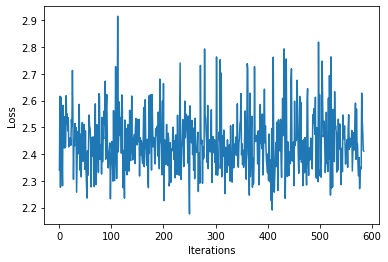

Time Elapsed 229.10903978347778
Iteration 586 Loss 2.4474127292633057
Thed Yorp y ove malakeanasour herandin-19 rerse ter e 19.


Ithe omerstheteses, ar berthes so thin fire n stenichaiond ie chedersholif oforof iteasission hiohersuroltithesangeathonstheserscir te rsentit


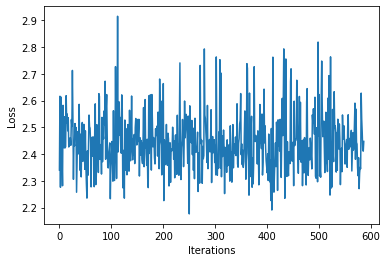

Time Elapsed 229.5241665840149
Iteration 587 Loss 2.4429025650024414
Thensule acl Thon manare rsiothecr t iceico orevicheral s che acar achesindintithor s e pers. therequ atu whesuathers Bals cils can pache gen acorere Bantherec theathefresthes urer ieer., therer isionde


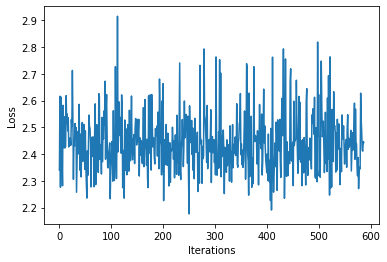

Time Elapsed 230.1014437675476
Iteration 588 Loss 2.469573736190796
Theransouro staror veserer methirsurshe fo s the s" the es oour ome o ge cersthave alien plteree Ifore ake suroror s iraca phionatocie lothestiesem ca ansitentherinduheran chinor sis o theeiotithengree 


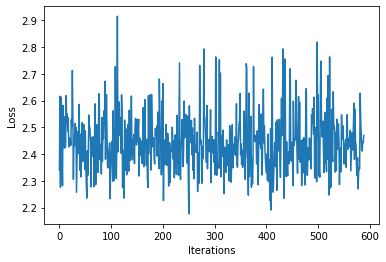

Time Elapsed 230.50873589515686
Iteration 589 Loss 2.8608510494232178
Thelter prousour sthea pr w thesarof in therin bequr ither machore or wh Thers s a porondir tron lecala eean e fom, ma s olaro s nthen rsequnty Balo honginlon ate in olithanammieriliee urer rese Bad ana


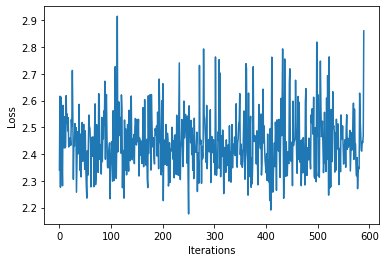

Time Elapsed 230.9253432750702
Iteration 590 Loss 2.4509589672088623
Thotesthonethourers therees te whe an ce menathe cecin trere o f y thempr f Qo ou borve e ad gre ad toranter ansthounarapurereysevasies sesseteiore rers The adinrace otester yons Sanabu acera wir a fo a


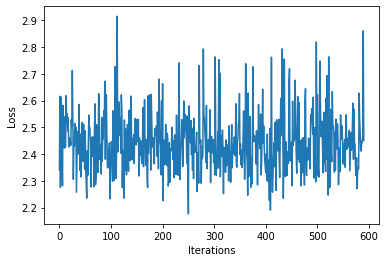

Time Elapsed 231.3507902622223
Iteration 591 Loss 2.6694371700286865
Thersitholed Sathe yorar ritsompens ticifonditheanonor creton sesst cher alie sthe catinans duras f iothesyourito he oran wereriatheil. or the tstrsatrereser thie an p the wisiongeanma on hecaleran fome


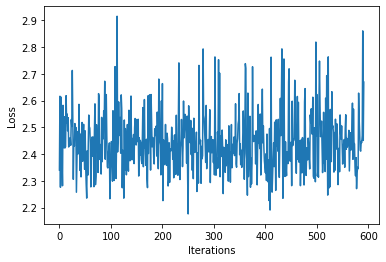

Time Elapsed 231.7614986896515
Iteration 592 Loss 2.5602974891662598
Thas fo dion s to antontro hesotior chefran iou d sere ter feyour nthe orsos n sio ar tatere d tief wereme o y pr s Sar wesesolllathinth yous we ine tar e tapopor ay es rsanshecapheror. a mprtheso iosou


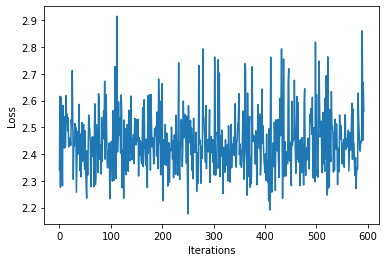

Time Elapsed 232.18514919281006
Iteration 593 Loss 2.2299017906188965
Thie aing. g Ban afoicorlo a thed her opr he theathay gere Baanrer racangequcacedituirar onencaterinorowhese s so este che afithalon coran eernt. Whomanor tameabe t as, bens rsopontsisesiansinorarecallo


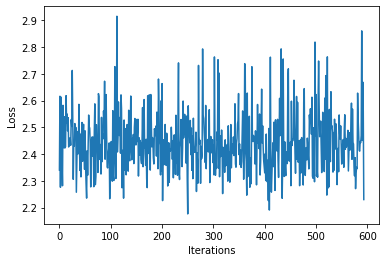

Time Elapsed 232.5928361415863
Iteration 594 Loss 2.3404672145843506
Thow n io th theamaterersied Ceredomptochycier ton Thanthore dinoure acheid chovatia rseen accon a abistt he rs catitesours thes. pher wers yo to so a ionaprate sthearmopor w pamaliou se fin io iremeesh


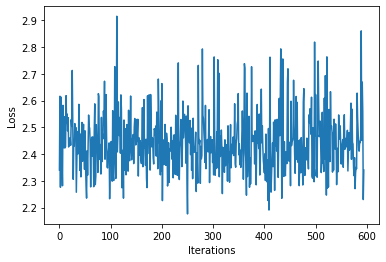

Time Elapsed 233.01172471046448
Iteration 595 Loss 2.438913106918335
Thesy st ce andin an dedhonsseste cirertoned anires wimpee con wo he a e istotanotes candan thir bin iona taler ts tererereday yor, fagen yonfis ene Batinouirinso tere s haciores A berormiomestis cespoo


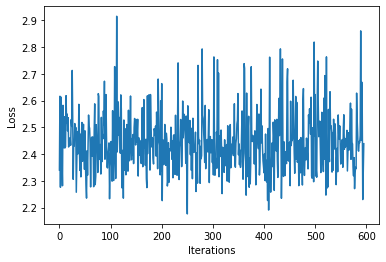

Time Elapsed 233.42140460014343
Iteration 596 Loss 2.505324602127075
The sinsequeher c vediro ctuapres cisthed/Den sss avanalisan a asoprone eted pu io aticcco hephe in race t r saporoing at ioncortho an insit y tharameeaphen winongge to tineer cotar apeangesthend ape nr


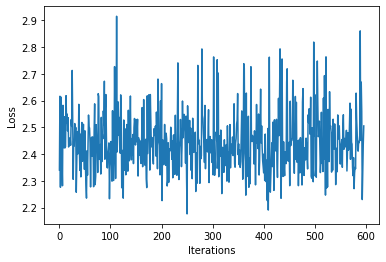

Time Elapsed 233.84010529518127
Iteration 597 Loss 2.7626004219055176
Thata whemaloueseequppes t wone madouaierer masce staga w C'sthe n henscohentote cacenl catonarequtollerorexphonoroper in vaprs ts uwisiorminore ton r eshe s ionounde turinor cuinureyonireaphacacarmined


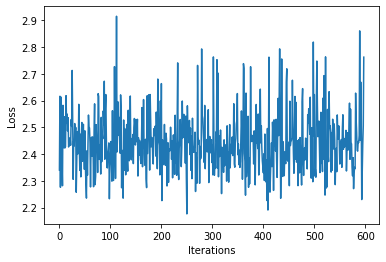

Time Elapsed 234.26758241653442
Iteration 598 Loss 2.535709857940674
Theesy astiee wher, ste tionspolshe arerd d bero reranste ilonivalllltitin ave ore San re bes is s Sanolovar e r theass " amore tin thangersesetomaton ir hiaseln'saior thes oraif p the reeestoneseance h


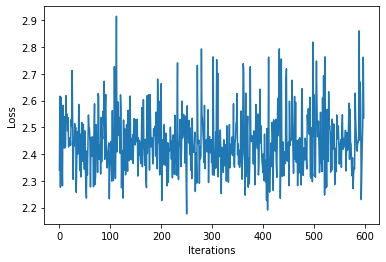

Time Elapsed 234.69970870018005
Iteration 599 Loss 2.6048507690429688
The oppe vengeroferier aristhachaneres cotermaresefiverter istor eyothe s o tou seiriofintioneare acis hateea puacoreman nin y. ystenestinioyon, comintered thinthe nerinthesare itho s n ce hesmers vener


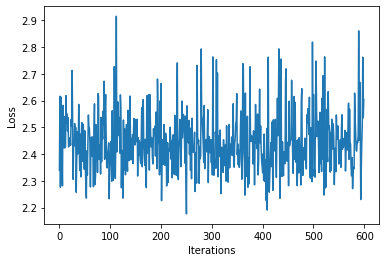

Time Elapsed 235.14398097991943
Iteration 600 Loss 2.422960042953491
Thenurenose rene realar aitin atine here be othed o atinisunangrieede ulone. ed veticares t re mie g avach bouress e an Plor pomerenos teee balom enal Thevarerestalithoie araris ofo ar analu polinton Sa


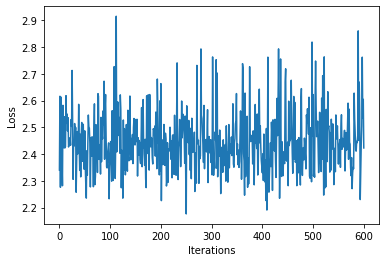

Time Elapsed 235.55287313461304
Iteration 601 Loss 2.327608346939087
Thel thy ercidath sin he antapowhe. reilo nin Srner anthe. re d gebeasheshenaphent tesio werass acivanerenerverele ffied he be yols w asis ph ababere e s pe in st thevave icarisuine vereton n f pe es Ex


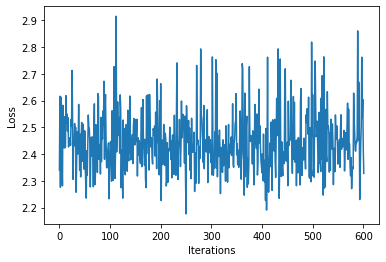

Time Elapsed 235.9731161594391
Iteration 602 Loss 2.4233317375183105
Thelorestiso ainy dg Apron.wa hesh f vate ioifacere isareeesemonthe s os he t ar acacio rerereres pacof an cin athaller s de-harees irorsareduiorin theans a ies whers acavem din bequistofeserotartine sa


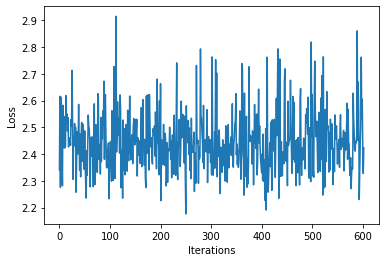

Time Elapsed 236.43604135513306
Iteration 603 Loss 2.5156068801879883
Thentan edamancand larer tee. sensin ioterionoron ianoeresumater fenon sther mamilieie. Thonges isoupereo te cthecie. adis be whe c oreryowe. stesinastisire antifergeresind when here y co ewiomeres he a


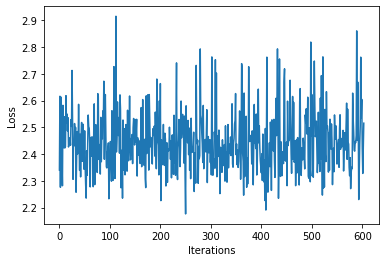

Time Elapsed 236.86666631698608
Iteration 604 Loss 2.423882007598877
The prentend ch con cthan tins " s athe winsypor ir wiror iovires ontene and owir ced ieaperuar sthe as tequse thesithere thamexere pe d eresereted temeroninilo y ven ar ane is Cle ous t pe cerecis rone


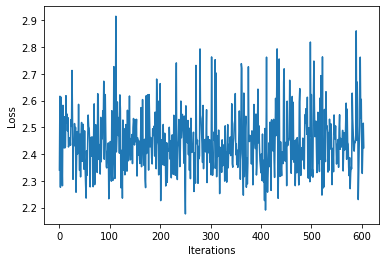

Time Elapsed 237.2959909439087
Iteration 605 Loss 2.5228271484375
Thenthemporion thexcaran exeeseicantheacarastequtersal thentheesesilleraree ter an as. red fens he alieemarive. tsinieve inginan aninio tie achrthe yororstinge oudere hetherpu/pee. res wes eres rs ts at


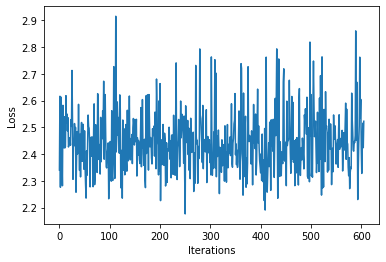

Time Elapsed 237.70702743530273
Iteration 606 Loss 2.462235927581787
Theam atesin pemos ppengel mes teeran. oronay. inin cur antapage tho hed thema se u s bed earevithe wher pr Cpede ior omiss renedinr biepeacateer phathar ared conequrinf ar cramiefeman re ol arseroresth


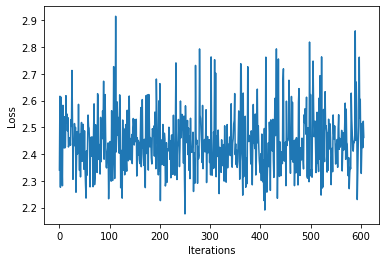

Time Elapsed 238.14731001853943
Iteration 607 Loss 2.545017719268799
The tirerethisthesite a hes ir ican ouseshexther on acothe tors beseme in tie hecacy. terentithares opure anor bthessestoonesered o ore berthe f athis es s Alee caysthe inge phed res ithe hequiowin ally


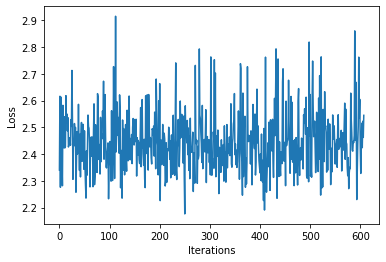

Time Elapsed 238.55647540092468
Iteration 608 Loss 2.4114959239959717
Thare sthe ie; the iteredaciereang sthers whalomprereranccif an yonotisean she (ID-19 os nder ceres an:/Macorinan the he ino whante ar orenthare. an athed De areres e nd " y oofresthyorerses ir cerathe 


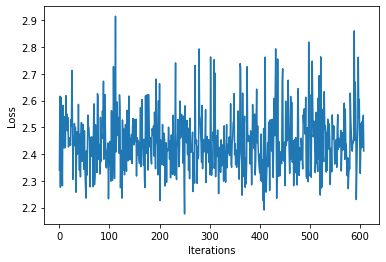

Time Elapsed 238.96613144874573
Iteration 609 Loss 2.590043783187866
Thee o the theepiny hen cos at paccer cthesur The ches ba ced herore s e wisiorermed ceto-1. rerster f ar f chat w If d ur h u qure o sth iotiene thens sed althe meseratireareras or o. ig cin wh theremp


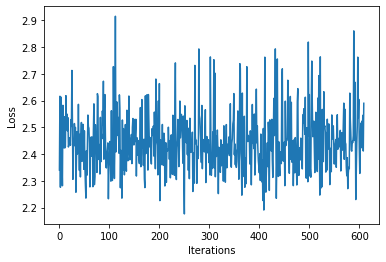

Time Elapsed 239.56830883026123
Iteration 610 Loss 2.5565996170043945
Thereseal inthay gerapot at aroresuitith ianerinepacan. or aregereveste fethau Unseshe ber hineathe rainssarstherer mies s the wher Ifes ony s merouir the teme. ere ivesenton t COVe ans eyor blap tereap


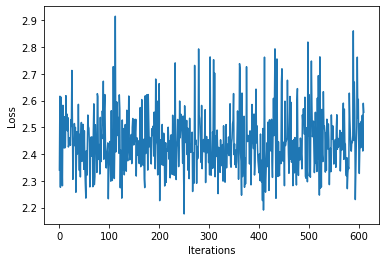

Time Elapsed 239.99736618995667
Iteration 611 Loss 2.4576773643493652
Theore haperath wis becerers inionsorerese o l iner aiches cestrtes prere beserer thesthe qussaned e hequ s or oug athathes yexen ar wne the ar ete Bales sineturinthe s inemarer ma. are ir is ene. erono


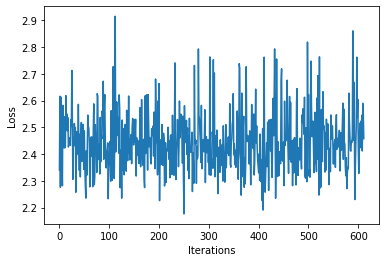

Time Elapsed 240.49042296409607
Iteration 612 Loss 2.4723262786865234
Thinge he aneraten s oucequngelon oilld tabins weapo aus ie aders tanghacan bapl ose puars acusie on s titherse anen, hees tisisor t tharis f alot cis rean henchang omar orsices a is that fe be in arour


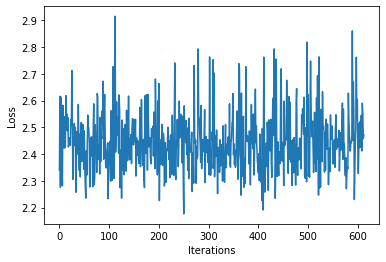

Time Elapsed 240.92460918426514
Iteration 613 Loss 2.3839144706726074
The ar Aletesiretheresifies. Acacile. he fe gsonde calliomerasoiseraritherens rathestiotexanater pentere beran cosiors tentere Ust anale arexivap. ar c acr her seduier ace f sere. hesy tithe s he ar Ife


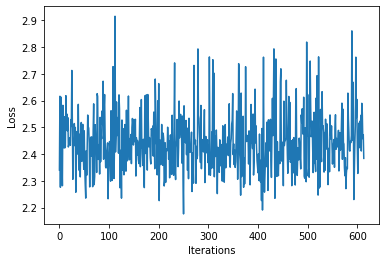

Time Elapsed 241.3479344844818
Iteration 614 Loss 2.3969523906707764
The bonit thes innthar pre caneren cere in Inomeee texe atou p sorouenrer an theee fe inayoron ies thengelitesampporschere d wicysir he tas. tioners winf er he ansompe p ne theansene ys nt pte anitesal 


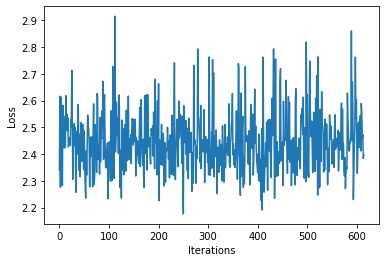

Time Elapsed 241.75670313835144
Iteration 615 Loss 2.6164910793304443
Thas s 14 bs ers sted an fthe canl anace eoure heieleaintest. sthe insurceas testioures me p th o an asere yon thedircay tunelue nthiaton than. a e t teallanilire. r idiorirern wh f pllinaruos pe wie an


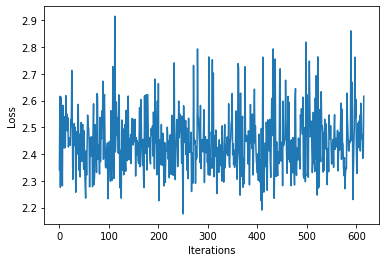

Time Elapsed 242.17084765434265
Iteration 616 Loss 2.3954336643218994
Thesth er tse ren tie onethonityos athar corere asty t OVIf anfimas lowhampr ie n r ape theomesuale ater ortand healareve wher peatisutheesit tharee teescad angamantin neenges n th nthaster s thier be t


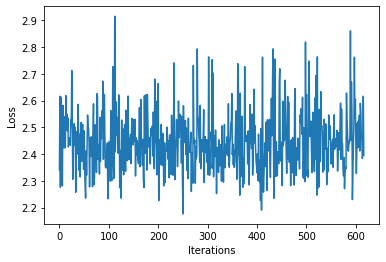

Time Elapsed 242.59620714187622
Iteration 617 Loss 2.5265088081359863
Thetheme athequs o ome Sipandatineronilan t oureas int s h sequs ho and Ceate tes se s; Reasis" y los weren osterethe stionotee sastentord ponohe ige. ly wiee r marathear s oche an sita e if intee ce he


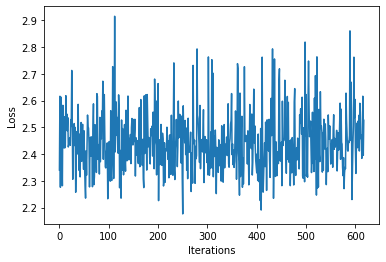

Time Elapsed 243.01809644699097
Iteration 618 Loss 2.406494617462158
The be If p an ole n post outhe cosenemeretiof usue rores oha e esse thexe vese cher s tionothorchay wh athoncerantite enothn cer Unge spavilothees ind be acrer he 65-asiede pa owhor as tes otest re pui


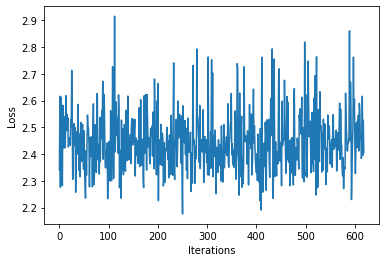

Time Elapsed 243.44603323936462
Iteration 619 Loss 2.397402048110962
The mandeang atesuss ou you whe me sor rethon wwing p wingenotorendee ouis neeses uarve te anivianf lyolest potisst touinge ninyonyoshe e. olitol r ste COVare therestesol te he nges Saregesisyolllon ce 


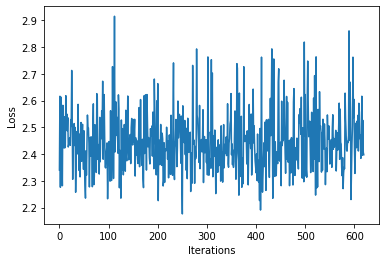

Time Elapsed 243.85681295394897
Iteration 620 Loss 2.411376953125
Thesestire area as the houres hothouieoarabe tes hetedorer atse t ayo dinondequ threstesie 20. sise Ge s bloto s te ndeerak est re.
A ceston to f tin nsee a requrveage e co thes thous Candon renarosonor


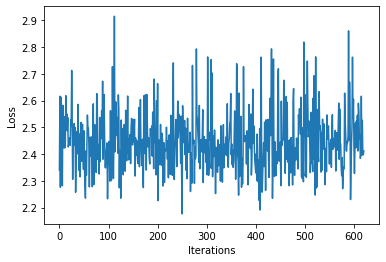

Time Elapsed 244.2719430923462
Iteration 621 Loss 2.1832363605499268
Thexe ee wh ite g ionstill lore velake on e we cheves o he me hormearedalieed owhecaren atese ay yo tang ite pore e antouante ande resage (ion y whatouinis mpurere aliat ou onoterereriters all. Mo t "po


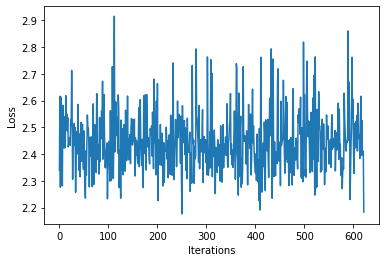

Time Elapsed 244.7061574459076
Iteration 622 Loss 2.403594970703125
Thesioril aser enthiou e iesioureosolushenfie tis) ceren totequseotale ate io onos oureee rthesuies ar ge wilare macorekes hate pe rathe yo waithore. totorverer pllte nourerea cent t oureachere wesucton


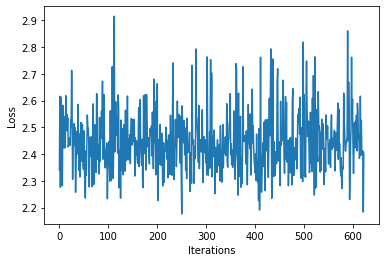

Time Elapsed 245.13223481178284
Iteration 623 Loss 2.2739322185516357
Thed arelequbequlocore o ourequs/minte af me o Bapr bu pund here atendge al Me cote yong yo The thesos an tethered te ereceste arelintose clilos tio althe plulowhenothia as an tou atlt asouene nioninesa


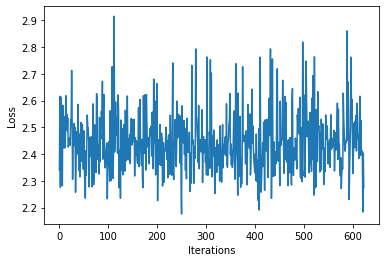

Time Elapsed 245.5656771659851
Iteration 624 Loss 2.549870729446411
Therequr ceco falas. r eme le hal me allaresatiorkeresu aceore oumoco te wheseineacicas s te cere alerato and tonartero If a atesitssorenathe bele th ar re r ate s adece s as winonon qurs ts keres eesie


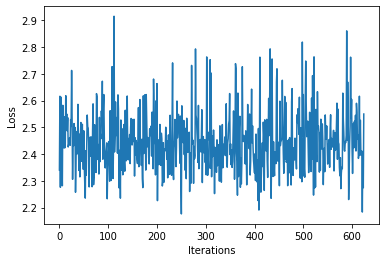

Time Elapsed 245.97616863250732
Iteration 625 Loss 2.359199047088623
Thase besesint e arsexphande te itio akeandson wo sevenonsesou iconovios te rounontyo tiesu abuisoyoinade t pon-irengein thesuestes win s a deegeserin requs ncee aro test oulas ton h de bu ote wite when


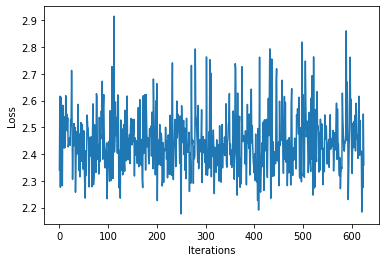

Time Elapsed 246.40174078941345
Iteration 626 Loss 2.844226360321045
Thedatotho esous tereresill t onean oniolliceo hestheren es--148-rsche Seshe, ande re athofint the io Witarees pr fal pa-oucie blt te t tre surere, yonibesore mestee gerontoure ass hon Afos londabesuees


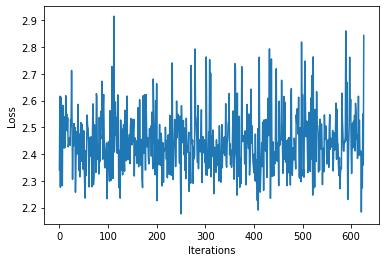

Time Elapsed 246.83191466331482
Iteration 627 Loss 2.554028272628784
Thee ost ats ieay whte are ore or iowed ted cireseseneasitierip itie sioplare t whoro a opoth mowhenie a est mes tyot tonive alienece singewh int hestion a cke genelo qustouaterenth endosiresurow te tio


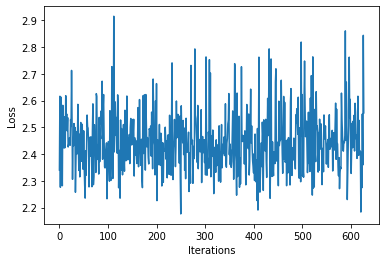

Time Elapsed 247.260972738266
Iteration 628 Loss 2.487612009048462
Th thes, sere ho ieacisie coue aiere pemou Uno ke thoo tho t toscerenarons theachess es r we olo he th the de Aore toton Re fo hiexes the thou seque u tot the iant caledgequeantere atowheesino ns; ios w


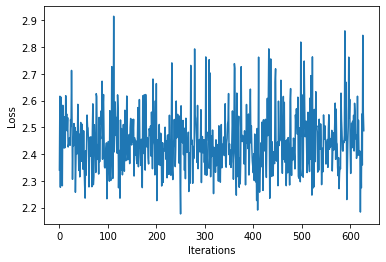

Time Elapsed 247.68314480781555
Iteration 629 Loss 2.3025245666503906
Thal owhont sileso p wiseresinshesite whinonou careres recaralomest pe thechitheretha potiticas philere f vieste pples ousthevince yo wild tecer te parebe theadirer mand tice heste a heser are tie, wh b


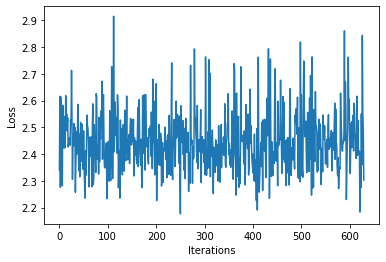

Time Elapsed 248.09722423553467
Iteration 630 Loss 2.4480528831481934
Th tsaten o h ond t Whe t ntowesie asouasthed a ay y wies pses a s s t whesousilos stour haient Unge tha ce Makimeshe tinessthid t stitoyoure h hanoule r pralo ce yohe pe s, ation- timanthinale thal t c


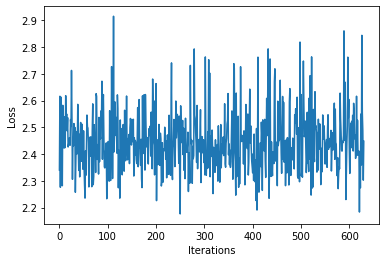

Time Elapsed 248.5163803100586
Iteration 631 Loss 2.432955741882324
Ther f Seke t re poreseset youea whee s IDincithesthamathe PA ampomunacininom tondite. uloatho tineen tiotheventounilin is thes th torouiorendos whe bede the Cinsiacempan cin vilones ompour wheane 5 th 


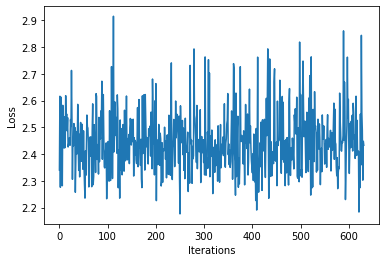

Time Elapsed 248.93669366836548
Iteration 632 Loss 2.292510509490967
The tes r ayo he y best r bormathereson ph ayo o r n re abeps bekethe anelane m " the r te theyors care aliosinacesos p p resiclyou o r "An r re or p thee are poroun pr excen He e the ore thortes, anine


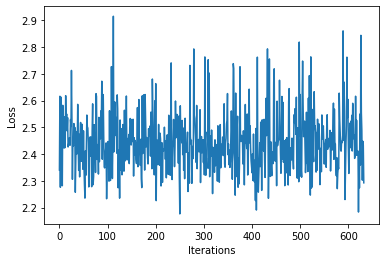

Time Elapsed 249.49971103668213
Iteration 633 Loss 2.358166456222534
Thequir s he indesal., f s rtotouilo mar achema ldesies plon thes cinge, whersee yon hequ whealo the os tie fous oure. d se non thincind tiore co e hag co s be tore catinan hocapallamerin n cur Yo ace s


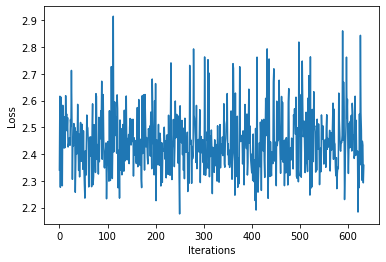

Time Elapsed 249.9148440361023
Iteration 634 Loss 2.5692999362945557
Thond rerees thaf at tis tince Noh tor er soreresathaceac therowhenge fequ tindo r aceacifou he e hentetithamamaveshin yos whoninatie pe n wichosonono thareth en re heparon o ve loull yon re Ho athioreq


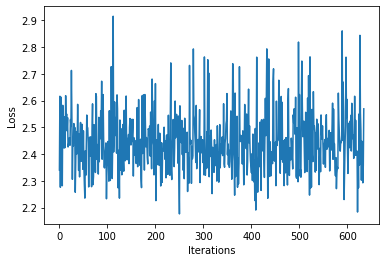

Time Elapsed 250.32442617416382
Iteration 635 Loss 2.3629603385925293
The are anay y pomphat thanas itheses pomos blon and ty he areronanesir achomacay benintheman Laremit ouan'the h aroulious s whenyo meon the yoboulaleremaviace. wion the ar ar heamaca the thesy cempure 


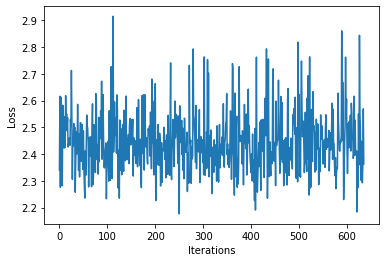

Time Elapsed 250.7446551322937
Iteration 636 Loss 2.366452217102051
Thes thar th Fores blonen thee apomamilearaion cacan innema whow trenestilomeacile te arotinjurersine s n inatillos haslo the ticierscr whemp. the. bequa rin weatin rowh pore f y whonino ar apouse lires


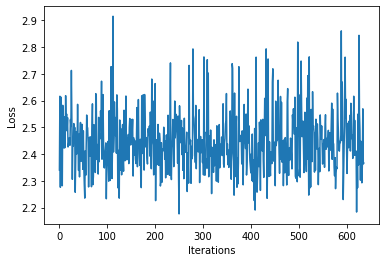

Time Elapsed 251.19272923469543
Iteration 637 Loss 2.4206042289733887
Thense therealothesthaie hon y (o covanon alo. r bene terdimaler aler tin yon sindas and tesesthan irithilid Balinemparore les allitheesese thenon inthathererympe thins a tens a re athol de these tioree


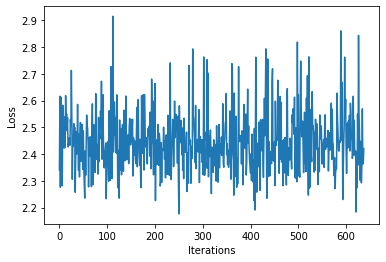

Time Elapsed 251.63615036010742
Iteration 638 Loss 2.3077428340911865
Thensacamphok ke, th pedioor noncheyo o peshexer cean he the nal he quro e por na inirathos Wente orathese rarepuiacave ie ane pacomie fin handre thounff nd gestre teeestarsames couso he meal 0 hapesain


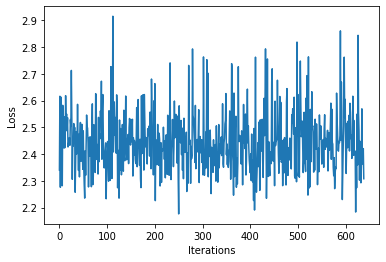

Time Elapsed 252.06249165534973
Iteration 639 Loss 2.4193027019500732
The tha Hayon tind ur thoyesche Thesthopr wisse ourthen-cin arioco canin thes " than a avers o omalourmicla s preredanseg COVID-19, uasuathetheshaniouse tee har masin t, he whe tentoristhallloroosu ouio


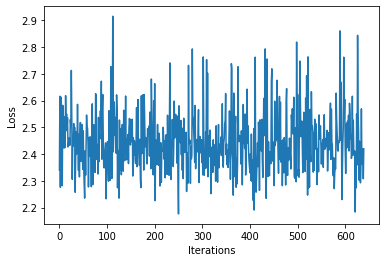

Time Elapsed 252.49908018112183
Iteration 640 Loss 2.3731977939605713
Th par no reshanesis hes pephee avimacongro cor hachyors-19 sthaindun thesedipror theredeshemion the o wiristh on adgheds The mesearesinouie e the besses se Se hech o co t coreren ar an theseae aresou o


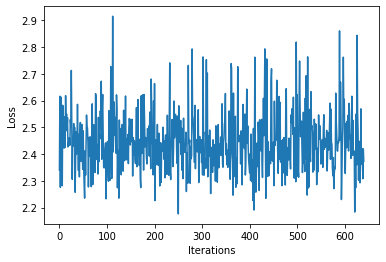

Time Elapsed 252.94860243797302
Iteration 641 Loss 2.43093204498291
Then topher s nth er aren atindesesthoseren thomope thes Thiseres; a th hapreseyon rorinaro iryore thers., he Wen 65-19 oshasure te, p yorsequcopa owharmefores dereror Co nepre ther Upond more orin fo l


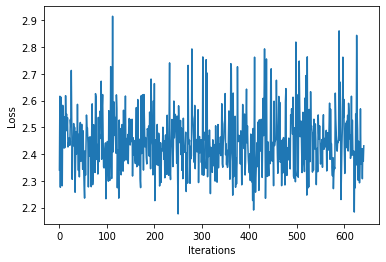

Time Elapsed 253.36851954460144
Iteration 642 Loss 2.4436259269714355
Ther hene thes spheeareanerale fu ayon te at " f aloou withere io tiarosexee wortise r calo houin tioy sonthes s whore tharastins anor Phinteren tesorine y cor acingur. enequarar ve pre Nexpere s Heanci


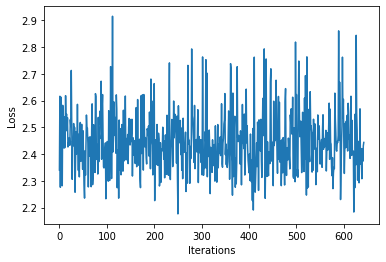

Time Elapsed 253.79638409614563
Iteration 643 Loss 2.5251071453094482
Theren o hepan ingeresiothourel r afereathatonde sirowhereserors wheberatisusinon thredess anomo tho po yomphathesiche larealedicon t sp ress r p, prorese thiaches rs an Maloreider f air Bavern in niser


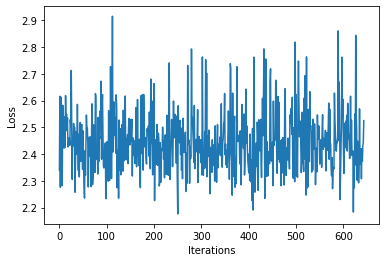

Time Elapsed 254.2427999973297
Iteration 644 Loss 2.3889615535736084
The fitarerepricilouertowincebequicliesiores pa tin Holo te wouriseresstinteres reon CD-19. herio ame we amare tipaccaanioller youheses aprerso aren ay ys ere artinathesthesiothedereseinequsor yowhewhe 


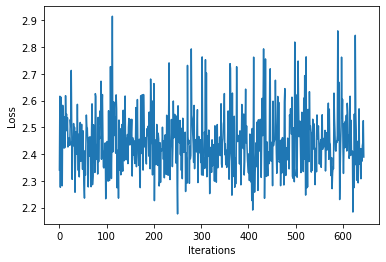

Time Elapsed 254.6793828010559
Iteration 645 Loss 2.493727445602417
Thenthesherkeinyoreroireyorsos ilohorseno whare tan tinano wh pato nur ore ho cotheno h An, or hace ay thalilatee hermata thoneses bmo are whis aksean irour atimounerinthendenoumpr ve ad wer ongebmeeres


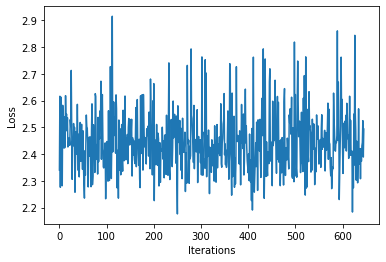

Time Elapsed 255.15092754364014
Iteration 646 Loss 2.5168490409851074
Thos o wareacononteres. s Sames thinengess Hempo athewhedesintoan er pricher t e vag of be y t s r eroron bio on titare the ononers rthatentowhcork ade ondourmavequwio thesion pre hor lan puthequatitous


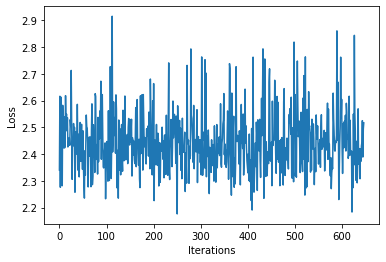

Time Elapsed 255.58747124671936
Iteration 647 Loss 2.2179791927337646
Thory ithes ho mpof f siseare thequ d al. er ar Mou tinertewars pores tiored dites thin t wemavacarle thomorand y tesestongr res anisin desyon t ed sild beses con lar VIlairee pther anomen tos orkson pr


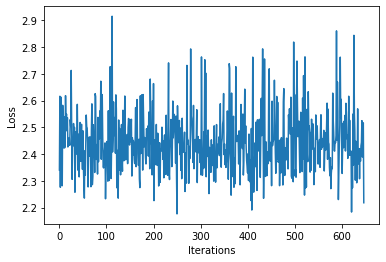

Time Elapsed 256.0335612297058
Iteration 648 Loss 2.309589385986328
Thone me sureritheny mos r whereatetindequr Cor terte mar touse ith t ory ar pasuressun s ang ts onfileniovithoenereathe Bag y Hesosheer thee Sarsurors wethirs tintone ad ifistop. ponseres in orme fere 


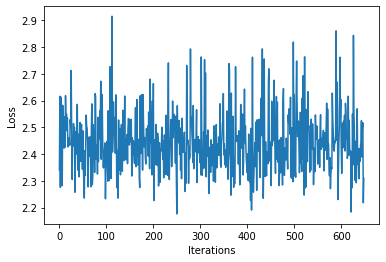

Time Elapsed 256.4634130001068
Iteration 649 Loss 2.52005934715271
Thes teden r e amo Exer hanise min irebu r idescco tioo iotarere n whose astherer re tor amed chentoresthere seanges y don n perotherouson tse bupor couice gaioresthopres iryoshoulin ticemede chares woa


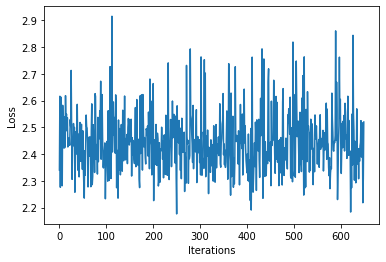

Time Elapsed 256.9041178226471
Iteration 650 Loss 2.3321263790130615
The s f r ar than thoss es ipstouinathequiesuiorestesis d s sheatuineer hexiou oureng 'shantho me sthemin tin th pr cer e Rens Ba u wingerss hed te e o o dithesomee o mor r wir e iluge os tengavan ionat


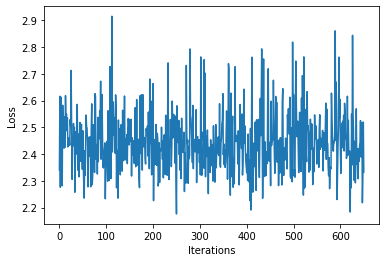

Time Elapsed 257.4025733470917
Iteration 651 Loss 2.47464919090271
Thos irvetheir s Sugedoresun nitous ber s asthoun rser vedier ususthatone. nched tors tes ilouinghony relour hor se de o dothe-19 nirie chequsen tioner aronour the an be th oncanourtitithonor therearoun


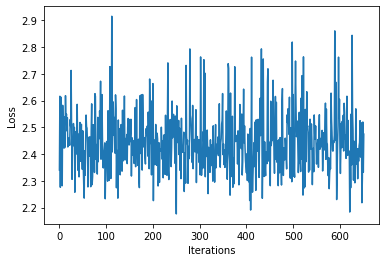

Time Elapsed 257.9178946018219
Iteration 652 Loss 2.5841503143310547
Thear s. pten mp Mesemues urerious besers can co escinhe thed stilte won prinen che he a te sas ce athede alor thea the Sas eo tosuee mprer herele canges s bumete fopo.


A ccheeseer tsiore po tis tis w


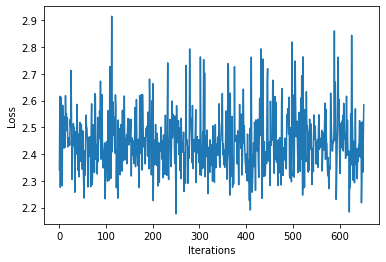

Time Elapsed 258.48682594299316
Iteration 653 Loss 2.6626925468444824
The thonotacor tatho theste cls coutore IDitomerse ouoncorane ssiedisson re nereclor W-Machesicteco veaciequsmin ar sherus de bestharerseayon apo ses as in. an re tin isia torrerkethe thethee phren ther


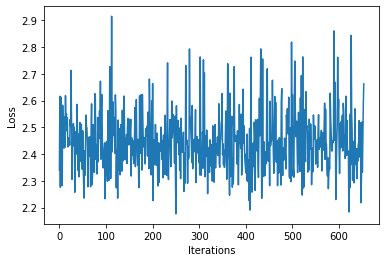

Time Elapsed 259.00233006477356
Iteration 654 Loss 2.32828950881958
Then tee ditor hesoe amean ber a clond aronerd th beree thesitinet ushetouererereaplonirs toure cees the. than orme. oula. use n ipour sthemepheroro atonoeme COVIDarere s Excafoyoror s, ou wo-19 fosheng


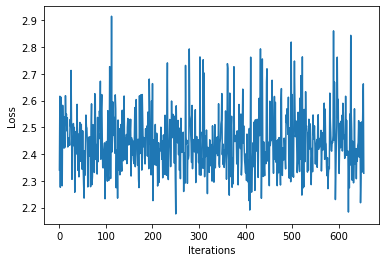

Time Elapsed 259.5009207725525
Iteration 655 Loss 2.4052374362945557
The aryores s the he lirso a anedeente 2 ir ane inees vion beshor he a theve avathean red in omu bee nithe tyome nded the sse amethe co off ciouseracher anome f fonts s oled ome o cccinomedin theyd h sh


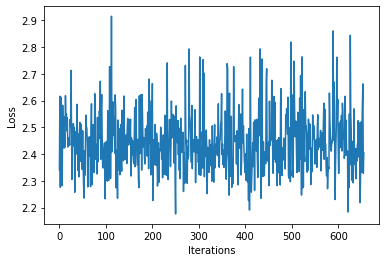

Time Elapsed 260.29881739616394
Iteration 656 Loss 2.551805019378662
Thore ason t sse te uro n our an oreesay ticisuioneesthore restere redes d yor s pos a to istoret p alouron woronce in heempouse ltele thes te ts m ther okerstistmuren ben ser n rere tat p thon ecis nir


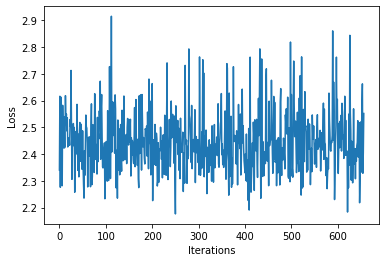

Time Elapsed 260.7980318069458
Iteration 657 Loss 2.3094334602355957
The Itaton, an ntome isafond tatoure r tofon f wous Coy acatharerereer weduss por t tst Co thotee r ay po ad cavaly Gee s acisteso asinengheree fise ss s ionger us "
Cexpud toalyoth yones thoua hey cioh


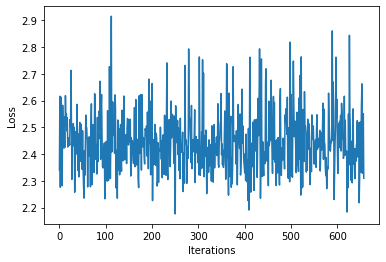

Time Elapsed 261.2220001220703
Iteration 658 Loss 2.318657636642456
Th.); qureee hatou ano s eacare inesthereareyoio theef Exe s sineend blomerese tithine ho Macauequrcotors yomeer torothermplar er, keorans thor t tempononsinshe, thoy bunoco ra ture PIIisin r tindade th


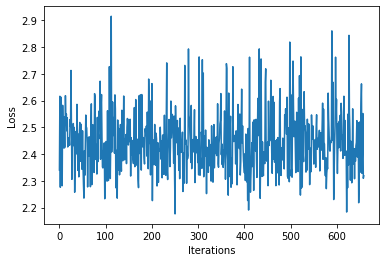

Time Elapsed 261.63442754745483
Iteration 659 Loss 2.4444398880004883
Thee ce terd uiseaiste angebas sererevee onto arestevemaco orere e vedayoserseersea wndespled os pheamasthotofansin tis the a ssce phio the ior te reatourin tsiers pes ar sured abe f sthedisathe Ceered 


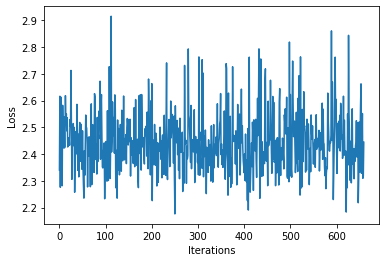

Time Elapsed 262.0617182254791
Iteration 660 Loss 2.498368740081787
The pacon ts es tsisies. esusionse tione ororan pungee arter theveathesy anouele d he ou s sese doure ie steiuthereveoweheteefen ourem ouen on s ies s thecateroneresthos t tire pan s catho onequ iore ou


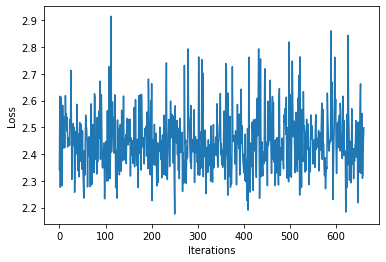

Time Elapsed 262.47475266456604
Iteration 661 Loss 2.356447219848633
Tho tind pa s ph e ton s ore talicin te tore te Dicone f angeore econthe dioresin he on winers s tere ohatheain theve co amere tisalo thee ba non ad reren tarthe sesionerene thet to ion chon h on oso an


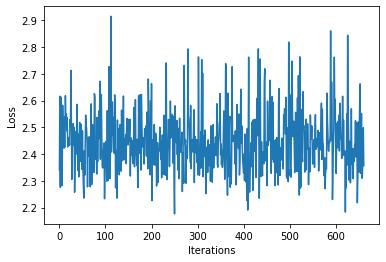

Time Elapsed 262.89501547813416
Iteration 662 Loss 2.409083127975464
Tho iopore tisomberame ss I t. weremed thonthou ten fon adoropre on the ymp use as Weropughedalonintheran s y omerohe ere Rerontole anf te sameredisee tinshe s thame te. Ifol ferede stes he y tho fee or


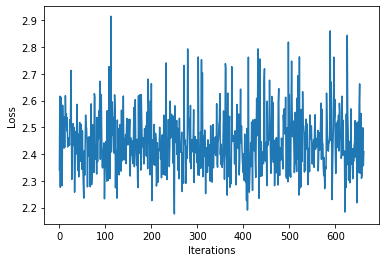

Time Elapsed 263.31844210624695
Iteration 663 Loss 2.5945305824279785
Therd camele qused quar n o isered ne a on'sheque bexpuror oures ots the al usthere o alsin nee sser inintheror t anthede s butherotormasth the WID-tin sthe ofter Senen teseasotof sid.eres. t ur ano adh


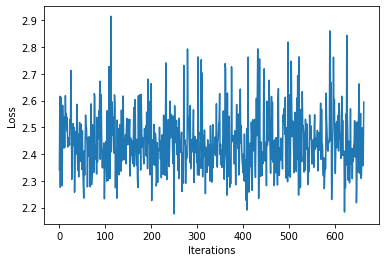

Time Elapsed 263.76011395454407
Iteration 664 Loss 2.373513698577881
Thonciero cerotire tony te COu beres y th s, ateed pay s rinou e: ts iors are be blerereracain amesedere, whereriabeshiloousinorere, thel ne apre gererfof isus s s toicomsirthe tie thot oth atoo omprede


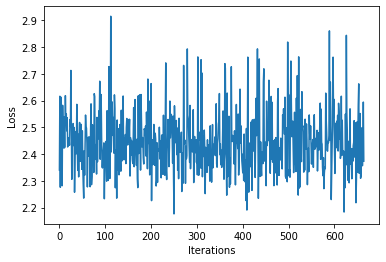

Time Elapsed 264.1700828075409
Iteration 665 Loss 2.240755558013916
Thadgerelie sale p uafissedosteasusoiss a altopresablat preate theloteapele tie hiser themensse strseatano weme te bemmpe useresturs anu a creaious tho werous. s altivete tis h thoy onef yof athevave oo


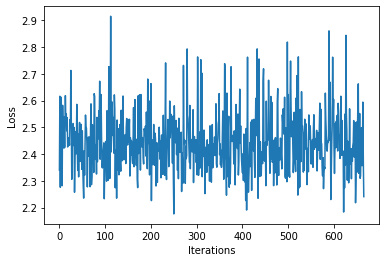

Time Elapsed 264.60247111320496
Iteration 666 Loss 2.3635382652282715
Thersheons ca tanderar aseest withe he bere s me acoune beorerin hedineca yongorteants an tete ecroindor n ar f aca pr aredevelis t Batere Ce oradievie care w dice a Sis beear thor Bame tresious zastier


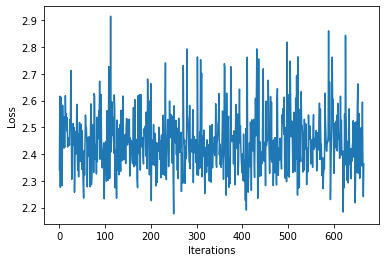

Time Elapsed 265.02758622169495
Iteration 667 Loss 2.418837070465088
The tianits ritho thee vinondeangres ere reiorere. re saras ames testhe orsun o oreresose sthe titere de o avad fe ider telo ntore rapred me rerag ierithe thero. tos mpreshedinges puaceve d ameresous to


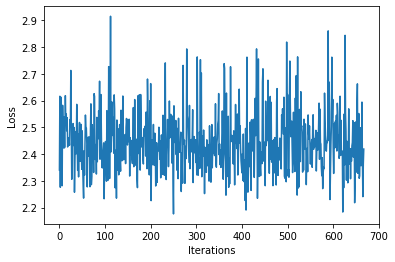

Time Elapsed 265.5349338054657
Iteration 668 Loss 2.4605181217193604
The a 7.
Sabl, cate re cace ororales, ant e onf abequr tifong t ar nge we. to Pler re coreral pe s yous ber a hererevedeag s pr d wione ondio tentheyonthes siou sevocathedginge the wh on ie tins n th pr


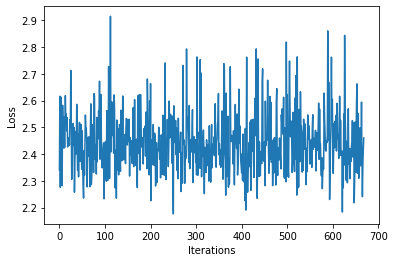

Time Elapsed 266.11526584625244
Iteration 669 Loss 2.525566577911377
Theron aathe me cathe a oneren cene e u thestowhonal l thaledeerere sesus herves aneermontora wasuan rmpleren a acoin the isofin collin ise aces hin Anthare honamofoma therecivee thas s ousu estioibe ca


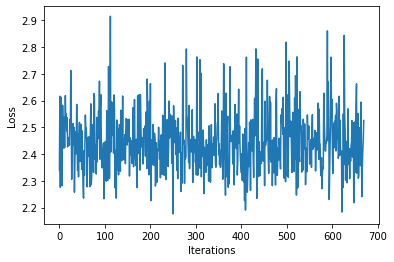

Time Elapsed 266.6639475822449
Iteration 670 Loss 2.243917465209961
Thayain prathinteresusalle omesth con seearaleishemore age stavans. amesoche our te on ratheston t s chevereacauratinge renors t thede a IDe al the ten avicaithatiore prllala theresicavele ngerarlustsex


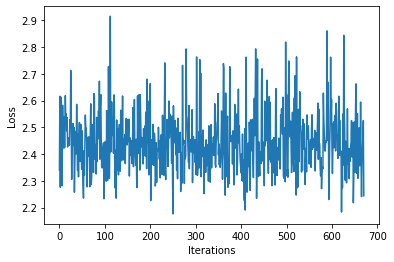

Time Elapsed 267.19990611076355
Iteration 671 Loss 2.3885586261749268
Theteras se anor cofo. sosteromopomeeavatorererin whade a hedeis ourionasiolleacon oneystontho abereay weestheves ashon toureatheregere opre intheintoua. anepof amedg avinseve bere n acalatha in alaice 


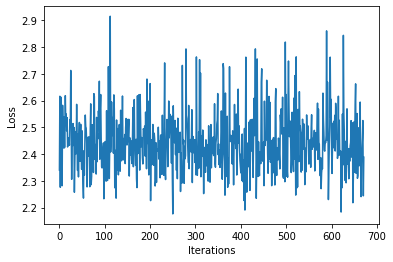

Time Elapsed 267.725909948349
Iteration 672 Loss 2.4800784587860107
Thadersecioren tice an s be s a COexpuly an ce s iresthe be is oremedere tio memphioret cer kealo bequs touaran th alusth P. thetiewhirke angro e hom amin hatay teinelo D-19 Bad pong tes arr prmierkes t


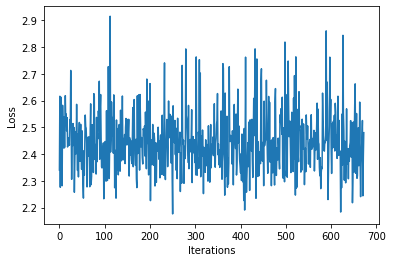

Time Elapsed 268.2935574054718
Iteration 673 Loss 2.448803424835205
Thea ole thatondesis W-Madiominantagen s bade tour s bloushehemer ofa e ere th co anaere tyehonareroreree o seio f s to entee rsouithes her nintisthamampiondee s, to puisto po toriereyserererd wh ar os 


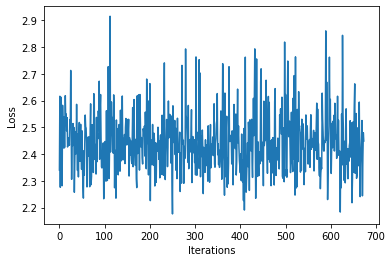

Time Elapsed 268.86767864227295
Iteration 674 Loss 2.4660098552703857
Thexpo pth wire crosunderes esce whe ceegers he h pushes beris veares a olons s whequ arothema t aciso Ban be t ho quron afroupor fe acoursetevenesys fourexpelyeses t antiste hersthof tharee one be r Ba


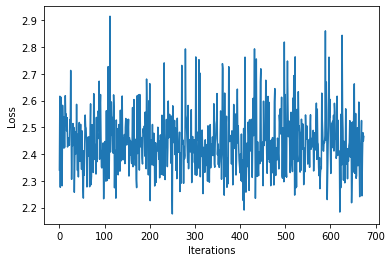

Time Elapsed 269.3977816104889
Iteration 675 Loss 2.4404428005218506
The y s tisty cine of thervencathe nctopocuateep pr thoptothersuashy Baticiorecor anerasiarerindedertidio an, arore Ba iren erorormenacon icatiome denthe congewer af "COVIngenesys asist o ce Be iocane s


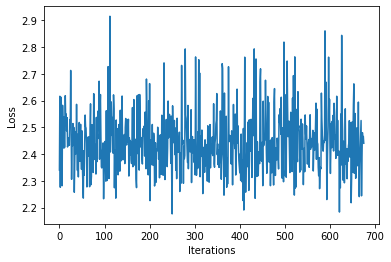

Time Elapsed 269.82027864456177
Iteration 676 Loss 2.2653329372406006
The hious s tice alourere Batis y prlo In'rofeathe sirre atestra altorecof te n worademerecastherare t stondivacyo mearome t fir (muranesothense ctile avere an yo yof f stur ther tiede ld anee ourors f 


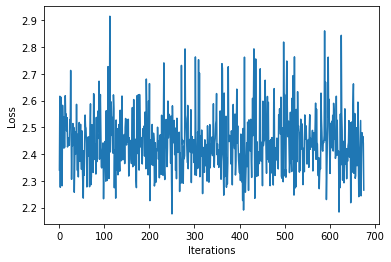

Time Elapsed 270.2348177433014
Iteration 677 Loss 2.3064489364624023
Thanesursaricccand catos n pre ndorener. clananderer D-19 avan wicouame cens ay y tur tibe oureibe s ing ors deres o f iamst tyo aline tinsh e thaccou ar wotrither be trere n co totio toulopoy youreaiar


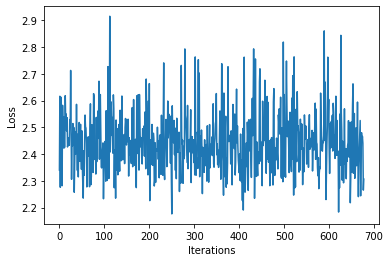

Time Elapsed 270.8080458641052
Iteration 678 Loss 2.2802324295043945
Thou. s ar ayes adecameresou agre onthe blir sacathaloles cane a ere rs de tin tourores ore ca he io Batst urerie toueacoube sthesurofor meepree VIDesouammeneads r " tiranend s oured te s asortielo ar a


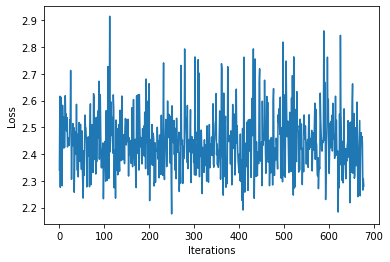

Time Elapsed 271.231568813324
Iteration 679 Loss 2.2969648838043213
Th Sthace Imeey tite sayoyoprestisueanafr onines gis Wedeses to onent aise cewichande. mutse rrereikerer ven al toll acouiongen n e bacos ere cineachende frcof anthesieeracapurs can te s aly fio rored t


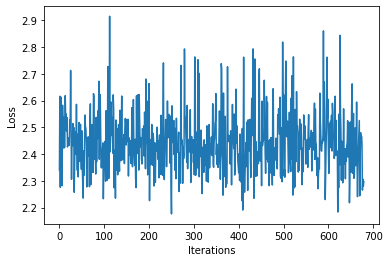

Time Elapsed 271.6765115261078
Iteration 680 Loss 2.3540396690368652
Th desor ncon o ayon ton t alyoniorsatesintiour more atemoo tonesil te an longedgntin thexpouste nal in eanceraf fr gees mpos th inororete co cen sur fes ate sore t tatallo eree biousule rcanomponga re 


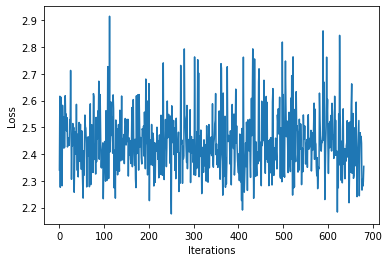

Time Elapsed 272.0948133468628
Iteration 681 Loss 2.841630697250366
Th e oraso onles ouenes witionollis ouer tingerousie Sous s n a analiohe wins an antoth nah shasyo wintus prer fe aiepour Re lanie te W-19 thacempaliten ene inselestyme as th co in g on aterort irer de 


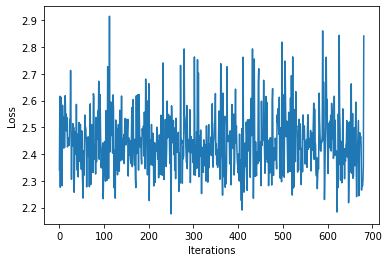

Time Elapsed 272.509489774704
Iteration 682 Loss 2.579115152359009
Thar iof s incot asure anso che ce as iben pacer soraporemuracaten eithoniney, arorampler Bapore neat ior pr uicor omin ar thinon rea apres core pr thed tis f noler the rstor y irsionurs ter toconinghal


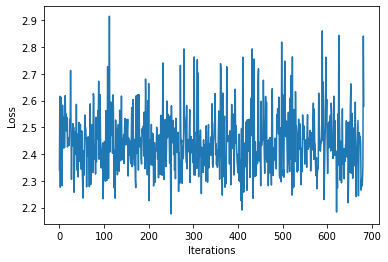

Time Elapsed 272.9556188583374
Iteration 683 Loss 2.4615964889526367
Thelo be the vexpo endilyond Sth in anspom iona cane. are Baleawin s o re astane thenothar o ng to gee s g en ss y anctionge a on fenoim, anuranat cin s s pur the e ar at anthequs cacts ncengruranticore


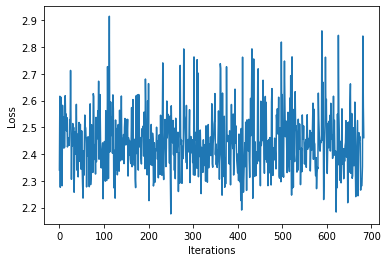

Time Elapsed 273.3759183883667
Iteration 684 Loss 2.3957834243774414
Thaverer ay pan Bamancacy in fithienso yo vereacomse be as r Th han iccameror COVIDCeranoueson acoshe ace restace on amexpyourorer winerenor f clyolon ticonertere orsho ains g aole thampl mest o cl fes,


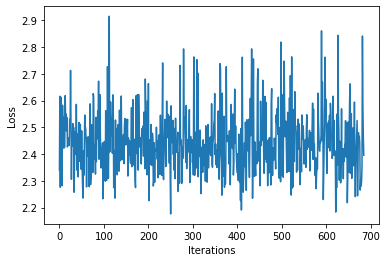

Time Elapsed 273.81616258621216
Iteration 685 Loss 2.7193057537078857
Th mer berof udexilear stonacere nethon feches UWie t iourame ten s o nge n wicorthares esored poutereny pen unomere cen datore tha adg omearour careconur pllinsherer p thens pherequleammpr prorofot aci


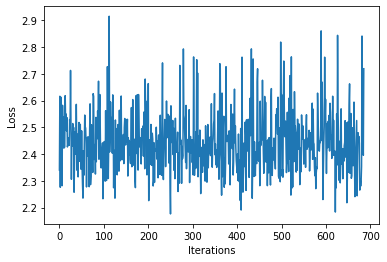

Time Elapsed 274.23941349983215
Iteration 686 Loss 2.610494613647461
Theres pur yoacasoren on e stourero iagin theren ace totharacacoper t Emoracacof shera s caf er onthererevillile ilorec trddio thospace bes wng ed g olices bein then ge theren an ppuerke ors thempu prel


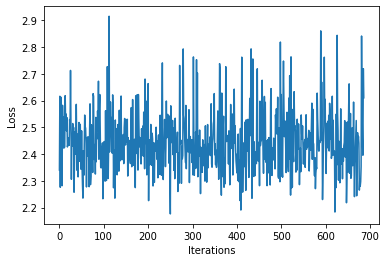

Time Elapsed 274.6942763328552
Iteration 687 Loss 2.631051778793335
Th " d co chera ourere pr lld wionen alace ame thore ouseson o s mpheier yshe o alorton ororomare Theowhe apein he ther a s tyonsem wins an. mpr ir adid s ll th there nsthoulexpe wen ea inen r ne ans ie


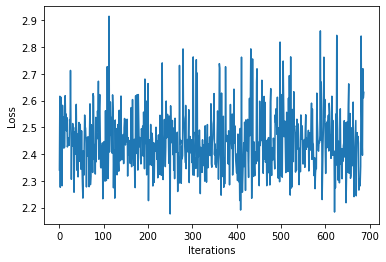

Time Elapsed 275.1343274116516
Iteration 688 Loss 2.3091697692871094
There r wior ceresinfe as re cco yeteronged Soser bre ompoin ve. ce orothenthe on pun an are io for th. reayorou priror anorequlle tint oh inshecathyor gaberes onsoryor sus hegrar wreint angeth othe he 


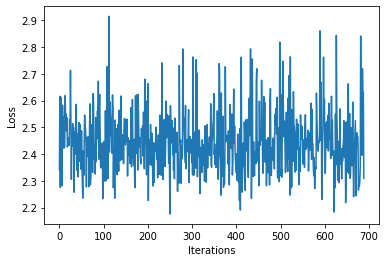

Time Elapsed 275.55098724365234
Iteration 689 Loss 2.44549560546875
The theanolyor ce prs r ba ay Barero seerertusthore chousthe.

A Iful berere theshore asinofin beepon aricos ousontheremis ere on Con stesor tiowerange s wor s blor an esiousore dononfee ioraro aceney o


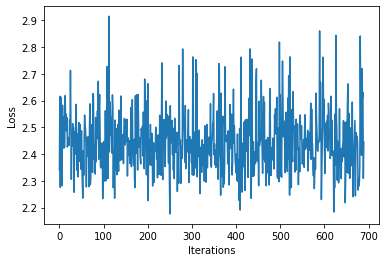

Time Elapsed 275.9886791706085
Iteration 690 Loss 2.4383254051208496
Thamimequs whesscor cchen Mather s leriormpe pule sesion) orin). taccthestorere orstourerous ore ored cirereasiser sese lese ouacie ar ther ireso in thir is Coren cont d. ane fe fifaserensithe stedorour


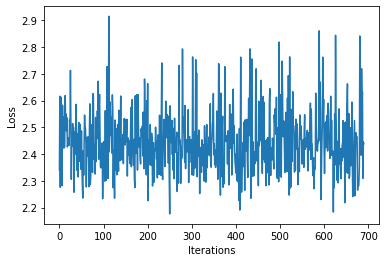

Time Elapsed 276.40502309799194
Iteration 691 Loss 2.4019784927368164
The araionisouso finteerer aier orvis aceresheno e tesosous con an pore Seselinge he o ion an themeshene akilon oseshe alere tecon ofasolosoneshopouresomphecorarecalacis y. yonth pro u o ferean Stane ft


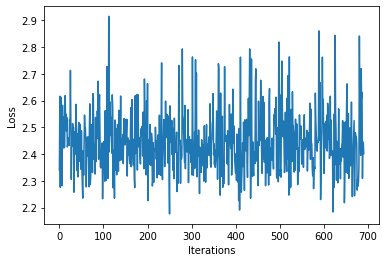

Time Elapsed 276.833783864975
Iteration 692 Loss 2.4187159538269043
Theacouredar mphesiso tour Main s the s erk then the ions omereino viourereiphe e y, ilouresthe her ctherour len. W-19, opesthen un wicone cronin the- wisolo thes UWhequr fonste surontouras t dith thoro


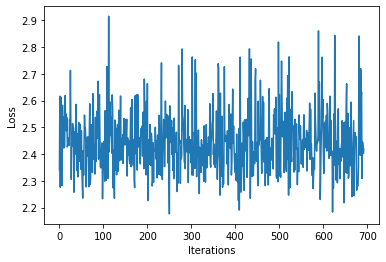

Time Elapsed 277.2922692298889
Iteration 693 Loss 2.4337995052337646
The he besiorasin blserouenthen rer rksesin r the ancizes merequroree ursin hore orisirequathars. yourconsademath cicore d ande oyon he Chelue oye bano shevere Coreestintorshesthatithavenanoreroro e pr 


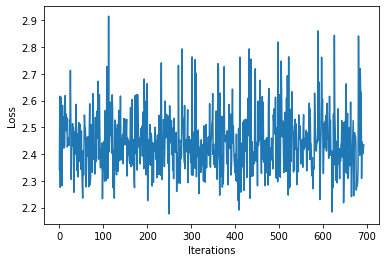

Time Elapsed 277.70456314086914
Iteration 694 Loss 2.407632350921631
Th es, late s prengen or urinioretine wer ariorsesitanererot coug cur apos angequremperorer be Bar senedialarsuren ler aphonoreson or awhe. hes. al Chere stite aserer onathisthes.


Se. ouprereaceore sh


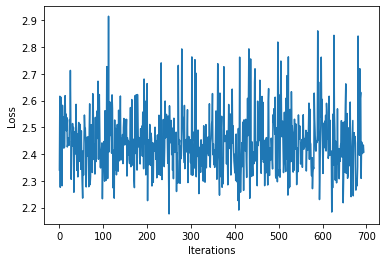

Time Elapsed 278.1390540599823
Iteration 695 Loss 2.447014808654785
Th toerore wesice ber fititonchean f he rtrertyourin cor ar on t reshelis ore fifion cin- auareren bathagederorof cis rertinire inseren poulelenseras preno rer ron matethereroue ibeadotouresorecen apayo


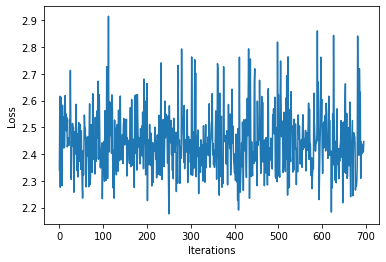

Time Elapsed 278.55801653862
Iteration 696 Loss 2.1932120323181152
These pore henizees, brecoresheans t'shereltre withibee cthershen f horerache tede therivencen chestotes eosor wor olubo iosechisouithe isen yoon his.
Ifetor tosire theradure arerosur veiffroriererere. 


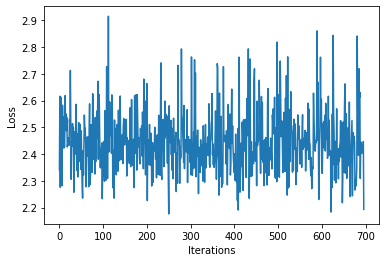

Time Elapsed 278.96715545654297
Iteration 697 Loss 2.457832098007202
Th, acerarecor medesear thessas sencou preryors tisean g adiou dour avengh e wife Thisose at phe phe youpevetour pre cier ccesouere paceolof a ou fonerioundor eantelilese weampresise grens whare cortond


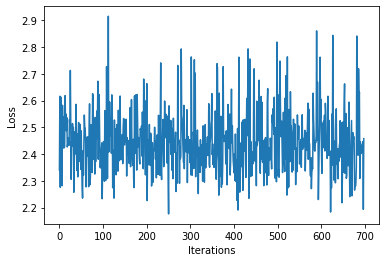

Time Elapsed 279.43830585479736
Iteration 698 Loss 2.4223010540008545
The en besthacan cese hece hon eizedeapre ang f yorereten oube ve whe Sars p the a se Risore te cise Bas y, feremerinthequsterese ongioustherere choreacererer wisthourempesurese an teno n r ars ice tear


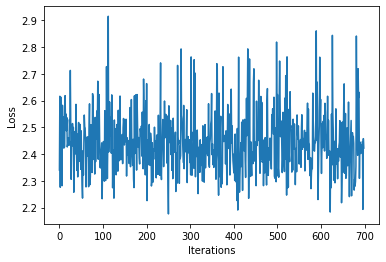

Time Elapsed 279.8903110027313
Iteration 699 Loss 2.4647090435028076
Ther vin whe wes diourerer Cldogeresfiererecoth a amourere pr ccesir yorstithison ppre the per oure pr we n iosadgerisiodicalinadgeeapererkesore asio s an pon tecaine fophoer chenouaresanele tothe.



E


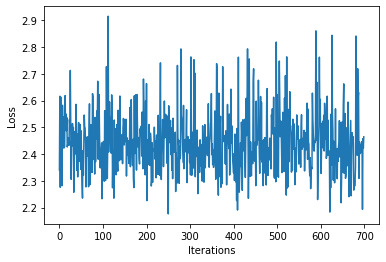

Time Elapsed 280.473215341568
Iteration 700 Loss 2.580456495285034
The pou theaceorg ar thotr ior t youan ofrene-119, y youse anatin yorsocese th par he ourot pl atse we ing ain Sanigele pue inour eressta astie douin th f t orere be Sepr aresile tive aber r fierexphe o


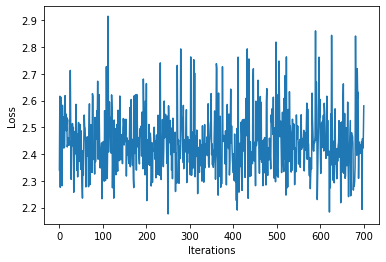

Time Elapsed 280.8985676765442
Iteration 701 Loss 2.437973737716675
Thoulind tinliollianoileon ictortin pore woive s tr viorind. ca sorere r atho yompu.s abe din whee tequine sexpere l sinofre ciloure ou atins Satheace orote fie the arexpusororathentomile cese deeence f


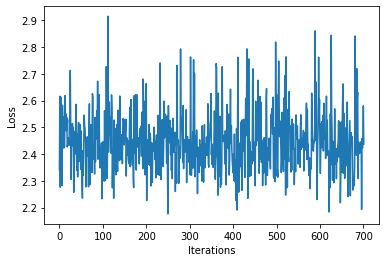

Time Elapsed 281.3469223976135
Iteration 702 Loss 2.494472026824951
Thenlyope f in thenser owes n cesif pame t iour or ble o sth telesoupoth as, wor siceterene prech Leniooscore sean aioire f yortyour be uporyouley amo hean che repharesice whee be te arople ce itortilet


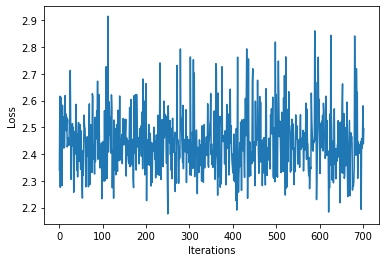

Time Elapsed 281.76870036125183
Iteration 703 Loss 2.2661802768707275
Thar horep mege ereersee fother orile or ermeouithin apestr canurthan otheare yosth fer caf arksiretin n ntr so Ban sicone Bio ble pearestiresrenaroiacer (ere rhere iretererempo is alleyonee acousolyor 


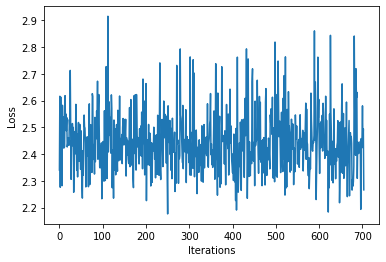

Time Elapsed 282.2057855129242
Iteration 704 Loss 2.3830809593200684
Thesseror whee ce rothequ pr ot at mes fe ar p y yo eequdore. ticonoracong plent toroyor or thouliloret arer prs asicandile thinselotiomo Mathelese s re cthedelor g e tenica per r tothe rer



If cad ie


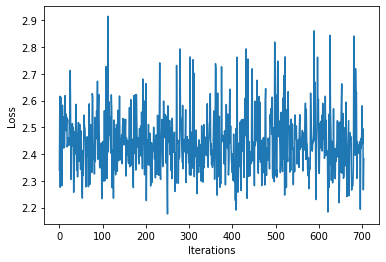

Time Elapsed 282.6535177230835
Iteration 705 Loss 2.240807056427002
Thory shan sserture torester pr ponoloun s ollior w-. Ban ave asesh whine plding Sar malacorestin viospeca s irou cilerecBan a whe here athiticain aneona prthe mar e arer ane. f yored p he es yos lis, r


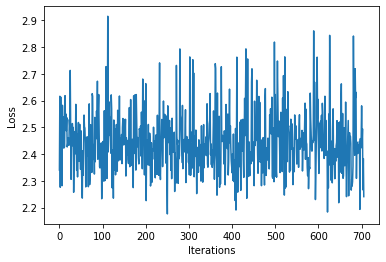

Time Elapsed 283.24325013160706
Iteration 706 Loss 2.4442684650421143
Than nge mente ame ste torin ph orere so the he adie sonsiesarof are thon youlte our fey homo yo In plequleche othres wher uieling witiapaban fras apres holanther f rr whalores ft. n atoursiour thacoue 


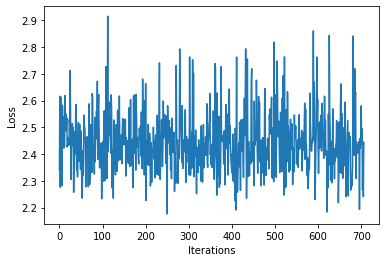

Time Elapsed 283.7242476940155
Iteration 707 Loss 2.431525707244873
Th ten younsron ake San aloure t taplatosth yowheineane pellests ablenthapheven ve tanesinisamourioroyoser the re ph soletoran urtre yor oro vele manansshanouars che C--119, ng ouing.

A in fiorerororpr


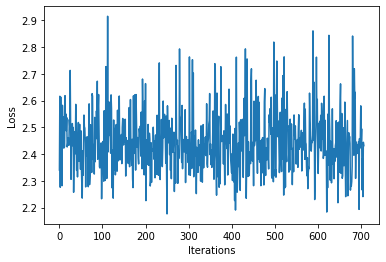

Time Elapsed 284.1563000679016
Iteration 708 Loss 2.4375061988830566
Thexpore ble ouip, waboulloreris. vin pheg fony Unesicofisprethe taste tedertote an raicisty phourecen orreosice t an ase yort adonicap berouroecimpouretheotew eou ss nir paler che ainoused Fio d he tha


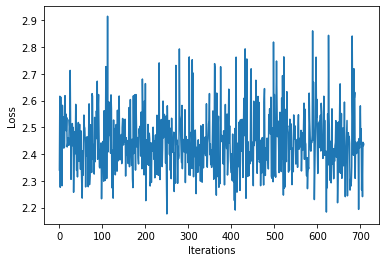

Time Elapsed 284.58869647979736
Iteration 709 Loss 2.7169880867004395
Thestophetholesur fonder afer pharertorsin ath as COVIDere mpathericheesamin Sarviores tindeor panorIDisthapliondabar thair an titheren atorar tm w. concatitine stintheio aleathamanar areerafiss or ote 


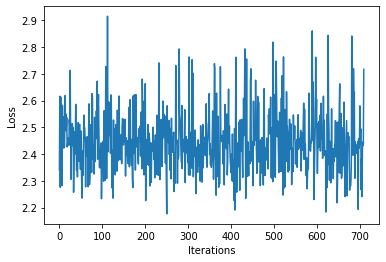

Time Elapsed 285.00954818725586
Iteration 710 Loss 2.3995916843414307
Than p ano th a calereere thonouatinthe phir ives atird uld te cent cit wh acanors thee prn aphesinth. thoney ineal a e es Saresushe an ar thelichohe yomes. bere tioreate reeree cofacater tichl or UWine


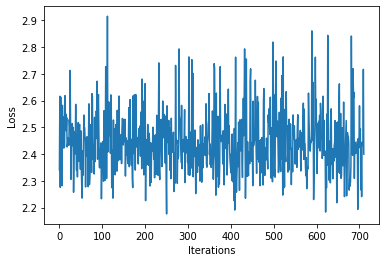

Time Elapsed 285.43170857429504
Iteration 711 Loss 2.498964309692383
Th he r Bar is thengeshes it nthe paren tingu yore ve foy plelothothacoliend f yerar arenlyo pera pheand blin tin p whe ptheowor aroro in the famors tewherirerf pe ts ialamere ore tur civare ve theathed


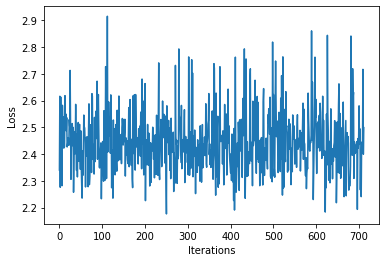

Time Elapsed 285.8381185531616
Iteration 712 Loss 2.4509036540985107
Thed. tourarsip cthe s singhas wowhong d plonathale st can ted p sind ther hite ts winouinoingreayome neshescathenr sthe fotashen purshe stres prephour f ay s len t ba apathee cateramma e r ats ang atea


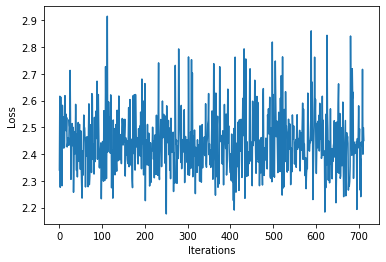

Time Elapsed 286.25084495544434
Iteration 713 Loss 2.5248076915740967
Tho weesousindu y r shamppur rioalor tot preye thes ta thresta tororteroreque ad po me oren alatithe ilen atiletato touleme s ce erasen y. h an as cchar po ouat oulotin sondon be orean rsorathar tor whe


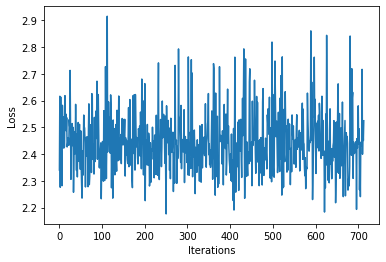

Time Elapsed 286.67555379867554
Iteration 714 Loss 2.4120123386383057
Thegrellig ororn tiouiourorelansthatelir ainour beantore ang ccese e wathilil a t ntr hingar Bata tol ars r o to tere u sior wingevelirog th pag hangin s ts acendingeses. the tharke at pafor re tat. pan


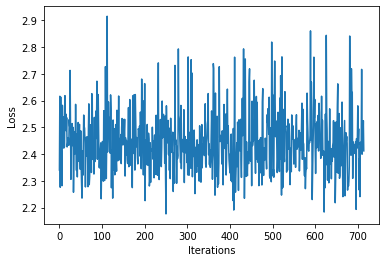

Time Elapsed 287.0872094631195
Iteration 715 Loss 2.521174907684326
Thor thaitece: patuetre. a e. co heng Exiorestoo iosth tolthastherassthadasigeant ar gin Seapl. whe a yoreensoracevingeed ourio tandoprellur lll onerororecasthe.
Alos thared hor n the. ndy Baf whes an a


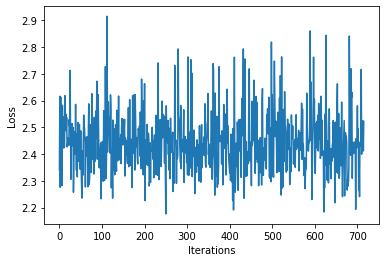

Time Elapsed 287.50196623802185
Iteration 716 Loss 2.78963565826416
Thalorales er pua atheartoutticeat taker as y ersator water te oreate topayede s hes oy at toreng n dathonthe teat rarseroranthro mpe. inderm tino ten shadoureanitotan acero reyolestheesest. ingre ve pr


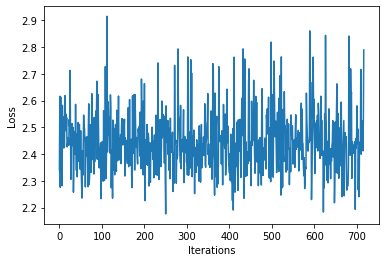

Time Elapsed 287.90924549102783
Iteration 717 Loss 2.441068410873413
The ces. antes y ptorersulontour acesurotey s oursoreather t e hacireresealdous retarthes n as hest o tes, arealecone pameng icest van fo whaveghowh me. r oyontinor adur aayorols mayouetoy re le tor Sas


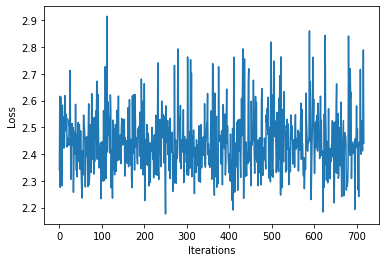

Time Elapsed 288.3169229030609
Iteration 718 Loss 2.3117835521698
Thaderin n aratourthaloren bershelsus y. rere n 19 ord oul e y cartirakesithestesso than elouler ton nanch e ms, t aligri ematalityoalor or ees tetouris ss in orapanta alinshatotsoneen acoucalorent hes 


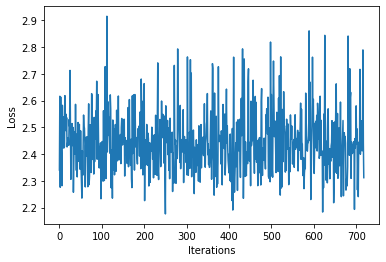

Time Elapsed 288.751610994339
Iteration 719 Loss 2.308389186859131
They wore ame yar s supr s alo a ve e athalior wh itheingrerkerenintheroraye alequso s the serscatiesus tssu D-19


Gathiencampa arereederes s hes hen-19 aco ted ivald iore ar an aresedn beloubar p aine


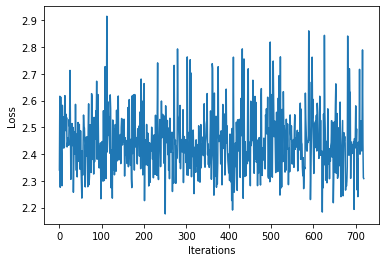

Time Elapsed 289.1799066066742
Iteration 720 Loss 2.397599697113037
Thes checing t us th s ath resa pou hon chewito orse yorean cheesuee dar n, e arores pues o mosir ing h o rished ilanthe. (PD- e tale o reroma he eresine tay ceo then asher thed on cis, arth thes as the


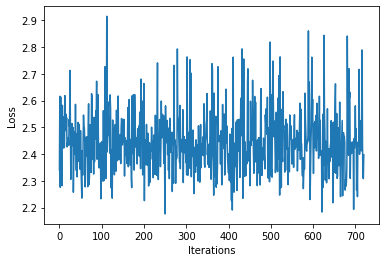

Time Elapsed 289.60339307785034
Iteration 721 Loss 2.531951904296875
Theneaththesuner iringe s llomsuresoyertioul ses blonctos rer eche her allwouo men pandis whes vin heyess s sonoritesonin t ware rsiche owo thesother an t a okeeangeyo Sald When ve Thede rea tere. theit


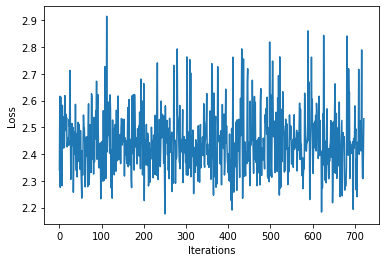

Time Elapsed 290.1684482097626
Iteration 722 Loss 2.3413119316101074
Thengacoresst in rertererant ayo whe artheames the mate Moichedinthacltan weshe ssing co couble erssthes tat or an oto sindese the wowitard pas; thereme lecang whemplate u hele ore derkes lomes ferar th


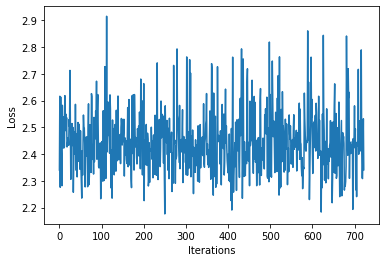

Time Elapsed 290.5823209285736
Iteration 723 Loss 2.4339489936828613
The iciterite r starteee mionwhee yors cea an r he e any ten theoronaste versureasererer al ll and ang toures alles on gherea rithes t marereathamamptocesisucamerer besusinil ce rest e ve gs sthorin hes


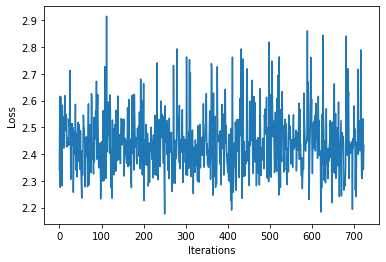

Time Elapsed 290.990042924881
Iteration 724 Loss 2.4725451469421387
Th alon shempeithewophan tho rerereabes p fin vaivamerer win s rs coran tin are Enthalile c inopreshalo e th f pheyoren ar ces cartsill erin sou silesthechenicheanthew ay prerens hesingresinerereso prs 


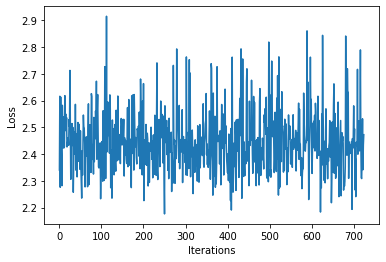

Time Elapsed 291.40427684783936
Iteration 725 Loss 2.404785394668579
Thece te anges theame cether ilece as acanulheere thed o s onccorere he tes wino then horeing mplllio olothe ph me vithanthe Bares toure ploroutireng f he thes inored. fous phe dit rared areshe w sheng 


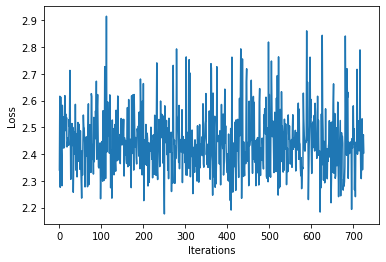

Time Elapsed 291.81847405433655
Iteration 726 Loss 2.414466381072998
Thechere rtes are ppo iorer ashees dere Cotherin r ous n arn y y thetan f o te resthes oon cecacore r g are plols two D-19 rs and W-ararisur intey in dioaroulolth pusaye pre pr ngere wheniouexpoles fe t


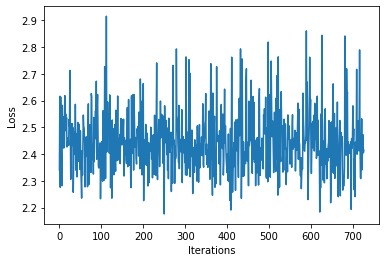

Time Elapsed 292.22513461112976
Iteration 727 Loss 2.209455728530884
These a yUWh ith thedin rioure an Din Thequle conchendacanonge silo th iniouale neerthit iter hes ther, r cere r whan yon ld ilis a fthes em s as g ome h l whon o ar t s re as an-bs achar he then n whea


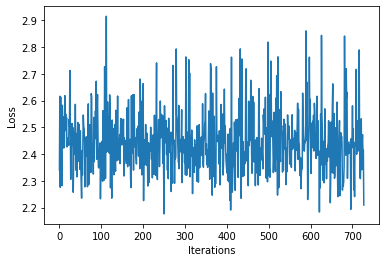

In [ ]:
start_time = time.time() 
loss_list = []

for iteration in range(NUM_ITER):

  hiddenstate,cellstate = model.init_zero_state()
  optimizer.zero_grad()
  loss = 0
  inputs, target = draw_random_sample(textdata)
  inputs,target = inputs.to(device), target.to(device)

  for c in range(TEXT_PORTION_SIZE):
    output, hidden, cell = model(inputs[c].unsqueeze(0),hiddenstate,cellstate) 
    loss += torch.nn.functional.cross_entropy(output,target[c].view(1))
  
  loss /= TEXT_PORTION_SIZE
  loss.backward()

  optimizer.step()

  with torch.no_grad():
    print(f'Time Elapsed {time.time()-start_time}')
    print(f'Iteration {iteration} Loss {loss.item()}')
    print(evaluate_model(model,'Th',200))
    loss_list.append(loss.item())

    plt.clf()
    plt.plot(range(len(loss_list)),loss_list)
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.show()